<a href="https://colab.research.google.com/github/deniseiras/Time-Series-Credit-BCB/blob/main/Time_Series_credit_BCB.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Time Series - Predição de inadimplentes da carteira da crédito bcb

https://colab.research.google.com/drive/10kjCcOBwHzkxoH0QqzbWqp5719H1DVVC?usp=sharing

Autor: Denis M. A. Eiras

contato: denis.eiras@gmail.com

Atualizado em: 05/09/2023

**Time series**

A partir da série de inadimplência, disponível em:
https://dadosabertos.bcb.gov.br/dataset/21082-inadimplencia-dacarteira-de-credito---total :
1. Projete a taxa de inadimplência dos próximos 12 meses;
2. Como você defenderia essa projeção? Quais
são, provavelmente, os principais drivers desses valores?

---



# Introdução

Os grandes mercados do sistema financeiro são interligados - qualquer acontecimento
em qualquer um dos mercados afetam indiretamente ou diretamente os outros; mesmos os
eventos internacionais afetam o sistema financeiro brasileiro através da globalização, um exemplo disso é a crise do Subprime que aconteceu nos Estados Unidos em julho de 2007.O sistema financeiro também é muito sensível às decisões políticas e fatores políticos, um exemplo disso é o Plano Real adotado no Brasil na década dos 90, que foi uma decisão política que influenciou bastante no mercado de crédito do Brasil [1].

A Serasa Experian, em janeiro de 2016, apontou que cerca de 59 milhões de
brasileiros começaram o ano na lista de inadimplentes, sendo maior número registrado desde 2012. Segundo os economistas da Serasa Experian, a alta da inadimplência é causada pelo cenário econômico bastante adverso à quitação das dívidas do consumidor: desemprego, taxas de inflação e juros se mantiveram em alta no ano 2015 [1].

Considerando-se a apenas fatores históricos, algumas abordagens tem sido utilizadas para previsão de séries temporais. As metodologias de Redes Neurais Recorrentes (RNNs), recentemente se tornaram uma técnica de previsão viável e poderosa. GRU(Gated Recurrent Unit) e LSTM (Long Short Term Memory) são um tipo de RRN que se adaptam melhor a diferentes séries temporais, ao comparar com uma RNN simples, por serem capazes de guardar mais nuances das séries. GRU geralmente se adaptam melhor para séries mais curtas, enquanto que as LSTM são mais capazes para séries longas [2]. Métodos clássicos de previsão como ARIMA e HWES ainda são populares e poderosos, mas carecem da generalização que modelos baseados em memória como LSTM oferecem. Ainda, carecem de um trabalho de análise e pré-processamento que não é necessário nas RNNs [3].

Na previsão de séries temporais com Machine Learning, existe uma regra geral de que um modelo RNN decente deve sempre ter mais observações do que parâmetros na série temporal. Para a maioria das aplicações de séries temporais, isto significa que os dados submetidos devem ter tantas observações quanto o período da sazonalidade máxima esperada. Por exemplo, se você tiver dados de vendas diárias e espera que eles apresentem sazonalidade anual, deverá ter mais de 365 pontos de dados para treinar um modelo bem-sucedido. No entanto, esse é o número mínimo de pontos necessários para treinar esses tipos de modelos – mais dados são necessários se você quiser testar com eficácia a precisão do desempenho do seu modelo ao fazer previsões [4].

# Metodologia

A série temporal em estudo registra o percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias. Inclui operações contratadas no segmento de crédito livre e no segmento de crédito direcionado. Foram registrados 149 valores mensais entre 01/03/2011 e 01/07/2023.

Devido ao curto tempo de estudo das séries, não serão utilizados modelos estatísticos como ARIMA e ARIMAX.

A prévia análise da série em um gráfico mostra que, aparentemente, há uma sazonalidade aproximada a cada 4 ou 5 anos, entre 2011 e 2019, o que sugere a possibilidade de aplicação de uma RNN, apesar da série apresentar mais um período conturbado pelos efeitos da Covid-19, após 2019.

A metodologia consiste em:
1. Análise da série temporal
2. Divisão em base de testes e treinamento
3. Pré-processamento para adequação às arquiteturas RNNs
4. Uso de diferentes arquiteturas RNNs para avaliação sobre a base de avaliação do treinamento
5. Avaliação das melhores arquiteturas sobre a base de testes e escolha da melhor arquitetura
6. Predição dos próximos 12 meses utilizando a melhor arquitetura

Os passos da metodologia são detalhados em cada sub seção.

Inicialização de bibliotecas


In [1]:
import numpy as np
from keras.models import Model, Sequential
from keras.layers import LSTM, Input, Dropout, Dense, RepeatVector, TimeDistributed, Conv1D, Flatten, MaxPooling1D, \
  BatchNormalization, Activation, GRU
from keras.regularizers import l2
import tensorflow as tf
import pandas as pd
from matplotlib import pyplot as plt
from sklearn.preprocessing import MinMaxScaler, StandardScaler
import seaborn as sns
from IPython import display as dsp
import sys
from time import time
from datetime import datetime, timedelta
from random import uniform

print('Python version:')
print (sys.version)
print('\nTensorflow version:')
print(tf.__version__)
print('')

# import warnings
# from sklearn import metrics
# import pickle
# import glob
# from google.colab import drive
# warnings.filterwarnings('ignore')

Python version:
3.10.12 (main, Jun 11 2023, 05:26:28) [GCC 11.4.0]

Tensorflow version:
2.12.0



## 1) Análise da série temporal
As série foi copiada para uma pasta púbilica do Dropbox, para evitar mudanças no arquivo fornecido na api



In [2]:
# df_original = pd.read_csv('https://api.bcb.gov.br/dados/serie/bcdata.sgs.21082/dados?formato=csv',  sep=';', decimal=',' , index_col='data')
df_original = pd.read_csv('https://www.dropbox.com/scl/fi/2usyl2f7r2clwlggkoliz/bcdata.sgs.21082.csv?rlkey=0umia8sc3xl2irmlodwa01z9j&dl=1',  sep=';', decimal=',' , index_col='data')
df = df_original

df.index = pd.to_datetime(df.index, format='%d/%m/%Y')
print('Data Inicial: ', df.index.min())
print('Data Final  : ', df.index.max())
print('Tamanho     : ', len(df))
dsp.display(df.describe())

feature='valor'


Data Inicial:  2011-03-01 00:00:00
Data Final  :  2023-07-01 00:00:00
Tamanho     :  149


,valor
count,149.000000
mean,3.143087
std,0.453813
min,2.120000
25%,2.890000
50%,3.120000
75%,3.540000
max,4.040000


## 2) Divisão da base em base de testes e treinamento e visualização

Data Inicial Treino:  2011-03-01 00:00:00
Data Final   Treino:  2022-07-01 00:00:00
Tamanho      Treino:  137

Data Inicial Teste:  2022-08-01 00:00:00
Data Final   Teste:  2023-07-01 00:00:00
Tamanho      Teste:  12


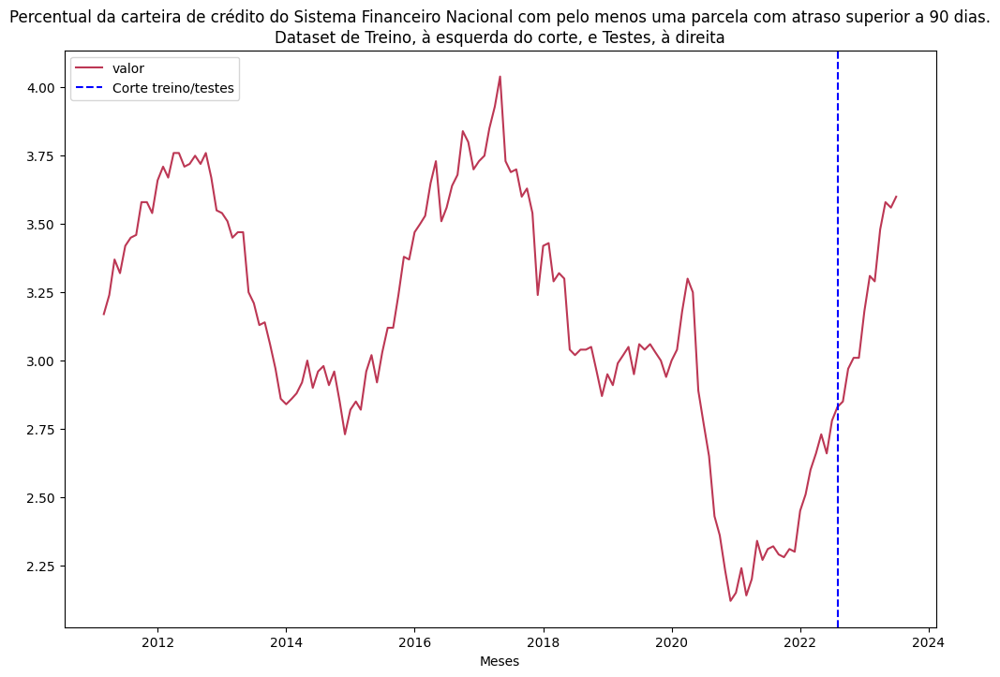

In [3]:
today = datetime.today()

# A base de testes serão os últimos 12 meses
meses_teste = 12
data_corte_treino = df.index[-meses_teste]
data_treino = df.loc[(df.index < data_corte_treino)]
data_teste = df.loc[(df.index >= data_corte_treino)]

print('Data Inicial Treino: ', data_treino.index.min())
print('Data Final   Treino: ', data_treino.index.max())
print('Tamanho      Treino: ', len(data_treino))
print('')

print('Data Inicial Teste: ', data_teste.index.min())
print('Data Final   Teste: ', data_teste.index.max())
print('Tamanho      Teste: ', len(data_teste))

fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
sns.lineplot(data=df, palette='inferno', ax=ax)
plt.axvline(x=data_corte_treino, color='blue', linestyle='--', label='Corte treino/testes', )
ax.set_xlabel('Meses')
ax.set_title('Percentual da carteira de crédito do Sistema Financeiro Nacional com pelo menos uma parcela com atraso superior a 90 dias.\nDataset de Treino, à esquerda do corte, e Testes, à direita')
# ax.set_ylim([0, 80])
plt.legend()

## 3) Pré Processamento
- função preprocess_rnn: usada para transformação da série em subseries de treinamento

In [4]:
def preprocess(dataset, feature, timesteps, TesteLen):
# Função utilizada para transformação da série em subseries:
#
# 1. Uma sequência para treinamento do tamanho Batch Size;
# 2. Um ponto de observação para a sequência de treinamento

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = df_scal
    X_samples = list()
    y_samples = list()

    NumerOfRows = len(X)
    for i in range(int(timesteps) , NumerOfRows , 1):
        x_sample = X[i-timesteps:i]
        y_sample = X[i]
        X_samples.append(x_sample)
        y_samples.append(y_sample)

    X_data=np.array(X_samples)
    X_data=X_data.reshape(X_data.shape[0],X_data.shape[1], 1)

    y_data=np.array(y_samples)
    y_data=y_data.reshape(y_data.shape[0], 1)

    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train=X_data[:-TesteLen]
      X_test=X_data[-TesteLen:]
      y_train=y_data[:-TesteLen]
      y_test=y_data[-TesteLen:]
    else:
      X_train=X_data
      X_test=[]
      y_train=y_data
      y_test=[]
    return scaler, X_train, X_test, y_train, y_test


def preprocess_CNN1D(dataset, feature, TesteLen):

    n = len(dataset[[feature]])
    scaler = StandardScaler()
    scaler = scaler.fit(dataset[[feature]])

    df_scal = scaler.transform(dataset[[feature]])
    df_scal = df_scal.reshape(n, 1)

    X = np.array(df_scal)
    # Separando dataset entre treino e teste
    if TesteLen > 0:
      X_train = X[:-TesteLen]
      X_test = X[-TesteLen:]
    else:
      X_train = X_train
      X_test = []

    y_train, y_test = X_train, X_test
    X_train = X_train.reshape(X_train.shape[0], 1, 1)
    X_test = X_test.reshape(X_test.shape[0], 1, 1)

    return scaler, X_train, X_test, y_train, y_test

Exemplo de transformação do dataset, utilizando sequência de 10 observações por batch, separando os ultimos len(data_teste) registros como base de testes



In [5]:
timesteps = 6
print('RNN data\n')
scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

print('\n\nCNN1D data\n')
scaler, X_train, X_test, y_train, y_test = preprocess_CNN1D(df, feature, len(data_teste))
print(X_train.shape, X_test.shape, y_train.shape, y_test.shape)
for inp, out in zip(X_train[0:3], y_train[0:2]):
  print(inp,'--', out)

RNN data

[[0.05950369]
 [0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]] -- [0.70068934]
[[0.21427264]
 [0.50170069]
 [0.39115144]
 [0.61224994]
 [0.67857949]
 [0.70068934]] -- [0.96600754]


CNN1D data

(137, 1, 1) (12, 1, 1) (137, 1) (12, 1)
[[0.05950369]] -- [0.05950369]
[[0.21427264]] -- [0.21427264]


## 4) Construção dos modelos RNN

Para desenvolvimento do projeto foram testados os modelos LSTM e GRU abaixo.

O modelo GRU foi testada uma arquitetura simples, enquanto que os LSTMS foram avaliadas arquiteturas com regularização e dropouts para evitar o overfitting e curvas tendenciosas ao usar o modelo iterativamente

In [6]:
def GRU_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

  mod = Sequential()
  mod.add(GRU(unit, input_shape=(timesteps, 1)))
  mod.add(Dense(1, activation='linear'))
  return mod


def LSTM_v1(unit, optimizer, timesteps, X, y, epochs, batch_size, patience):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v2(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dense(1, activation='linear'))
    return mod


def LSTM_v3(unit, optimizer, timesteps, X, y, epochs, batch_size, patience, dropout_rate=0.3, l2_reg=0.001):

    mod = Sequential()
    mod.add(LSTM(int(unit), activation='relu', input_shape=(timesteps, 1), kernel_regularizer=l2(l2_reg),
                 return_sequences=False))
    mod.add(Dropout(dropout_rate))
    mod.add(Dense(1, activation='linear'))
    return mod


def model_type(mod_type, unit, optimizer, timesteps, X, y, epochs=60, batch_size=32, patience=5, train=True):
  func = globals()[mod_type]
  mod = func(unit, optimizer, timesteps, X, y, epochs, batch_size, patience)
  hist = None
  if train:
    mod, hist = train_model(mod, optimizer, X, y, batch_size, patience, epochs)
  return mod, hist


def train_model(mod, optimizer, X, y, batch_size, patience, epochs):

  callback = tf.keras.callbacks.EarlyStopping(monitor='val_mean_absolute_error', patience=patience, mode='min',
                                              restore_best_weights=True)

  # only Adam implemented
  if optimizer == 'Adam':
    adam = tf.keras.optimizers.Adam()
    mod.compile(loss=tf.losses.MeanSquaredError(),optimizer=adam, metrics=[tf.metrics.MeanAbsoluteError()])

  hist = mod.fit(X, y, batch_size=batch_size, epochs=epochs, validation_split=0.1, callbacks=[callback], verbose=0,
                  shuffle=False)

  loss_metric_train = mod.evaluate(X, y, verbose=0, batch_size=batch_size, use_multiprocessing=True)
  dsp.display( 'TRAINING set. Loss = {} , MAE = {}'.format(loss_metric_train[0], loss_metric_train[1]))

  plt.figure(figsize=(3,3))
  plt.xlabel('Epochs')
  plt.ylabel('Loss')
  plt.plot(hist.history['loss'], label='Loss Treino')
  plt.plot(hist.history['val_loss'], label='Loss Validação')
  plt.plot(hist.history['mean_absolute_error'], label='MAE Treino')
  plt.ylim([0.0, 2])
  plt.xlim([0.0, epochs])
  plt.legend()
  plt.show()

  return mod, hist

### Treinamento e Hiperparâmetrização

A metodologia de escolha de melhor modelo consiste em variar modelos e parâmetros das RNNs e testar na base de testes. Os treinamentos serão executados 3 vezes para cada combinanação, e uma média sobre o MAE será feita. A melhor combinação de modelos e parâmetros, em razão da média calculada, determinará o melhor modelo.

Parâmetros variados

1. Modelos
2. Timesteps (tamanho da subséries de treinamento): será de semestres, anuais e bianuais, para encontrar padrões das sazonalidades
3. Numéro de Neurônios nas camadas ocultas
4. Batch size


X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


'TRAINING set. Loss = 0.15649890899658203 , MAE = 0.309457004070282'

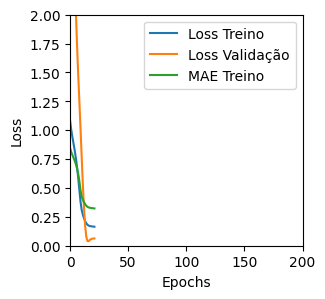

Tempo de treino: 0.15108814636866252 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


'TRAINING set. Loss = 0.1240641325712204 , MAE = 0.27532076835632324'

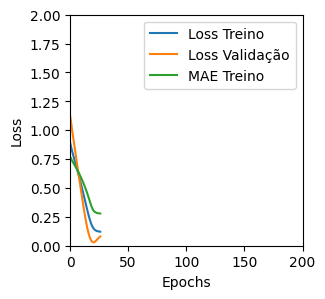

Tempo de treino: 0.15576826333999633 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16260553896427155 , MAE = 0.3024834394454956'

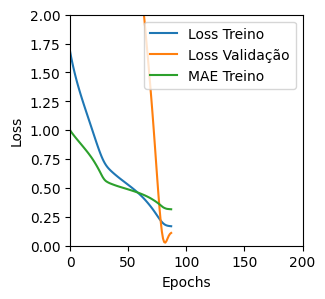

Tempo de treino: 0.1326871395111084 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15778538584709167 , MAE = 0.3049794137477875'

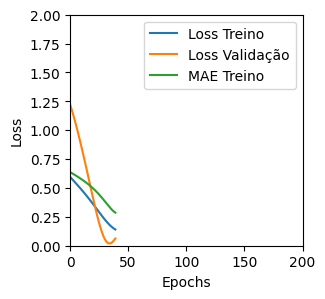

Tempo de treino: 0.06464099486668905 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09188809990882874 , MAE = 0.22122198343276978'

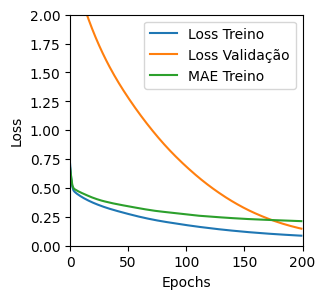

Tempo de treino: 0.364589524269104 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1651303470134735 , MAE = 0.30743953585624695'

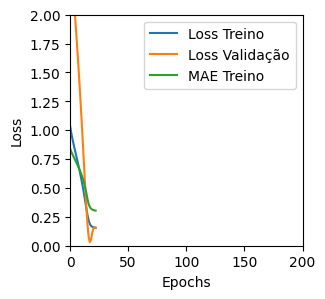

Tempo de treino: 0.06724861860275269 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1424749791622162 , MAE = 0.29007232189178467'

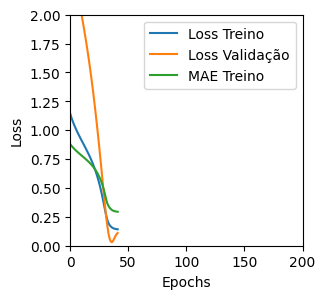

Tempo de treino: 0.06815319458643596 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1475178450345993 , MAE = 0.2907438278198242'

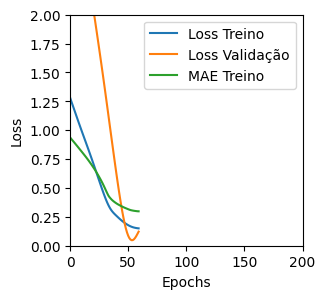

Tempo de treino: 0.06816682815551758 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1530749350786209 , MAE = 0.3022334575653076'

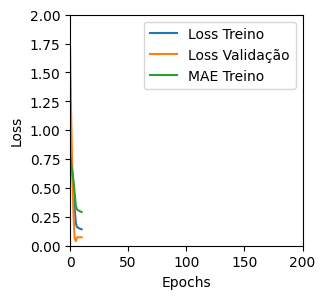

Tempo de treino: 0.04578440586725871 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13492891192436218 , MAE = 0.278218150138855'

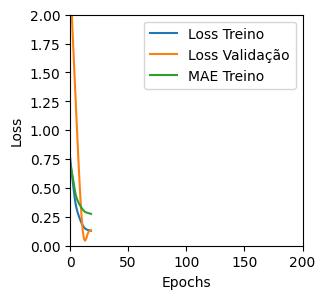

Tempo de treino: 0.04902079502741496 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14637508988380432 , MAE = 0.286920428276062'

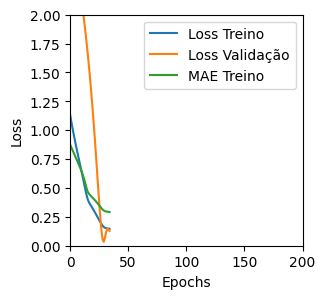

Tempo de treino: 0.06512153546015421 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35488423705101013 , MAE = 0.45770055055618286'

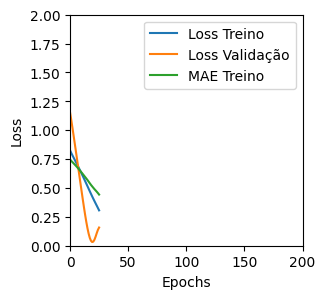

Tempo de treino: 0.038667670885721844 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15239402651786804 , MAE = 0.29156193137168884'

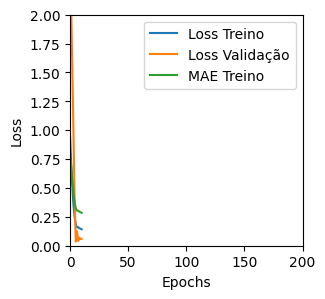

Tempo de treino: 0.06599182685216268 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.150199756026268 , MAE = 0.29617950320243835'

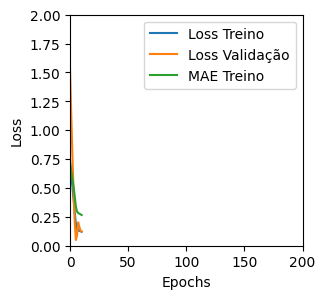

Tempo de treino: 0.06574973662694296 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15273472666740417 , MAE = 0.29269370436668396'

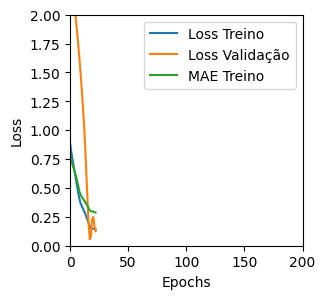

Tempo de treino: 0.04277662436167399 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14886106550693512 , MAE = 0.2888040244579315'

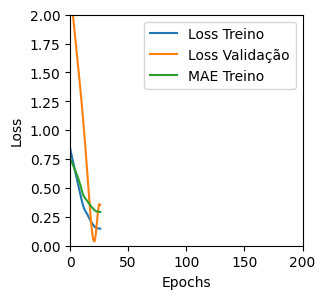

Tempo de treino: 0.04442251920700073 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12735863029956818 , MAE = 0.2711218595504761'

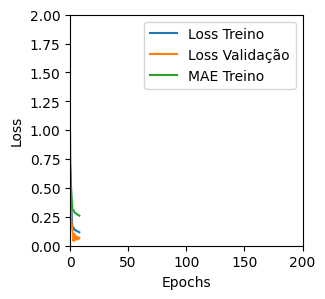

Tempo de treino: 0.04797008434931437 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1357959657907486 , MAE = 0.28574222326278687'

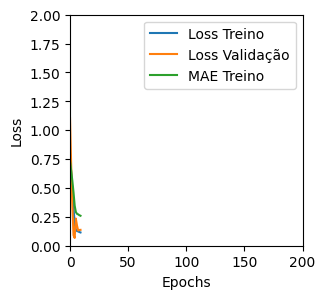

Tempo de treino: 0.044087664286295576 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14784398674964905 , MAE = 0.2884148955345154'

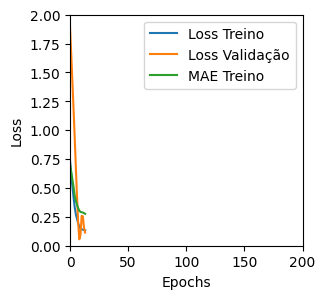

Tempo de treino: 0.03554003636042277 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15310104191303253 , MAE = 0.2916448414325714'

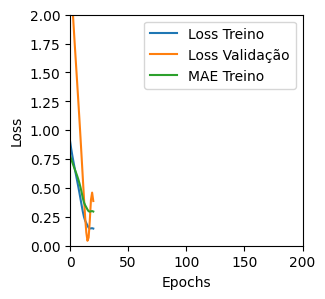

Tempo de treino: 0.03783372243245443 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5197443962097168 , MAE = 0.5427966117858887'

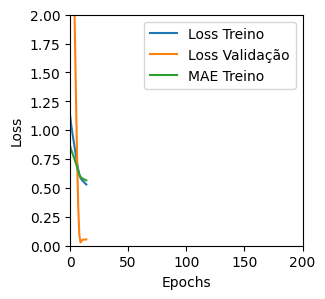

Tempo de treino: 0.08020471731821696 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14869295060634613 , MAE = 0.3176999092102051'

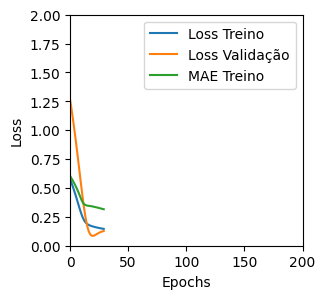

Tempo de treino: 0.05747599601745605 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5042399764060974 , MAE = 0.5317888259887695'

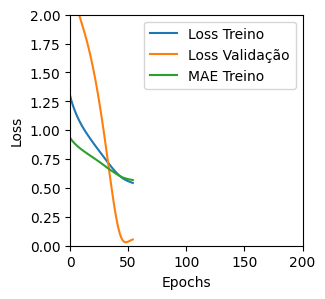

Tempo de treino: 0.07295134862263998 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5272200107574463 , MAE = 0.5438705086708069'

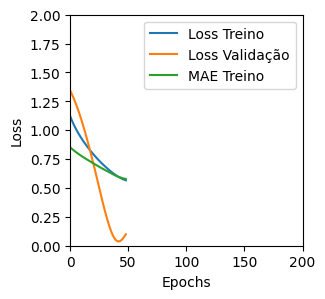

Tempo de treino: 0.06138302882512411 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10174811631441116 , MAE = 0.22617678344249725'

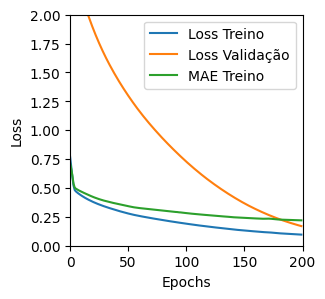

Tempo de treino: 0.3561790386835734 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5254549384117126 , MAE = 0.547503650188446'

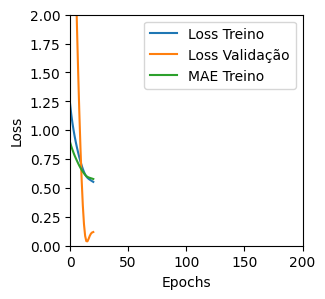

Tempo de treino: 0.04463953177134196 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2879473567008972 , MAE = 0.4179461598396301'

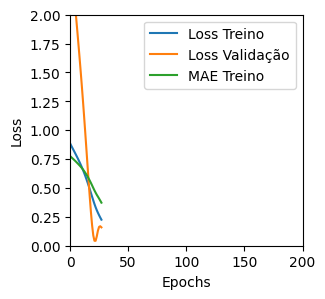

Tempo de treino: 0.06554519732793172 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6235900521278381 , MAE = 0.606824517250061'

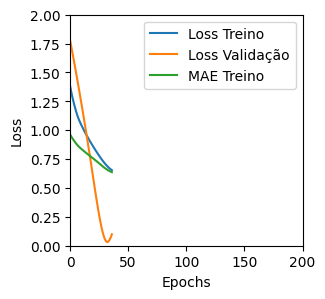

Tempo de treino: 0.06830871899922689 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15937751531600952 , MAE = 0.3016097843647003'

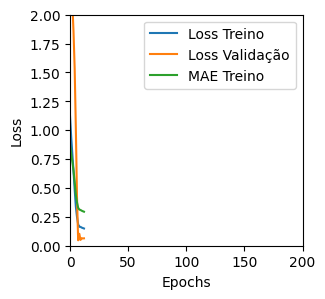

Tempo de treino: 0.04814721743265788 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14738814532756805 , MAE = 0.29394224286079407'

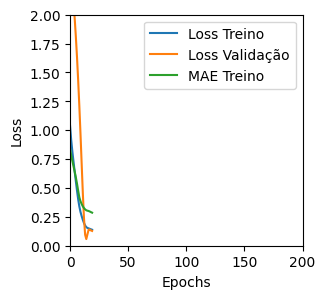

Tempo de treino: 0.04536331494649251 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15618373453617096 , MAE = 0.2908581793308258'

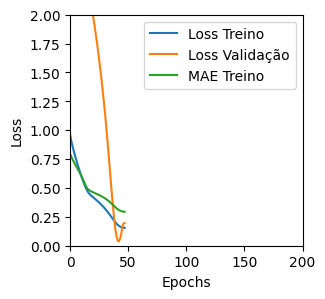

Tempo de treino: 0.06604804992675781 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22771155834197998 , MAE = 0.373112291097641'

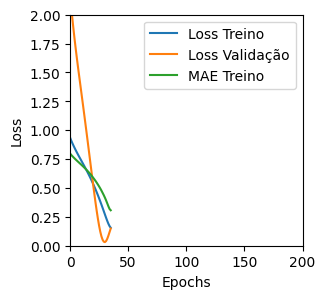

Tempo de treino: 0.05370428562164307 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1357036679983139 , MAE = 0.2737298607826233'

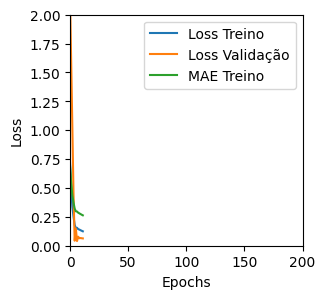

Tempo de treino: 0.045351568857828775 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15586985647678375 , MAE = 0.2997949719429016'

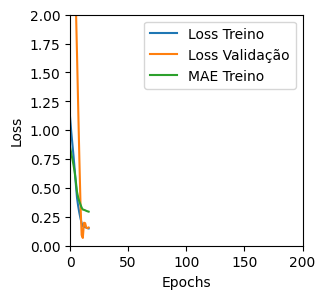

Tempo de treino: 0.05738507906595866 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16702963411808014 , MAE = 0.3015473484992981'

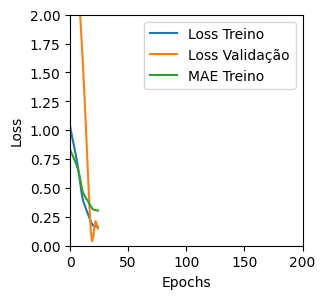

Tempo de treino: 0.0732197364171346 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14386771619319916 , MAE = 0.2784810960292816'

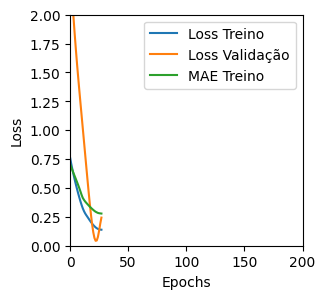

Tempo de treino: 0.044781347115834556 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12968263030052185 , MAE = 0.2712690830230713'

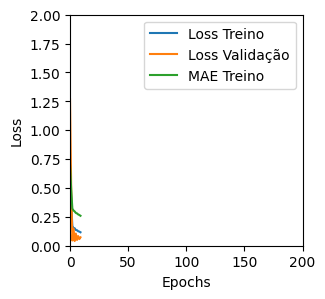

Tempo de treino: 0.0662092129389445 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14399226009845734 , MAE = 0.2888832688331604'

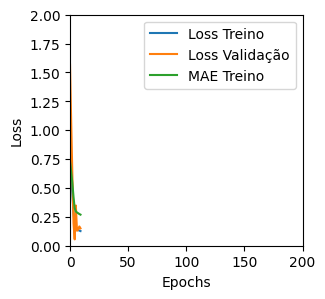

Tempo de treino: 0.036713178952534994 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15645654499530792 , MAE = 0.3019659221172333'

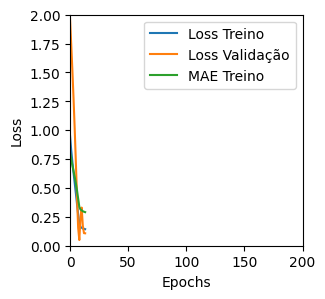

Tempo de treino: 0.049615140755971274 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1550786942243576 , MAE = 0.29813849925994873'

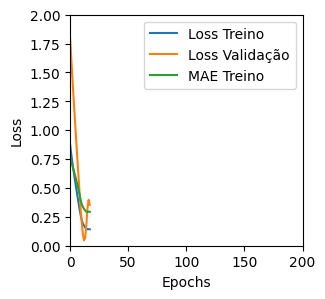

Tempo de treino: 0.044299757480621337 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37994176149368286 , MAE = 0.4431965947151184'

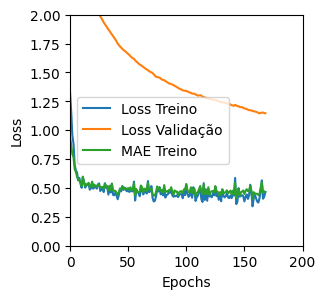

Tempo de treino: 0.3794088323911031 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16006897389888763 , MAE = 0.3152271807193756'

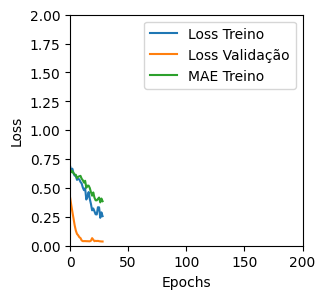

Tempo de treino: 0.06734115680058797 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5154095888137817 , MAE = 0.5497949123382568'

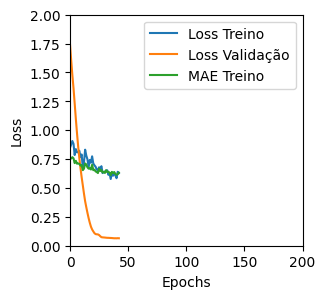

Tempo de treino: 0.10926689306894938 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1974535584449768 , MAE = 0.34279587864875793'

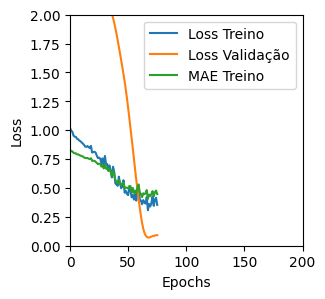

Tempo de treino: 0.06890071630477905 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16216762363910675 , MAE = 0.3061182200908661'

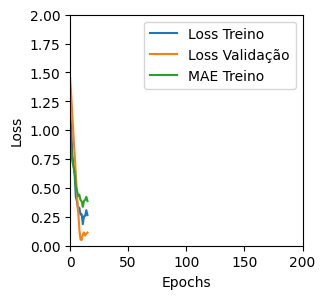

Tempo de treino: 0.06752009391784668 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1697104424238205 , MAE = 0.3045659065246582'

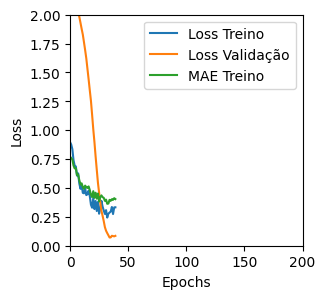

Tempo de treino: 0.11187532742818197 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19639916718006134 , MAE = 0.34569695591926575'

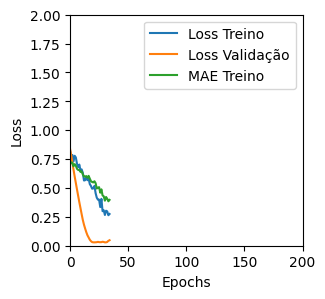

Tempo de treino: 0.06569344600041707 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22162088751792908 , MAE = 0.3615725040435791'

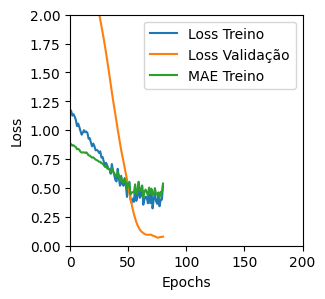

Tempo de treino: 0.09432008266448974 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15539886057376862 , MAE = 0.3013681471347809'

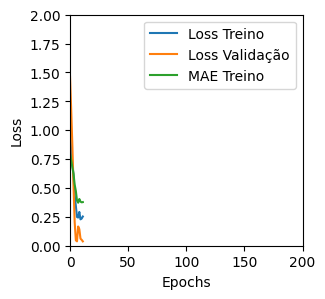

Tempo de treino: 0.04785648981730143 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12257596105337143 , MAE = 0.2643474340438843'

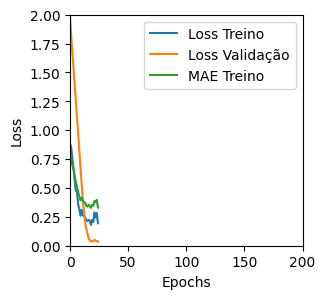

Tempo de treino: 0.06871971686681112 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15549273788928986 , MAE = 0.2935580313205719'

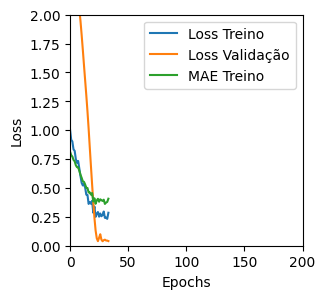

Tempo de treino: 0.06673551797866821 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16946230828762054 , MAE = 0.3059030771255493'

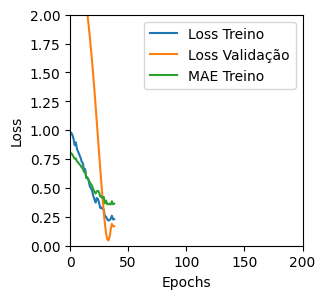

Tempo de treino: 0.06678316990534465 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14341431856155396 , MAE = 0.280132919549942'

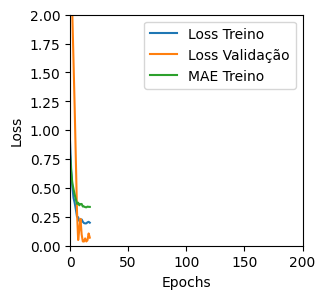

Tempo de treino: 0.06630237897237141 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14175422489643097 , MAE = 0.28007957339286804'

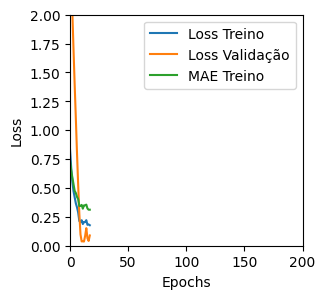

Tempo de treino: 0.05328900416692098 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2058088332414627 , MAE = 0.35258135199546814'

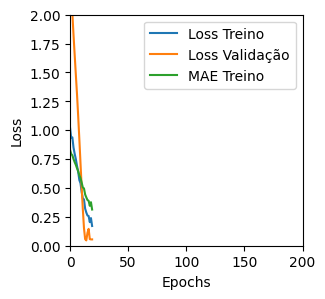

Tempo de treino: 0.04680832624435425 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13873450458049774 , MAE = 0.2748192250728607'

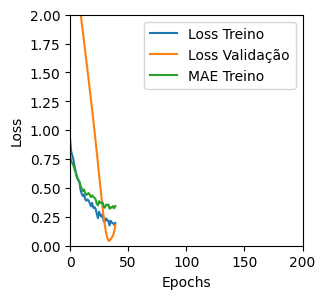

Tempo de treino: 0.0681288480758667 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13195399940013885 , MAE = 0.2718746066093445'

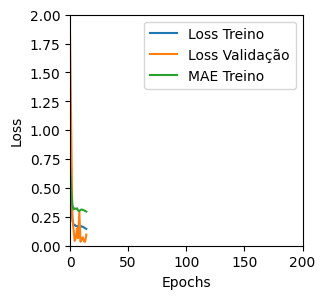

Tempo de treino: 0.06940306822458903 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14344187080860138 , MAE = 0.284710556268692'

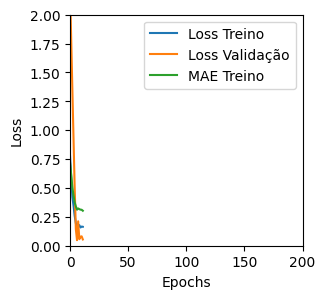

Tempo de treino: 0.03968170483907064 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13272613286972046 , MAE = 0.2739674746990204'

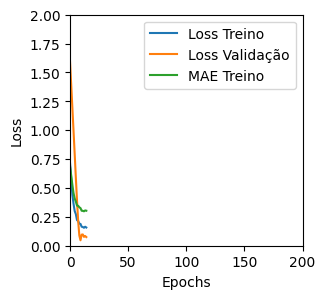

Tempo de treino: 0.04415433406829834 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1474892497062683 , MAE = 0.28469085693359375'

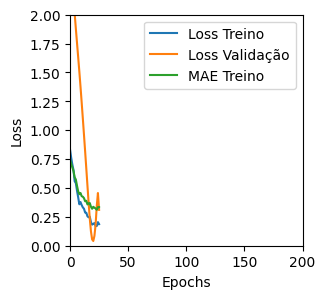

Tempo de treino: 0.06765183210372924 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04539404436945915 , MAE = 0.16399772465229034'

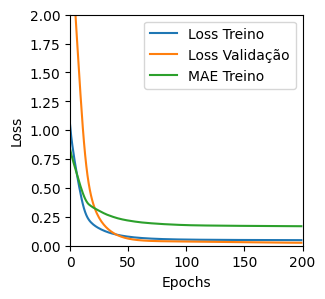

Tempo de treino: 0.7279815077781677 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04849659651517868 , MAE = 0.17064131796360016'

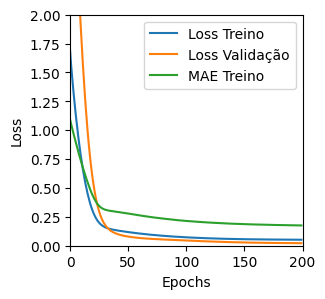

Tempo de treino: 0.26854424079259237 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07580381631851196 , MAE = 0.21604210138320923'

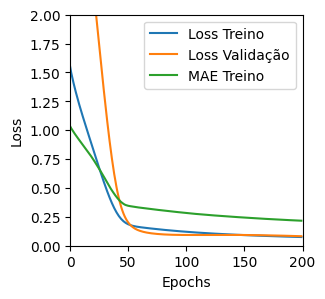

Tempo de treino: 0.20095707178115846 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10763407498598099 , MAE = 0.2642199397087097'

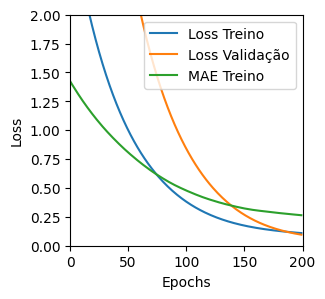

Tempo de treino: 0.20163794755935668 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04329844191670418 , MAE = 0.1599959135055542'

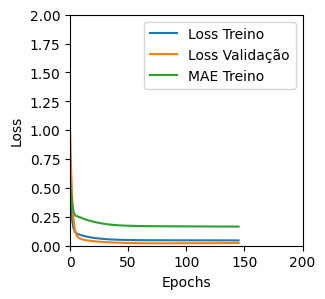

Tempo de treino: 0.37111462354660035 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042909927666187286 , MAE = 0.15870948135852814'

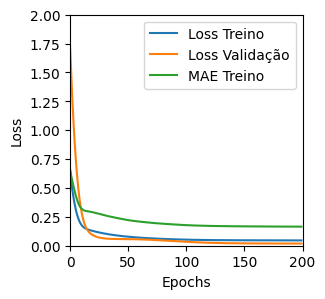

Tempo de treino: 0.37285611232121785 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04869144409894943 , MAE = 0.1738559454679489'

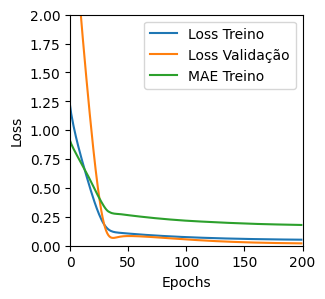

Tempo de treino: 0.19379731019337973 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.059324804693460464 , MAE = 0.19172261655330658'

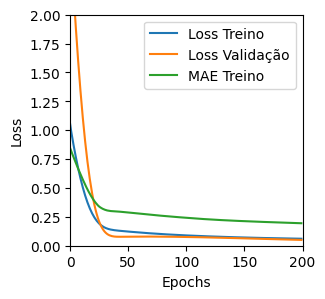

Tempo de treino: 0.16065826018651327 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04681578651070595 , MAE = 0.167959526181221'

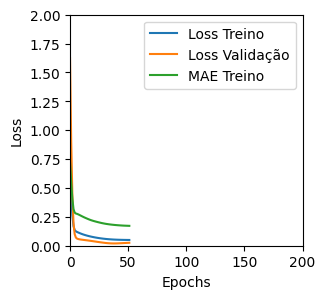

Tempo de treino: 0.2009015162785848 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=6, units=16, batch=8


'TRAINING set. Loss = 0.046981170773506165 , MAE = 0.16677697002887726'

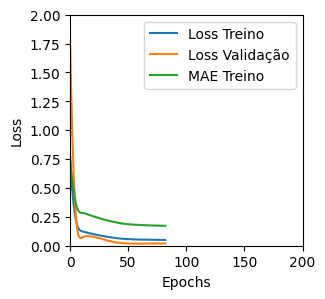

Tempo de treino: 0.14128844340642294 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051595211029052734 , MAE = 0.1752575784921646'

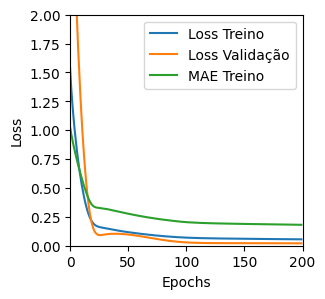

Tempo de treino: 0.1958068609237671 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11433175951242447 , MAE = 0.271668404340744'

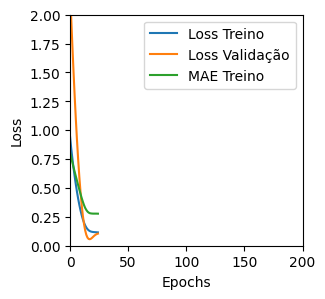

Tempo de treino: 0.05294106403986613 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0643763616681099 , MAE = 0.199029341340065'

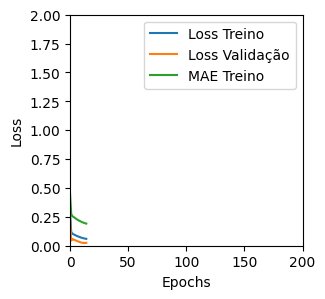

Tempo de treino: 0.06710798343022664 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11876183748245239 , MAE = 0.27008000016212463'

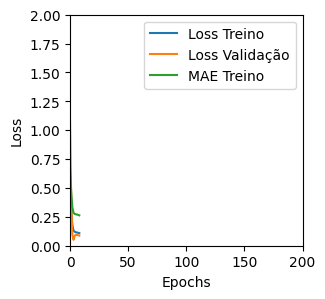

Tempo de treino: 0.07266703446706137 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12387482076883316 , MAE = 0.27859339118003845'

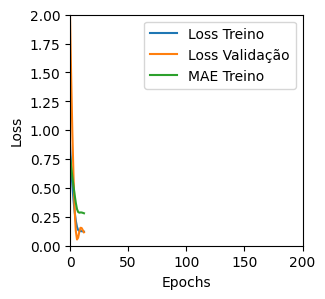

Tempo de treino: 0.05065614779790242 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11471746861934662 , MAE = 0.2667810320854187'

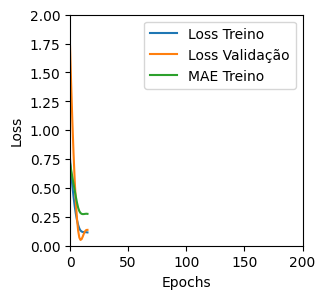

Tempo de treino: 0.05316557884216309 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08237903565168381 , MAE = 0.222789466381073'

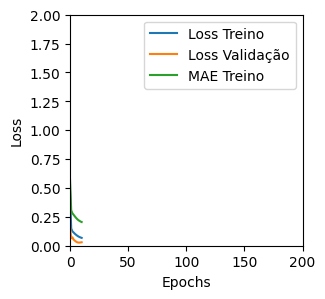

Tempo de treino: 0.07341617345809937 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14949683845043182 , MAE = 0.29762521386146545'

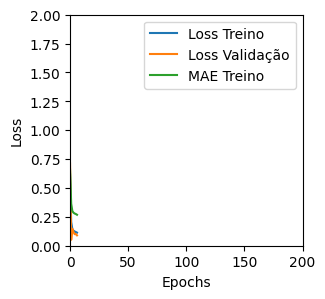

Tempo de treino: 0.06612076759338378 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1527150720357895 , MAE = 0.3043941557407379'

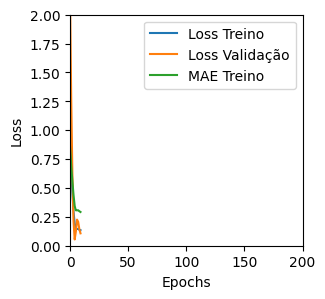

Tempo de treino: 0.05268266201019287 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13756424188613892 , MAE = 0.29078906774520874'

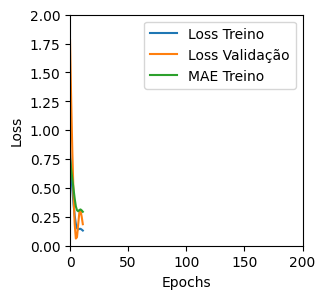

Tempo de treino: 0.05444939136505127 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17146345973014832 , MAE = 0.2946741282939911'

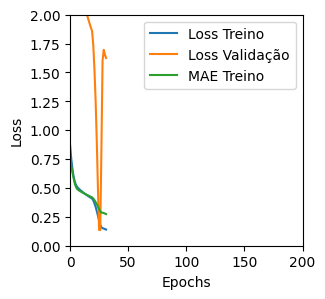

Tempo de treino: 0.0745634118715922 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16492190957069397 , MAE = 0.3099641501903534'

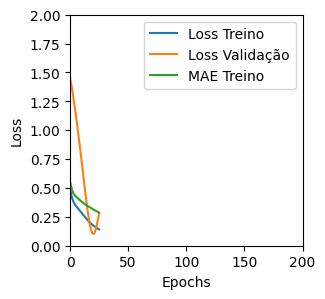

Tempo de treino: 0.06436777512232462 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20287954807281494 , MAE = 0.34740331768989563'

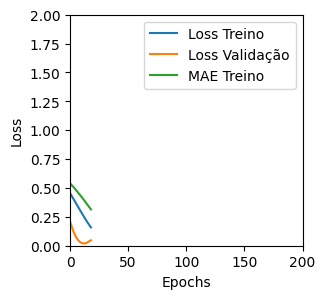

Tempo de treino: 0.046407341957092285 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21836456656455994 , MAE = 0.35391443967819214'

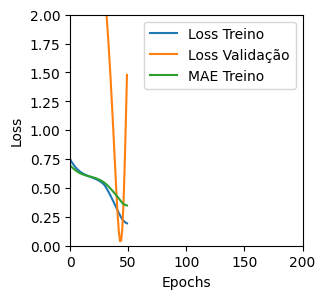

Tempo de treino: 0.07472058137257893 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.152668759226799 , MAE = 0.2783084511756897'

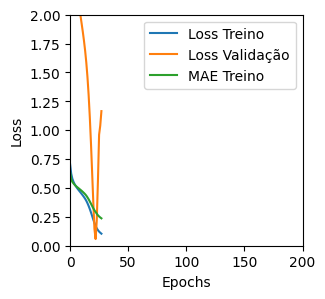

Tempo de treino: 0.10765336354573568 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3080846071243286 , MAE = 0.43084457516670227'

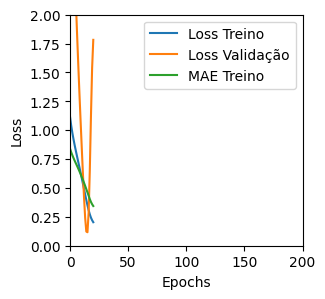

Tempo de treino: 0.04703218539555867 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23506464064121246 , MAE = 0.35950347781181335'

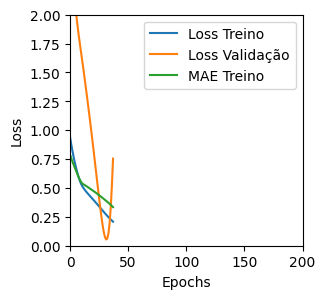

Tempo de treino: 0.062314534187316896 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21661929786205292 , MAE = 0.3333709239959717'

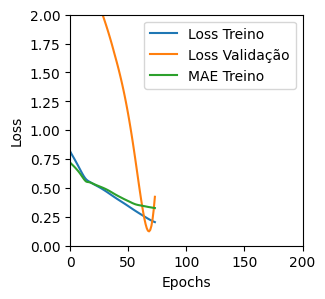

Tempo de treino: 0.1087864875793457 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5521106123924255 , MAE = 0.5795977115631104'

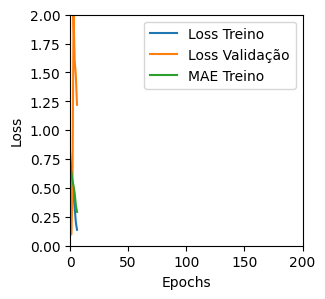

Tempo de treino: 0.034253589312235516 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17924612760543823 , MAE = 0.31416934728622437'

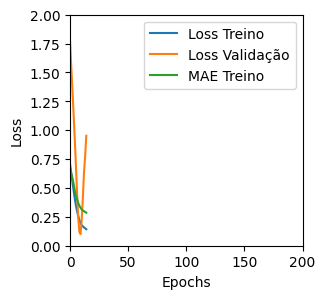

Tempo de treino: 0.04060591856638591 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20638877153396606 , MAE = 0.3349292278289795'

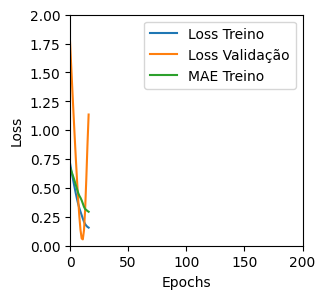

Tempo de treino: 0.051575724283854166 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3227981925010681 , MAE = 0.4292411208152771'

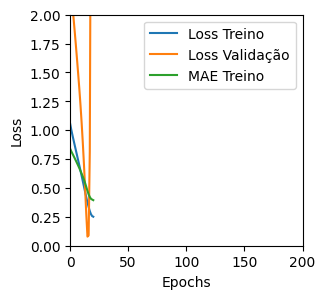

Tempo de treino: 0.050517714023590087 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27396881580352783 , MAE = 0.3985738158226013'

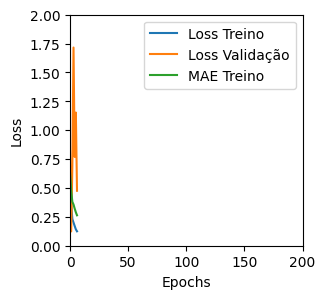

Tempo de treino: 0.04242006540298462 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2361135631799698 , MAE = 0.3574587404727936'

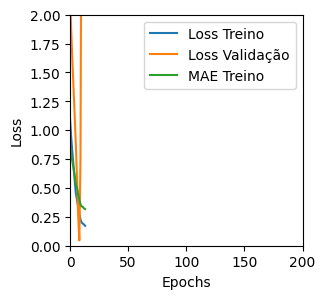

Tempo de treino: 0.03647134701410929 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22446593642234802 , MAE = 0.3518902063369751'

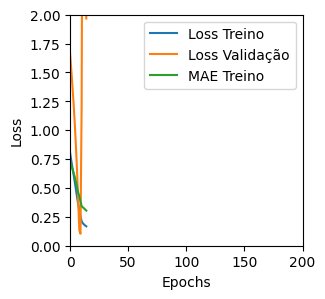

Tempo de treino: 0.03307352463404337 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22927987575531006 , MAE = 0.35129791498184204'

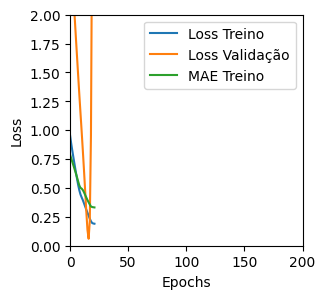

Tempo de treino: 0.04548965295155843 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23721428215503693 , MAE = 0.37255048751831055'

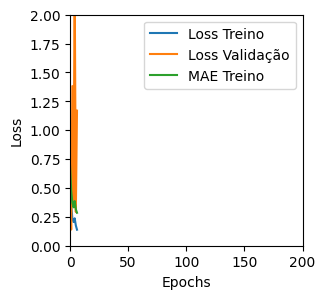

Tempo de treino: 0.04597266912460327 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22857949137687683 , MAE = 0.3504254221916199'

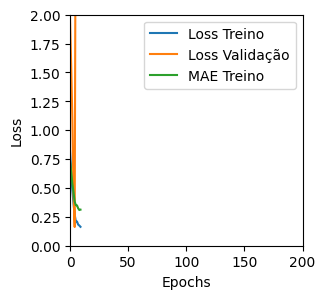

Tempo de treino: 0.0408014973004659 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27993065118789673 , MAE = 0.4016616940498352'

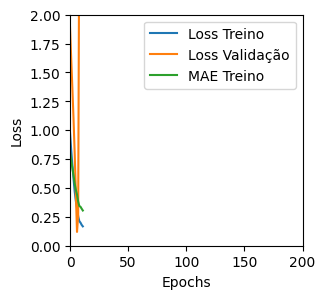

Tempo de treino: 0.04706276257832845 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21658644080162048 , MAE = 0.3366549611091614'

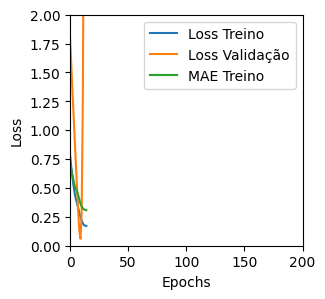

Tempo de treino: 0.03947288592656453 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3313262462615967 , MAE = 0.439444899559021'

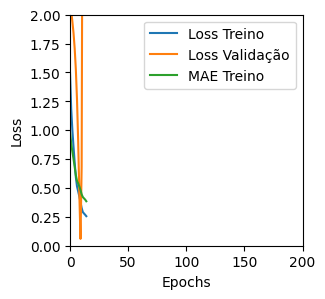

Tempo de treino: 0.05652424494425456 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22511599957942963 , MAE = 0.3292471766471863'

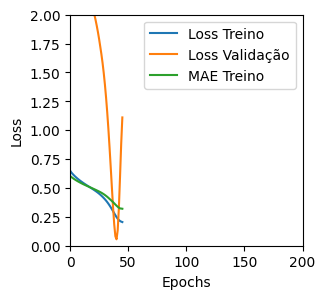

Tempo de treino: 0.06728443702061972 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45487555861473083 , MAE = 0.4851313531398773'

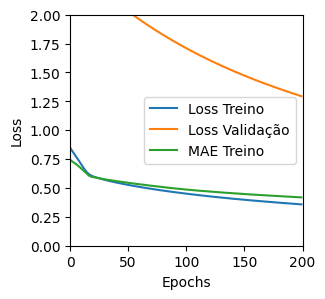

Tempo de treino: 0.19044785896937053 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6766902208328247 , MAE = 0.6262620687484741'

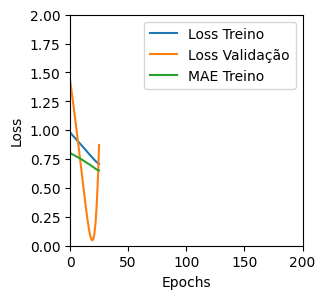

Tempo de treino: 0.042942798137664794 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6391429305076599 , MAE = 0.6168796420097351'

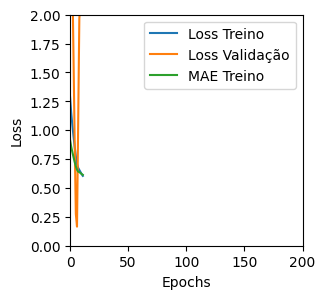

Tempo de treino: 0.041856726010640465 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24456697702407837 , MAE = 0.37537917494773865'

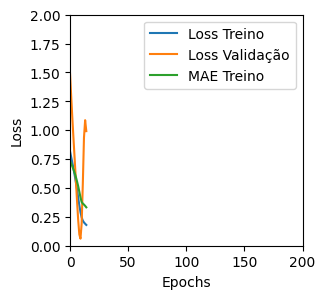

Tempo de treino: 0.04589993556340535 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


'TRAINING set. Loss = 0.24257968366146088 , MAE = 0.35763517022132874'

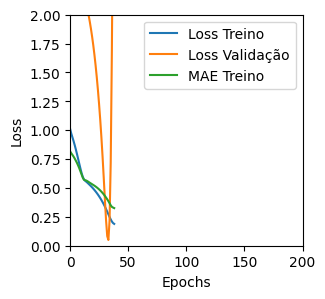

Tempo de treino: 0.0642419179280599 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21782369911670685 , MAE = 0.3505059480667114'

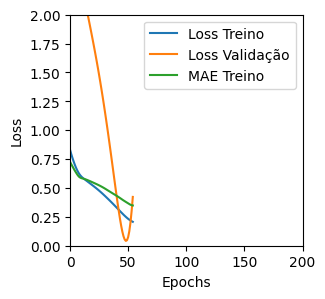

Tempo de treino: 0.06704388459523519 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4160611033439636 , MAE = 0.4990915358066559'

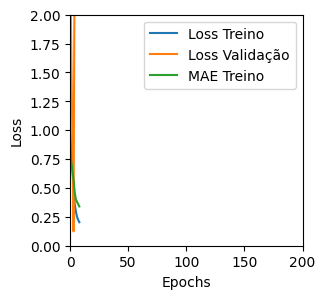

Tempo de treino: 0.04539547761281331 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2174341231584549 , MAE = 0.3361908495426178'

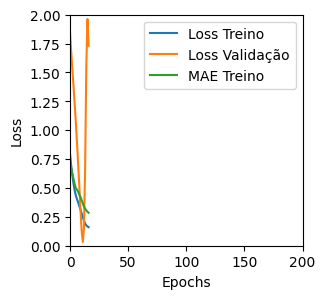

Tempo de treino: 0.041492430369059245 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24732045829296112 , MAE = 0.3673321008682251'

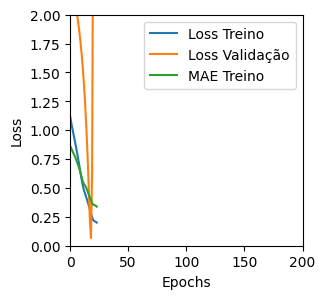

Tempo de treino: 0.04052975177764893 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2309606969356537 , MAE = 0.3621760606765747'

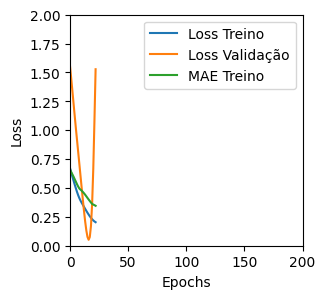

Tempo de treino: 0.044663770993550615 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20086856186389923 , MAE = 0.3218623995780945'

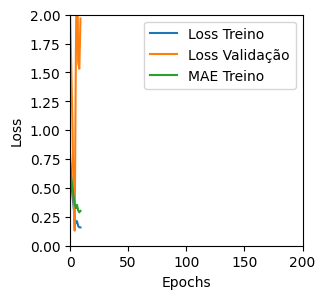

Tempo de treino: 0.06298596461613973 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19780877232551575 , MAE = 0.32895559072494507'

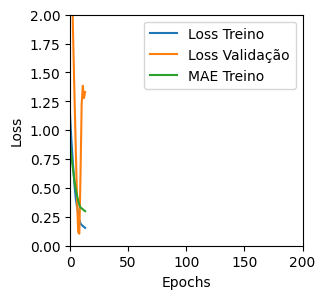

Tempo de treino: 0.05077212651570638 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24942514300346375 , MAE = 0.37847957015037537'

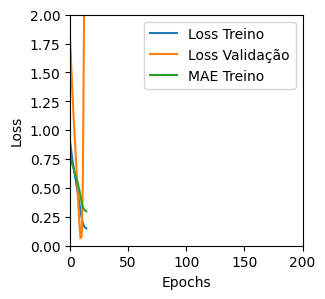

Tempo de treino: 0.03442508379618327 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2954396903514862 , MAE = 0.42129087448120117'

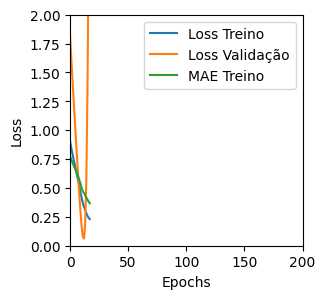

Tempo de treino: 0.039281853040059406 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21933819353580475 , MAE = 0.3417343497276306'

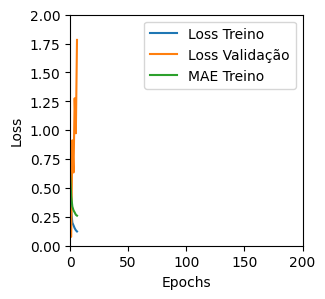

Tempo de treino: 0.063694961865743 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24392502009868622 , MAE = 0.37631627917289734'

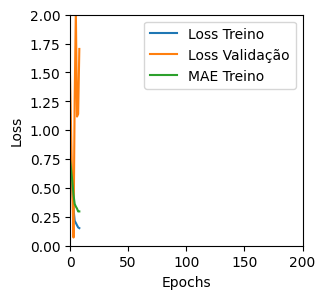

Tempo de treino: 0.04090374310811361 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2998254597187042 , MAE = 0.4177052676677704'

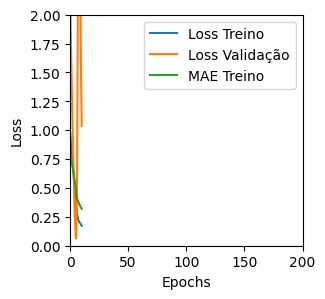

Tempo de treino: 0.04105409781138102 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2631619870662689 , MAE = 0.3955051898956299'

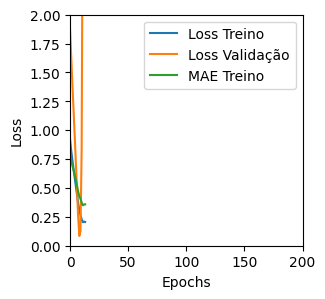

Tempo de treino: 0.036054718494415286 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5090348124504089 , MAE = 0.514890193939209'

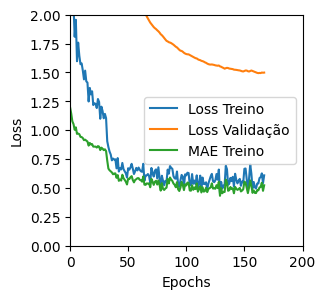

Tempo de treino: 0.37347594896952313 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3026997745037079 , MAE = 0.43100592494010925'

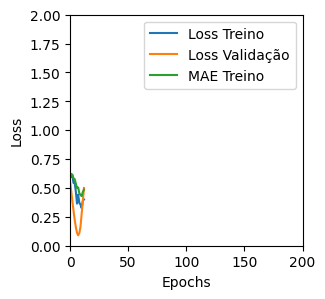

Tempo de treino: 0.04616395632425944 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6369760632514954 , MAE = 0.6122287511825562'

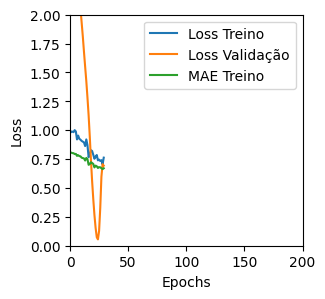

Tempo de treino: 0.050003627936045326 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4898095726966858 , MAE = 0.48418694734573364'

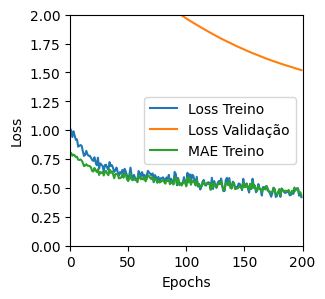

Tempo de treino: 0.16482618649800618 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2658001780509949 , MAE = 0.35962456464767456'

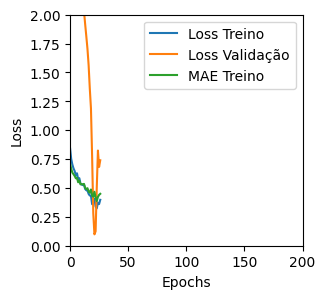

Tempo de treino: 0.10701337655385336 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17987757921218872 , MAE = 0.29682695865631104'

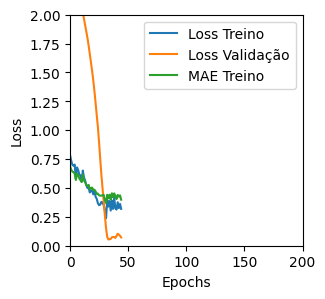

Tempo de treino: 0.07757763465245565 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.225198894739151 , MAE = 0.3541516661643982'

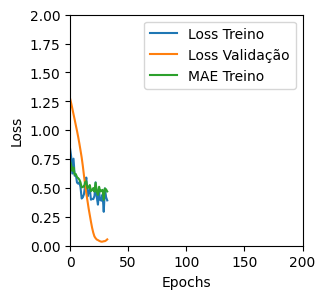

Tempo de treino: 0.06335845788319906 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17706052958965302 , MAE = 0.3112648129463196'

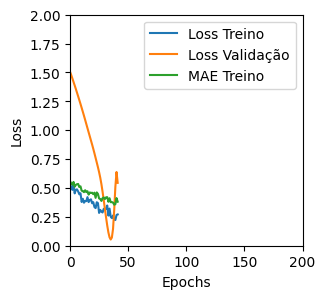

Tempo de treino: 0.05839929183324178 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


'TRAINING set. Loss = 0.26720157265663147 , MAE = 0.3794408142566681'

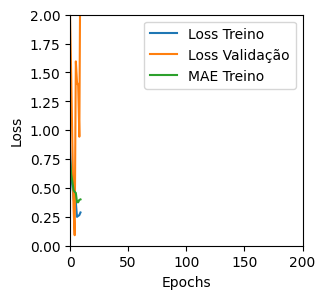

Tempo de treino: 0.05131163994471232 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27018818259239197 , MAE = 0.38938769698143005'

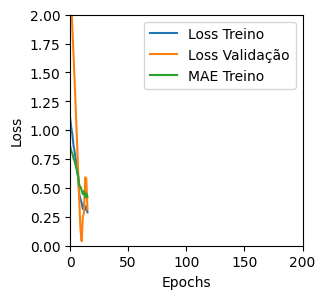

Tempo de treino: 0.04544863700866699 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22134040296077728 , MAE = 0.3518800139427185'

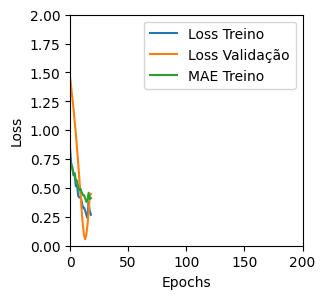

Tempo de treino: 0.038873751958211265 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38012829422950745 , MAE = 0.4780162274837494'

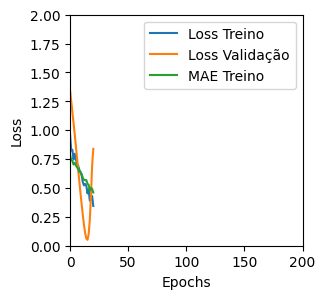

Tempo de treino: 0.0433354655901591 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25263214111328125 , MAE = 0.3696765601634979'

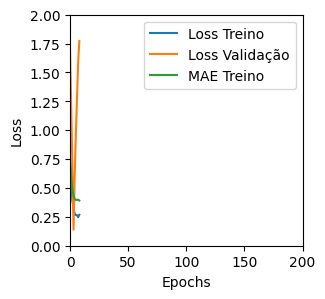

Tempo de treino: 0.0426866888999939 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2759261727333069 , MAE = 0.38451001048088074'

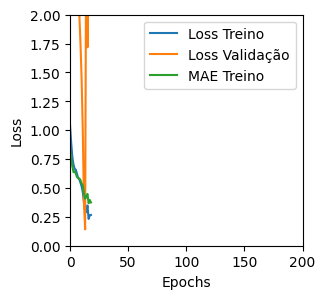

Tempo de treino: 0.06832186381022136 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3140912353992462 , MAE = 0.4188891351222992'

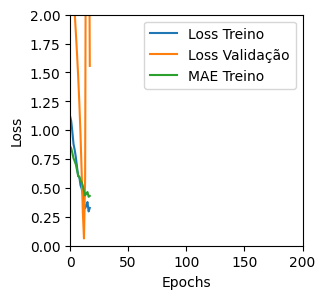

Tempo de treino: 0.04151765505472819 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25177112221717834 , MAE = 0.3782205283641815'

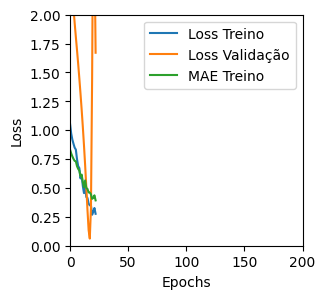

Tempo de treino: 0.08451852798461915 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14045390486717224 , MAE = 0.27156829833984375'

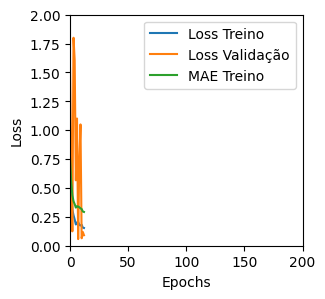

Tempo de treino: 0.07183784643809 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26437127590179443 , MAE = 0.38510170578956604'

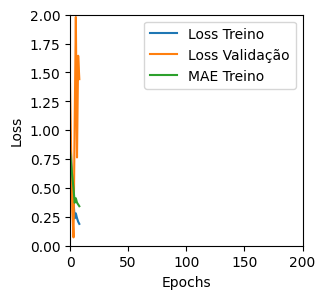

Tempo de treino: 0.04322240352630615 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2685529291629791 , MAE = 0.38840195536613464'

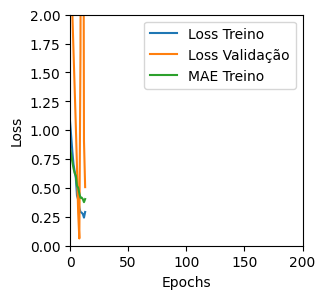

Tempo de treino: 0.041923344135284424 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25359588861465454 , MAE = 0.3822343647480011'

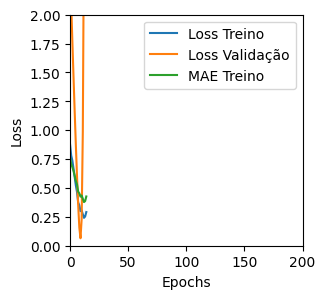

Tempo de treino: 0.039450418949127194 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.057721156626939774 , MAE = 0.1859888881444931'

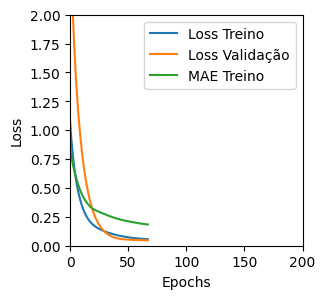

Tempo de treino: 0.2055883208910624 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04940002039074898 , MAE = 0.17297863960266113'

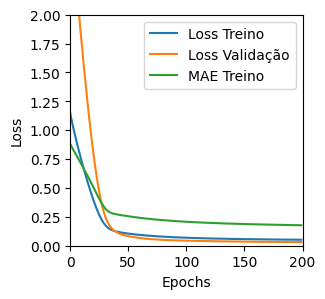

Tempo de treino: 0.23161102930704752 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.060578200966119766 , MAE = 0.19512534141540527'

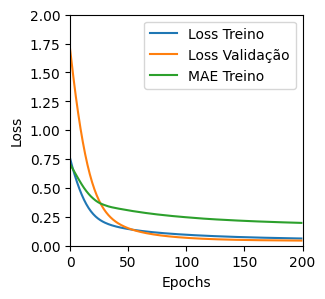

Tempo de treino: 0.20985509157180787 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07130778580904007 , MAE = 0.21232253313064575'

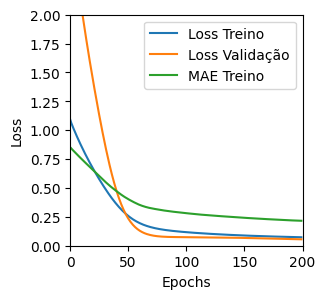

Tempo de treino: 0.20300872723261515 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04081008955836296 , MAE = 0.15361197292804718'

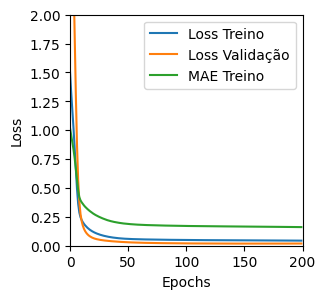

Tempo de treino: 0.7097791115442912 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04885238781571388 , MAE = 0.16805952787399292'

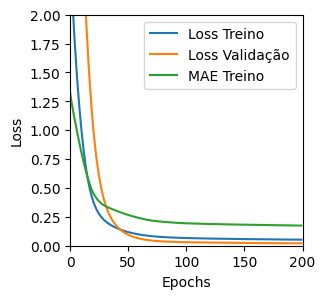

Tempo de treino: 0.23891558249791464 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05341333895921707 , MAE = 0.18133996427059174'

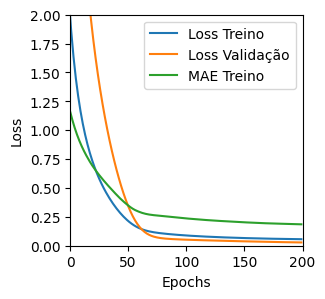

Tempo de treino: 0.21539693276087443 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06540131568908691 , MAE = 0.19529828429222107'

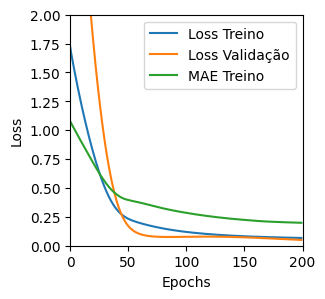

Tempo de treino: 0.1844016432762146 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04180219769477844 , MAE = 0.1559336632490158'

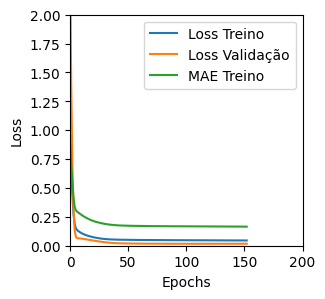

Tempo de treino: 0.3681260625521342 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042063888162374496 , MAE = 0.15741492807865143'

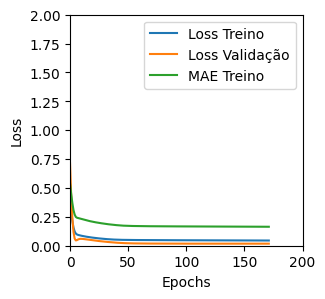

Tempo de treino: 0.3681097904841105 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04565548151731491 , MAE = 0.16320882737636566'

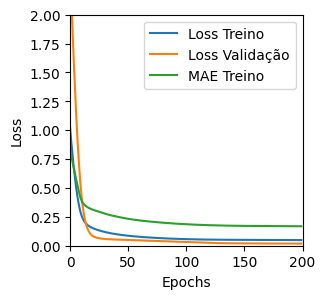

Tempo de treino: 0.19661859273910523 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04779159277677536 , MAE = 0.17071160674095154'

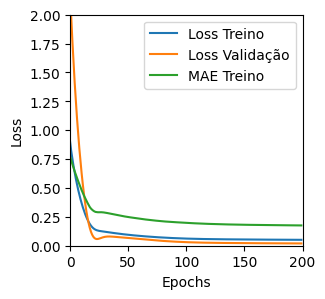

Tempo de treino: 0.39043500820795696 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04036427661776543 , MAE = 0.15066568553447723'

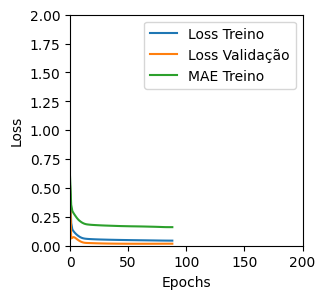

Tempo de treino: 0.2010042905807495 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03930899128317833 , MAE = 0.14990592002868652'

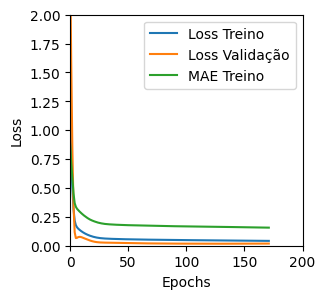

Tempo de treino: 0.3691463033358256 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04333280399441719 , MAE = 0.15820541977882385'

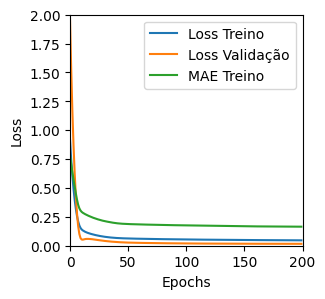

Tempo de treino: 0.18665738900502524 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2046426683664322 , MAE = 0.3559997081756592'

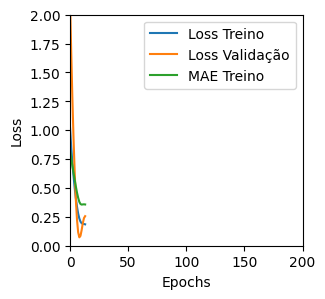

Tempo de treino: 0.05227492252985636 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.040702737867832184 , MAE = 0.15234680473804474'

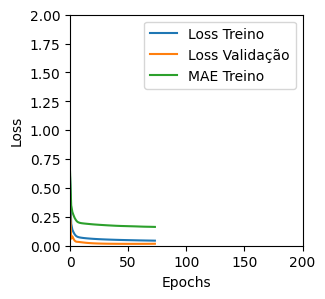

Tempo de treino: 0.3683470646540324 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.043452076613903046 , MAE = 0.1589985340833664'

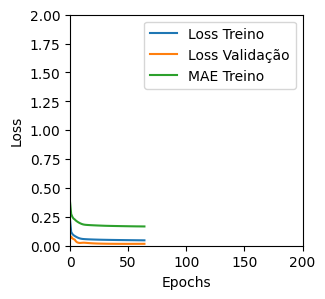

Tempo de treino: 0.1304533044497172 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.192433699965477 , MAE = 0.3442392647266388'

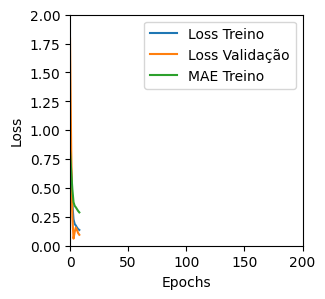

Tempo de treino: 0.041723612944285074 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1604684740304947 , MAE = 0.31713253259658813'

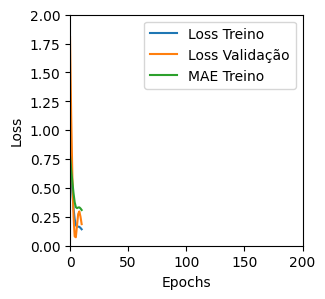

Tempo de treino: 0.05254629850387573 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1503627896308899 , MAE = 0.2811146080493927'

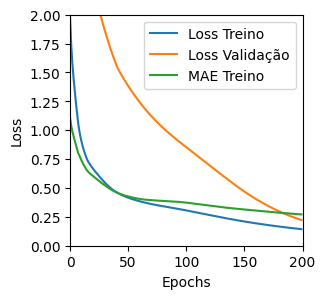

Tempo de treino: 0.6064470887184144 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8317013382911682 , MAE = 0.7032305002212524'

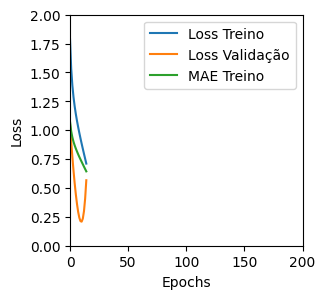

Tempo de treino: 0.06897874275843302 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6698572635650635 , MAE = 0.6386197805404663'

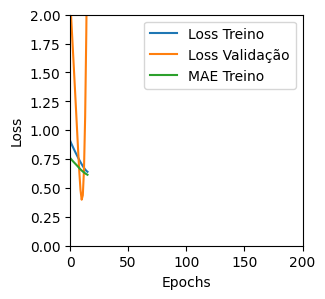

Tempo de treino: 0.06318007707595825 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46483585238456726 , MAE = 0.45036229491233826'

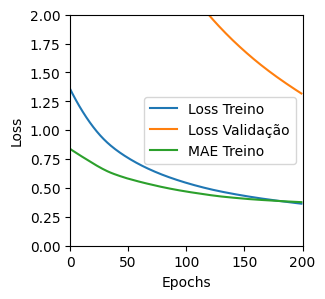

Tempo de treino: 0.1970069169998169 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3249463140964508 , MAE = 0.43674057722091675'

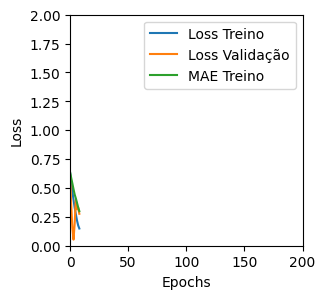

Tempo de treino: 0.06678321361541747 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21201561391353607 , MAE = 0.3421953022480011'

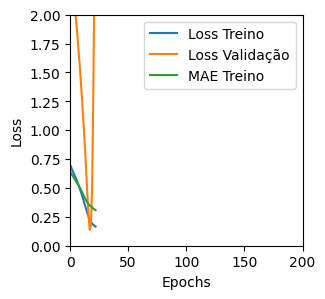

Tempo de treino: 0.06583401362101236 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3265331983566284 , MAE = 0.4123605787754059'

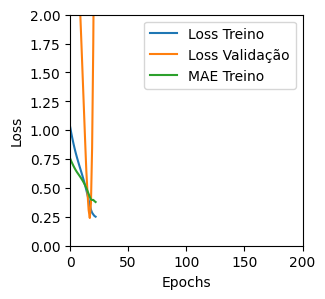

Tempo de treino: 0.06706765095392862 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40821772813796997 , MAE = 0.4872407913208008'

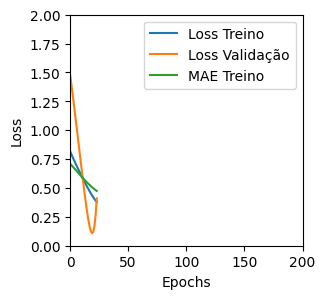

Tempo de treino: 0.06601035594940186 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45871850848197937 , MAE = 0.5060014128684998'

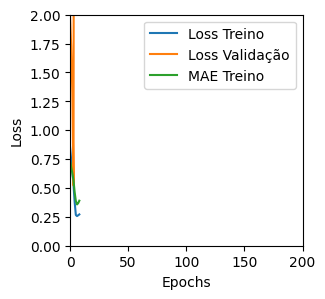

Tempo de treino: 0.06896584828694662 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4183593690395355 , MAE = 0.5058921575546265'

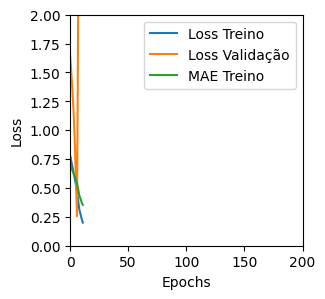

Tempo de treino: 0.0710905114809672 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.647337019443512 , MAE = 0.6262333989143372'

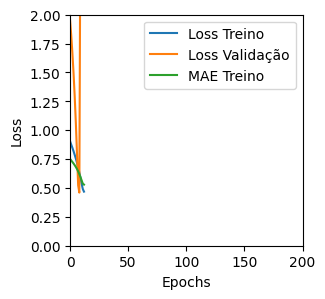

Tempo de treino: 0.052966984113057454 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5215517282485962 , MAE = 0.5600461959838867'

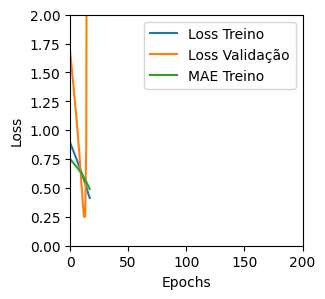

Tempo de treino: 0.04302421808242798 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27779072523117065 , MAE = 0.40255773067474365'

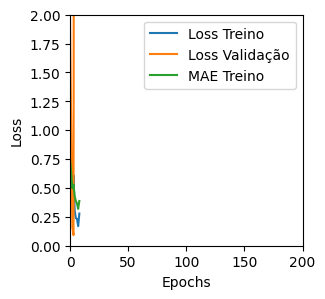

Tempo de treino: 0.05957173506418864 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5039609670639038 , MAE = 0.5496769547462463'

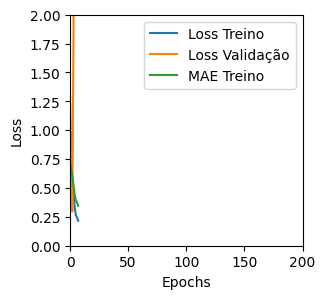

Tempo de treino: 0.047593275705973305 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25802573561668396 , MAE = 0.3669582009315491'

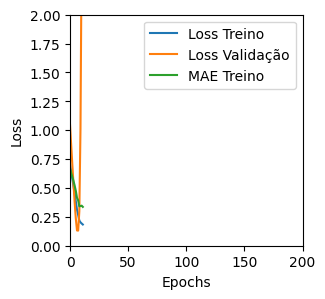

Tempo de treino: 0.046820696194966635 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5587803721427917 , MAE = 0.5747358202934265'

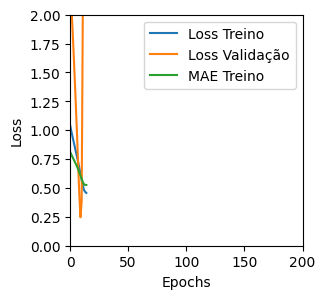

Tempo de treino: 0.040015610059102376 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3325877785682678 , MAE = 0.461197167634964'

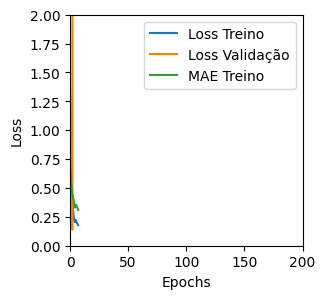

Tempo de treino: 0.08684767882029215 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4593663811683655 , MAE = 0.5206891894340515'

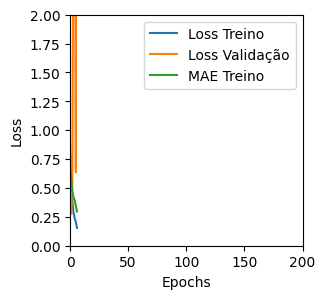

Tempo de treino: 0.051786140600840254 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3609126806259155 , MAE = 0.43315935134887695'

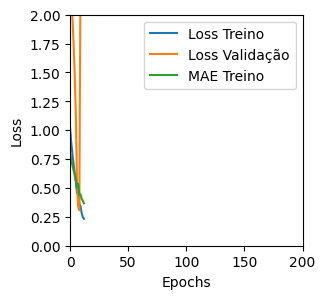

Tempo de treino: 0.0474492351214091 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4829021096229553 , MAE = 0.5245838761329651'

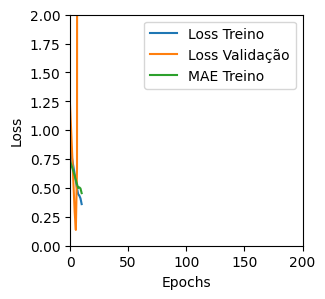

Tempo de treino: 0.045601296424865725 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5982246994972229 , MAE = 0.60556560754776'

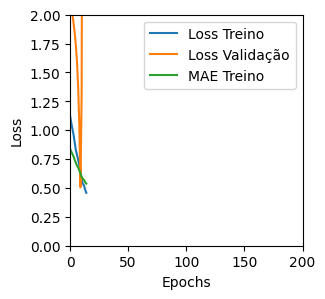

Tempo de treino: 0.07587383190790813 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.282401978969574 , MAE = 0.3997860252857208'

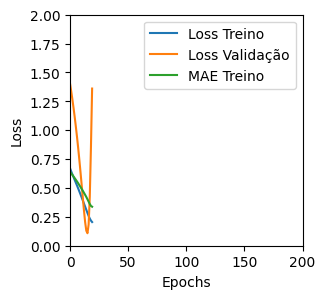

Tempo de treino: 0.06992219686508179 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2535194754600525 , MAE = 0.38569849729537964'

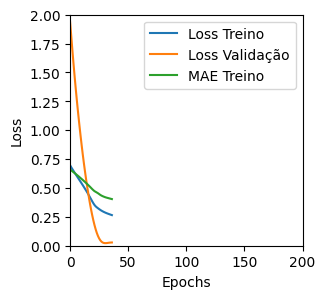

Tempo de treino: 0.061940391858418785 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17135025560855865 , MAE = 0.3228469789028168'

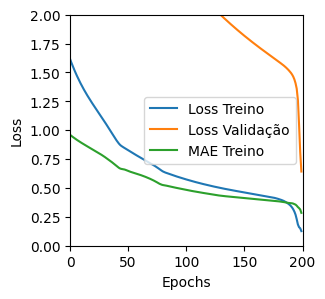

Tempo de treino: 0.3800026973088582 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31106507778167725 , MAE = 0.42820602655410767'

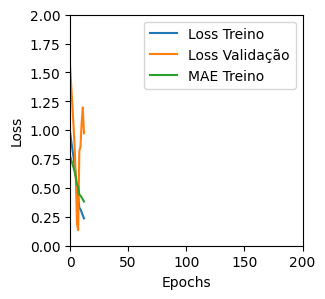

Tempo de treino: 0.1143379807472229 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3058890700340271 , MAE = 0.4283190369606018'

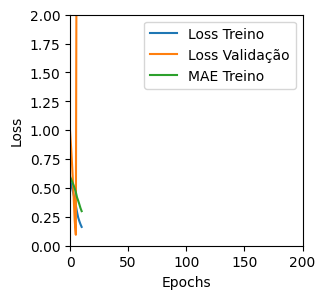

Tempo de treino: 0.046839022636413576 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3599426746368408 , MAE = 0.4563680589199066'

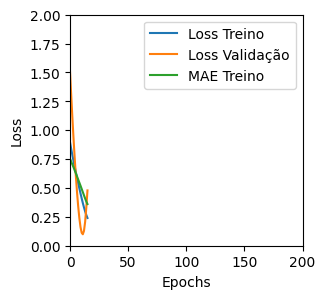

Tempo de treino: 0.046440056959788006 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4503974914550781 , MAE = 0.4568725526332855'

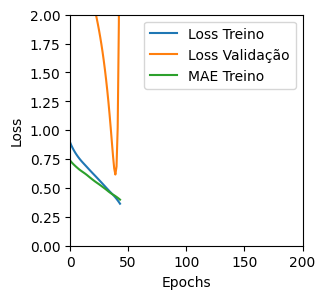

Tempo de treino: 0.11068758964538575 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42455828189849854 , MAE = 0.5099318027496338'

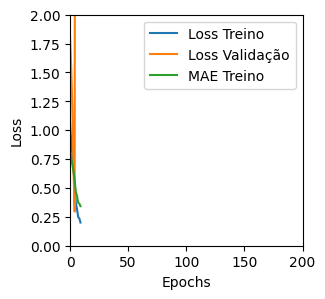

Tempo de treino: 0.058143246173858645 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5009886622428894 , MAE = 0.5341904759407043'

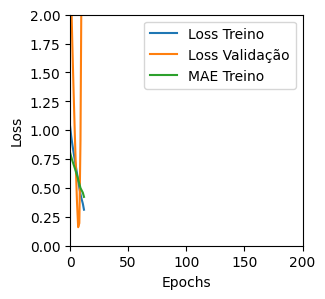

Tempo de treino: 0.06816019614537557 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3003446161746979 , MAE = 0.42968904972076416'

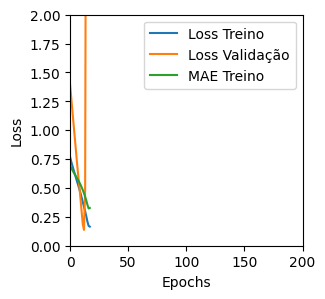

Tempo de treino: 0.07530685663223266 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45315054059028625 , MAE = 0.5109805464744568'

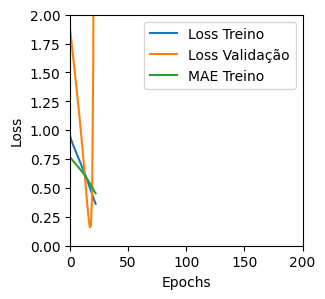

Tempo de treino: 0.04751887321472168 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47916388511657715 , MAE = 0.5295441746711731'

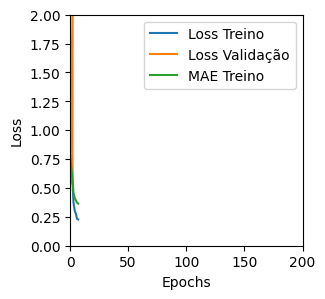

Tempo de treino: 0.05622000296910604 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38155171275138855 , MAE = 0.47832992672920227'

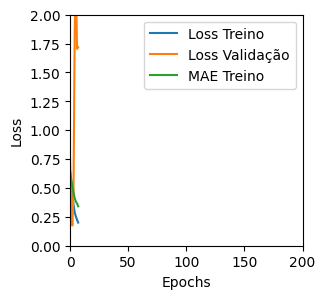

Tempo de treino: 0.049995704491933184 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40306606888771057 , MAE = 0.48711133003234863'

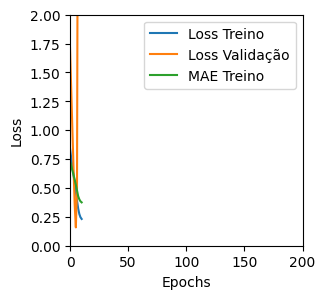

Tempo de treino: 0.0402094562848409 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5321516394615173 , MAE = 0.5541266798973083'

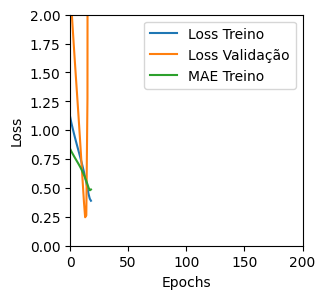

Tempo de treino: 0.042180848121643064 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2733584940433502 , MAE = 0.3887156844139099'

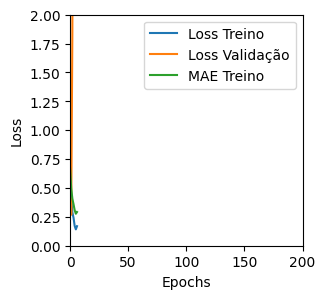

Tempo de treino: 0.08271679878234864 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3716639578342438 , MAE = 0.4651842713356018'

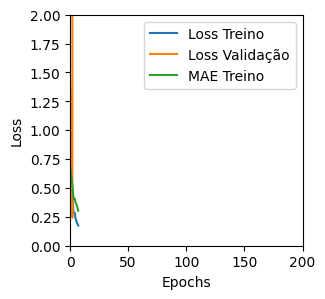

Tempo de treino: 0.0508846640586853 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3551025986671448 , MAE = 0.4452337622642517'

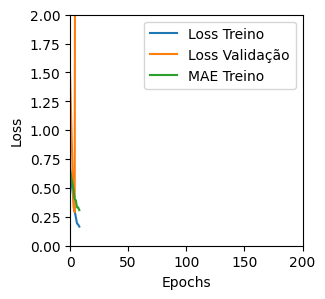

Tempo de treino: 0.0405309796333313 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4403916895389557 , MAE = 0.5014912486076355'

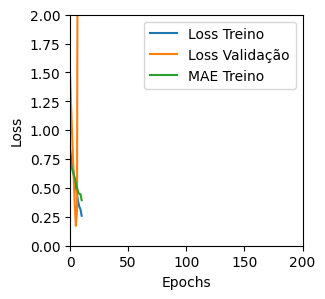

Tempo de treino: 0.03843607505162557 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6305521130561829 , MAE = 0.6007551550865173'

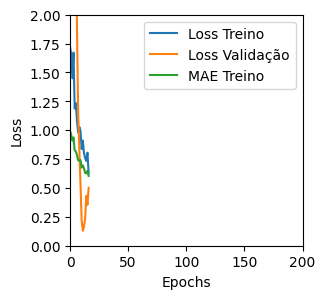

Tempo de treino: 0.11321598291397095 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47241875529289246 , MAE = 0.5166911482810974'

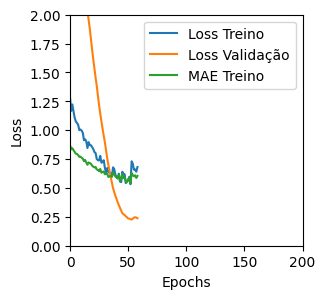

Tempo de treino: 0.12466322978337606 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4793165326118469 , MAE = 0.48519188165664673'

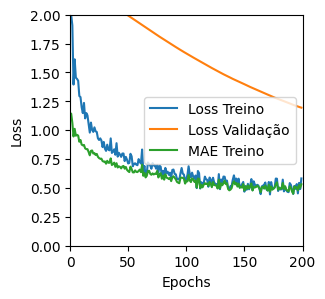

Tempo de treino: 0.2431291143099467 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5228260159492493 , MAE = 0.545030415058136'

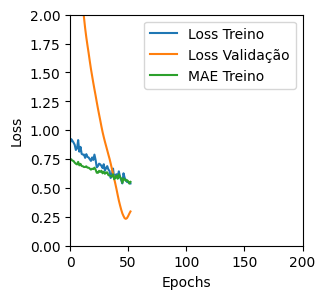

Tempo de treino: 0.12758956750233968 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7722628712654114 , MAE = 0.6894458532333374'

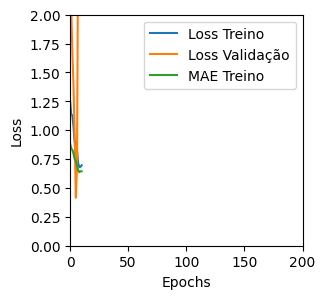

Tempo de treino: 0.07829731305440267 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2838159501552582 , MAE = 0.37010660767555237'

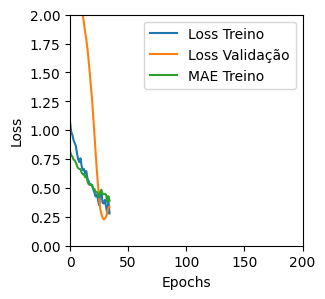

Tempo de treino: 0.08922654787699381 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3961777687072754 , MAE = 0.48240479826927185'

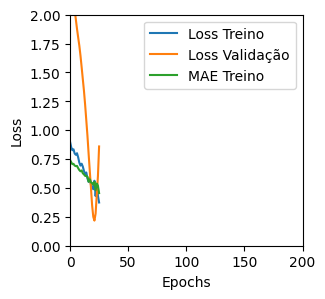

Tempo de treino: 0.06442968050638835 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18403877317905426 , MAE = 0.3274837136268616'

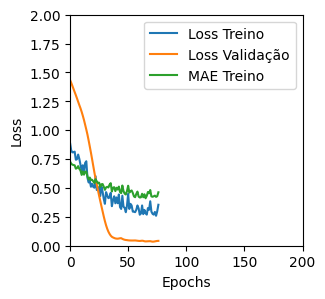

Tempo de treino: 0.1102422555287679 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21192578971385956 , MAE = 0.3445017635822296'

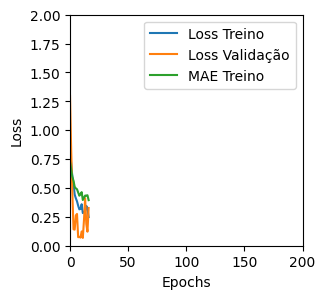

Tempo de treino: 0.11266852617263794 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5000165700912476 , MAE = 0.5439332723617554'

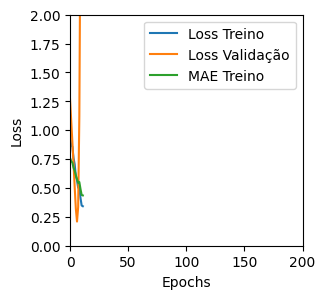

Tempo de treino: 0.08575214942296346 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4109025001525879 , MAE = 0.47867336869239807'

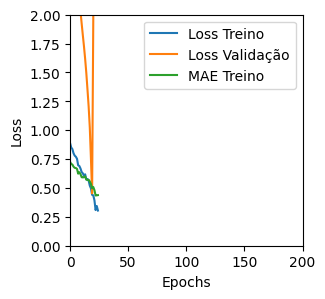

Tempo de treino: 0.07112338542938232 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5979012846946716 , MAE = 0.5831083655357361'

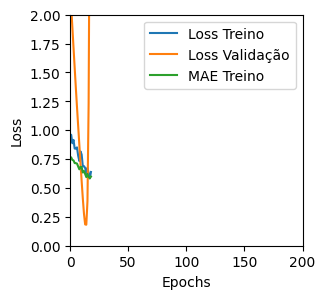

Tempo de treino: 0.04696271419525146 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10830139368772507 , MAE = 0.23024903237819672'

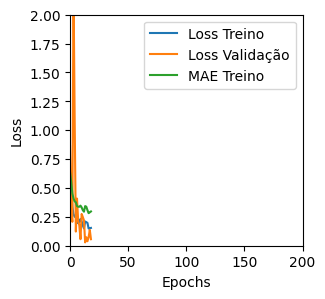

Tempo de treino: 0.09217860301335652 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3247987627983093 , MAE = 0.4318039119243622'

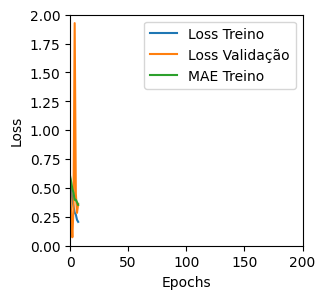

Tempo de treino: 0.06793878475824992 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34751054644584656 , MAE = 0.45080357789993286'

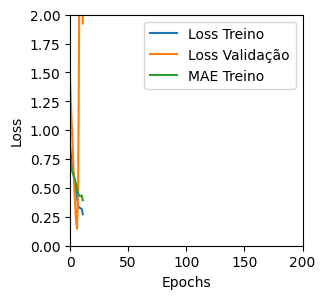

Tempo de treino: 0.039582423369089764 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5587493777275085 , MAE = 0.5772897005081177'

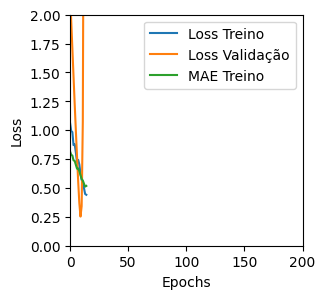

Tempo de treino: 0.04561863740285237 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.212333083152771 , MAE = 0.33555886149406433'

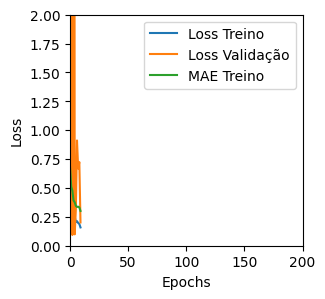

Tempo de treino: 0.13418498039245605 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36537858843803406 , MAE = 0.45089003443717957'

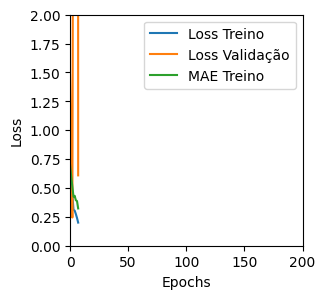

Tempo de treino: 0.049019801616668704 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30268070101737976 , MAE = 0.41758236289024353'

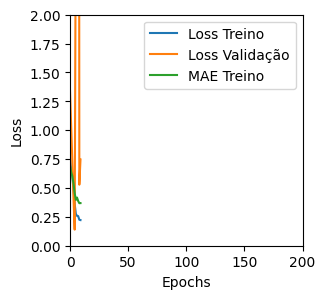

Tempo de treino: 0.04425523281097412 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37763550877571106 , MAE = 0.46516677737236023'

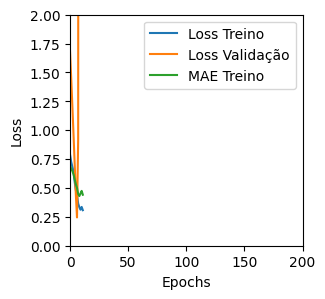

Tempo de treino: 0.048256345589955646 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04875912144780159 , MAE = 0.17136137187480927'

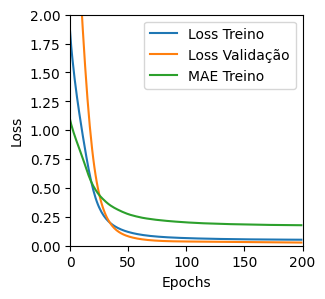

Tempo de treino: 0.7205822547276814 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10798665881156921 , MAE = 0.26027411222457886'

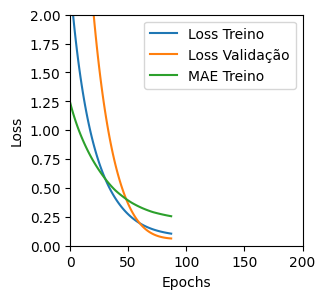

Tempo de treino: 0.21849276224772135 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07447237521409988 , MAE = 0.21982693672180176'

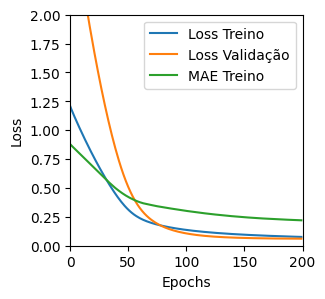

Tempo de treino: 0.3832918326059977 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12524409592151642 , MAE = 0.27770212292671204'

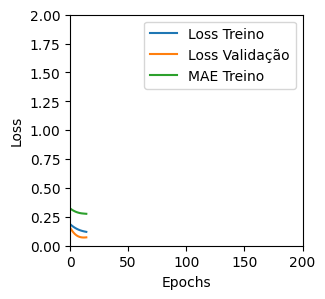

Tempo de treino: 0.08241686423619589 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0449148565530777 , MAE = 0.16278649866580963'

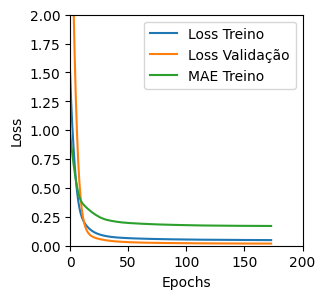

Tempo de treino: 0.721430778503418 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046017199754714966 , MAE = 0.164499431848526'

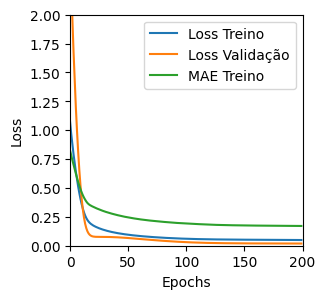

Tempo de treino: 0.39785443941752113 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12512265145778656 , MAE = 0.27895015478134155'

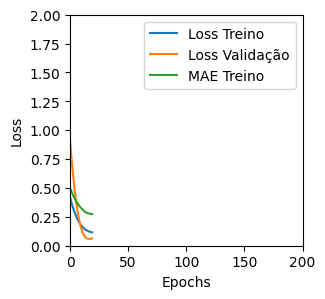

Tempo de treino: 0.09086979230244954 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07337544113397598 , MAE = 0.21032661199569702'

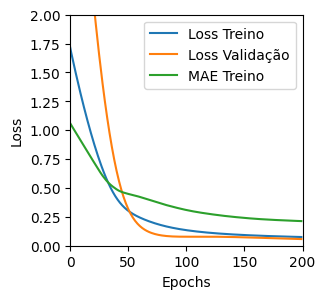

Tempo de treino: 0.21857584714889527 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04414735734462738 , MAE = 0.1609991192817688'

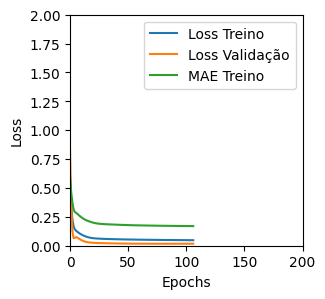

Tempo de treino: 0.40528159141540526 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12767243385314941 , MAE = 0.28489649295806885'

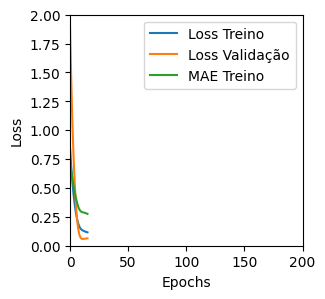

Tempo de treino: 0.07890770037968954 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18157093226909637 , MAE = 0.3345348834991455'

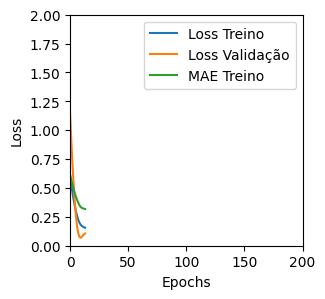

Tempo de treino: 0.09493370453516642 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1752786934375763 , MAE = 0.34331679344177246'

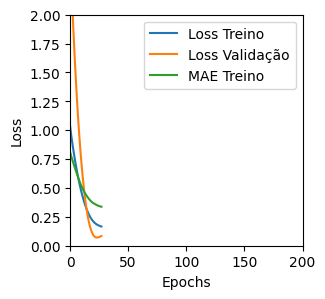

Tempo de treino: 0.07669664621353149 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0406823568046093 , MAE = 0.1534436047077179'

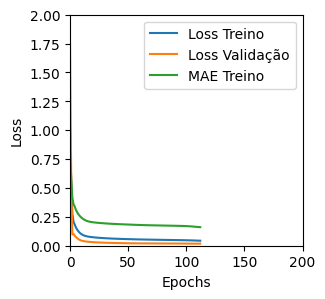

Tempo de treino: 0.7219839731852213 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0433930978178978 , MAE = 0.15995147824287415'

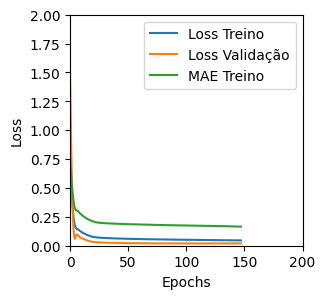

Tempo de treino: 0.3428345561027527 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15338483452796936 , MAE = 0.30045342445373535'

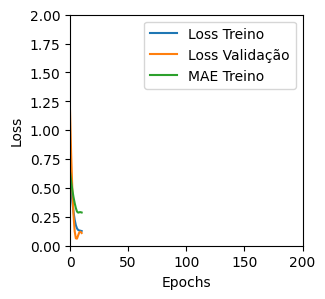

Tempo de treino: 0.0551873246828715 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27092641592025757 , MAE = 0.411944180727005'

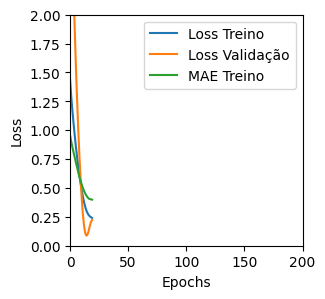

Tempo de treino: 0.0789323886235555 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04806246981024742 , MAE = 0.16917292773723602'

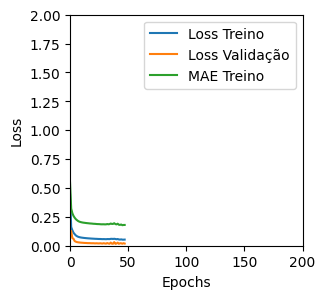

Tempo de treino: 0.37993353605270386 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04601924866437912 , MAE = 0.16437914967536926'

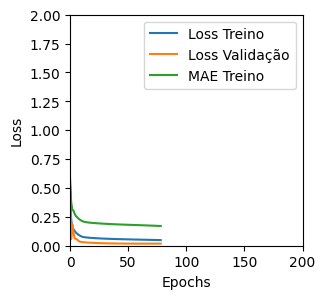

Tempo de treino: 0.37355520725250246 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0501515194773674 , MAE = 0.17137618362903595'

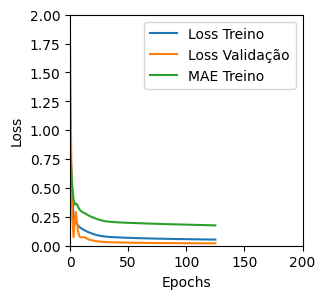

Tempo de treino: 0.37195510069529214 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21782082319259644 , MAE = 0.36275503039360046'

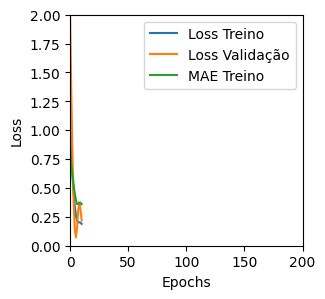

Tempo de treino: 0.07012023131052653 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5279311537742615 , MAE = 0.5268377065658569'

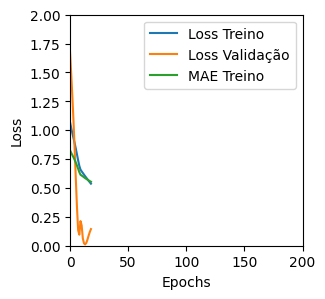

Tempo de treino: 0.10365883509318034 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4124436378479004 , MAE = 0.5041165947914124'

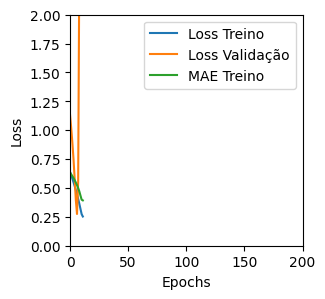

Tempo de treino: 0.05364521344502767 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32086148858070374 , MAE = 0.42711204290390015'

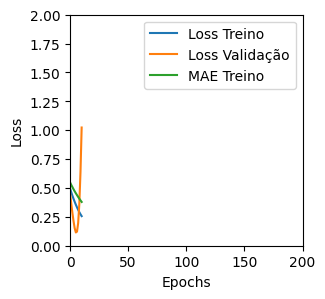

Tempo de treino: 0.046602765719095864 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5669090747833252 , MAE = 0.5156105160713196'

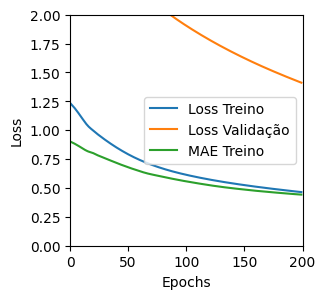

Tempo de treino: 0.19504479964574178 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3540288805961609 , MAE = 0.45687174797058105'

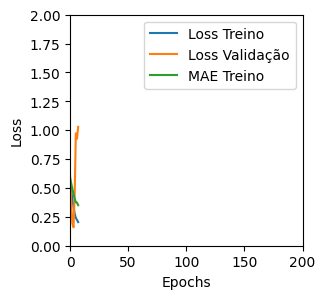

Tempo de treino: 0.0665453831354777 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38095909357070923 , MAE = 0.44353002309799194'

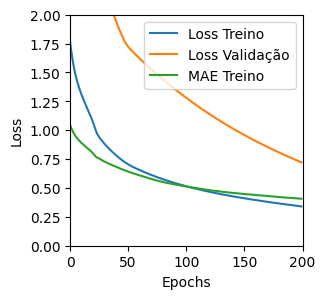

Tempo de treino: 0.7205979426701864 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3834407925605774 , MAE = 0.4604952335357666'

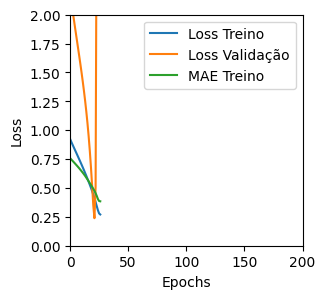

Tempo de treino: 0.0730806271235148 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36981040239334106 , MAE = 0.4681873023509979'

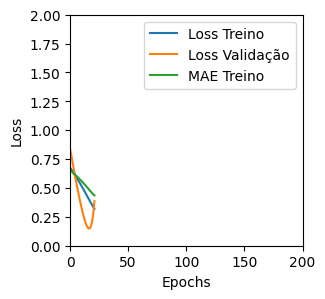

Tempo de treino: 0.04866459369659424 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2842444181442261 , MAE = 0.4049556851387024'

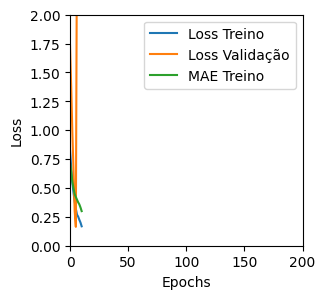

Tempo de treino: 0.06808883746465047 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3060503602027893 , MAE = 0.399413526058197'

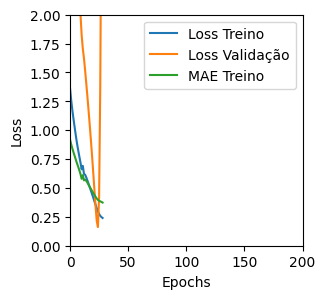

Tempo de treino: 0.09373811483383179 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5359458327293396 , MAE = 0.5637343525886536'

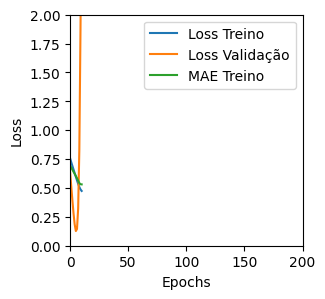

Tempo de treino: 0.03994017839431763 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24392026662826538 , MAE = 0.367934912443161'

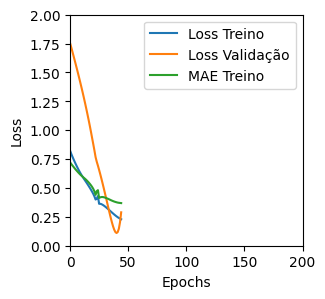

Tempo de treino: 0.0680700659751892 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11680669337511063 , MAE = 0.2533435523509979'

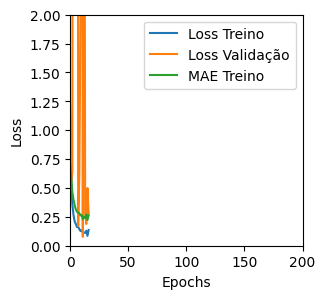

Tempo de treino: 0.12645103931427001 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5473493337631226 , MAE = 0.5729761719703674'

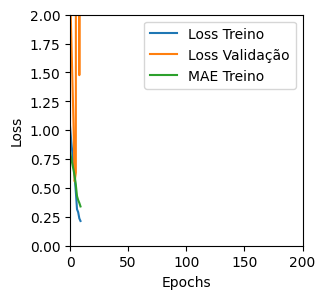

Tempo de treino: 0.05490256150563558 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5563557147979736 , MAE = 0.5713072419166565'

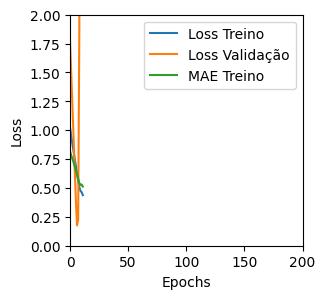

Tempo de treino: 0.05092916488647461 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47788238525390625 , MAE = 0.5432848930358887'

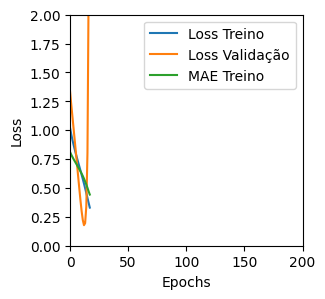

Tempo de treino: 0.047315669059753415 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3663310408592224 , MAE = 0.4603014290332794'

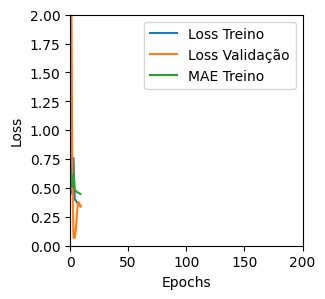

Tempo de treino: 0.1125443696975708 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5185927152633667 , MAE = 0.551457941532135'

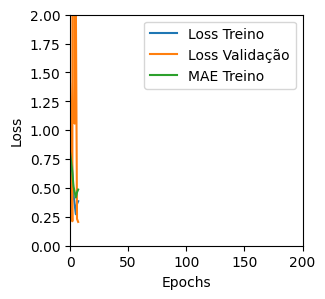

Tempo de treino: 0.06937292416890463 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3674933910369873 , MAE = 0.4749588966369629'

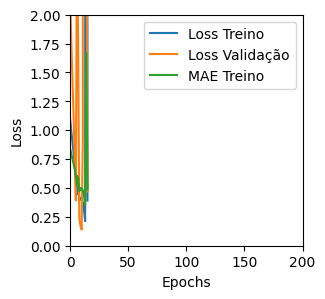

Tempo de treino: 0.0501474658648173 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44318336248397827 , MAE = 0.5017617344856262'

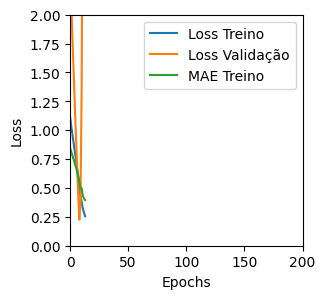

Tempo de treino: 0.05865248441696167 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4806973338127136 , MAE = 0.4685925841331482'

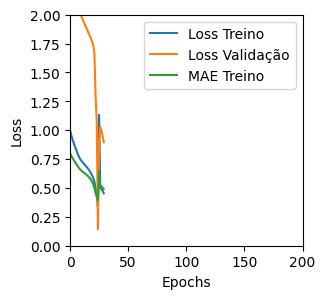

Tempo de treino: 0.20725043614705405 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24947142601013184 , MAE = 0.3383964002132416'

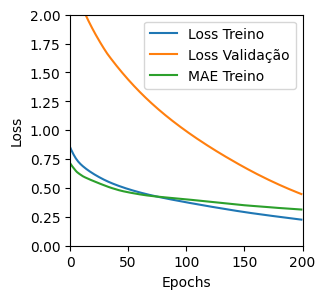

Tempo de treino: 0.7119403680165609 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5234005451202393 , MAE = 0.5105477571487427'

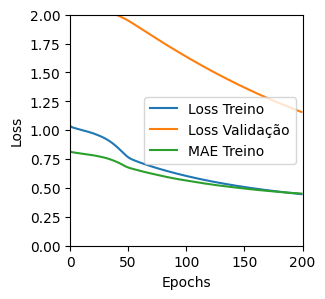

Tempo de treino: 0.29364505608876545 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5562017560005188 , MAE = 0.508286714553833'

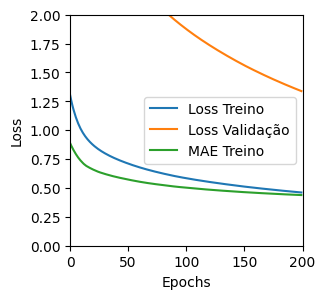

Tempo de treino: 0.366326908270518 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5885233283042908 , MAE = 0.5691438317298889'

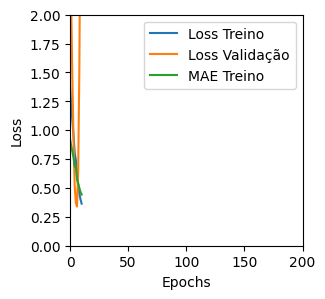

Tempo de treino: 0.0656738042831421 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6499330997467041 , MAE = 0.6346248984336853'

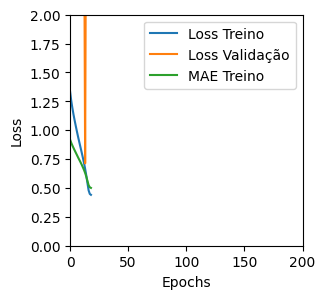

Tempo de treino: 0.0668253779411316 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9472851753234863 , MAE = 0.7526333332061768'

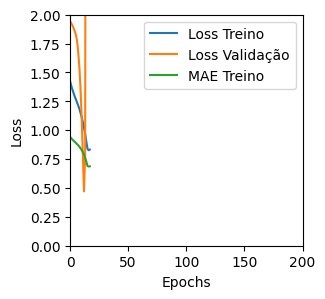

Tempo de treino: 0.05588163137435913 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3742593824863434 , MAE = 0.44122862815856934'

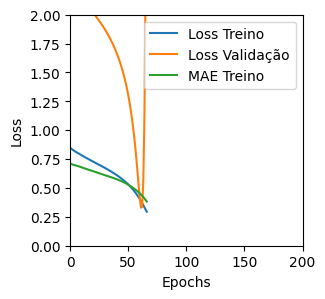

Tempo de treino: 0.1291932702064514 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4441075325012207 , MAE = 0.4851674735546112'

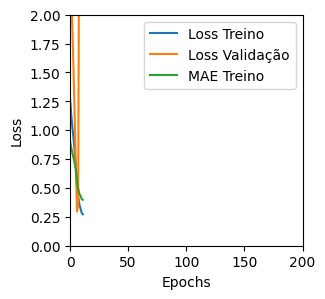

Tempo de treino: 0.08122118711471557 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3044014573097229 , MAE = 0.4047014117240906'

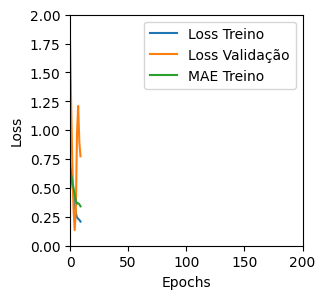

Tempo de treino: 0.050104725360870364 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6477158665657043 , MAE = 0.600647509098053'

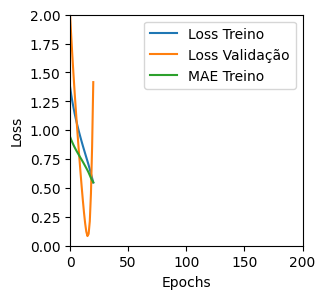

Tempo de treino: 0.05375008583068848 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22313542664051056 , MAE = 0.3457239866256714'

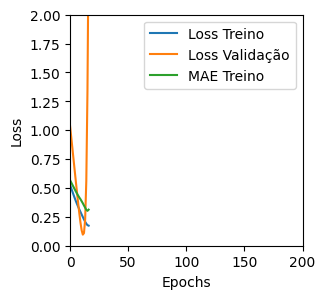

Tempo de treino: 0.07094852526982626 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5268690586090088 , MAE = 0.558551013469696'

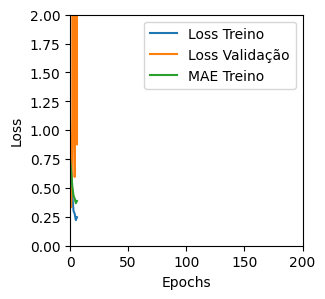

Tempo de treino: 0.055332807699839275 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45267584919929504 , MAE = 0.5126901268959045'

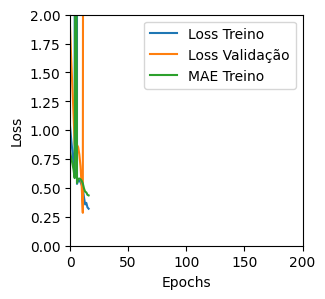

Tempo de treino: 0.06333040396372477 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49197787046432495 , MAE = 0.5507127642631531'

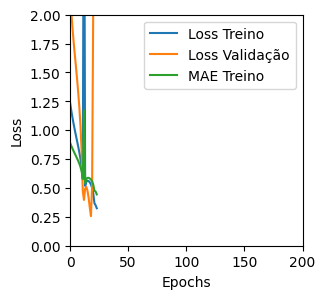

Tempo de treino: 0.08500567674636841 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31165316700935364 , MAE = 0.42068013548851013'

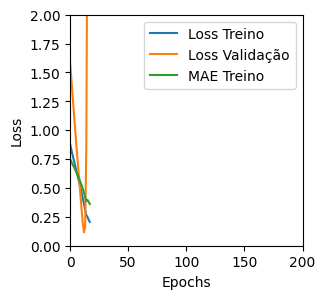

Tempo de treino: 0.07042323350906372 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18872034549713135 , MAE = 0.3129805624485016'

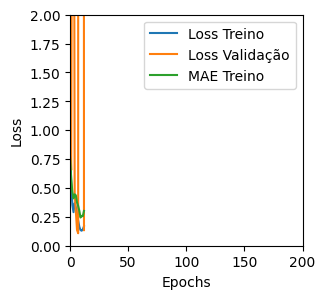

Tempo de treino: 0.11366897026697795 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.333598256111145 , MAE = 0.4330195486545563'

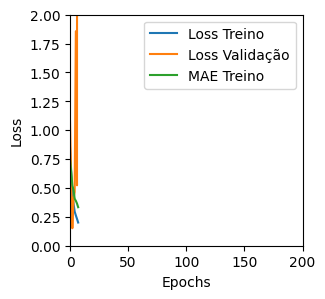

Tempo de treino: 0.06785020033518473 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4430345892906189 , MAE = 0.5182815194129944'

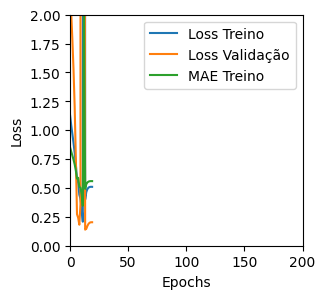

Tempo de treino: 0.07008997599283855 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4805447459220886 , MAE = 0.5144268870353699'

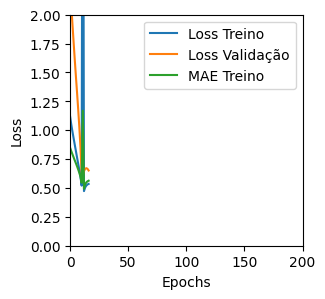

Tempo de treino: 0.04910301367441813 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37680506706237793 , MAE = 0.463575154542923'

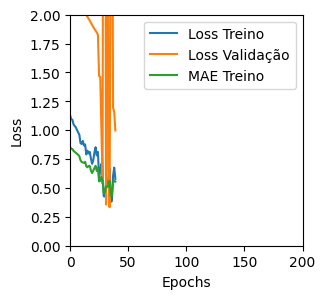

Tempo de treino: 0.19861880938212076 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4580827057361603 , MAE = 0.5035772323608398'

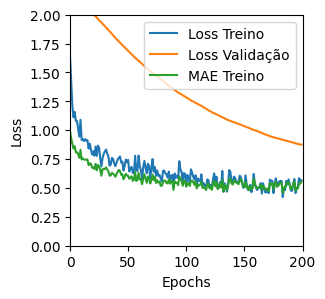

Tempo de treino: 0.7145982503890991 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34447363018989563 , MAE = 0.44629862904548645'

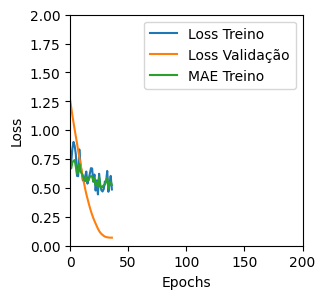

Tempo de treino: 0.07620619932810466 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6325145959854126 , MAE = 0.6111929416656494'

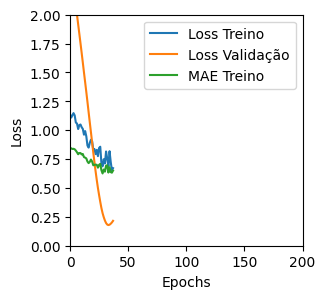

Tempo de treino: 0.06033016840616862 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29266998171806335 , MAE = 0.4007253348827362'

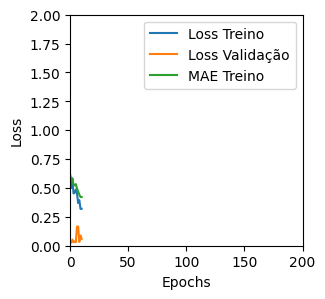

Tempo de treino: 0.07486266692479451 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1765637844800949 , MAE = 0.30287614464759827'

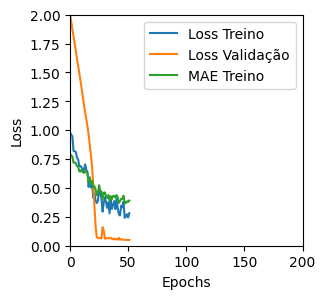

Tempo de treino: 0.19530894756317138 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34331652522087097 , MAE = 0.4605637788772583'

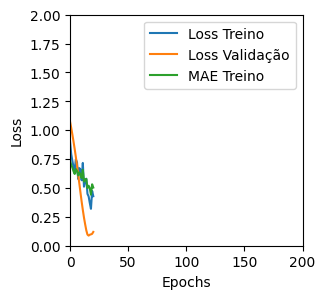

Tempo de treino: 0.06765726407368979 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46459418535232544 , MAE = 0.480198472738266'

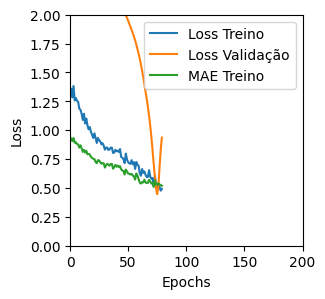

Tempo de treino: 0.196519672870636 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24102990329265594 , MAE = 0.36458513140678406'

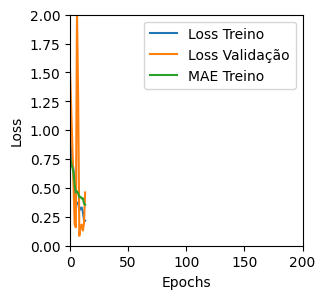

Tempo de treino: 0.11556814511617025 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3092186152935028 , MAE = 0.41418683528900146'

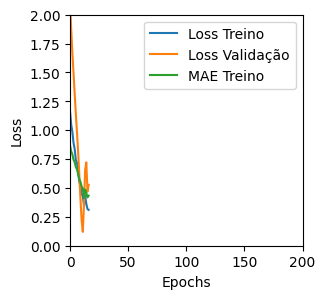

Tempo de treino: 0.07093946139017741 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4125157594680786 , MAE = 0.4876100420951843'

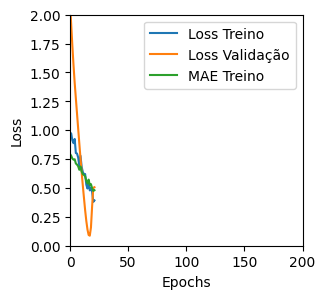

Tempo de treino: 0.057043612003326416 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3118346333503723 , MAE = 0.4212524890899658'

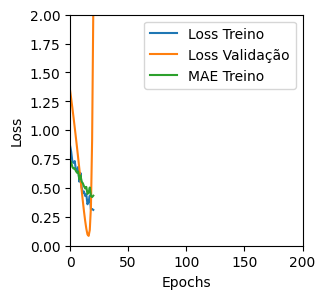

Tempo de treino: 0.054047779242197676 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30282410979270935 , MAE = 0.41227293014526367'

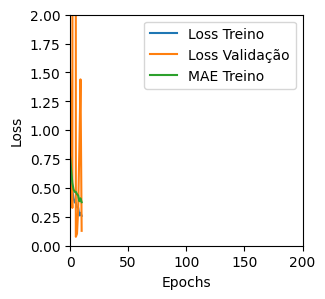

Tempo de treino: 0.111128302415212 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3831253945827484 , MAE = 0.47102129459381104'

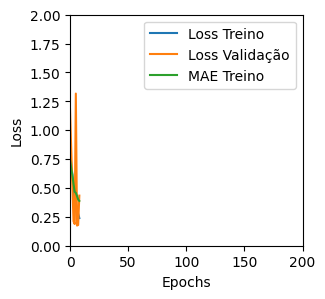

Tempo de treino: 0.0682307799657186 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48134589195251465 , MAE = 0.5196796655654907'

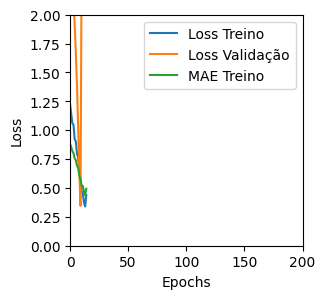

Tempo de treino: 0.06771498123804728 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3260195255279541 , MAE = 0.4121531844139099'

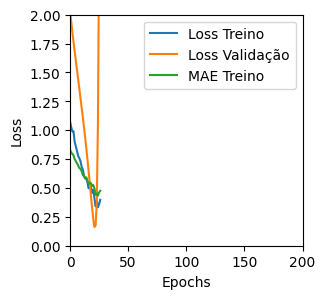

Tempo de treino: 0.058821614583333334 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37743985652923584 , MAE = 0.4585972726345062'

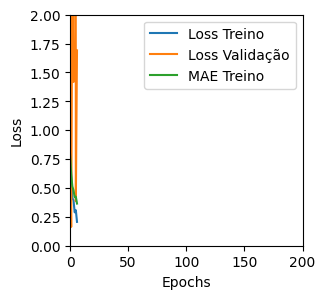

Tempo de treino: 0.07101014057795206 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1771870255470276 , MAE = 0.30936315655708313'

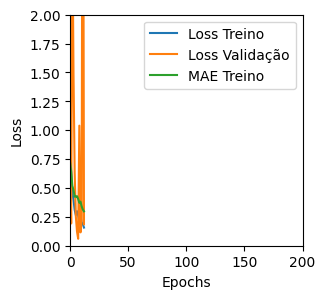

Tempo de treino: 0.06922879616419474 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46854063868522644 , MAE = 0.5296392440795898'

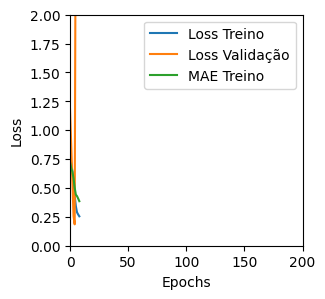

Tempo de treino: 0.04761660099029541 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3486914038658142 , MAE = 0.44118785858154297'

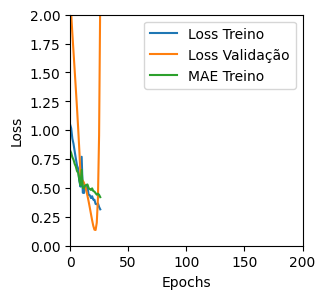

Tempo de treino: 0.06744494040807088 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11075577139854431 , MAE = 0.2628898024559021'

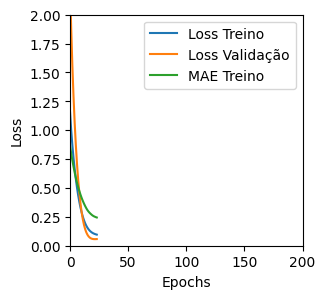

Tempo de treino: 0.2036455273628235 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=36, units=4, batch=8


'TRAINING set. Loss = 0.09577241539955139 , MAE = 0.24743320047855377'

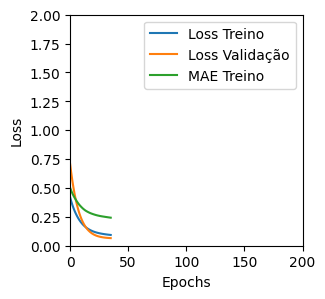

Tempo de treino: 0.12439514795939127 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11756721138954163 , MAE = 0.2782037854194641'

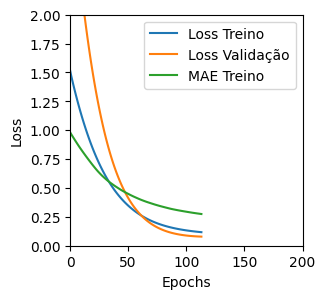

Tempo de treino: 0.197230064868927 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10840906202793121 , MAE = 0.262123167514801'

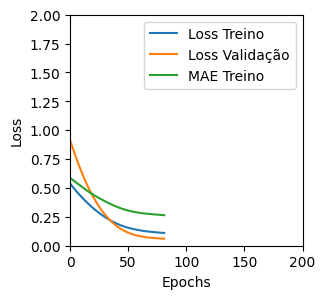

Tempo de treino: 0.12200098832448324 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15758739411830902 , MAE = 0.3144427239894867'

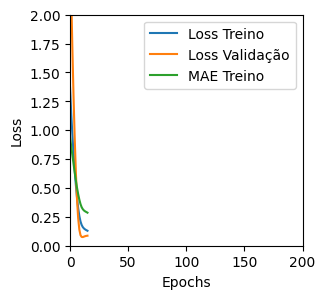

Tempo de treino: 0.11726966698964437 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23388676345348358 , MAE = 0.3882059156894684'

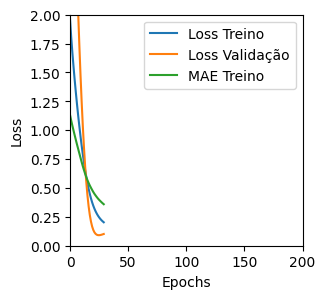

Tempo de treino: 0.12920647064844767 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12517675757408142 , MAE = 0.27557849884033203'

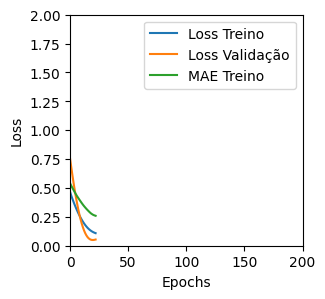

Tempo de treino: 0.07872174580891927 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16063974797725677 , MAE = 0.32669615745544434'

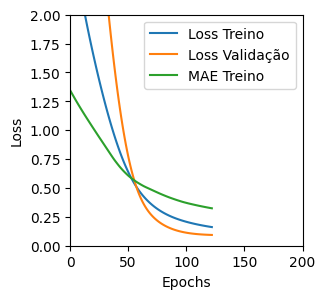

Tempo de treino: 0.1518578847249349 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04731098562479019 , MAE = 0.1694820523262024'

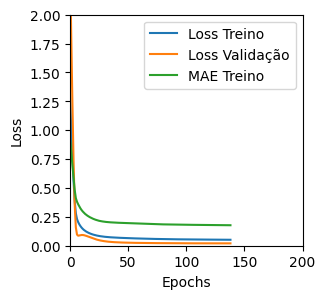

Tempo de treino: 0.716508150100708 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23535038530826569 , MAE = 0.39511650800704956'

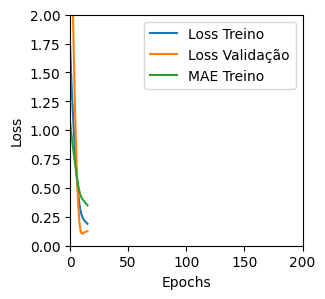

Tempo de treino: 0.1309338092803955 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20254714787006378 , MAE = 0.34663155674934387'

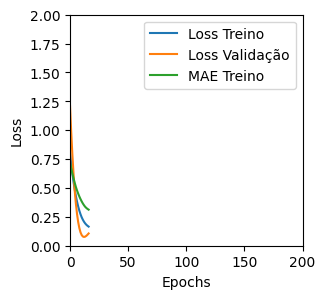

Tempo de treino: 0.0807496984799703 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16198894381523132 , MAE = 0.3163090646266937'

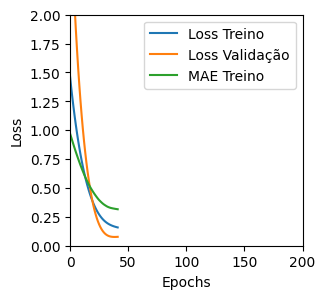

Tempo de treino: 0.08934810956319174 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0490996390581131 , MAE = 0.1716722697019577'

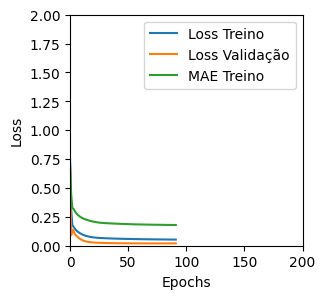

Tempo de treino: 0.7163060506184896 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23318727314472198 , MAE = 0.3719845414161682'

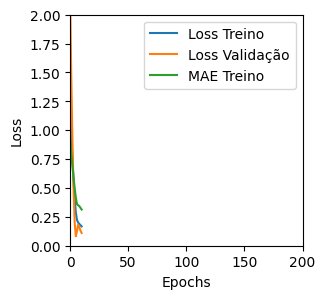

Tempo de treino: 0.06651388009389242 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15009444952011108 , MAE = 0.2958225905895233'

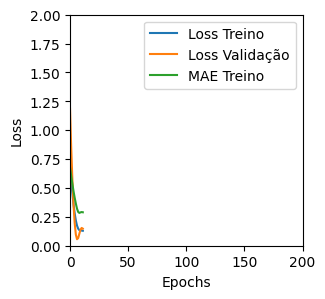

Tempo de treino: 0.08166316350301107 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25604844093322754 , MAE = 0.3989734351634979'

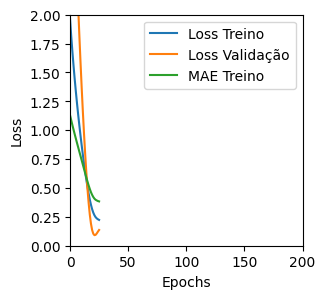

Tempo de treino: 0.0837478518486023 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05072173476219177 , MAE = 0.17399252951145172'

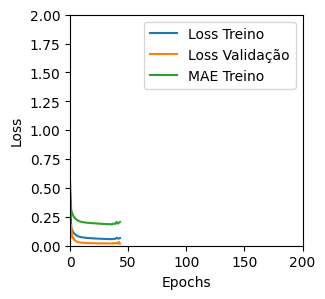

Tempo de treino: 0.2634827772776286 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04951091483235359 , MAE = 0.1715748906135559'

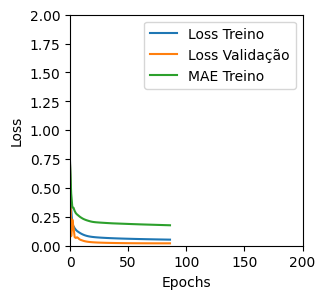

Tempo de treino: 0.3730813503265381 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16390930116176605 , MAE = 0.30599793791770935'

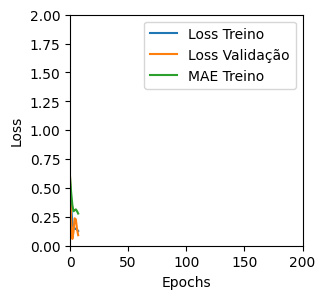

Tempo de treino: 0.06614224910736084 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2039911299943924 , MAE = 0.3490007221698761'

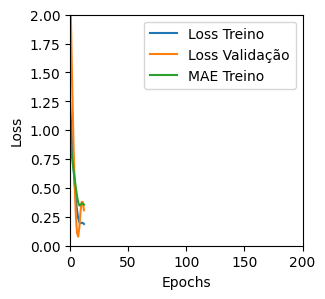

Tempo de treino: 0.06893588701883951 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.041921138763427734 , MAE = 0.1575164794921875'

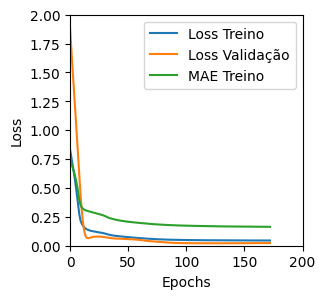

Tempo de treino: 0.3693064967791239 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7065659761428833 , MAE = 0.6342594027519226'

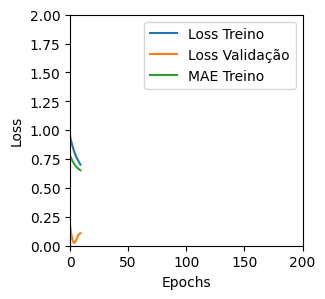

Tempo de treino: 0.0475196123123169 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39585697650909424 , MAE = 0.44297847151756287'

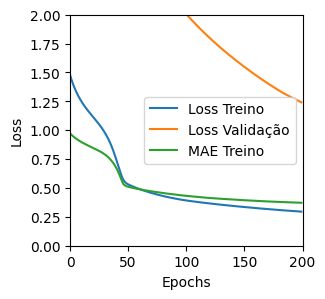

Tempo de treino: 0.18168377876281738 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10867998003959656 , MAE = 0.2581353485584259'

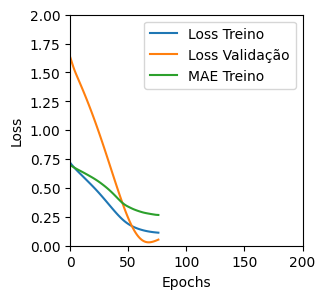

Tempo de treino: 0.11116846402486165 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17627869546413422 , MAE = 0.33675628900527954'

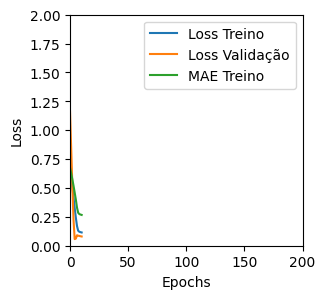

Tempo de treino: 0.050065286954243976 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16575540602207184 , MAE = 0.3222041130065918'

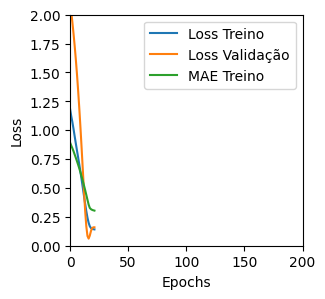

Tempo de treino: 0.09020435015360515 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11601194739341736 , MAE = 0.25992438197135925'

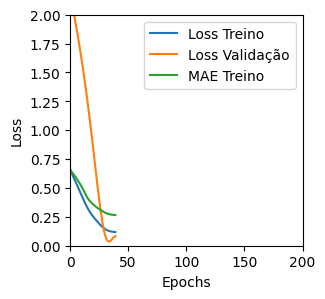

Tempo de treino: 0.07085352341334025 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14258192479610443 , MAE = 0.2939011752605438'

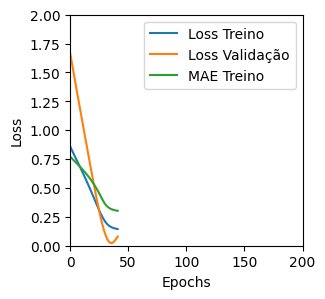

Tempo de treino: 0.06944605906804403 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40982285141944885 , MAE = 0.4961572289466858'

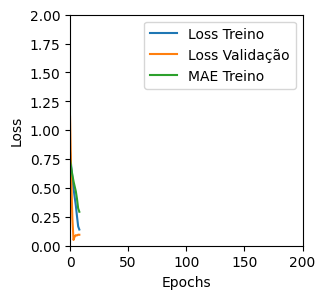

Tempo de treino: 0.047370628515879316 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13673163950443268 , MAE = 0.2804105877876282'

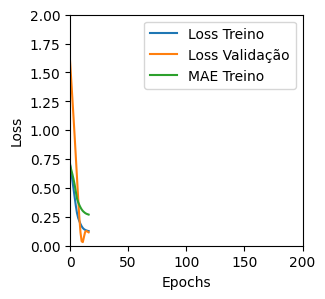

Tempo de treino: 0.046114722887674965 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3135311007499695 , MAE = 0.4385598301887512'

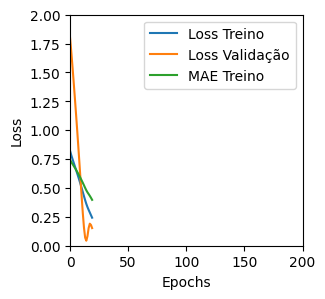

Tempo de treino: 0.048501455783843996 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14558978378772736 , MAE = 0.2795501947402954'

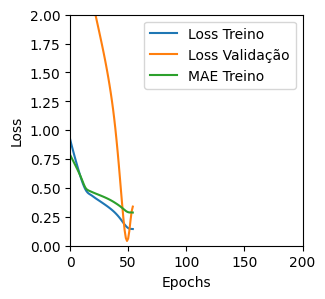

Tempo de treino: 0.06689267953236898 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0789615735411644 , MAE = 0.2108178585767746'

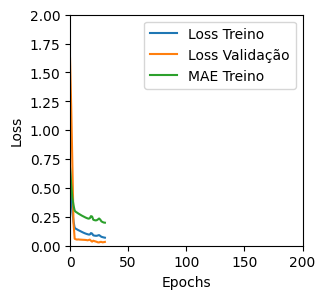

Tempo de treino: 0.1198364774386088 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15919913351535797 , MAE = 0.2972087562084198'

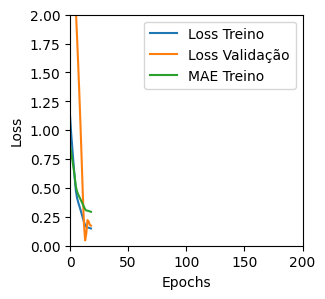

Tempo de treino: 0.05330765247344971 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13460123538970947 , MAE = 0.2721020579338074'

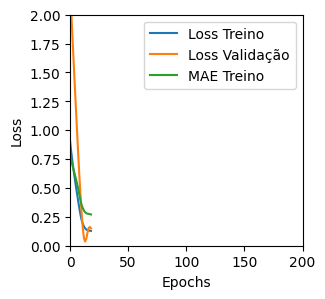

Tempo de treino: 0.049350329240163165 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16139566898345947 , MAE = 0.3055029511451721'

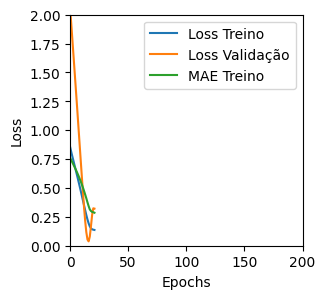

Tempo de treino: 0.04212895631790161 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15790186822414398 , MAE = 0.2990530729293823'

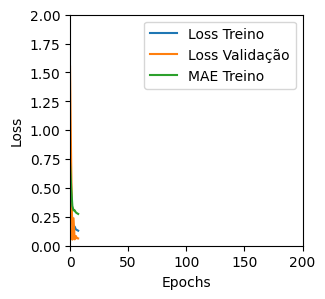

Tempo de treino: 0.05380988121032715 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14573855698108673 , MAE = 0.2960165739059448'

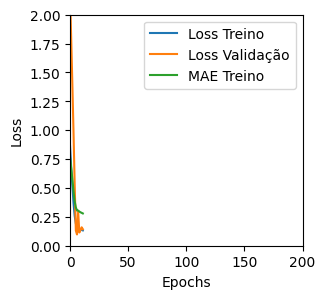

Tempo de treino: 0.04578376213709513 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36337611079216003 , MAE = 0.4677714705467224'

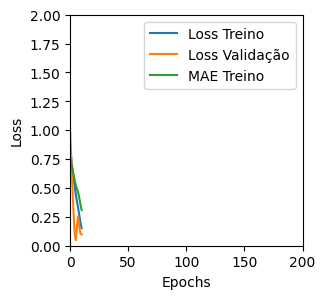

Tempo de treino: 0.03778263727823893 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1946512907743454 , MAE = 0.340803325176239'

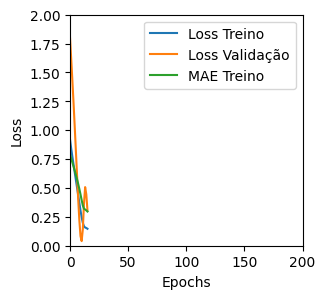

Tempo de treino: 0.06950299739837647 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.509739100933075 , MAE = 0.5506001114845276'

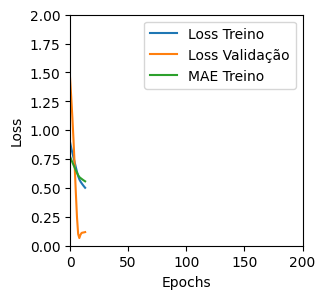

Tempo de treino: 0.062030696868896486 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12195537984371185 , MAE = 0.27070119976997375'

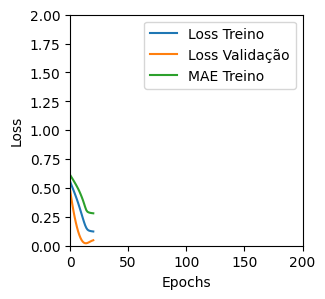

Tempo de treino: 0.06946446498235066 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09768623113632202 , MAE = 0.23514360189437866'

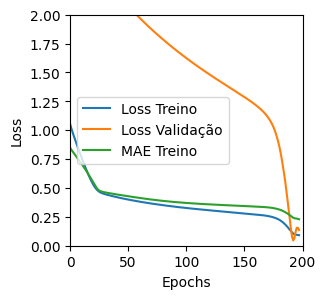

Tempo de treino: 0.19652719100316365 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.459109365940094 , MAE = 0.46160686016082764'

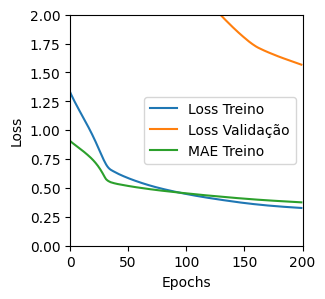

Tempo de treino: 0.19504477183024088 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1934635192155838 , MAE = 0.3375614583492279'

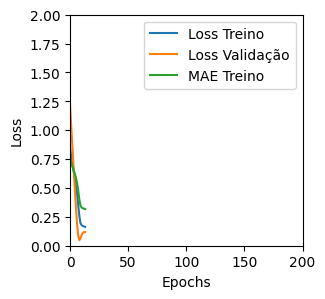

Tempo de treino: 0.05267560084660848 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12853765487670898 , MAE = 0.26620909571647644'

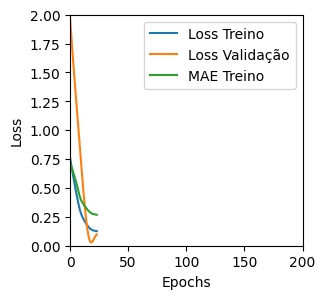

Tempo de treino: 0.07471511761347453 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6135111451148987 , MAE = 0.591393768787384'

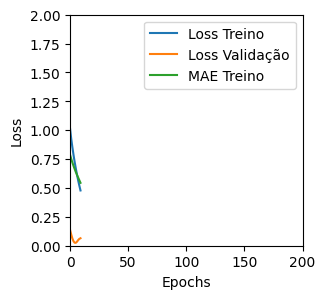

Tempo de treino: 0.05958408912022908 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16750140488147736 , MAE = 0.3041776120662689'

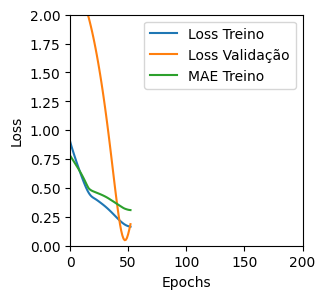

Tempo de treino: 0.07404383023579915 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15609174966812134 , MAE = 0.2975431978702545'

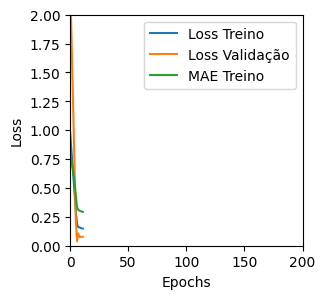

Tempo de treino: 0.07263580958048503 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26966798305511475 , MAE = 0.4117503762245178'

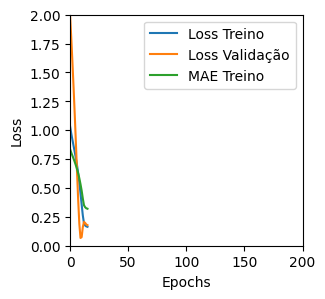

Tempo de treino: 0.04854577382405599 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15677504241466522 , MAE = 0.2979743480682373'

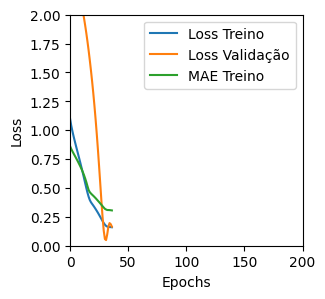

Tempo de treino: 0.06047111749649048 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15486763417720795 , MAE = 0.2917136549949646'

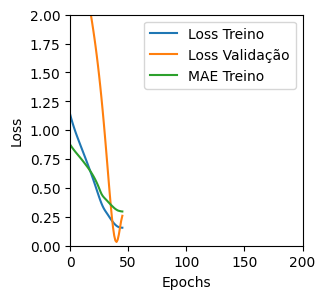

Tempo de treino: 0.06061018308003743 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15379363298416138 , MAE = 0.2970847189426422'

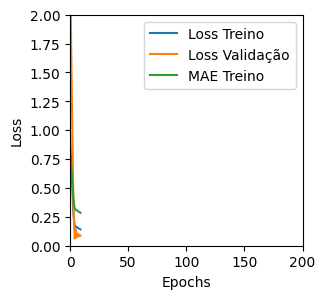

Tempo de treino: 0.044716401894887285 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16120342910289764 , MAE = 0.2973407804965973'

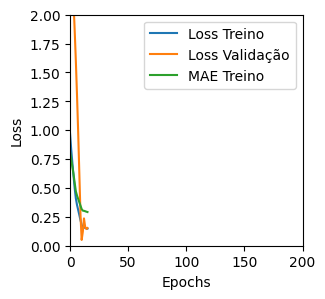

Tempo de treino: 0.09032137393951416 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1549580842256546 , MAE = 0.2935098111629486'

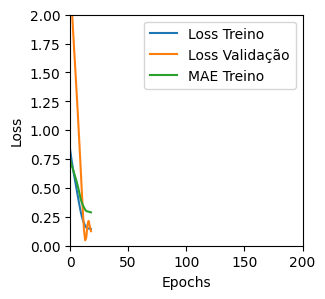

Tempo de treino: 0.05381659666697184 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15046022832393646 , MAE = 0.2905855178833008'

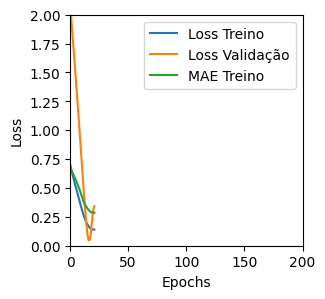

Tempo de treino: 0.04449826876322428 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07643482089042664 , MAE = 0.22219665348529816'

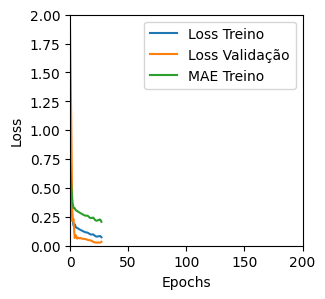

Tempo de treino: 0.11283416350682576 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14926201105117798 , MAE = 0.2946147322654724'

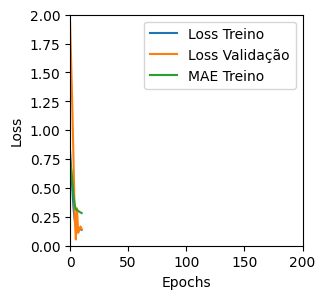

Tempo de treino: 0.04130502541859945 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1563785821199417 , MAE = 0.30276647210121155'

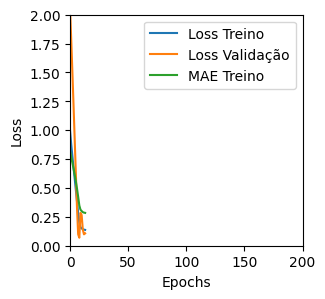

Tempo de treino: 0.04693467617034912 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.149166539311409 , MAE = 0.2898480296134949'

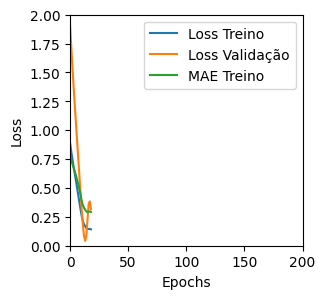

Tempo de treino: 0.04061094522476196 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17869845032691956 , MAE = 0.3244571387767792'

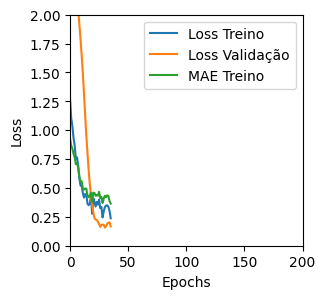

Tempo de treino: 0.13322787682215373 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.191158264875412 , MAE = 0.3378559947013855'

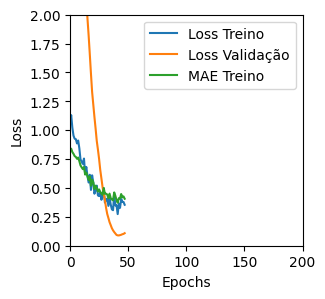

Tempo de treino: 0.10044538974761963 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6058871746063232 , MAE = 0.5981670022010803'

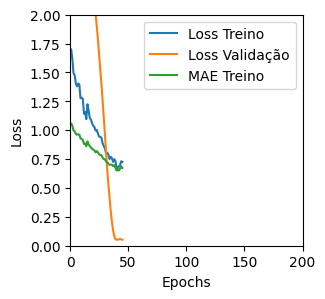

Tempo de treino: 0.07526634136835735 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19826114177703857 , MAE = 0.3469761610031128'

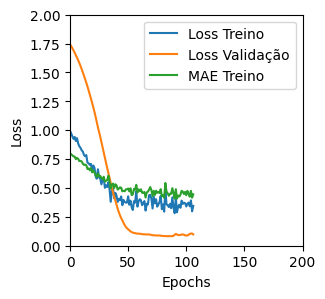

Tempo de treino: 0.09486473004023234 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1549898386001587 , MAE = 0.29313623905181885'

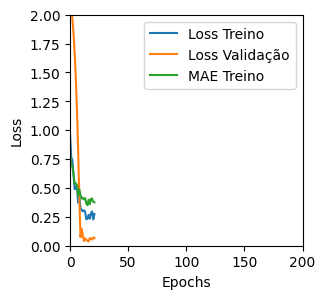

Tempo de treino: 0.11666073401769002 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3173423111438751 , MAE = 0.44068780541419983'

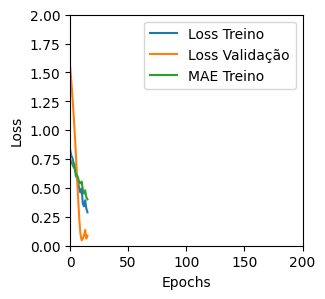

Tempo de treino: 0.04498504002888997 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13363862037658691 , MAE = 0.27303192019462585'

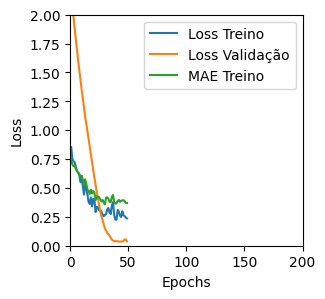

Tempo de treino: 0.1118224819501241 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10965841263532639 , MAE = 0.2513730525970459'

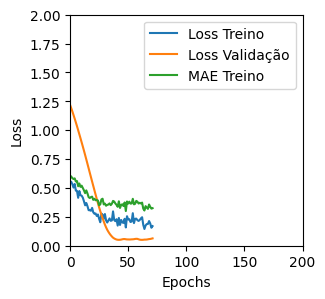

Tempo de treino: 0.08764552672704061 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14143316447734833 , MAE = 0.2809770107269287'

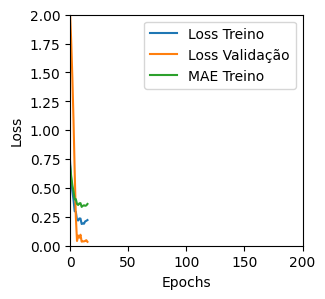

Tempo de treino: 0.06772361993789673 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13648292422294617 , MAE = 0.28161999583244324'

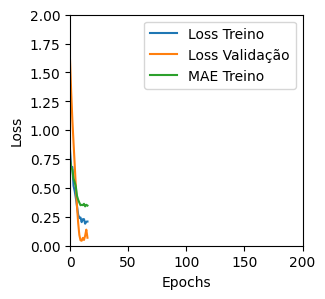

Tempo de treino: 0.048684195677439375 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1455143392086029 , MAE = 0.28956571221351624'

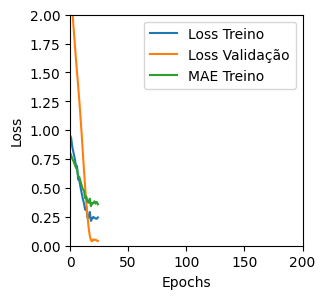

Tempo de treino: 0.048855578899383544 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16387327015399933 , MAE = 0.3108951151371002'

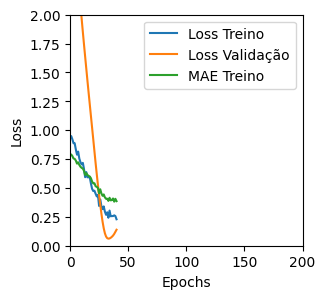

Tempo de treino: 0.05342988570531209 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1357273906469345 , MAE = 0.281642884016037'

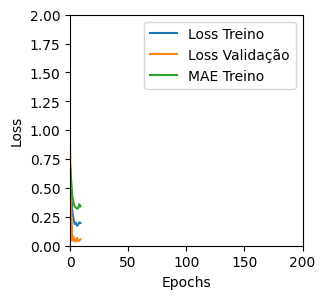

Tempo de treino: 0.0543525497118632 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13784851133823395 , MAE = 0.28123024106025696'

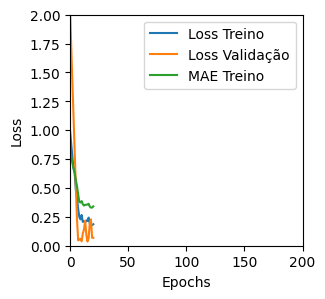

Tempo de treino: 0.04953898191452026 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1409340649843216 , MAE = 0.280481219291687'

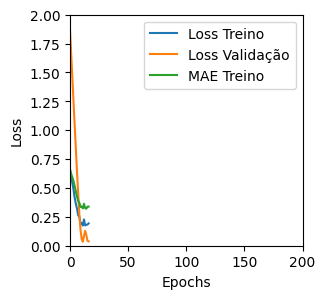

Tempo de treino: 0.06678381363550821 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14118266105651855 , MAE = 0.2828886806964874'

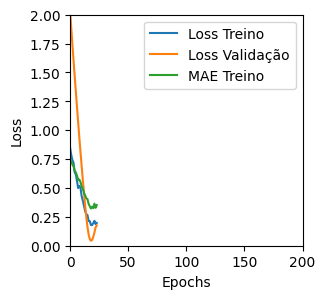

Tempo de treino: 0.07335290511449179 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1269955188035965 , MAE = 0.263587087392807'

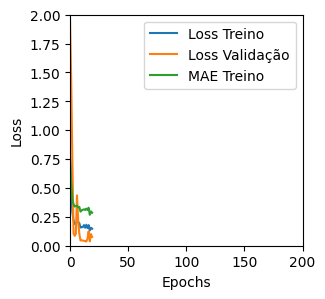

Tempo de treino: 0.0708101232846578 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13409140706062317 , MAE = 0.27336829900741577'

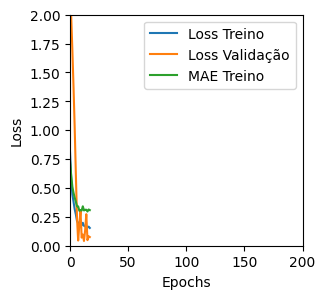

Tempo de treino: 0.05315279563268026 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16514968872070312 , MAE = 0.30871662497520447'

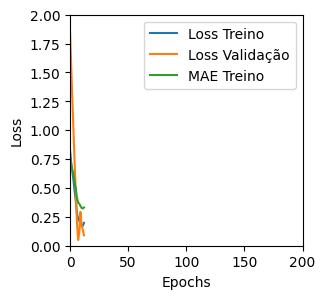

Tempo de treino: 0.05099860429763794 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24301156401634216 , MAE = 0.38670241832733154'

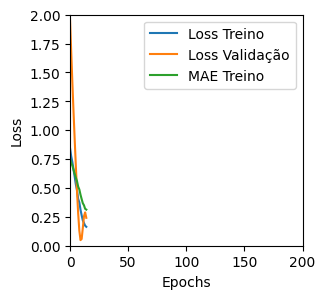

Tempo de treino: 0.03809917370478312 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04406537488102913 , MAE = 0.16196508705615997'

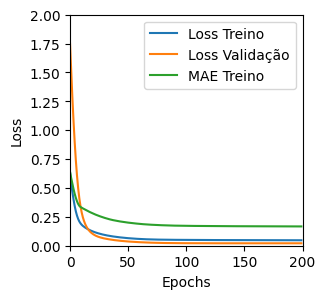

Tempo de treino: 0.45772964557011925 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04724542796611786 , MAE = 0.16873037815093994'

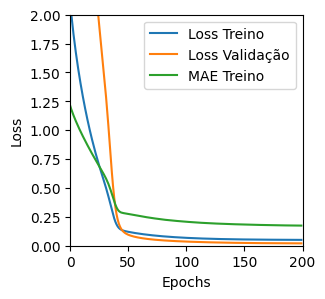

Tempo de treino: 0.29206159512201946 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045000407844781876 , MAE = 0.1633509397506714'

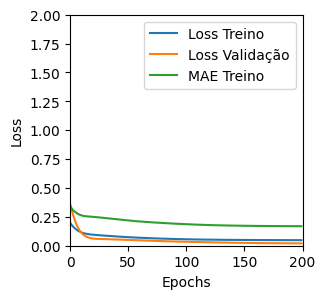

Tempo de treino: 0.2041685700416565 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05516935884952545 , MAE = 0.1846812665462494'

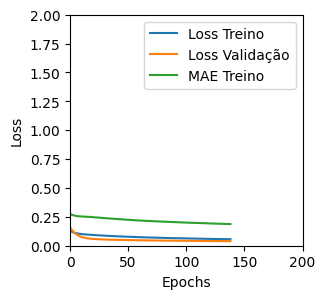

Tempo de treino: 0.20291196902592976 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04960544779896736 , MAE = 0.17154008150100708'

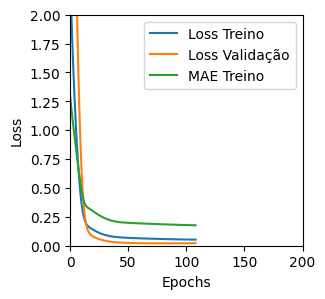

Tempo de treino: 0.374370801448822 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04417010769248009 , MAE = 0.16138167679309845'

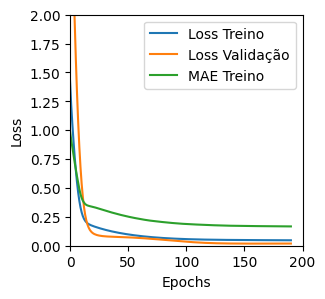

Tempo de treino: 0.39301837285359703 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051810652017593384 , MAE = 0.1771191507577896'

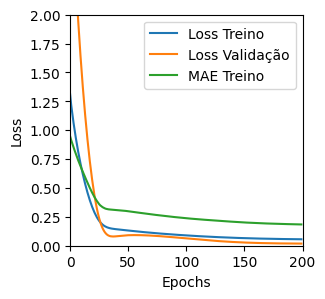

Tempo de treino: 0.375427770614624 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050873491913080215 , MAE = 0.1771971583366394'

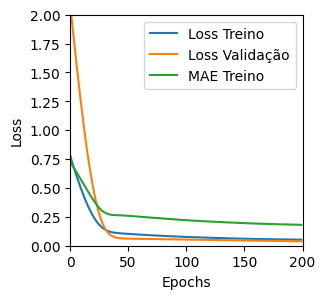

Tempo de treino: 0.20316691795984904 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05079571157693863 , MAE = 0.1753956824541092'

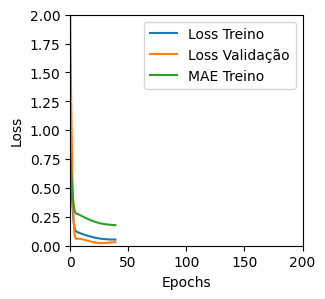

Tempo de treino: 0.120236074924469 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04389524832367897 , MAE = 0.16087666153907776'

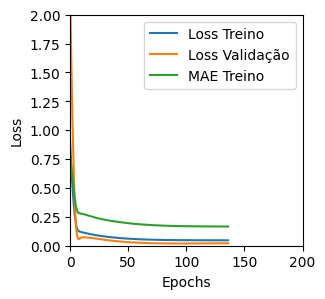

Tempo de treino: 0.3965578158696493 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04646860435605049 , MAE = 0.16590175032615662'

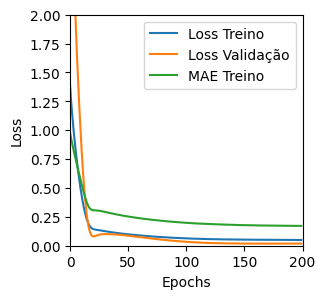

Tempo de treino: 0.22065085967381795 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0483764223754406 , MAE = 0.17090804874897003'

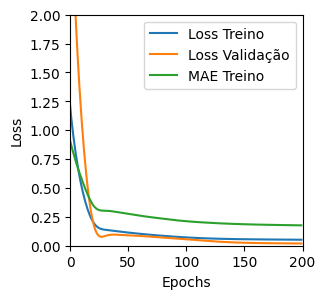

Tempo de treino: 0.17241979837417604 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05296255648136139 , MAE = 0.18098567426204681'

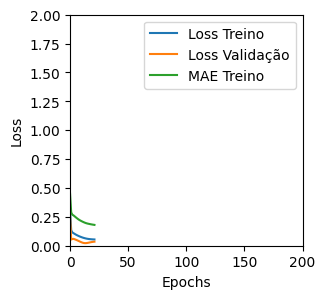

Tempo de treino: 0.08347150087356567 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12104668468236923 , MAE = 0.27282658219337463'

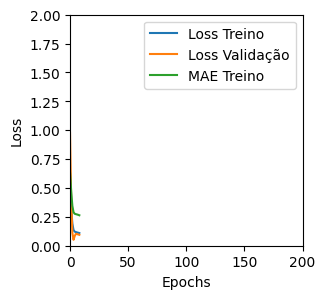

Tempo de treino: 0.08972049554189046 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12314797937870026 , MAE = 0.2785598635673523'

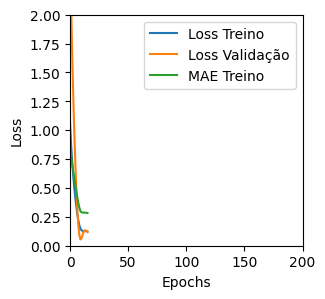

Tempo de treino: 0.06205698649088542 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13705648481845856 , MAE = 0.29264751076698303'

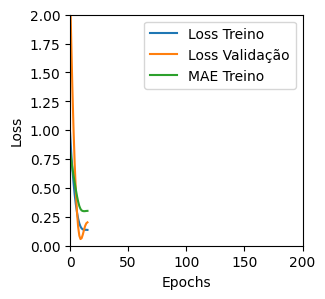

Tempo de treino: 0.05499803225199382 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08502565324306488 , MAE = 0.2273051142692566'

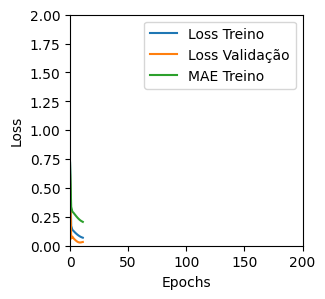

Tempo de treino: 0.07481508255004883 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13916414976119995 , MAE = 0.28905537724494934'

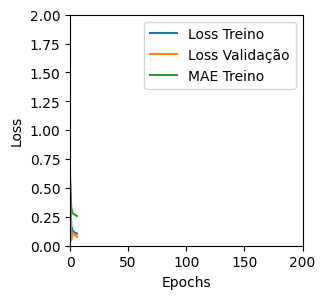

Tempo de treino: 0.053650307655334475 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13632190227508545 , MAE = 0.2910928428173065'

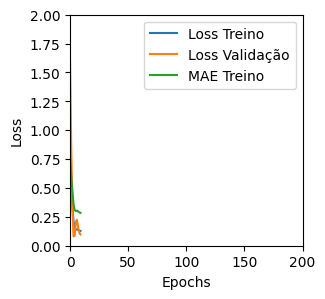

Tempo de treino: 0.0751970926920573 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11879017949104309 , MAE = 0.2686097323894501'

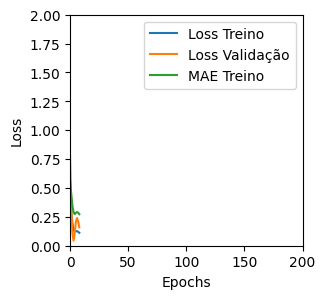

Tempo de treino: 0.06378185351689657 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19586919248104095 , MAE = 0.33754801750183105'

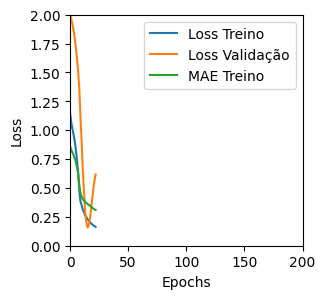

Tempo de treino: 0.06338027715682984 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19641822576522827 , MAE = 0.31821808218955994'

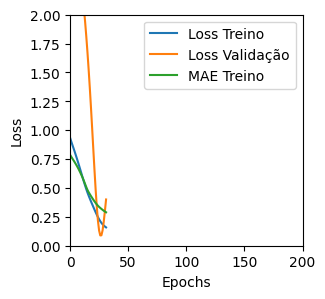

Tempo de treino: 0.056939899921417236 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4134614169597626 , MAE = 0.4325244724750519'

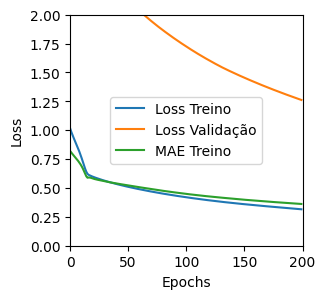

Tempo de treino: 0.16775132417678834 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29426270723342896 , MAE = 0.40772852301597595'

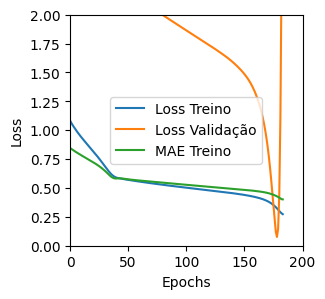

Tempo de treino: 0.19582860867182414 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34456974267959595 , MAE = 0.4589538872241974'

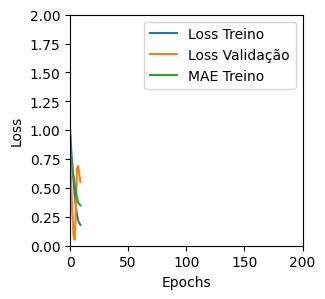

Tempo de treino: 0.04439454476038615 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21366477012634277 , MAE = 0.3448808193206787'

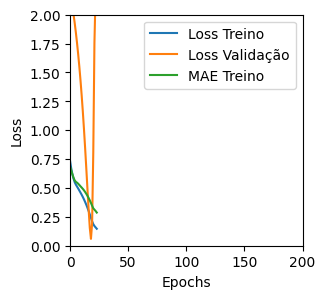

Tempo de treino: 0.08777795632680258 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11724399030208588 , MAE = 0.25384271144866943'

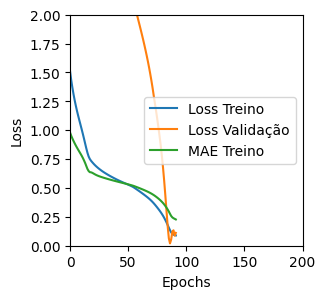

Tempo de treino: 0.09254077672958375 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2250319868326187 , MAE = 0.34037649631500244'

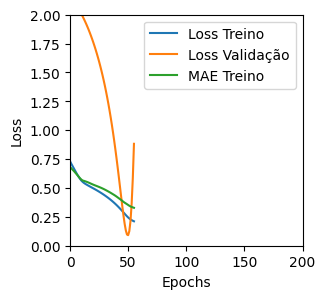

Tempo de treino: 0.07600814501444499 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19723476469516754 , MAE = 0.3217925727367401'

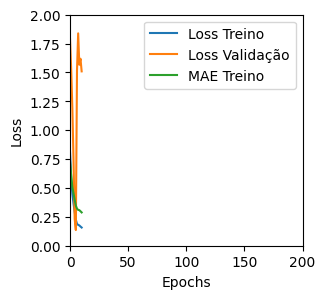

Tempo de treino: 0.043433364232381186 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20958088338375092 , MAE = 0.3321877419948578'

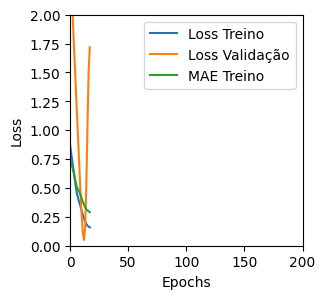

Tempo de treino: 0.04331041574478149 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5286882519721985 , MAE = 0.5636377334594727'

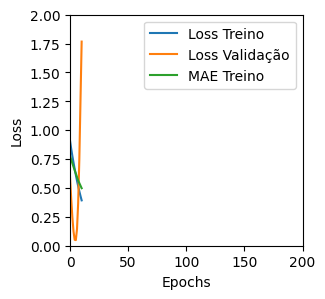

Tempo de treino: 0.03215251366297404 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2605646848678589 , MAE = 0.3892481029033661'

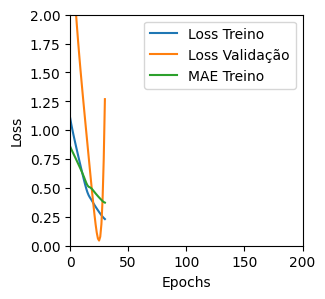

Tempo de treino: 0.07301774819691977 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20304341614246368 , MAE = 0.32537826895713806'

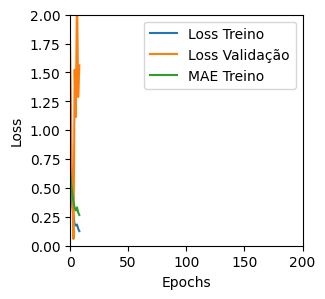

Tempo de treino: 0.0596121072769165 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21315552294254303 , MAE = 0.3435458540916443'

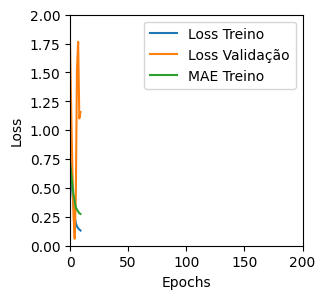

Tempo de treino: 0.047638547420501706 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25766587257385254 , MAE = 0.3899218738079071'

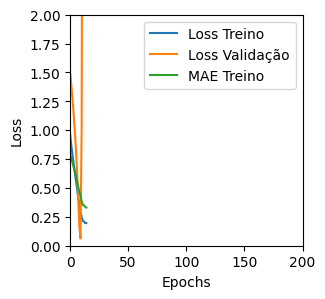

Tempo de treino: 0.04717243909835815 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48990941047668457 , MAE = 0.5334010720252991'

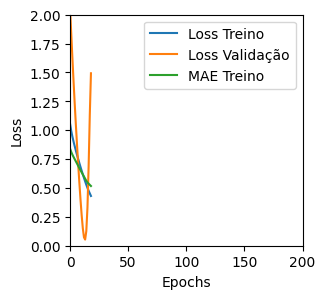

Tempo de treino: 0.044145532449086505 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2601681053638458 , MAE = 0.37304356694221497'

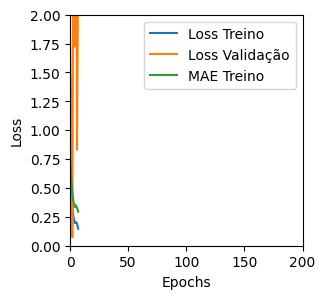

Tempo de treino: 0.04303828477859497 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22677238285541534 , MAE = 0.3605944812297821'

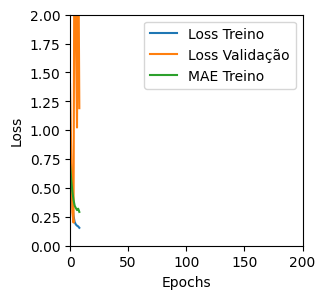

Tempo de treino: 0.034646721680959065 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2521911561489105 , MAE = 0.3783525228500366'

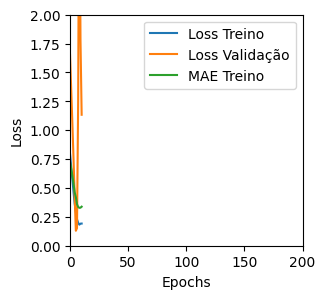

Tempo de treino: 0.03275331656138102 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24693720042705536 , MAE = 0.35850828886032104'

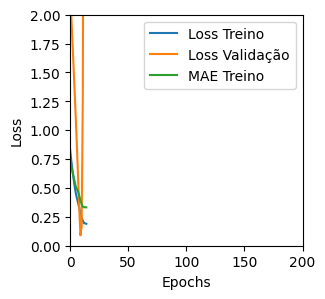

Tempo de treino: 0.05352679888407389 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.348706990480423 , MAE = 0.46503618359565735'

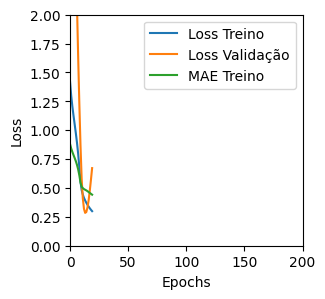

Tempo de treino: 0.0837356686592102 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5691012144088745 , MAE = 0.5893529653549194'

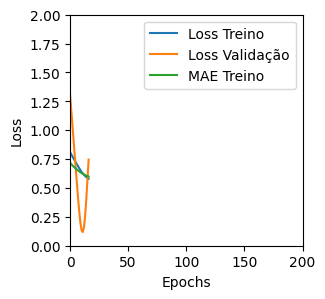

Tempo de treino: 0.04590981403986613 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.3499045372009277 , MAE = 0.9666353464126587'

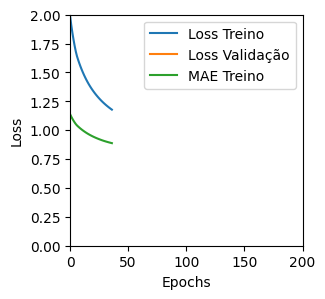

Tempo de treino: 0.06079948345820109 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22742877900600433 , MAE = 0.356205552816391'

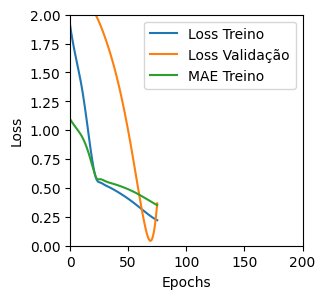

Tempo de treino: 0.08129033247629801 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2540774941444397 , MAE = 0.37521690130233765'

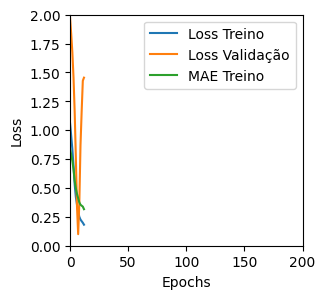

Tempo de treino: 0.04692444801330566 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6036691069602966 , MAE = 0.5907455086708069'

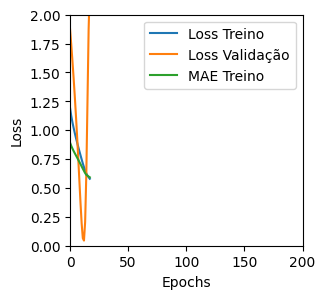

Tempo de treino: 0.06835334300994873 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6860772371292114 , MAE = 0.6289277076721191'

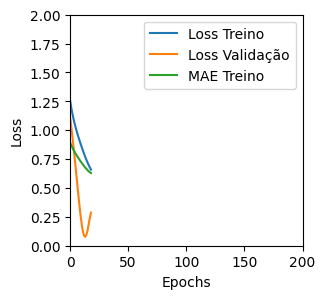

Tempo de treino: 0.03728493452072144 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27350157499313354 , MAE = 0.4023125171661377'

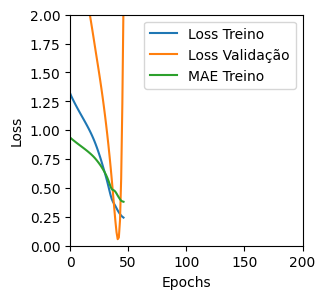

Tempo de treino: 0.07060444752375285 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17614898085594177 , MAE = 0.31151527166366577'

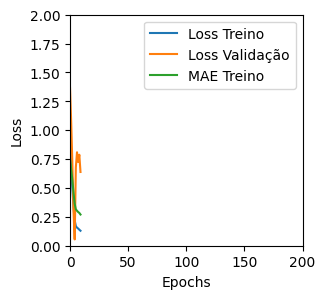

Tempo de treino: 0.07141819397608438 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29632633924484253 , MAE = 0.4218575656414032'

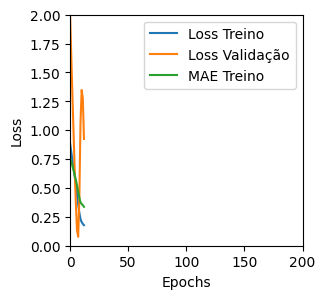

Tempo de treino: 0.050761425495147706 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2426885962486267 , MAE = 0.3759957551956177'

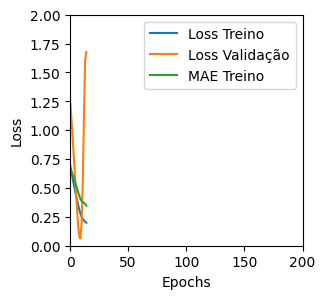

Tempo de treino: 0.04395870765050252 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26511213183403015 , MAE = 0.3780057430267334'

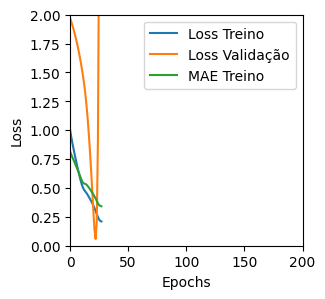

Tempo de treino: 0.04995400508244832 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21888570487499237 , MAE = 0.3275988698005676'

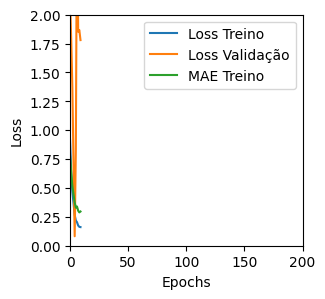

Tempo de treino: 0.07045104503631591 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2140204906463623 , MAE = 0.33257558941841125'

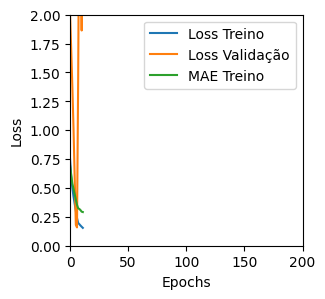

Tempo de treino: 0.043492225805918376 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31469911336898804 , MAE = 0.43265411257743835'

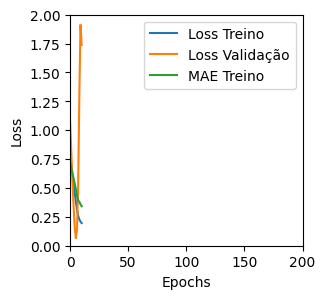

Tempo de treino: 0.031034314632415773 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23539142310619354 , MAE = 0.3681683838367462'

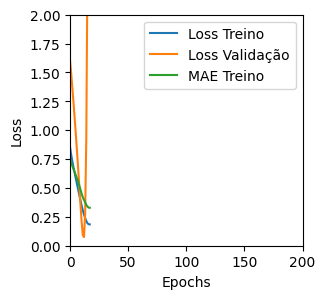

Tempo de treino: 0.08947858015696207 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27076536417007446 , MAE = 0.3956174850463867'

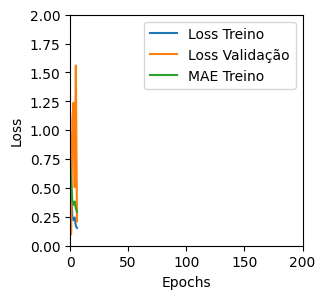

Tempo de treino: 0.04580446481704712 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17830118536949158 , MAE = 0.31234002113342285'

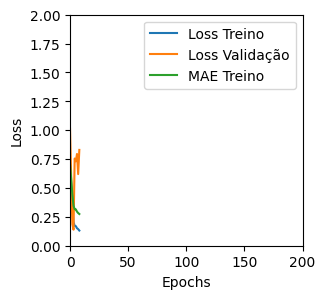

Tempo de treino: 0.044320106506347656 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.230093851685524 , MAE = 0.36619076132774353'

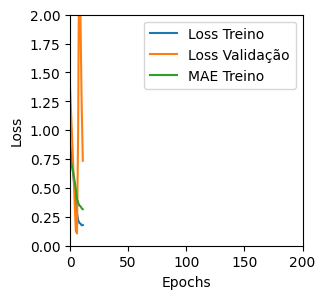

Tempo de treino: 0.04366296927134196 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4395105838775635 , MAE = 0.5153976082801819'

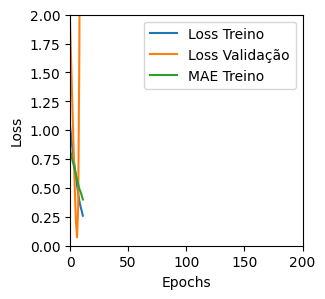

Tempo de treino: 0.04644032716751099 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17774434387683868 , MAE = 0.32993432879447937'

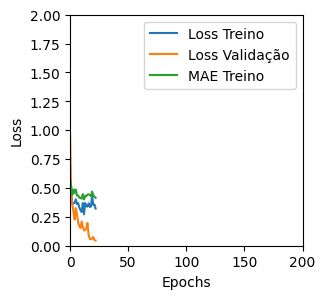

Tempo de treino: 0.06441284418106079 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.4125373363494873 , MAE = 0.9865737557411194'

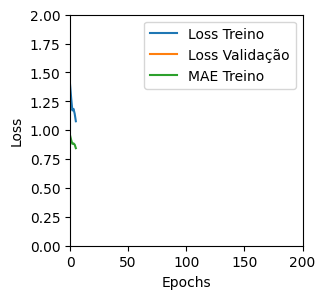

Tempo de treino: 0.03260811567306519 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1799784153699875 , MAE = 0.32514867186546326'

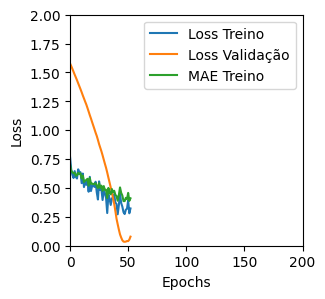

Tempo de treino: 0.07591857115427653 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4604029655456543 , MAE = 0.4598250687122345'

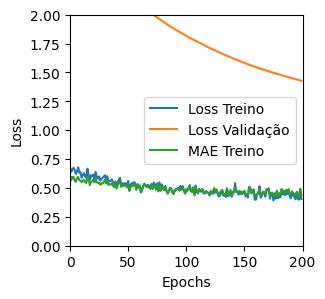

Tempo de treino: 0.20522025028864543 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15742850303649902 , MAE = 0.3014962673187256'

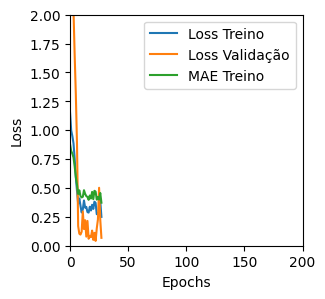

Tempo de treino: 0.11028768221537272 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14811652898788452 , MAE = 0.2864248752593994'

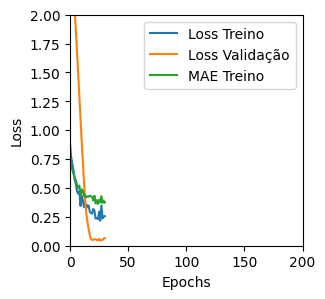

Tempo de treino: 0.06781038840611776 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1812088042497635 , MAE = 0.31817737221717834'

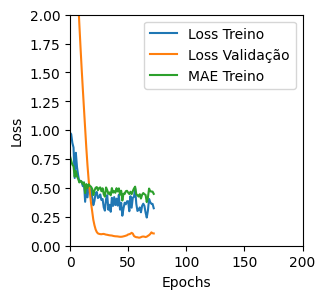

Tempo de treino: 0.07983711163202921 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3238718509674072 , MAE = 0.441526859998703'

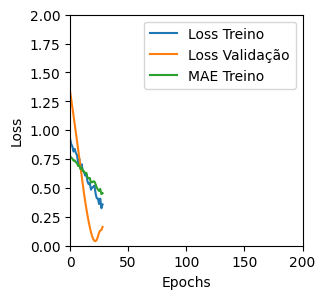

Tempo de treino: 0.048380696773529054 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38078632950782776 , MAE = 0.4809861183166504'

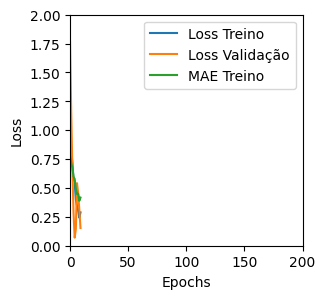

Tempo de treino: 0.04345399936040242 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.503163754940033 , MAE = 0.5529184341430664'

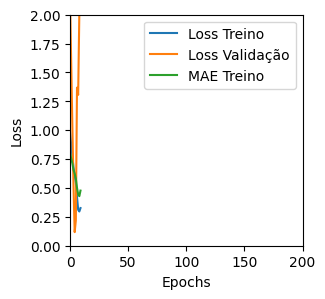

Tempo de treino: 0.04359713395436605 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34652450680732727 , MAE = 0.45680415630340576'

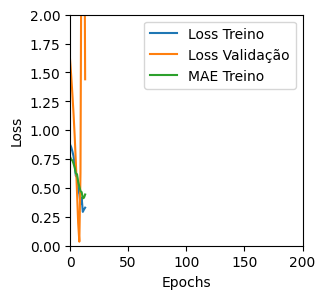

Tempo de treino: 0.050836058457692464 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24390850961208344 , MAE = 0.3593226373195648'

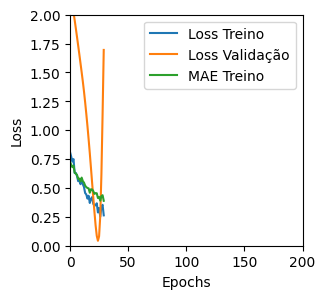

Tempo de treino: 0.05940954685211182 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2738194763660431 , MAE = 0.3888978362083435'

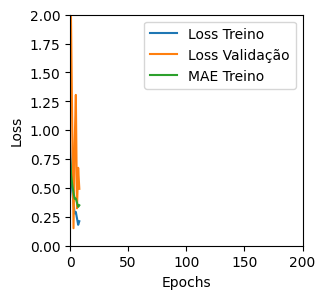

Tempo de treino: 0.04741216897964477 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17549854516983032 , MAE = 0.3084143400192261'

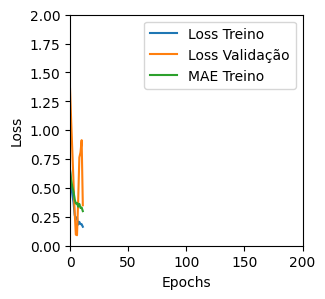

Tempo de treino: 0.05160964727401733 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2312375009059906 , MAE = 0.3549202084541321'

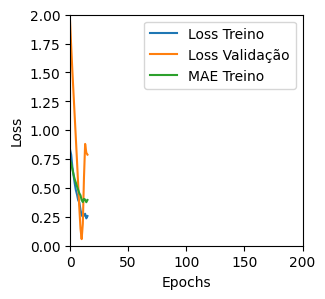

Tempo de treino: 0.03908648490905762 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3515946567058563 , MAE = 0.45610180497169495'

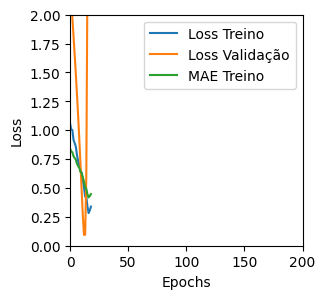

Tempo de treino: 0.04328944683074951 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24943315982818604 , MAE = 0.37548354268074036'

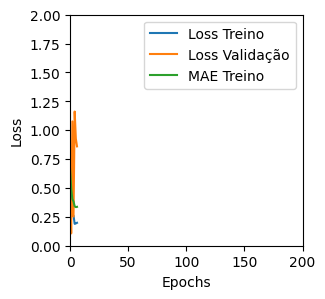

Tempo de treino: 0.043662933508555095 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24402037262916565 , MAE = 0.3628314435482025'

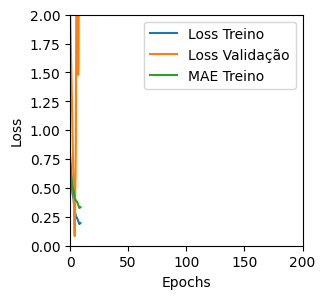

Tempo de treino: 0.0456347664197286 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26062315702438354 , MAE = 0.3880927562713623'

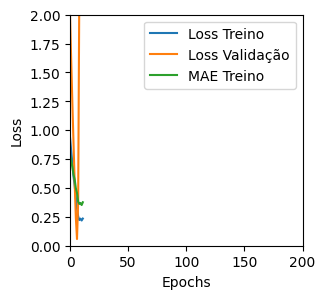

Tempo de treino: 0.05665022532145182 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21552453935146332 , MAE = 0.3342510461807251'

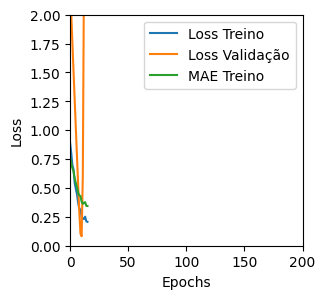

Tempo de treino: 0.0491409182548523 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05785240978002548 , MAE = 0.18605509400367737'

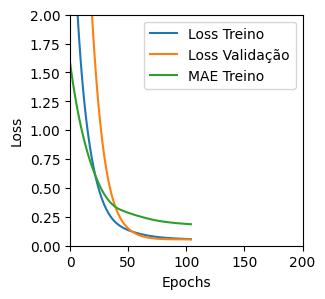

Tempo de treino: 0.3718967318534851 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05133052542805672 , MAE = 0.17687273025512695'

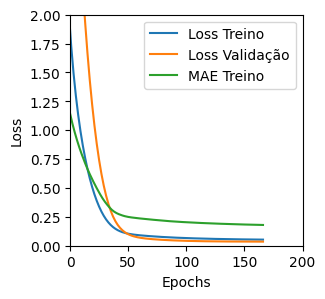

Tempo de treino: 0.20902338822682698 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.09091299027204514 , MAE = 0.2310410439968109'

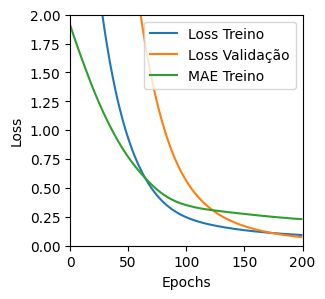

Tempo de treino: 0.1985076665878296 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1529822051525116 , MAE = 0.3148670792579651'

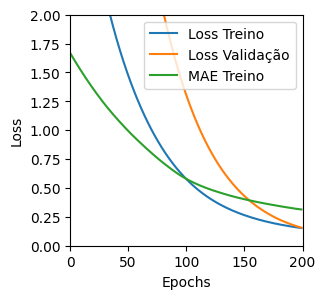

Tempo de treino: 0.20385732650756835 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04203614220023155 , MAE = 0.15690094232559204'

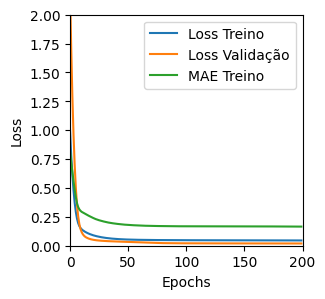

Tempo de treino: 0.7374171813329061 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04342378303408623 , MAE = 0.1593993604183197'

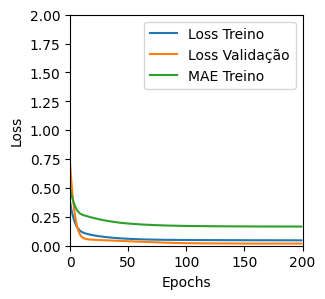

Tempo de treino: 0.26775134801864625 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04722779989242554 , MAE = 0.16826318204402924'

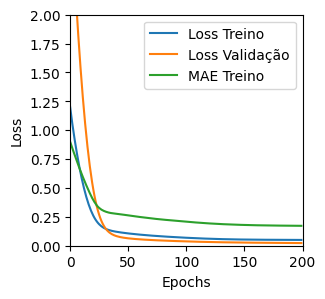

Tempo de treino: 0.20101900895436606 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046953100711107254 , MAE = 0.16959886252880096'

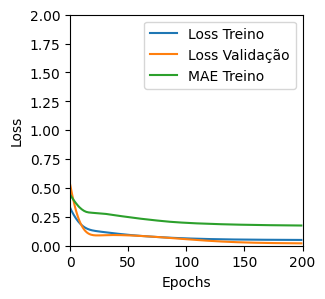

Tempo de treino: 0.2042582114537557 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042409639805555344 , MAE = 0.1571836620569229'

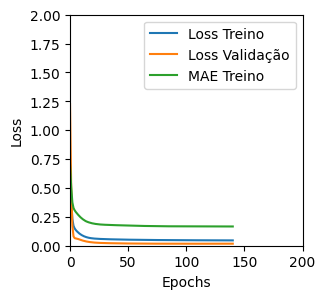

Tempo de treino: 0.3696107864379883 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04235857352614403 , MAE = 0.1589144468307495'

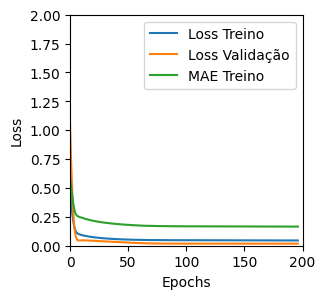

Tempo de treino: 0.38970672289530434 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04298873990774155 , MAE = 0.15892432630062103'

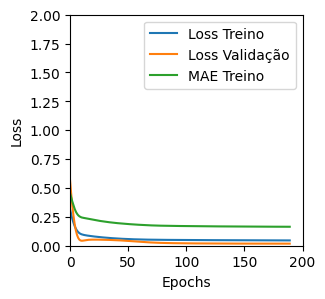

Tempo de treino: 0.20045450528462727 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10278718173503876 , MAE = 0.25176844000816345'

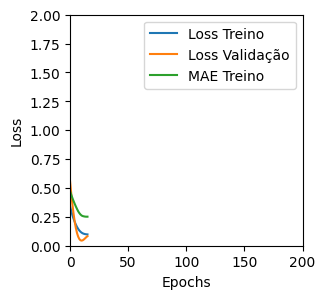

Tempo de treino: 0.0565973440806071 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04275422915816307 , MAE = 0.15597550570964813'

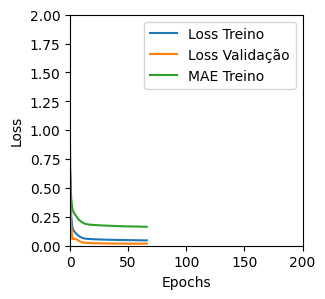

Tempo de treino: 0.161581023534139 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042206164449453354 , MAE = 0.15675859153270721'

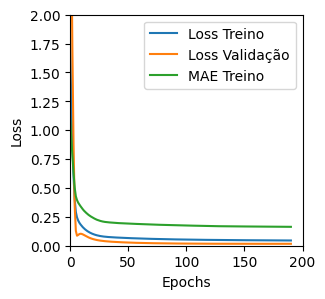

Tempo de treino: 0.37031956513722736 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04520034417510033 , MAE = 0.16185900568962097'

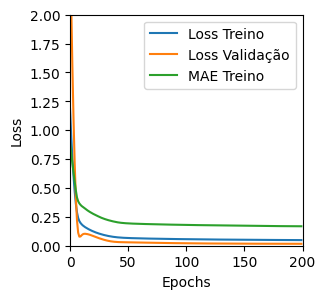

Tempo de treino: 0.2324580947558085 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15677538514137268 , MAE = 0.31045717000961304'

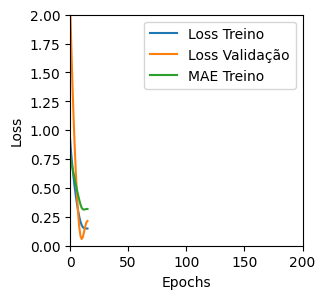

Tempo de treino: 0.05880894263585409 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.042868759483098984 , MAE = 0.15624694526195526'

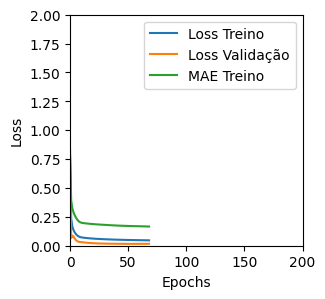

Tempo de treino: 0.17697236935297647 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04336284473538399 , MAE = 0.15830089151859283'

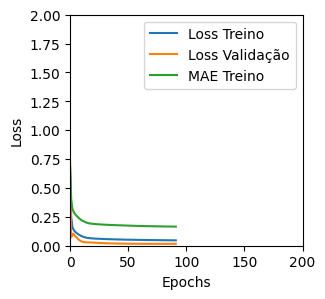

Tempo de treino: 0.15391085942586263 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.160119891166687 , MAE = 0.3131164610385895'

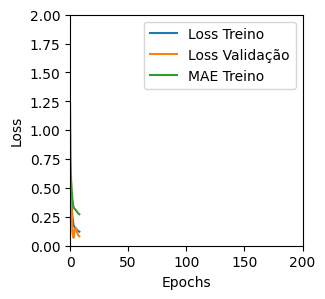

Tempo de treino: 0.04114883343378703 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19566865265369415 , MAE = 0.3511561453342438'

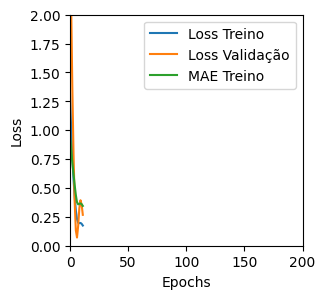

Tempo de treino: 0.08085019985834757 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4161938726902008 , MAE = 0.4983387291431427'

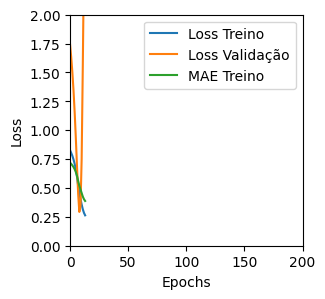

Tempo de treino: 0.11721258163452149 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2547437250614166 , MAE = 0.38647258281707764'

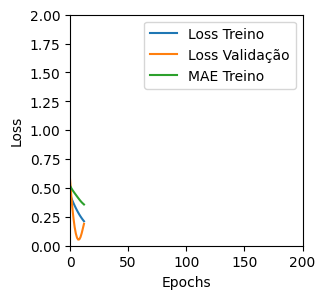

Tempo de treino: 0.05796485741933187 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4595472812652588 , MAE = 0.5033735036849976'

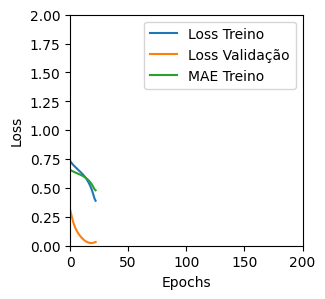

Tempo de treino: 0.06851068735122681 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31323081254959106 , MAE = 0.43236538767814636'

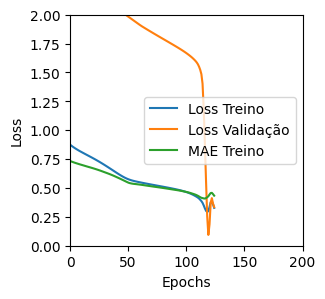

Tempo de treino: 0.19624128739039104 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20823384821414948 , MAE = 0.3439822494983673'

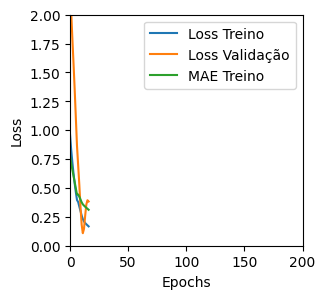

Tempo de treino: 0.11384043693542481 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.631723165512085 , MAE = 0.6120991110801697'

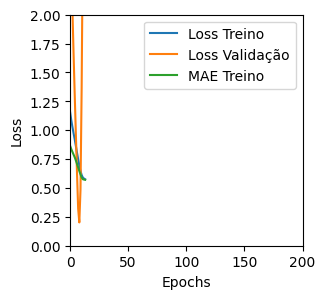

Tempo de treino: 0.06993587811787923 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35708436369895935 , MAE = 0.42063167691230774'

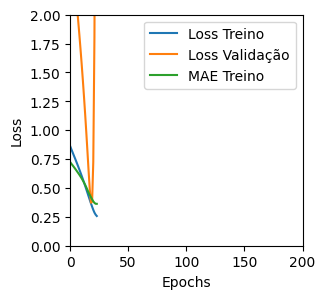

Tempo de treino: 0.06506691773732504 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3225763738155365 , MAE = 0.4468521773815155'

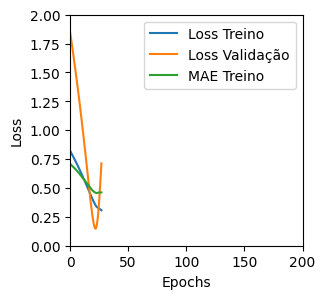

Tempo de treino: 0.06359813213348389 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5007082223892212 , MAE = 0.5447021126747131'

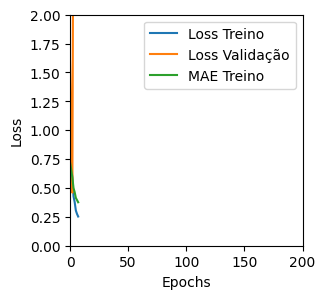

Tempo de treino: 0.06015312671661377 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.663409411907196 , MAE = 0.6376527547836304'

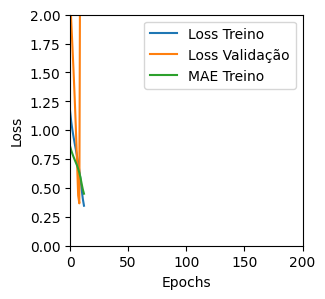

Tempo de treino: 0.06925073464711508 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3652665913105011 , MAE = 0.44157758355140686'

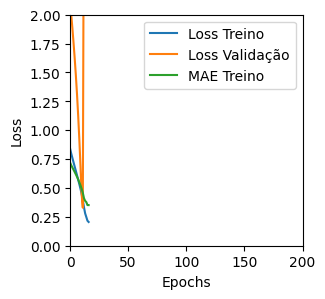

Tempo de treino: 0.05559980074564616 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36730095744132996 , MAE = 0.45812153816223145'

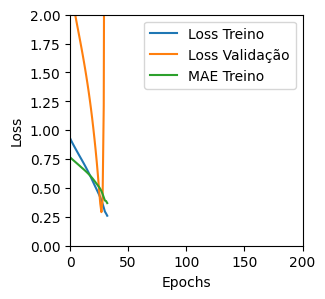

Tempo de treino: 0.054593098163604734 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34297794103622437 , MAE = 0.44704893231391907'

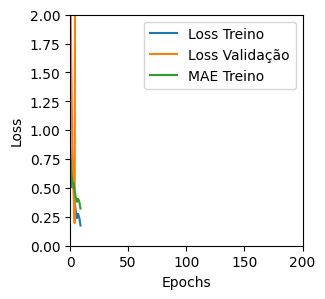

Tempo de treino: 0.06345319350560506 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3095942735671997 , MAE = 0.40827834606170654'

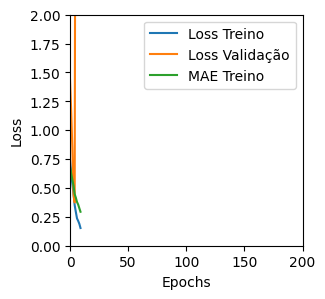

Tempo de treino: 0.08150658210118612 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24549679458141327 , MAE = 0.35375699400901794'

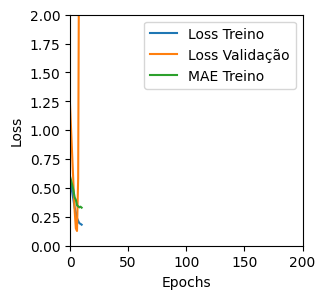

Tempo de treino: 0.051147079467773436 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4115019142627716 , MAE = 0.4733092486858368'

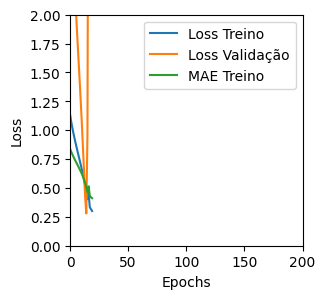

Tempo de treino: 0.07199808359146118 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6514012813568115 , MAE = 0.6383846998214722'

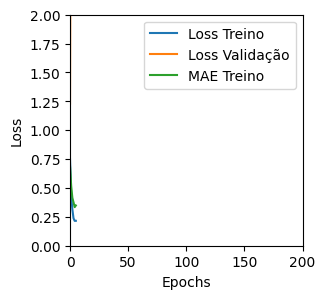

Tempo de treino: 0.07935930093129476 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.360006719827652 , MAE = 0.45896604657173157'

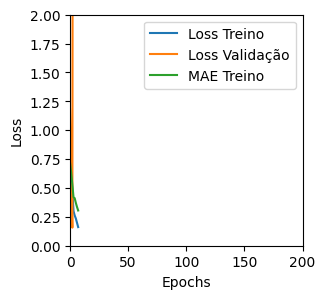

Tempo de treino: 0.04888991117477417 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3890710473060608 , MAE = 0.48210570216178894'

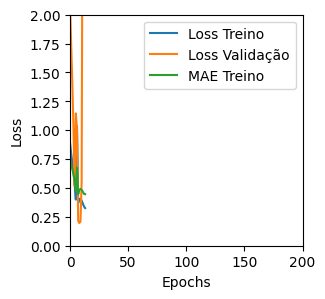

Tempo de treino: 0.06823153495788574 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3653276264667511 , MAE = 0.4621620178222656'

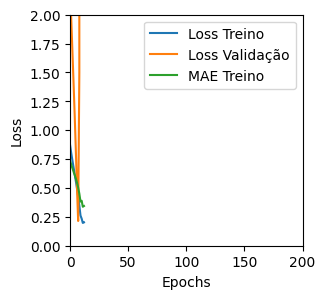

Tempo de treino: 0.05525858402252197 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10043985396623611 , MAE = 0.2451835572719574'

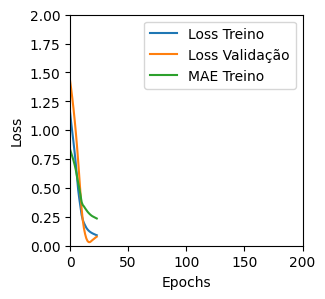

Tempo de treino: 0.1473629355430603 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2911883294582367 , MAE = 0.4098671078681946'

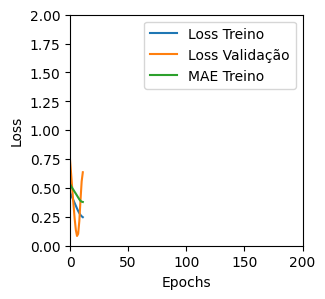

Tempo de treino: 0.08075025876363119 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9475181102752686 , MAE = 0.7700545787811279'

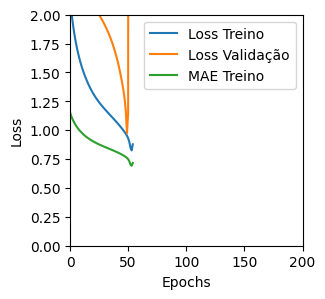

Tempo de treino: 0.09172490437825521 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5977351665496826 , MAE = 0.5920231938362122'

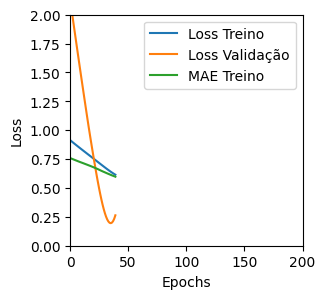

Tempo de treino: 0.07164671421051025 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.251289427280426 , MAE = 0.38825374841690063'

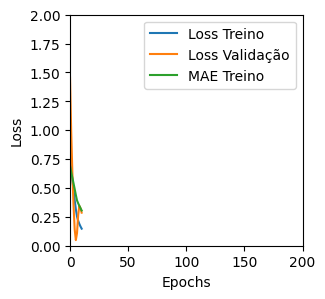

Tempo de treino: 0.07143116394678752 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5002105236053467 , MAE = 0.5468804240226746'

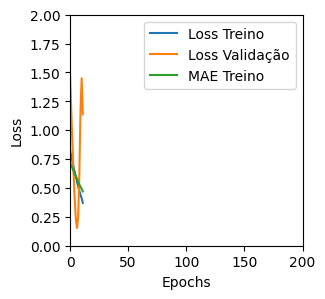

Tempo de treino: 0.050145423412323 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4137113094329834 , MAE = 0.503559410572052'

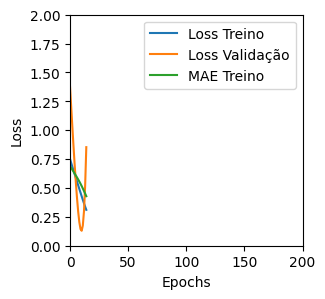

Tempo de treino: 0.05359915494918823 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5631071925163269 , MAE = 0.5637964606285095'

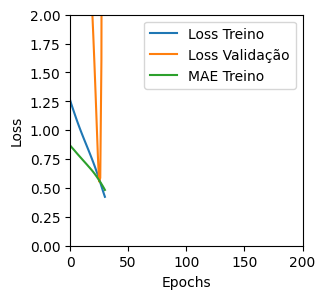

Tempo de treino: 0.08779524167378744 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42118358612060547 , MAE = 0.5116173028945923'

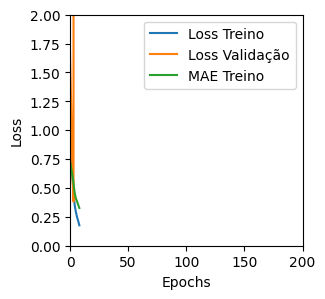

Tempo de treino: 0.0674949328104655 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32195770740509033 , MAE = 0.4134824275970459'

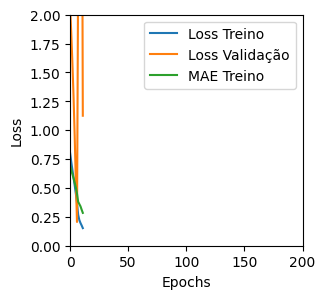

Tempo de treino: 0.08149895668029786 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37423548102378845 , MAE = 0.4660901725292206'

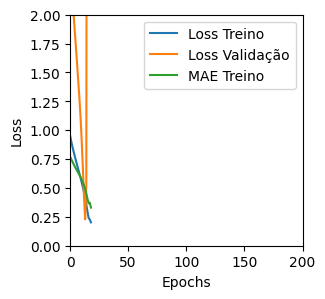

Tempo de treino: 0.06973140637079875 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5173957347869873 , MAE = 0.5479981303215027'

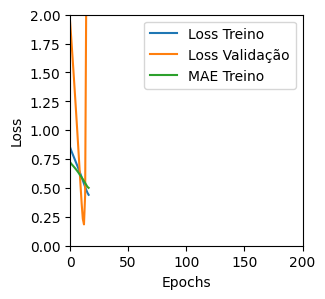

Tempo de treino: 0.043739291032155354 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31780171394348145 , MAE = 0.4333004653453827'

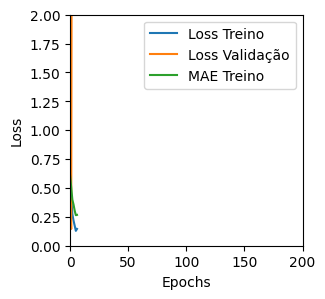

Tempo de treino: 0.0773585319519043 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2946723699569702 , MAE = 0.3885040879249573'

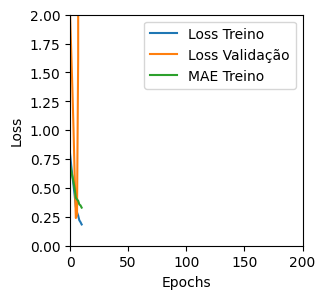

Tempo de treino: 0.049344801902771 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28365376591682434 , MAE = 0.40300074219703674'

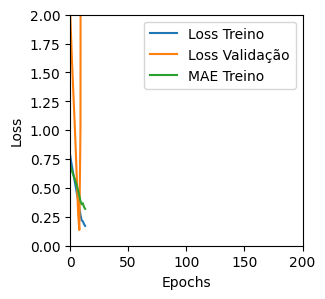

Tempo de treino: 0.09436383644739786 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5342506170272827 , MAE = 0.5634685158729553'

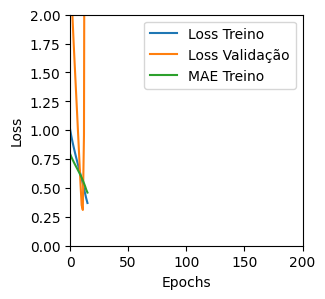

Tempo de treino: 0.05032544533411662 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3261793553829193 , MAE = 0.4524509906768799'

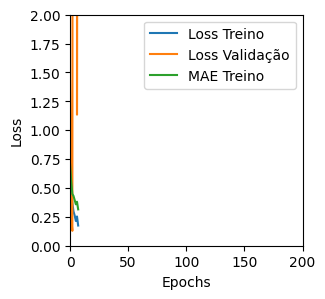

Tempo de treino: 0.07646903991699219 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3953230082988739 , MAE = 0.49028605222702026'

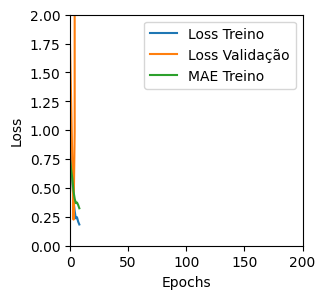

Tempo de treino: 0.07071676651636759 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3301926553249359 , MAE = 0.4148849546909332'

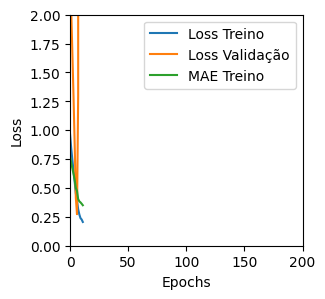

Tempo de treino: 0.04610114892323812 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45308801531791687 , MAE = 0.5029434561729431'

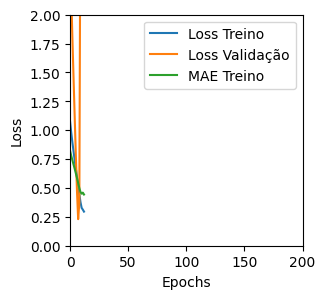

Tempo de treino: 0.04788653055826823 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22573623061180115 , MAE = 0.36050593852996826'

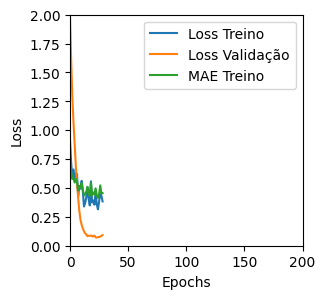

Tempo de treino: 0.1995183269182841 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16490690410137177 , MAE = 0.3000107407569885'

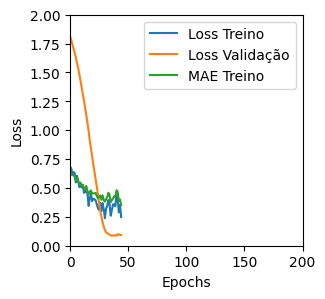

Tempo de treino: 0.14722861846288046 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22143159806728363 , MAE = 0.35987746715545654'

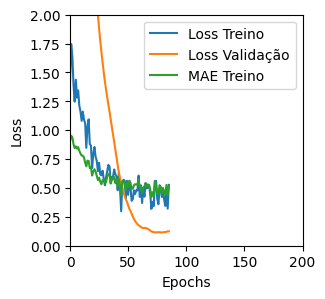

Tempo de treino: 0.14087799390157063 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32606858015060425 , MAE = 0.43772071599960327'

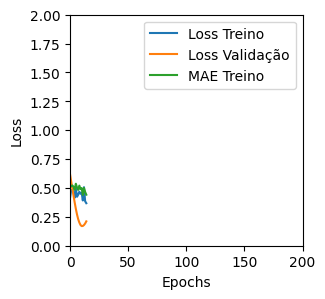

Tempo de treino: 0.05072503884633382 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2661327123641968 , MAE = 0.39954400062561035'

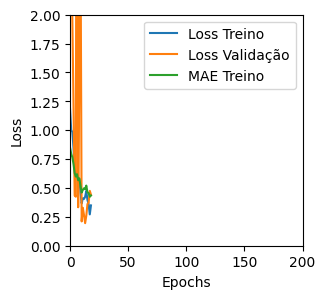

Tempo de treino: 0.11695531606674195 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5340524315834045 , MAE = 0.5414860844612122'

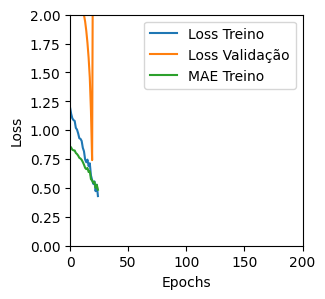

Tempo de treino: 0.0729660669962565 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4834665060043335 , MAE = 0.5407499074935913'

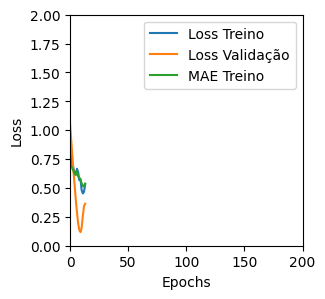

Tempo de treino: 0.04791449308395386 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4456159770488739 , MAE = 0.44537487626075745'

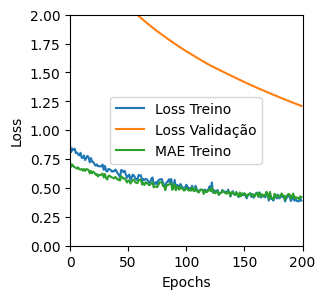

Tempo de treino: 0.36722885370254515 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13882721960544586 , MAE = 0.2634032964706421'

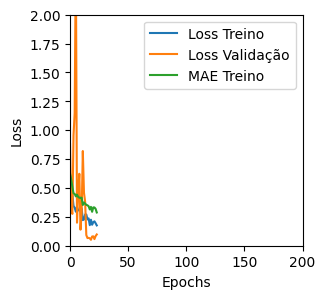

Tempo de treino: 0.14569071531295777 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.45217618346214294 , MAE = 0.5102893114089966'

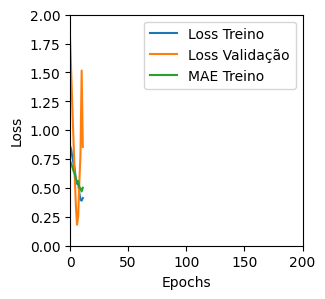

Tempo de treino: 0.07595813671747843 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4154553711414337 , MAE = 0.48532986640930176'

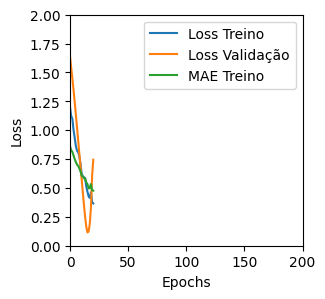

Tempo de treino: 0.08124195337295533 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6287310719490051 , MAE = 0.5969297885894775'

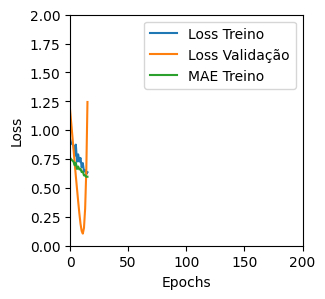

Tempo de treino: 0.05032333532969157 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10263443738222122 , MAE = 0.2279883623123169'

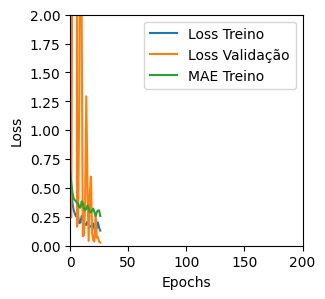

Tempo de treino: 0.2019311745961507 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2373652458190918 , MAE = 0.35657501220703125'

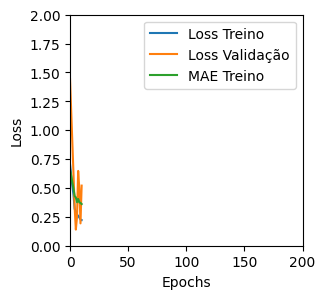

Tempo de treino: 0.05197071234385173 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37475961446762085 , MAE = 0.46165329217910767'

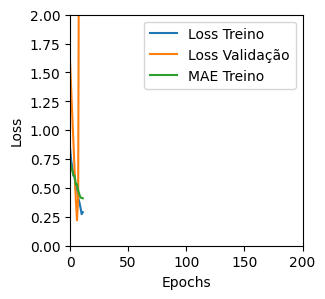

Tempo de treino: 0.08524663845698038 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4862002432346344 , MAE = 0.526972770690918'

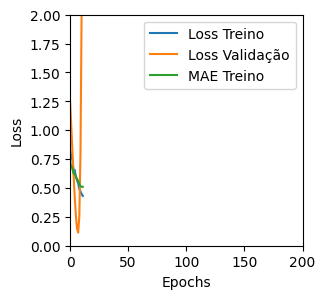

Tempo de treino: 0.0546112060546875 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17167380452156067 , MAE = 0.30886584520339966'

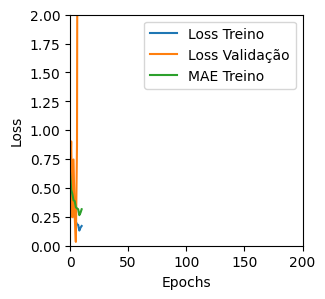

Tempo de treino: 0.08469240665435791 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3103772699832916 , MAE = 0.4308149516582489'

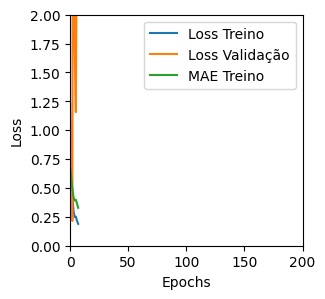

Tempo de treino: 0.07965683937072754 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3842899799346924 , MAE = 0.4754174053668976'

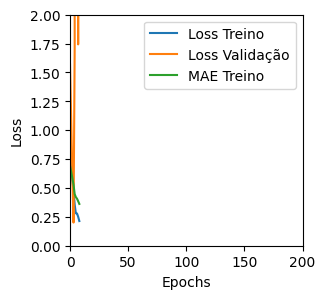

Tempo de treino: 0.04986976782480876 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3780635595321655 , MAE = 0.4539201855659485'

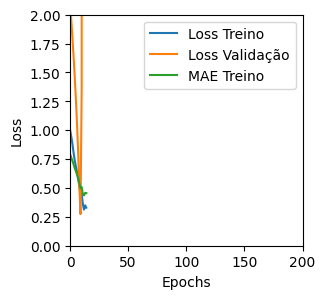

Tempo de treino: 0.04743355909983317 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.045586876571178436 , MAE = 0.167207732796669'

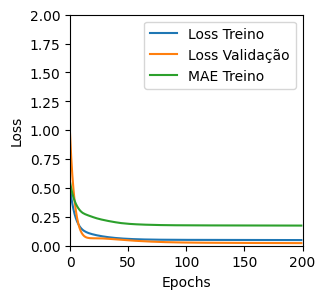

Tempo de treino: 0.7145395874977112 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07903525978326797 , MAE = 0.22598713636398315'

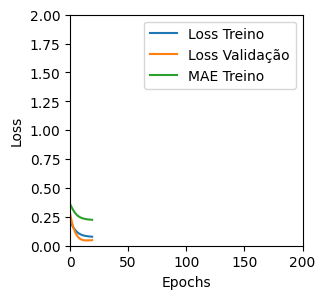

Tempo de treino: 0.09536792834599812 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07285010814666748 , MAE = 0.20806041359901428'

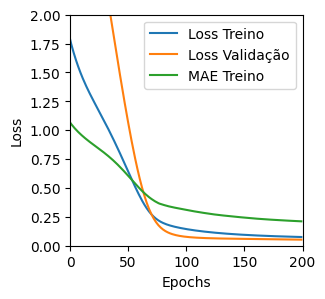

Tempo de treino: 0.3809099793434143 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.08572153002023697 , MAE = 0.23120620846748352'

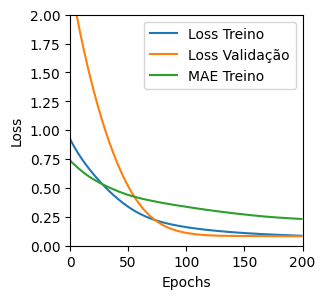

Tempo de treino: 0.38165333271026614 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.050937898457050323 , MAE = 0.17195391654968262'

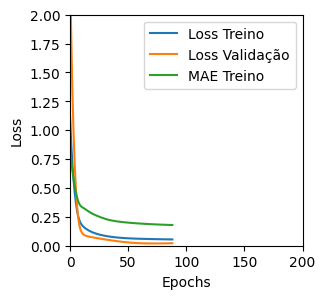

Tempo de treino: 0.3878208835919698 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05113054811954498 , MAE = 0.17394357919692993'

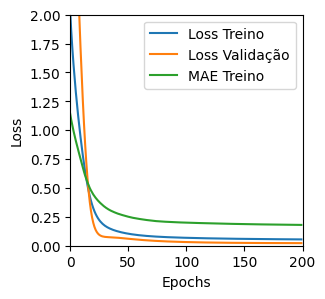

Tempo de treino: 0.48324714104334515 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1623496264219284 , MAE = 0.324869304895401'

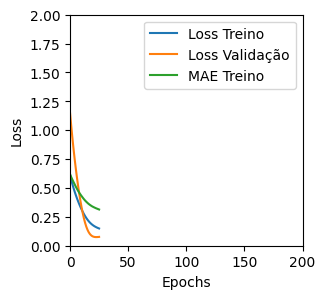

Tempo de treino: 0.07919387817382813 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16260510683059692 , MAE = 0.33340856432914734'

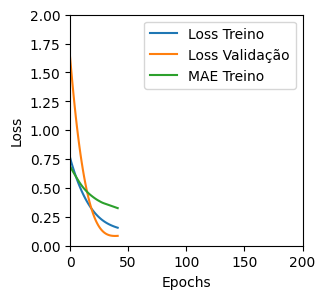

Tempo de treino: 0.08726799488067627 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044986821711063385 , MAE = 0.1631956547498703'

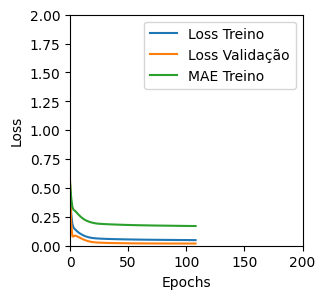

Tempo de treino: 0.4045290231704712 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16677728295326233 , MAE = 0.3214336037635803'

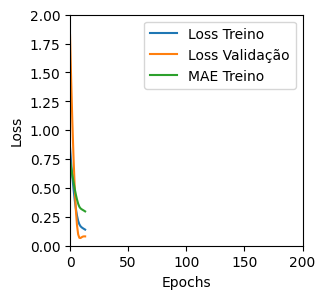

Tempo de treino: 0.07635622421900432 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.053839266300201416 , MAE = 0.17843855917453766'

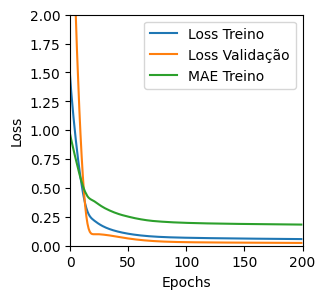

Tempo de treino: 0.33008627891540526 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18574993312358856 , MAE = 0.3442097306251526'

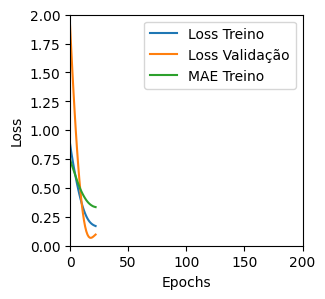

Tempo de treino: 0.06544011433919271 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.040852684527635574 , MAE = 0.1539798527956009'

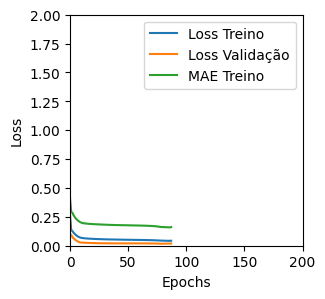

Tempo de treino: 0.37046226660410564 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04578882455825806 , MAE = 0.16462484002113342'

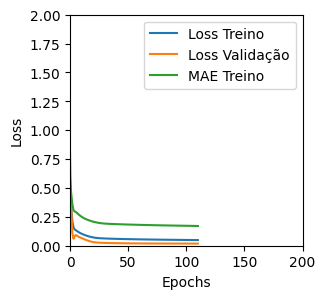

Tempo de treino: 0.27250800530115765 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1257433295249939 , MAE = 0.27240267395973206'

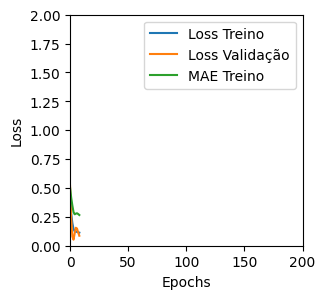

Tempo de treino: 0.08470706542332967 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35216718912124634 , MAE = 0.47174403071403503'

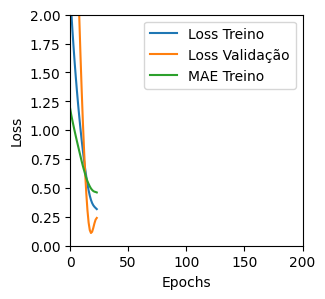

Tempo de treino: 0.07889177799224853 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046860434114933014 , MAE = 0.16810813546180725'

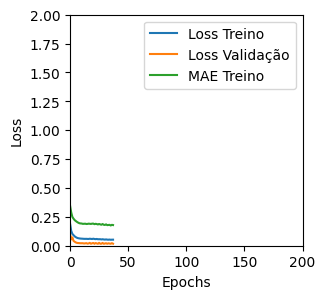

Tempo de treino: 0.20730342070261637 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04931217432022095 , MAE = 0.17033517360687256'

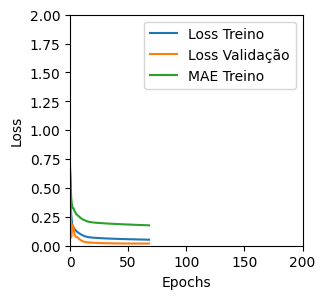

Tempo de treino: 0.383241605758667 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.038086190819740295 , MAE = 0.14875981211662292'

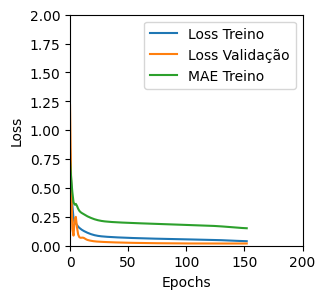

Tempo de treino: 0.3830411354700724 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17566893994808197 , MAE = 0.3237093389034271'

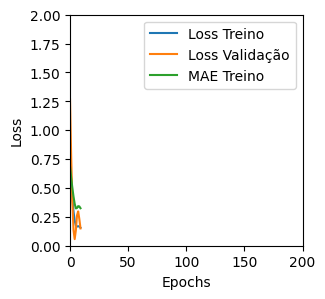

Tempo de treino: 0.08342802127202352 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36300212144851685 , MAE = 0.44745439291000366'

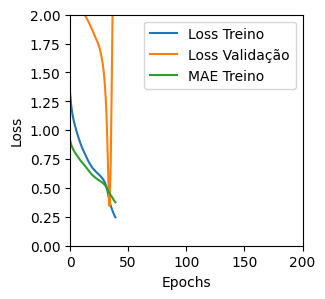

Tempo de treino: 0.20052923361460367 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9713242053985596 , MAE = 0.7633350491523743'

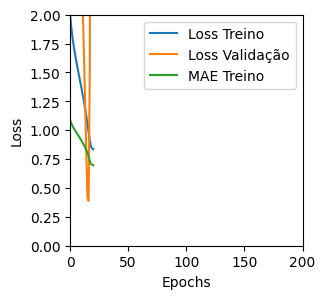

Tempo de treino: 0.07637609243392944 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22708308696746826 , MAE = 0.3451540470123291'

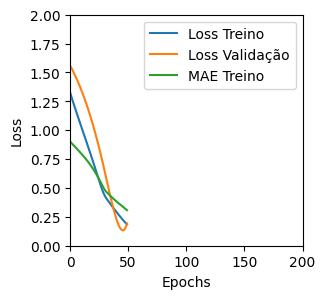

Tempo de treino: 0.11278800169626872 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7275364398956299 , MAE = 0.6495637893676758'

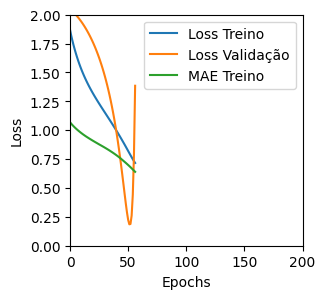

Tempo de treino: 0.11092114448547363 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43871408700942993 , MAE = 0.4973759353160858'

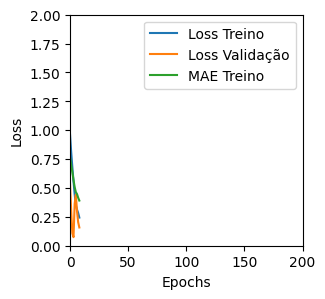

Tempo de treino: 0.07198879718780518 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7096048593521118 , MAE = 0.669407069683075'

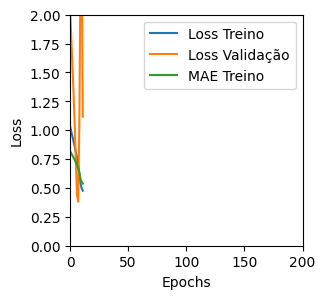

Tempo de treino: 0.07364803552627563 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24109987914562225 , MAE = 0.36391305923461914'

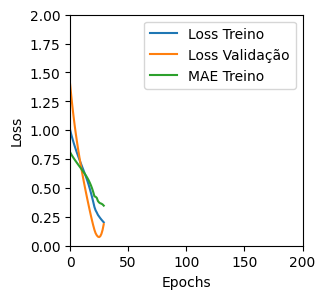

Tempo de treino: 0.1187255859375 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2551034390926361 , MAE = 0.3877268433570862'

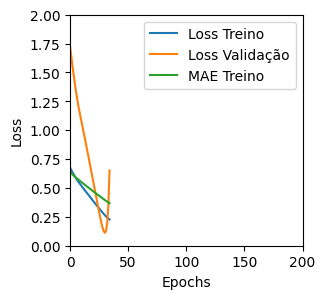

Tempo de treino: 0.0635456919670105 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6793220639228821 , MAE = 0.6134319305419922'

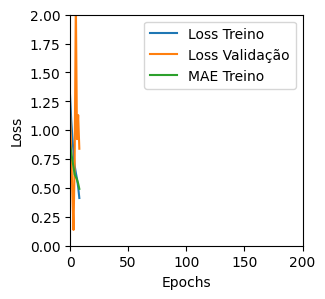

Tempo de treino: 0.06761790513992309 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8113516569137573 , MAE = 0.7023627161979675'

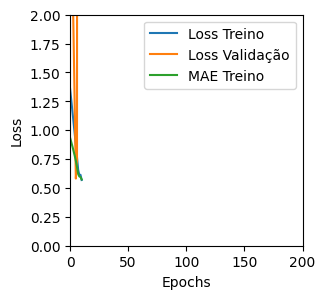

Tempo de treino: 0.07648499806722005 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5886726975440979 , MAE = 0.5932087898254395'

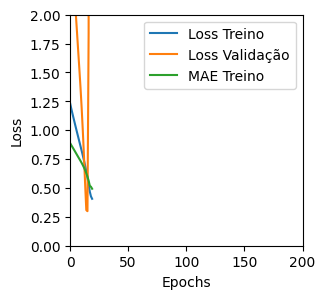

Tempo de treino: 0.05640225013097127 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.34905973076820374 , MAE = 0.4267876446247101'

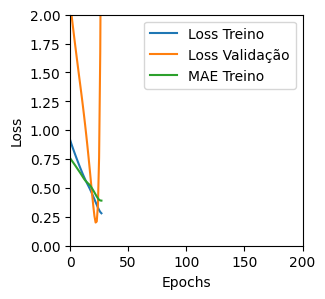

Tempo de treino: 0.052283525466918945 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.164741650223732 , MAE = 0.29246434569358826'

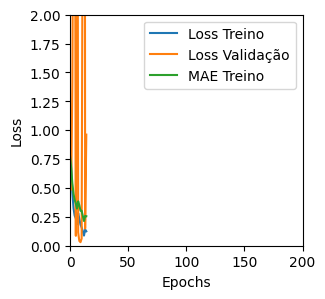

Tempo de treino: 0.13033108313878378 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4778682589530945 , MAE = 0.5269019603729248'

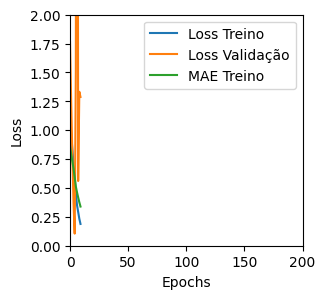

Tempo de treino: 0.08171856005986532 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.538926362991333 , MAE = 0.5727612972259521'

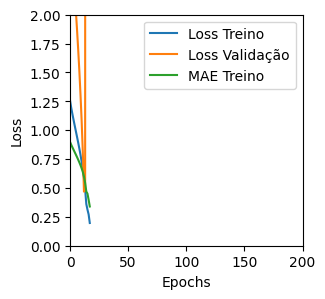

Tempo de treino: 0.0648084044456482 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4461911916732788 , MAE = 0.4955677390098572'

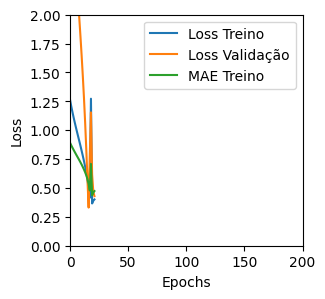

Tempo de treino: 0.054024382432301836 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28413888812065125 , MAE = 0.4100385308265686'

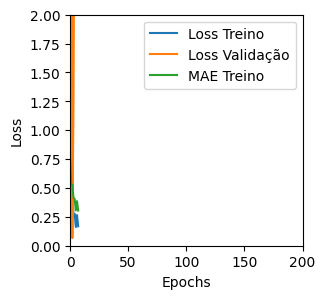

Tempo de treino: 0.06647189458211263 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23885345458984375 , MAE = 0.3683670461177826'

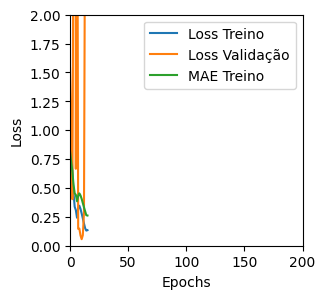

Tempo de treino: 0.11691907246907553 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2995239794254303 , MAE = 0.41365447640419006'

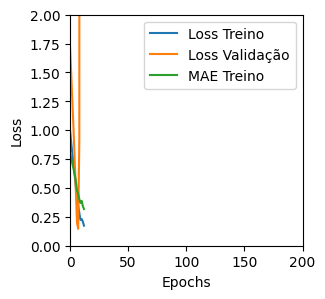

Tempo de treino: 0.04982610940933228 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.32670488953590393 , MAE = 0.4314813017845154'

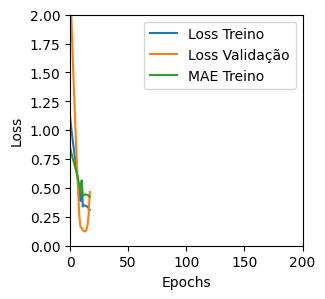

Tempo de treino: 0.0523643970489502 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8296314477920532 , MAE = 0.7114002704620361'

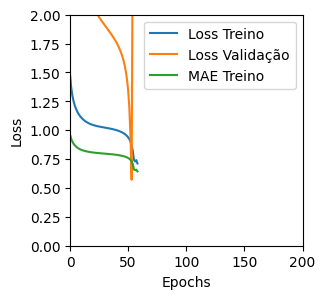

Tempo de treino: 0.28549466530481976 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 1.1559265851974487 , MAE = 0.7617018818855286'

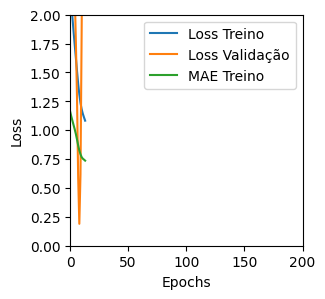

Tempo de treino: 0.0751869797706604 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29799073934555054 , MAE = 0.3803609609603882'

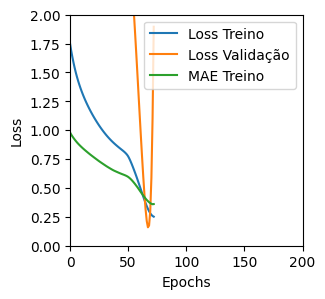

Tempo de treino: 0.13884873390197755 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3766070306301117 , MAE = 0.4581502377986908'

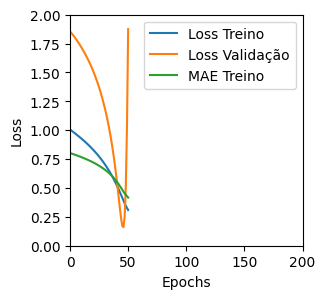

Tempo de treino: 0.07573991616566976 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6181806325912476 , MAE = 0.596972644329071'

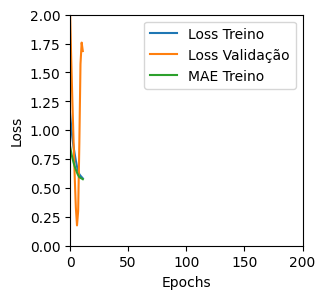

Tempo de treino: 0.0808298667271932 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2840970754623413 , MAE = 0.40200668573379517'

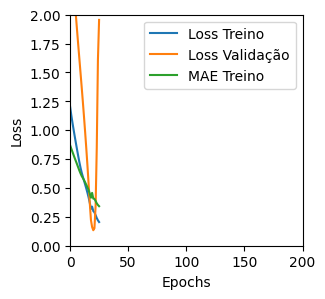

Tempo de treino: 0.11197803815205892 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47108107805252075 , MAE = 0.5287171006202698'

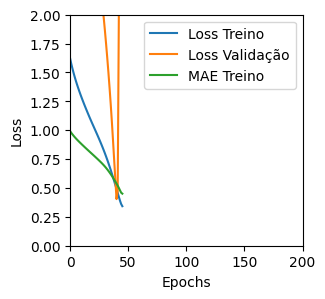

Tempo de treino: 0.1167279322942098 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


'TRAINING set. Loss = 0.6592364311218262 , MAE = 0.6076539754867554'

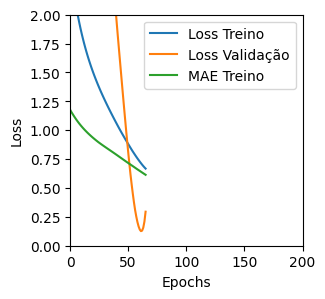

Tempo de treino: 0.11397390762964885 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44226497411727905 , MAE = 0.45694735646247864'

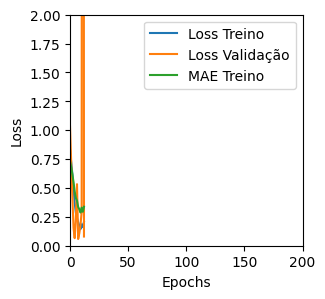

Tempo de treino: 0.1165906270345052 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2819552421569824 , MAE = 0.3920077681541443'

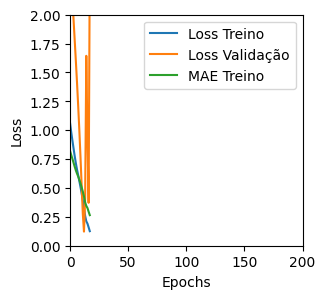

Tempo de treino: 0.11367382208506266 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2563057541847229 , MAE = 0.36894649267196655'

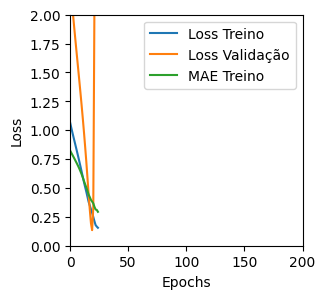

Tempo de treino: 0.07071932554244995 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3883928060531616 , MAE = 0.47558194398880005'

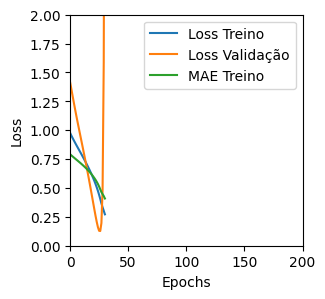

Tempo de treino: 0.06980830430984497 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2667264938354492 , MAE = 0.3848353326320648'

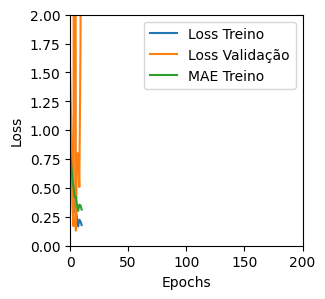

Tempo de treino: 0.07307904561360677 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47983312606811523 , MAE = 0.5164158344268799'

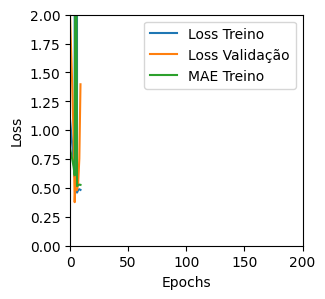

Tempo de treino: 0.07085804144541423 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4679667055606842 , MAE = 0.5238205194473267'

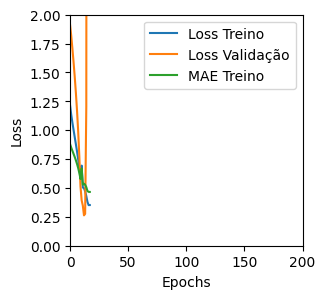

Tempo de treino: 0.07342593272527059 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5139402151107788 , MAE = 0.5505865812301636'

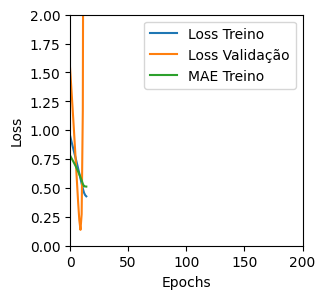

Tempo de treino: 0.05336555242538452 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3956092298030853 , MAE = 0.48859983682632446'

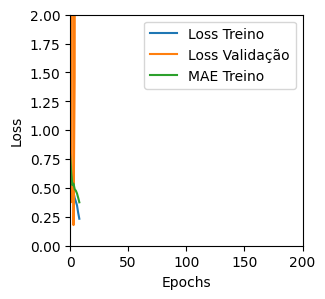

Tempo de treino: 0.07396628856658935 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41285696625709534 , MAE = 0.48524147272109985'

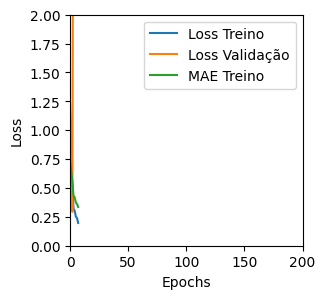

Tempo de treino: 0.061987030506134036 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3205331861972809 , MAE = 0.41978272795677185'

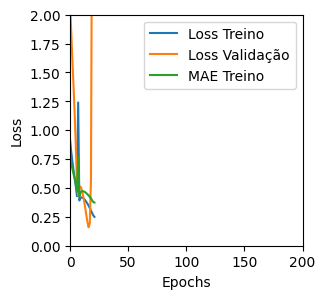

Tempo de treino: 0.06394416093826294 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3949151337146759 , MAE = 0.45980948209762573'

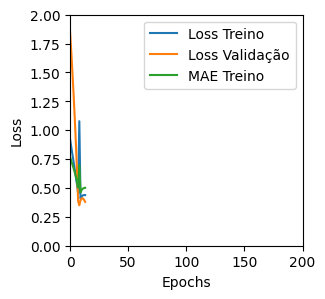

Tempo de treino: 0.04784891208012899 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3371241092681885 , MAE = 0.4166542589664459'

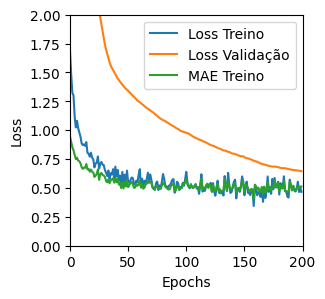

Tempo de treino: 1.4250040729840596 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44707268476486206 , MAE = 0.49182382225990295'

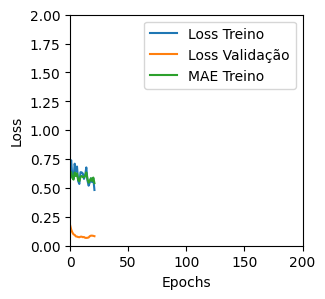

Tempo de treino: 0.0910468300183614 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.407904714345932 , MAE = 0.49105414748191833'

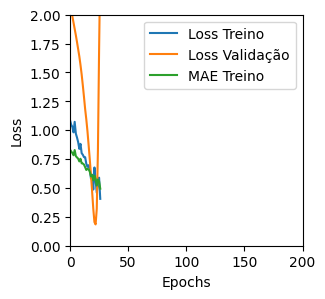

Tempo de treino: 0.12003822326660156 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29517877101898193 , MAE = 0.4113066792488098'

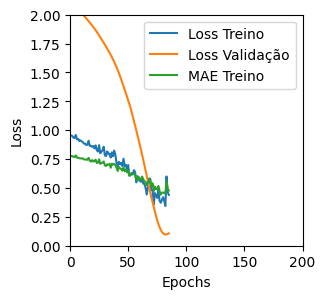

Tempo de treino: 0.1076317310333252 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4264017939567566 , MAE = 0.4627418518066406'

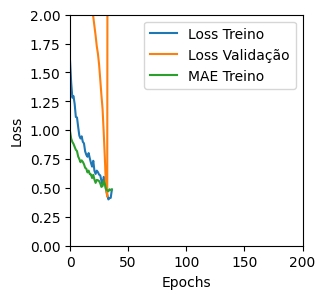

Tempo de treino: 0.20858721335728964 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2512209713459015 , MAE = 0.371490478515625'

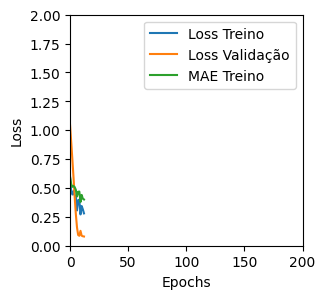

Tempo de treino: 0.06295891205469767 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3298541009426117 , MAE = 0.44101381301879883'

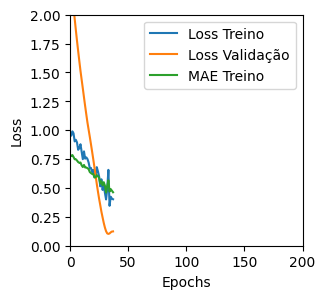

Tempo de treino: 0.07612706820170084 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.565849781036377 , MAE = 0.5849320888519287'

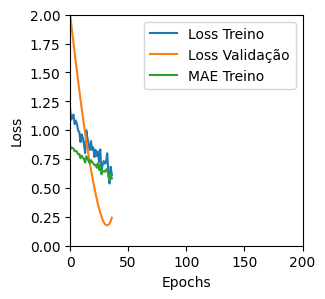

Tempo de treino: 0.14629777669906616 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6134577989578247 , MAE = 0.6156154870986938'

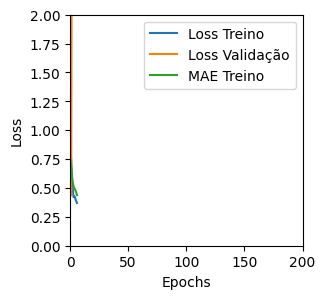

Tempo de treino: 0.07863932847976685 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4362761676311493 , MAE = 0.49600717425346375'

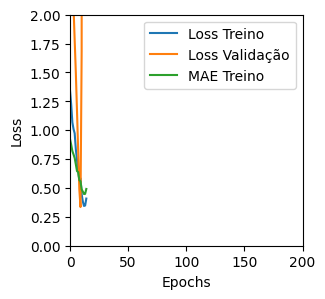

Tempo de treino: 0.078379754225413 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7832654714584351 , MAE = 0.6999359726905823'

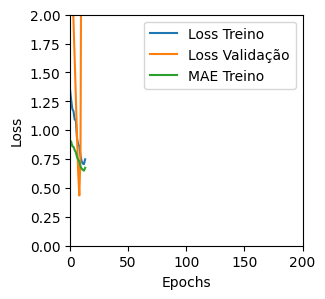

Tempo de treino: 0.06256408294041951 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3603076636791229 , MAE = 0.43075352907180786'

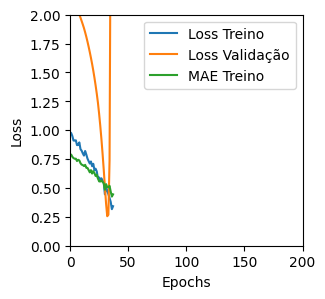

Tempo de treino: 0.0810481588045756 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22162267565727234 , MAE = 0.3508024215698242'

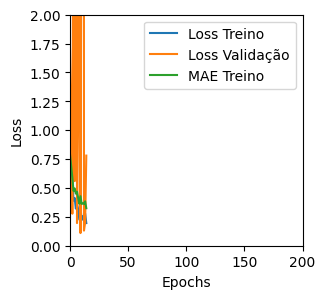

Tempo de treino: 0.09357691605885823 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5476385354995728 , MAE = 0.5697913765907288'

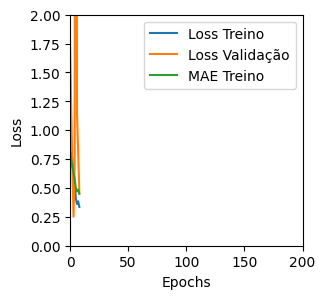

Tempo de treino: 0.07213255564371744 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4252578914165497 , MAE = 0.4975048899650574'

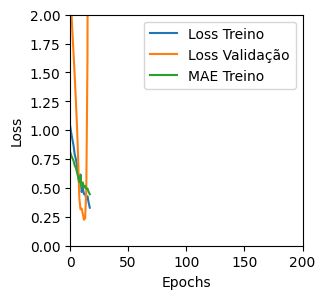

Tempo de treino: 0.09229556719462077 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38374850153923035 , MAE = 0.4754170775413513'

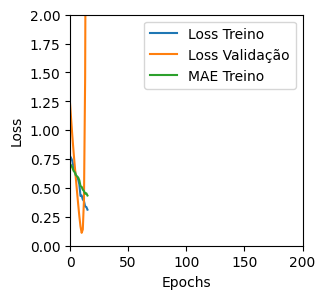

Tempo de treino: 0.08399610916773478 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2019464075565338 , MAE = 0.3229389488697052'

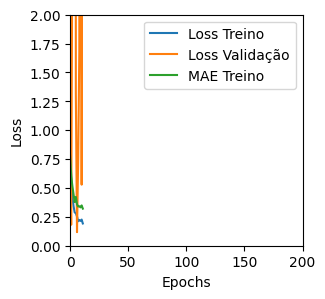

Tempo de treino: 0.09897731939951579 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43487098813056946 , MAE = 0.5068666934967041'

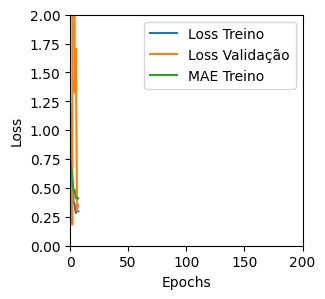

Tempo de treino: 0.07431855996449789 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42691799998283386 , MAE = 0.49859514832496643'

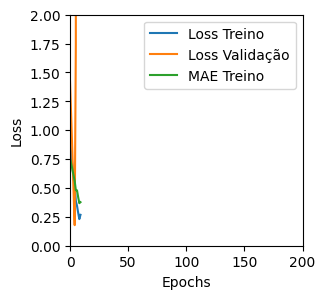

Tempo de treino: 0.07190037965774536 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.384095698595047 , MAE = 0.44111672043800354'

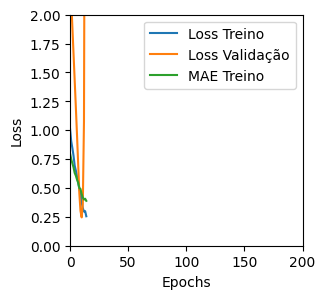

Tempo de treino: 0.04952784379323324 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04959185793995857 , MAE = 0.17449477314949036'

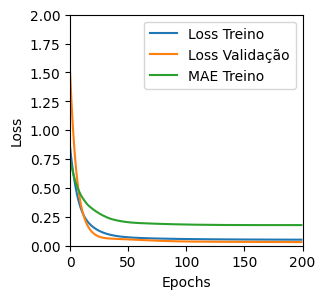

Tempo de treino: 1.3997767885526022 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12290975451469421 , MAE = 0.2851529121398926'

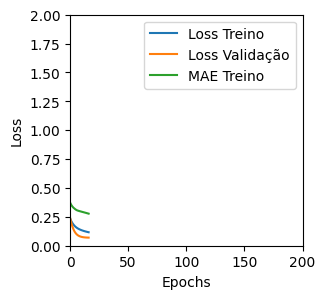

Tempo de treino: 0.15204565127690634 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1399904042482376 , MAE = 0.30284544825553894'

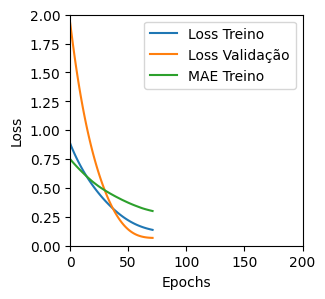

Tempo de treino: 0.15239175160725912 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14502833783626556 , MAE = 0.30942341685295105'

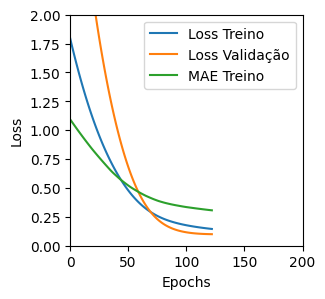

Tempo de treino: 0.20847549041112265 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1644865721464157 , MAE = 0.32354238629341125'

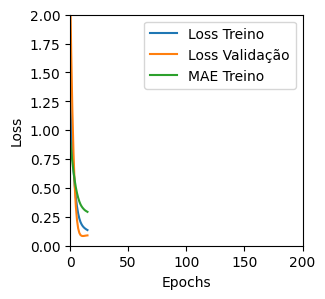

Tempo de treino: 0.11883088747660318 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1576036810874939 , MAE = 0.3187338709831238'

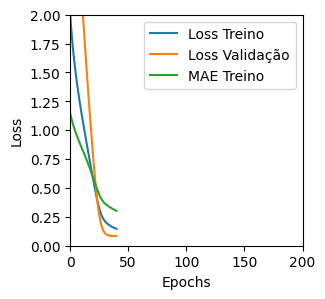

Tempo de treino: 0.13910517692565919 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15826892852783203 , MAE = 0.31615883111953735'

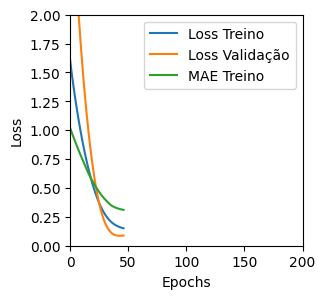

Tempo de treino: 0.15114423831303914 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12030898034572601 , MAE = 0.278839111328125'

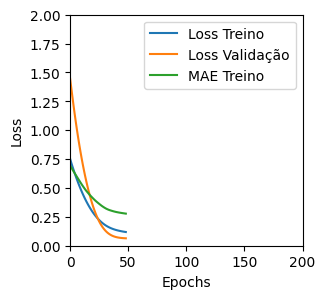

Tempo de treino: 0.12330907583236694 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1721143126487732 , MAE = 0.3221021592617035'

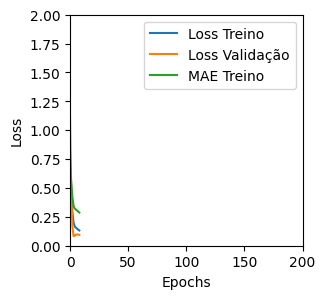

Tempo de treino: 0.08050040006637574 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22876548767089844 , MAE = 0.3726756274700165'

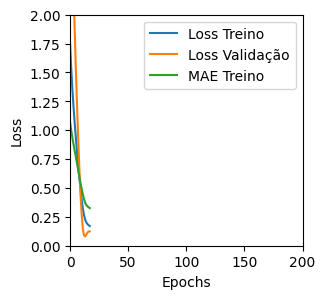

Tempo de treino: 0.12122324705123902 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16587936878204346 , MAE = 0.31783974170684814'

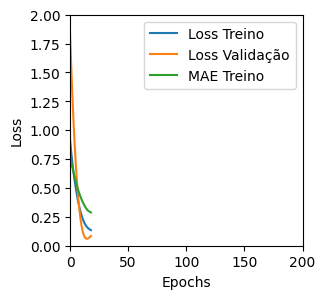

Tempo de treino: 0.0674337108929952 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10583693534135818 , MAE = 0.24729473888874054'

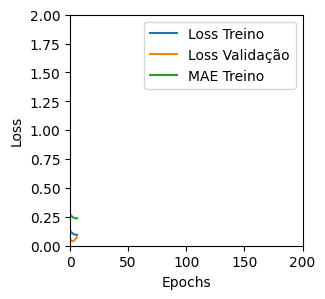

Tempo de treino: 0.10170568227767944 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04689440503716469 , MAE = 0.1686978042125702'

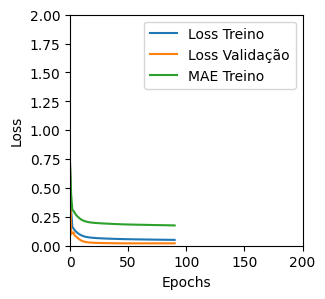

Tempo de treino: 0.7222954710324605 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1289934664964676 , MAE = 0.27292338013648987'

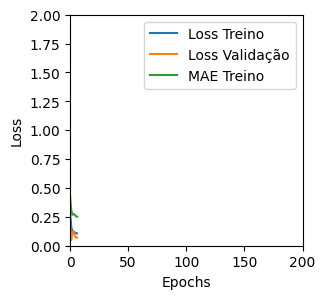

Tempo de treino: 0.08486965894699097 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19528377056121826 , MAE = 0.33848488330841064'

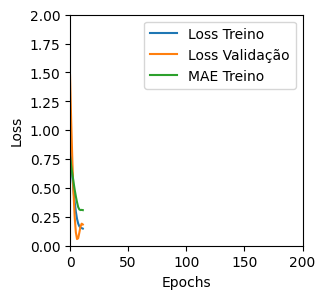

Tempo de treino: 0.059720881779988605 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16166022419929504 , MAE = 0.3063473701477051'

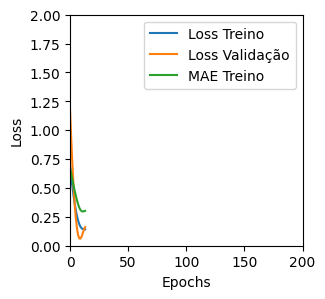

Tempo de treino: 0.0949317971865336 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05208992585539818 , MAE = 0.17188766598701477'

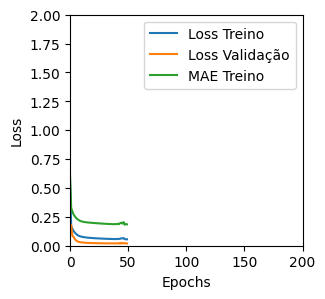

Tempo de treino: 0.3006841778755188 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0478895865380764 , MAE = 0.16840164363384247'

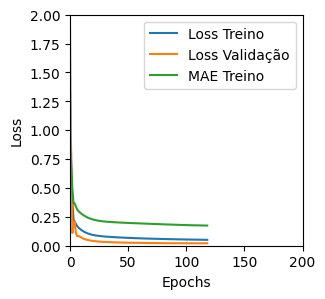

Tempo de treino: 0.39850582281748453 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0511205829679966 , MAE = 0.17295348644256592'

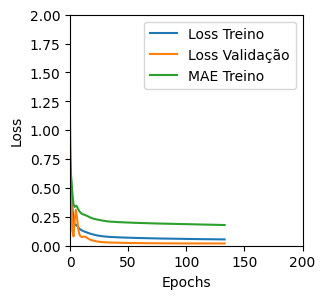

Tempo de treino: 0.27484052975972495 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2063162922859192 , MAE = 0.3462298810482025'

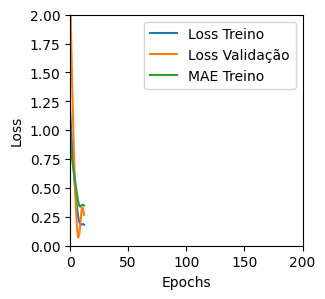

Tempo de treino: 0.056420111656188966 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.47869613766670227 , MAE = 0.5239360928535461'

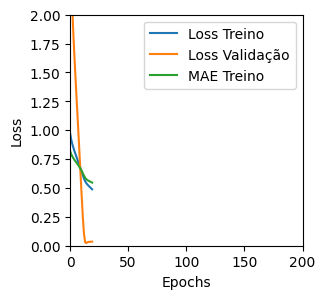

Tempo de treino: 0.10669604539871216 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5583124756813049 , MAE = 0.5687590837478638'

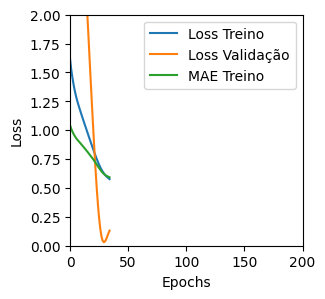

Tempo de treino: 0.07831286191940308 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1450687199831009 , MAE = 0.28878816962242126'

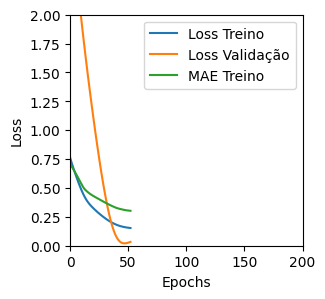

Tempo de treino: 0.07449473937352498 minutos
Treinando com LSTM_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1393175721168518 , MAE = 0.2994578778743744'

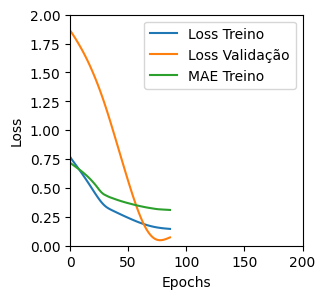

Tempo de treino: 0.11904009183247884 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13617724180221558 , MAE = 0.2868947386741638'

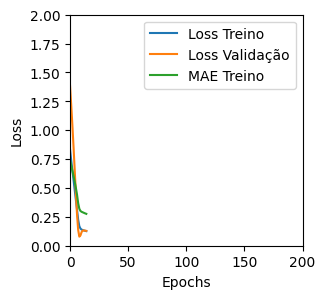

Tempo de treino: 0.06978122790654501 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15884089469909668 , MAE = 0.3081054389476776'

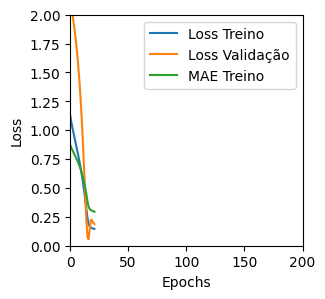

Tempo de treino: 0.06037537654240926 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12361165136098862 , MAE = 0.2695077955722809'

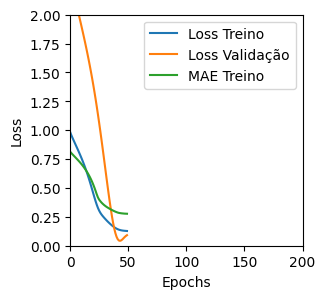

Tempo de treino: 0.0646649996439616 minutos
Treinando com LSTM_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13327616453170776 , MAE = 0.2763387858867645'

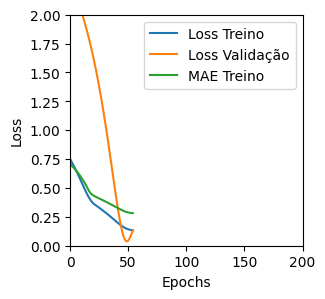

Tempo de treino: 0.10700105428695679 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14556525647640228 , MAE = 0.2936500608921051'

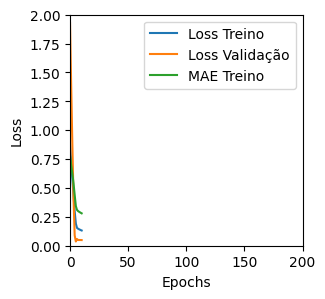

Tempo de treino: 0.06155802408854167 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15017034113407135 , MAE = 0.29956477880477905'

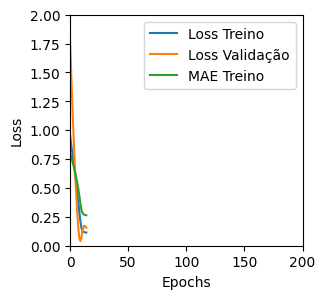

Tempo de treino: 0.05360319217046102 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14400531351566315 , MAE = 0.2879571318626404'

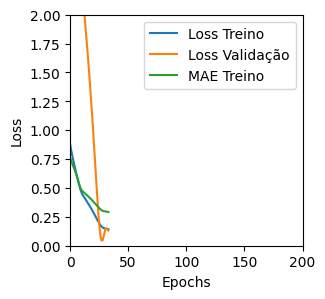

Tempo de treino: 0.06328192949295045 minutos
Treinando com LSTM_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36393675208091736 , MAE = 0.46217989921569824'

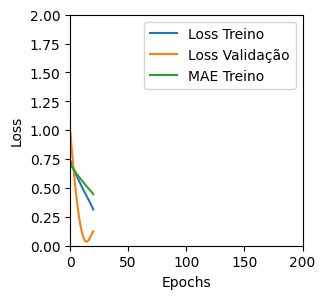

Tempo de treino: 0.04918922583262126 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14346908032894135 , MAE = 0.28499919176101685'

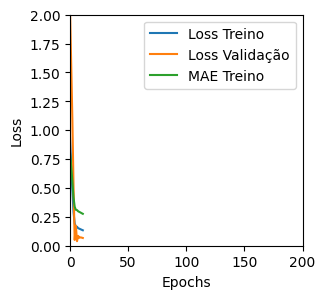

Tempo de treino: 0.07013502915700277 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15984436869621277 , MAE = 0.30378907918930054'

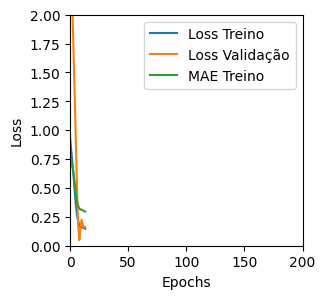

Tempo de treino: 0.04578731854756673 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13997824490070343 , MAE = 0.2821842133998871'

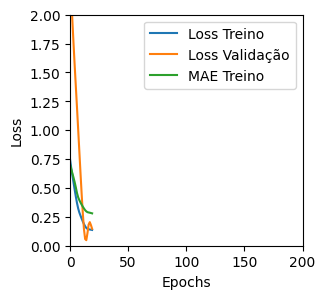

Tempo de treino: 0.07220513423283895 minutos
Treinando com LSTM_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14987711608409882 , MAE = 0.28943508863449097'

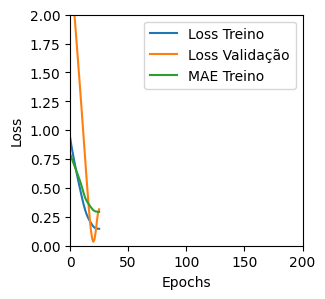

Tempo de treino: 0.061448860168457034 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14107534289360046 , MAE = 0.28089162707328796'

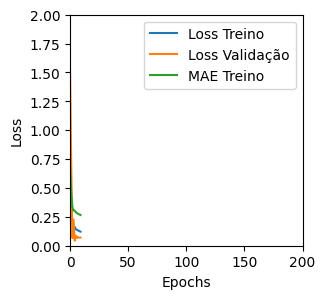

Tempo de treino: 0.07666175762812297 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14245040714740753 , MAE = 0.2886069118976593'

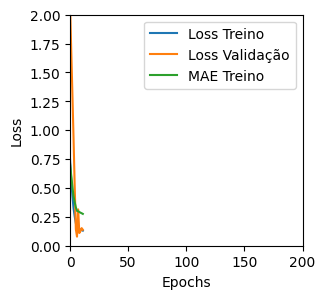

Tempo de treino: 0.05440657138824463 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14317169785499573 , MAE = 0.2839895784854889'

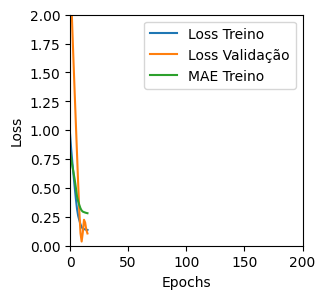

Tempo de treino: 0.048714947700500486 minutos
Treinando com LSTM_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18638348579406738 , MAE = 0.3336188495159149'

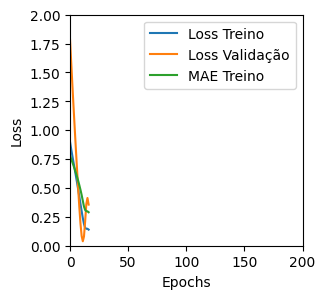

Tempo de treino: 0.040547708670298256 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5441901683807373 , MAE = 0.5612181425094604'

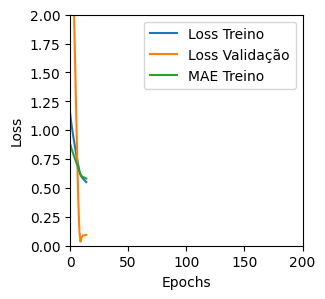

Tempo de treino: 0.06777003208796183 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1020214781165123 , MAE = 0.23602083325386047'

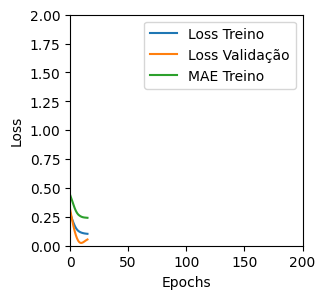

Tempo de treino: 0.052292152245839434 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16107958555221558 , MAE = 0.3009752929210663'

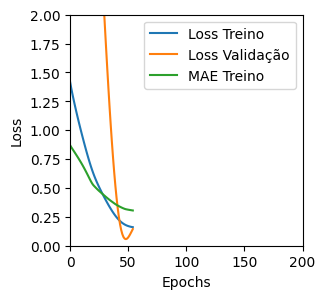

Tempo de treino: 0.1431295394897461 minutos
Treinando com LSTM_v2 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42634108662605286 , MAE = 0.4425751566886902'

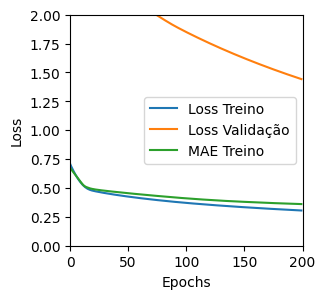

Tempo de treino: 0.2126011848449707 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12876375019550323 , MAE = 0.27486664056777954'

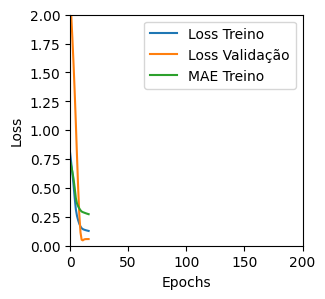

Tempo de treino: 0.07029982805252075 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24348518252372742 , MAE = 0.38230085372924805'

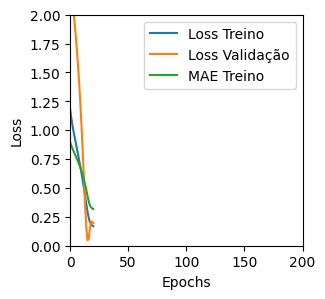

Tempo de treino: 0.05649440685908 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1371949464082718 , MAE = 0.2762529253959656'

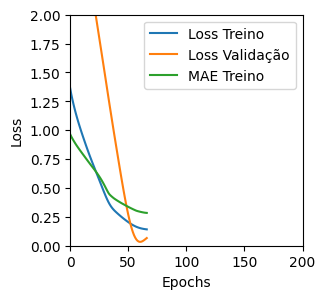

Tempo de treino: 0.11366706291834514 minutos
Treinando com LSTM_v2 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14990022778511047 , MAE = 0.2974020540714264'

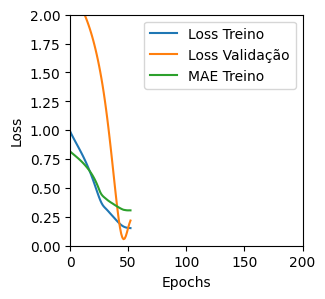

Tempo de treino: 0.0692899743715922 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13808827102184296 , MAE = 0.28197094798088074'

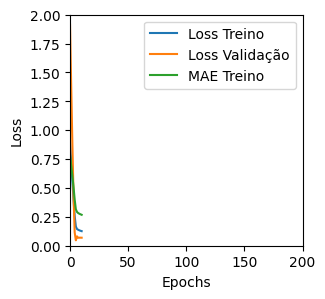

Tempo de treino: 0.0493576447168986 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12998256087303162 , MAE = 0.268667608499527'

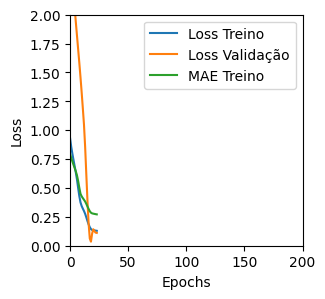

Tempo de treino: 0.07958364089330038 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14463013410568237 , MAE = 0.28247901797294617'

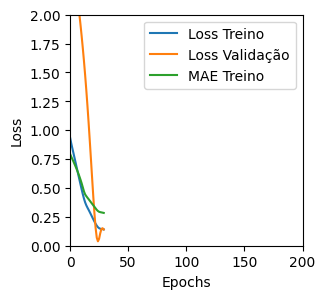

Tempo de treino: 0.07993748188018798 minutos
Treinando com LSTM_v2 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12876832485198975 , MAE = 0.27013176679611206'

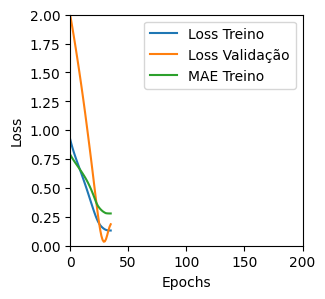

Tempo de treino: 0.06451894044876098 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13142594695091248 , MAE = 0.275802344083786'

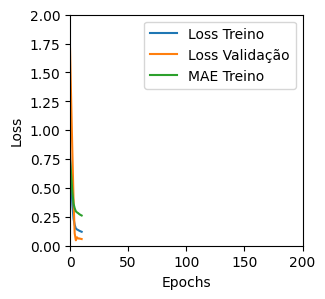

Tempo de treino: 0.05823150873184204 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15218324959278107 , MAE = 0.29175758361816406'

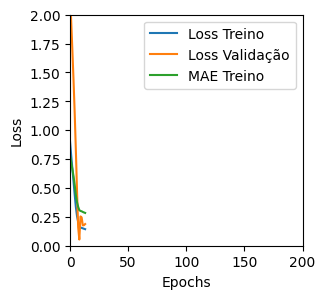

Tempo de treino: 0.0502629558245341 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14179381728172302 , MAE = 0.28042683005332947'

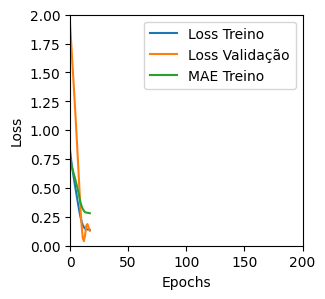

Tempo de treino: 0.04594876766204834 minutos
Treinando com LSTM_v2 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2006644606590271 , MAE = 0.33492395281791687'

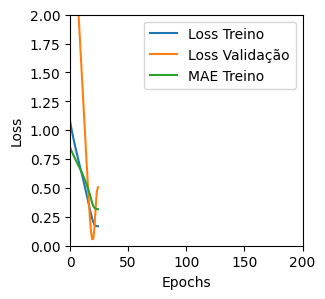

Tempo de treino: 0.07165725628534952 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14164647459983826 , MAE = 0.283345103263855'

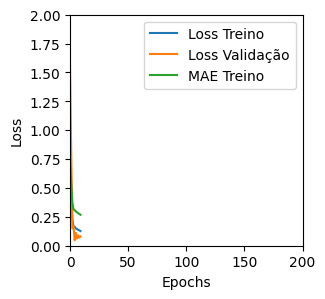

Tempo de treino: 0.06690548261006674 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14356793463230133 , MAE = 0.2854483127593994'

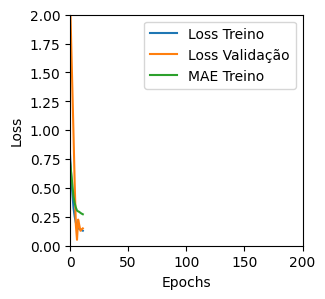

Tempo de treino: 0.058111294110616045 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15124616026878357 , MAE = 0.29218578338623047'

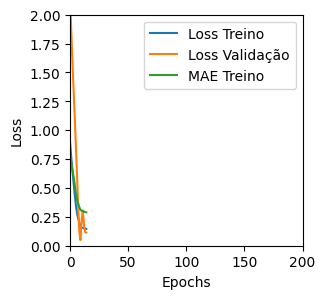

Tempo de treino: 0.05718369086583455 minutos
Treinando com LSTM_v2 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15269216895103455 , MAE = 0.2920598089694977'

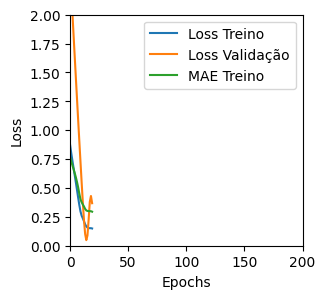

Tempo de treino: 0.05243380069732666 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16423657536506653 , MAE = 0.31895244121551514'

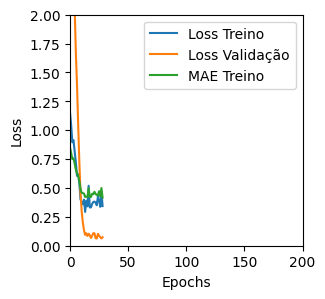

Tempo de treino: 0.08144938151041667 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20363447070121765 , MAE = 0.34685251116752625'

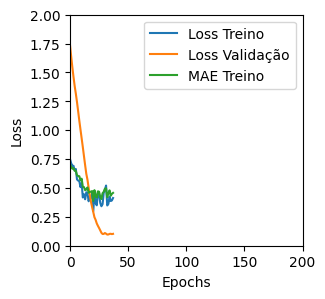

Tempo de treino: 0.07791325648625692 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1702461838722229 , MAE = 0.31304535269737244'

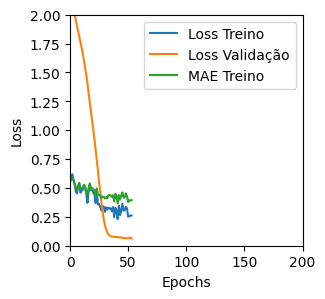

Tempo de treino: 0.07068480650583903 minutos
Treinando com LSTM_v3 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5242496132850647 , MAE = 0.5601682662963867'

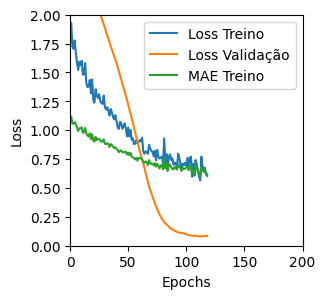

Tempo de treino: 0.11216763655344646 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2973894774913788 , MAE = 0.38243842124938965'

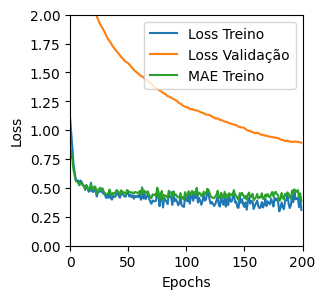

Tempo de treino: 0.7386266430219014 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15493078529834747 , MAE = 0.3038146495819092'

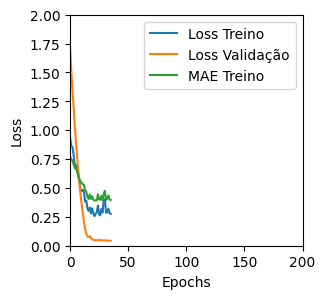

Tempo de treino: 0.11953128178914388 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5835959911346436 , MAE = 0.5793994665145874'

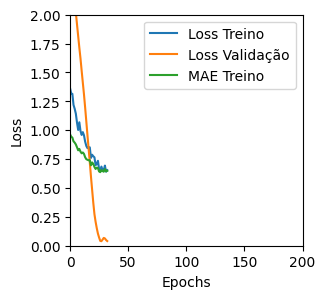

Tempo de treino: 0.08273466030756632 minutos
Treinando com LSTM_v3 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2428743690252304 , MAE = 0.38476449251174927'

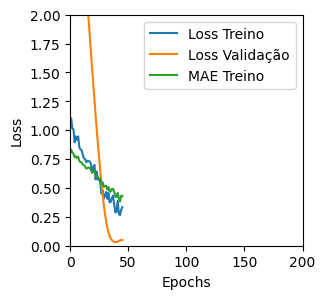

Tempo de treino: 0.061152970790863036 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14371927082538605 , MAE = 0.28291383385658264'

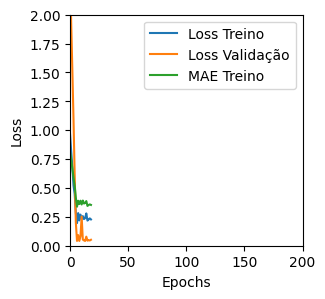

Tempo de treino: 0.0726563056310018 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15488047897815704 , MAE = 0.29719507694244385'

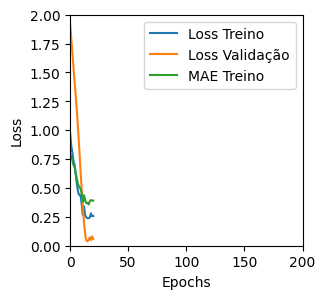

Tempo de treino: 0.06395212014516195 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17606447637081146 , MAE = 0.31078073382377625'

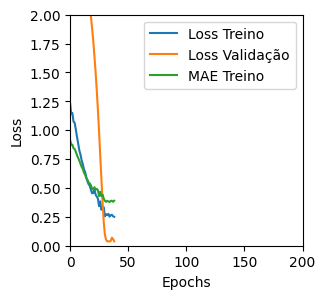

Tempo de treino: 0.05930529832839966 minutos
Treinando com LSTM_v3 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16013717651367188 , MAE = 0.2940766215324402'

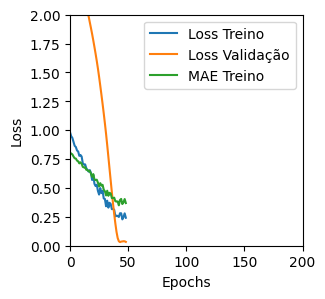

Tempo de treino: 0.07654718557993571 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1061498373746872 , MAE = 0.2397288978099823'

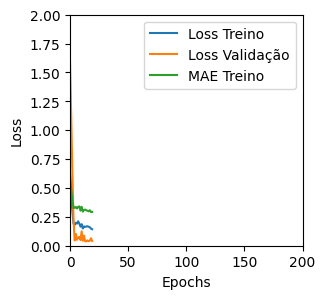

Tempo de treino: 0.09106846650441487 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11742427200078964 , MAE = 0.26113295555114746'

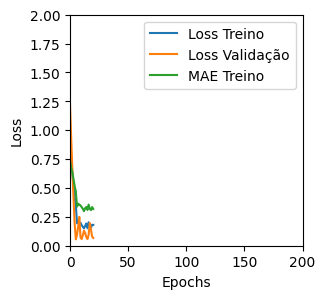

Tempo de treino: 0.07543711662292481 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1643495410680771 , MAE = 0.2996995747089386'

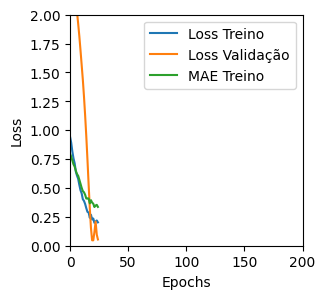

Tempo de treino: 0.07345182498296102 minutos
Treinando com LSTM_v3 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16171373426914215 , MAE = 0.3027419447898865'

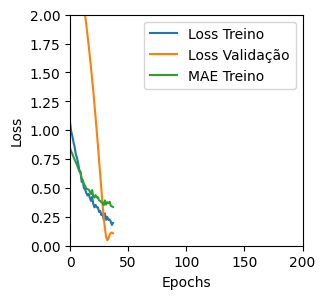

Tempo de treino: 0.07176224788029989 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11119149625301361 , MAE = 0.25082966685295105'

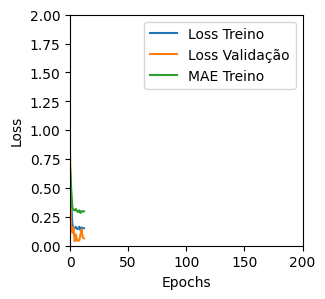

Tempo de treino: 0.07068818807601929 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19960157573223114 , MAE = 0.34569281339645386'

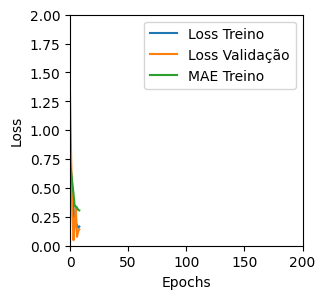

Tempo de treino: 0.05466932455698649 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14119547605514526 , MAE = 0.28347110748291016'

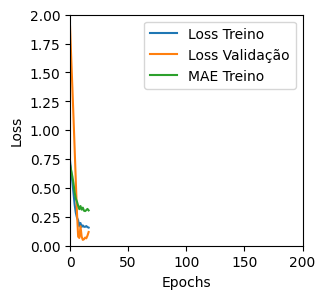

Tempo de treino: 0.04491868813832601 minutos
Treinando com LSTM_v3 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15560872852802277 , MAE = 0.29395782947540283'

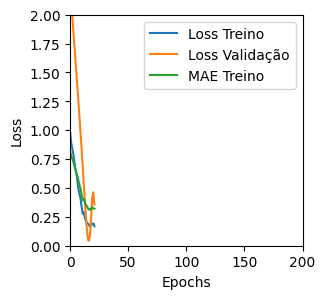

Tempo de treino: 0.09895357290903727 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (131, 6, 1) (12, 6, 1) (131, 1) (12, 1)
Treinando com GRU_v1 , timesteps=6, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04210706427693367 , MAE = 0.15888093411922455'

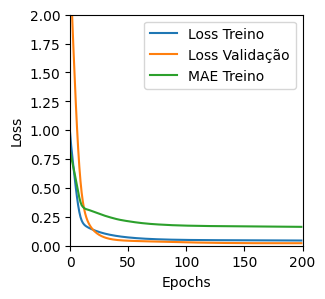

Tempo de treino: 0.7298988461494446 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04538721963763237 , MAE = 0.16422800719738007'

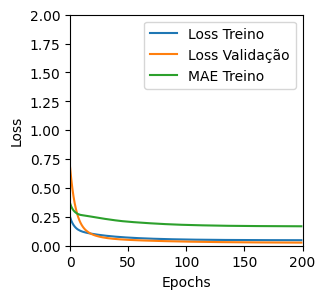

Tempo de treino: 0.305332883199056 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06596986949443817 , MAE = 0.19969308376312256'

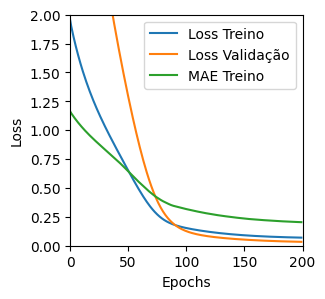

Tempo de treino: 0.20385820070902508 minutos
Treinando com GRU_v1 , timesteps=6, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05847924202680588 , MAE = 0.18942080438137054'

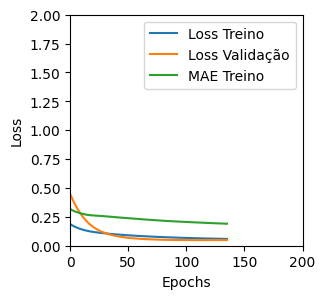

Tempo de treino: 0.1256456176439921 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044233620166778564 , MAE = 0.16095025837421417'

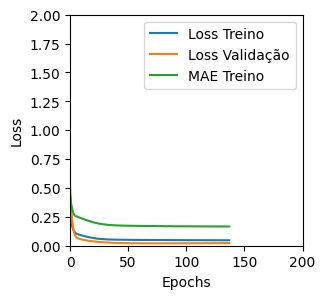

Tempo de treino: 0.34620053370793663 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04251788184046745 , MAE = 0.15711289644241333'

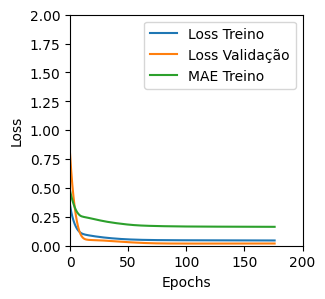

Tempo de treino: 0.38019463221232097 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05022447183728218 , MAE = 0.17230787873268127'

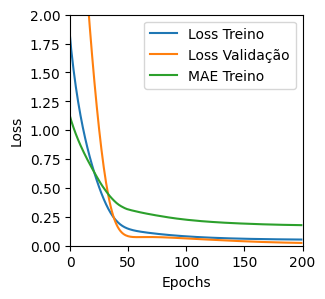

Tempo de treino: 0.2060557762781779 minutos
Treinando com GRU_v1 , timesteps=6, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.047419168055057526 , MAE = 0.17032206058502197'

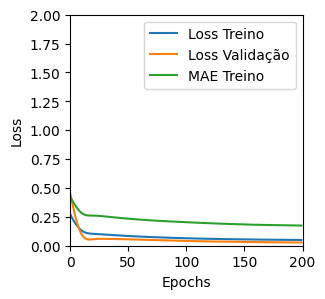

Tempo de treino: 0.1691035548845927 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.044610343873500824 , MAE = 0.1622680276632309'

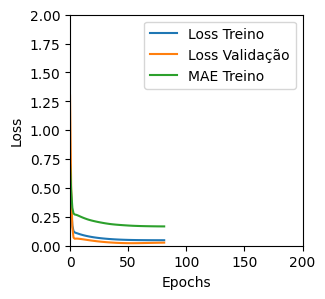

Tempo de treino: 0.23188190460205077 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04283729940652847 , MAE = 0.15843695402145386'

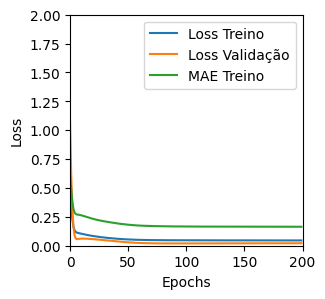

Tempo de treino: 0.3921097795168559 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10642995685338974 , MAE = 0.2594069242477417'

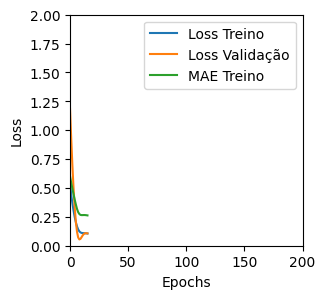

Tempo de treino: 0.08682155211766561 minutos
Treinando com GRU_v1 , timesteps=6, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04835854098200798 , MAE = 0.17213962972164154'

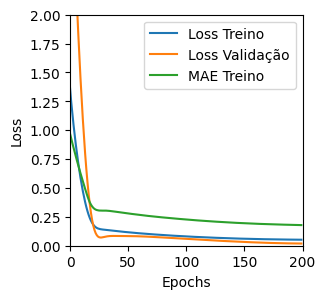

Tempo de treino: 0.17611236969629923 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.051098041236400604 , MAE = 0.17495138943195343'

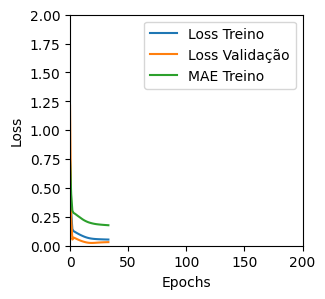

Tempo de treino: 0.12030147314071656 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11611344665288925 , MAE = 0.2685805559158325'

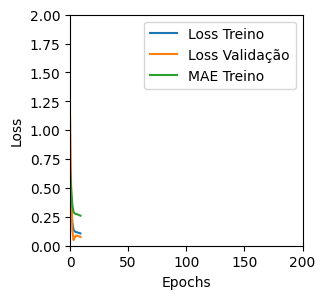

Tempo de treino: 0.10889951388041179 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15760253369808197 , MAE = 0.3140871226787567'

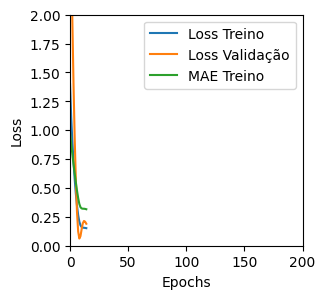

Tempo de treino: 0.08248314857482911 minutos
Treinando com GRU_v1 , timesteps=6, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13859272003173828 , MAE = 0.2929612994194031'

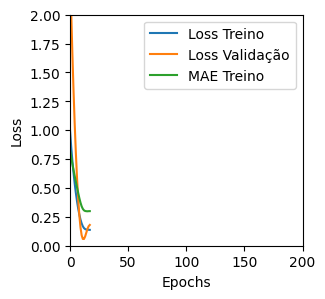

Tempo de treino: 0.06559927860895792 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07441183924674988 , MAE = 0.2123684138059616'

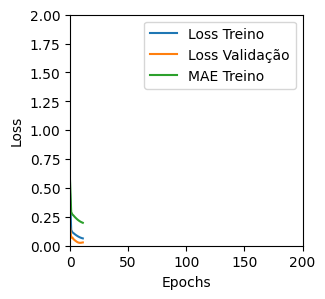

Tempo de treino: 0.06845249732335408 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.07875976711511612 , MAE = 0.21865785121917725'

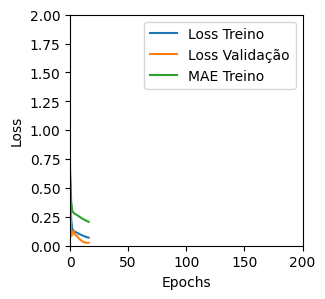

Tempo de treino: 0.06186720132827759 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16320766508579254 , MAE = 0.3157121539115906'

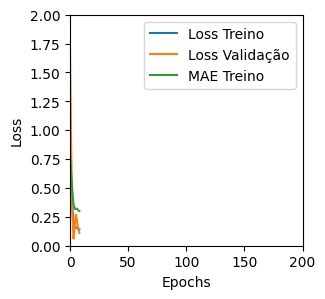

Tempo de treino: 0.08849504788716635 minutos
Treinando com GRU_v1 , timesteps=6, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13377344608306885 , MAE = 0.2865596413612366'

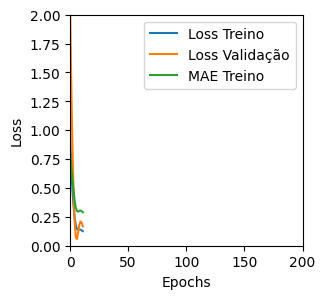

Tempo de treino: 0.06050259669621785 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7645937204360962 , MAE = 0.6737279891967773'

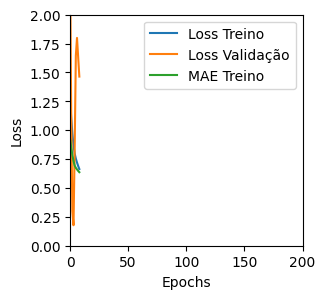

Tempo de treino: 0.047198283672332766 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2801975905895233 , MAE = 0.41862204670906067'

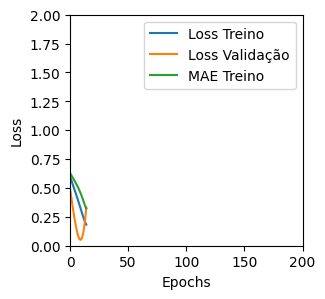

Tempo de treino: 0.07078415552775065 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6894639730453491 , MAE = 0.6533569693565369'

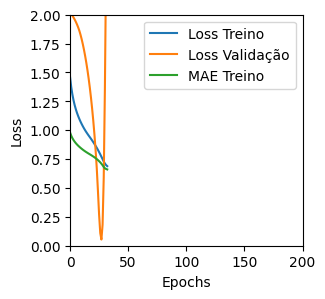

Tempo de treino: 0.05092424154281616 minutos
Treinando com LSTM_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25205355882644653 , MAE = 0.3859935402870178'

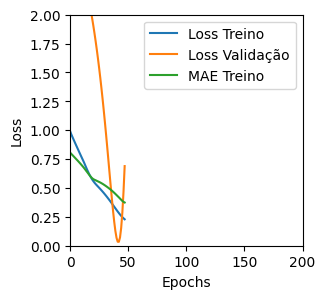

Tempo de treino: 0.06271675825119019 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2031651735305786 , MAE = 0.3354267179965973'

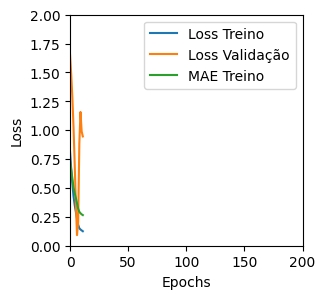

Tempo de treino: 0.053062132994333905 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.35608041286468506 , MAE = 0.4672856032848358'

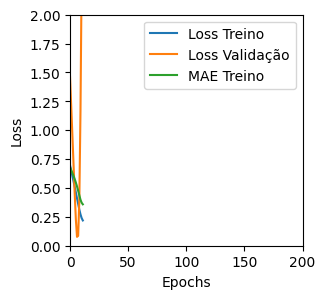

Tempo de treino: 0.0406702995300293 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7009861469268799 , MAE = 0.6227373480796814'

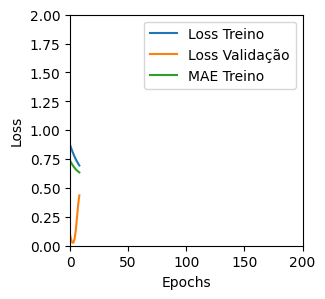

Tempo de treino: 0.05998724699020386 minutos
Treinando com LSTM_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19630636274814606 , MAE = 0.33469530940055847'

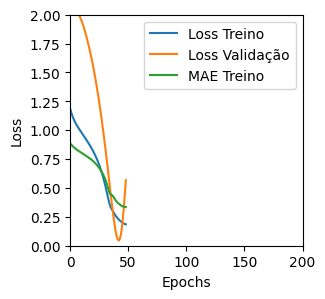

Tempo de treino: 0.11722166538238525 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.17451907694339752 , MAE = 0.3202393352985382'

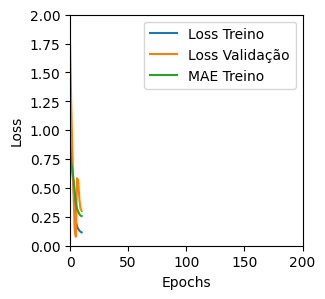

Tempo de treino: 0.05592825412750244 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21433311700820923 , MAE = 0.3348276913166046'

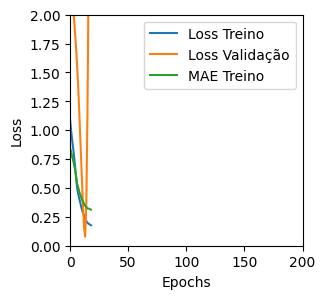

Tempo de treino: 0.0680345336596171 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19912727177143097 , MAE = 0.33431920409202576'

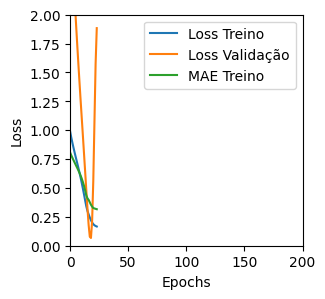

Tempo de treino: 0.05169584353764852 minutos
Treinando com LSTM_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2106984257698059 , MAE = 0.32244861125946045'

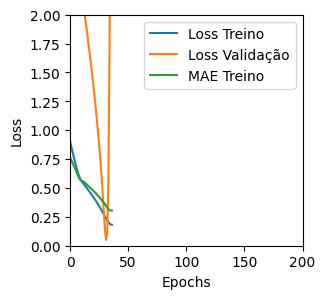

Tempo de treino: 0.06986883878707886 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24174700677394867 , MAE = 0.3560987114906311'

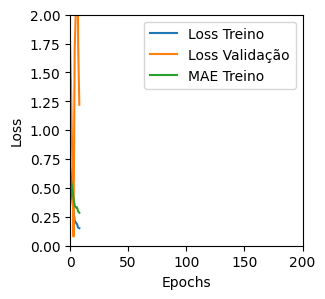

Tempo de treino: 0.04229072332382202 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20195098221302032 , MAE = 0.3239949345588684'

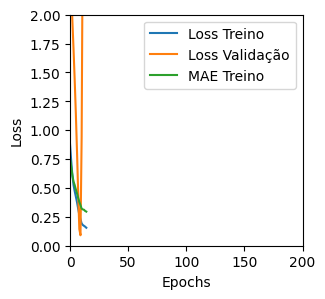

Tempo de treino: 0.045570000012715654 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26132678985595703 , MAE = 0.38633573055267334'

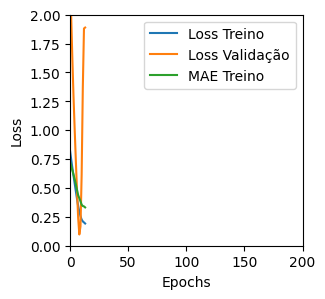

Tempo de treino: 0.06947777668635051 minutos
Treinando com LSTM_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25205960869789124 , MAE = 0.36565569043159485'

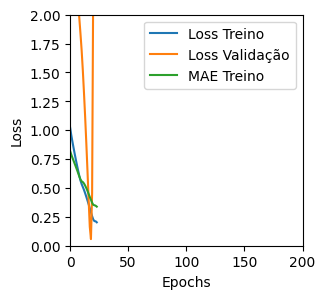

Tempo de treino: 0.07906802495320638 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27612200379371643 , MAE = 0.3955467939376831'

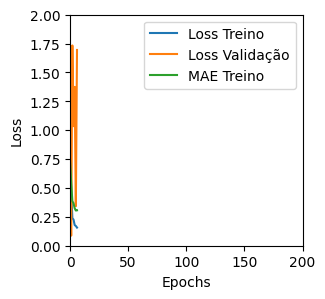

Tempo de treino: 0.05090091625849406 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4692453444004059 , MAE = 0.5293541550636292'

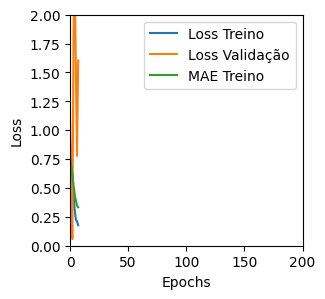

Tempo de treino: 0.0460958997408549 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23398645222187042 , MAE = 0.37443336844444275'

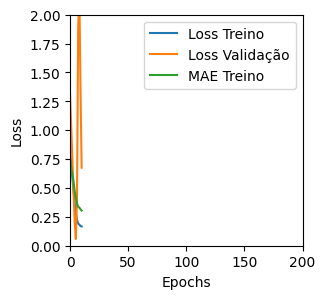

Tempo de treino: 0.045865257581075035 minutos
Treinando com LSTM_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23900921642780304 , MAE = 0.3773020803928375'

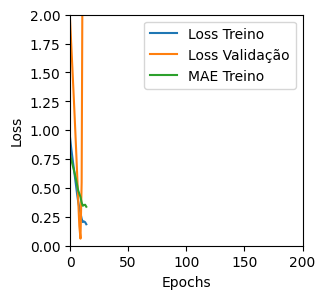

Tempo de treino: 0.042461085319519046 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2695547342300415 , MAE = 0.404972106218338'

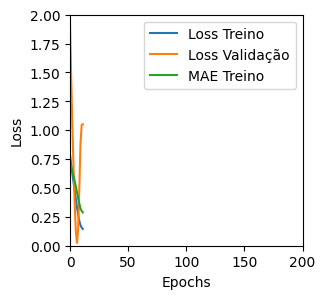

Tempo de treino: 0.06800182660420735 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10926008969545364 , MAE = 0.24943424761295319'

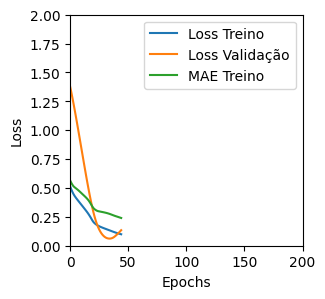

Tempo de treino: 0.07405966520309448 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19539524614810944 , MAE = 0.3226494789123535'

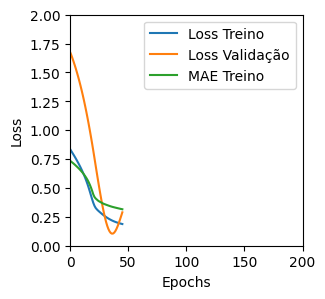

Tempo de treino: 0.129487943649292 minutos
Treinando com LSTM_v2 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6247042417526245 , MAE = 0.5927276611328125'

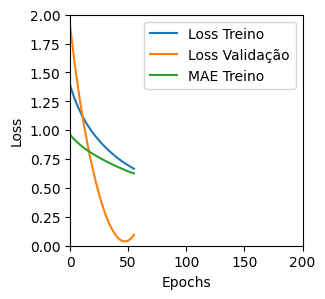

Tempo de treino: 0.12497193415959676 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14441387355327606 , MAE = 0.29266804456710815'

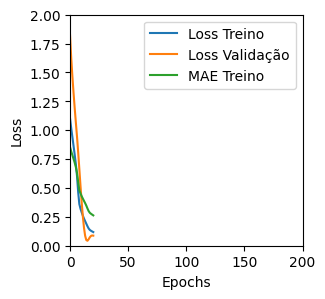

Tempo de treino: 0.06982787450154622 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2997127175331116 , MAE = 0.42032819986343384'

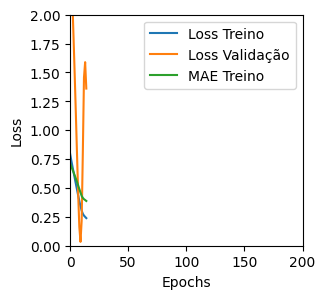

Tempo de treino: 0.051902957757314044 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22341638803482056 , MAE = 0.34459659457206726'

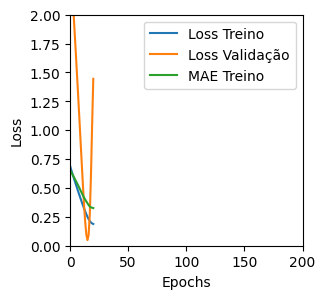

Tempo de treino: 0.04191519419352214 minutos
Treinando com LSTM_v2 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5550379157066345 , MAE = 0.5855211019515991'

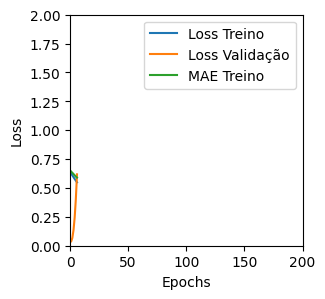

Tempo de treino: 0.03624345858891805 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2952527701854706 , MAE = 0.3948901891708374'

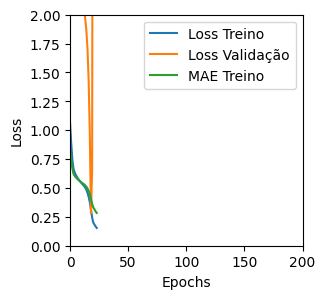

Tempo de treino: 0.1096595803896586 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2722063958644867 , MAE = 0.38795772194862366'

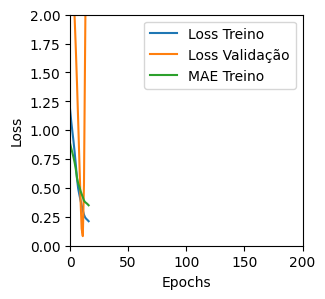

Tempo de treino: 0.04518070618311564 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44860681891441345 , MAE = 0.5144469738006592'

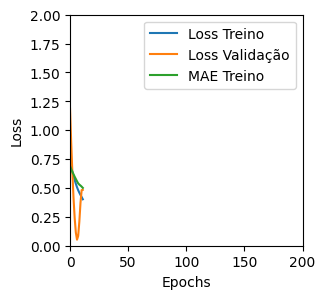

Tempo de treino: 0.0505319078763326 minutos
Treinando com LSTM_v2 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19658222794532776 , MAE = 0.3363654315471649'

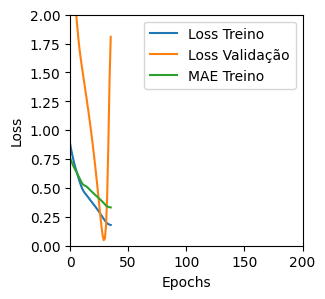

Tempo de treino: 0.08008191585540772 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39787277579307556 , MAE = 0.4790821373462677'

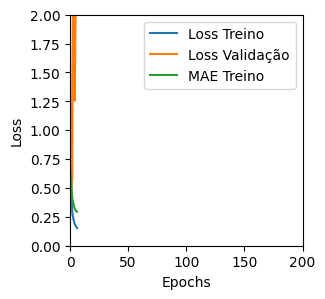

Tempo de treino: 0.045932833353678384 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.271218866109848 , MAE = 0.39814066886901855'

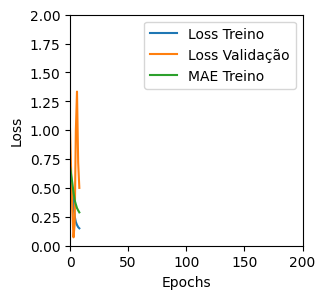

Tempo de treino: 0.03836307128270467 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49160364270210266 , MAE = 0.5363892912864685'

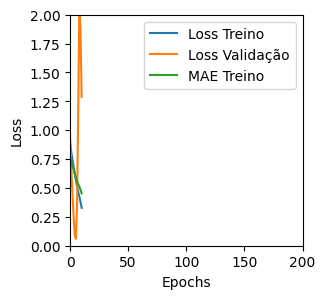

Tempo de treino: 0.046938053766886395 minutos
Treinando com LSTM_v2 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.192079097032547 , MAE = 0.3212340176105499'

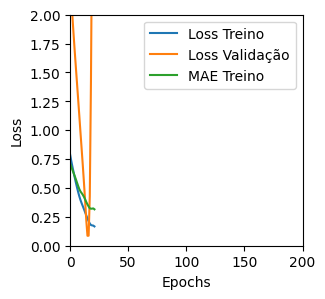

Tempo de treino: 0.05548057953516642 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24507123231887817 , MAE = 0.38215112686157227'

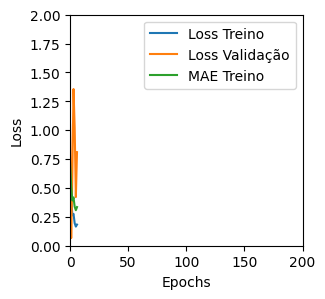

Tempo de treino: 0.04464188814163208 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23007513582706451 , MAE = 0.3635685443878174'

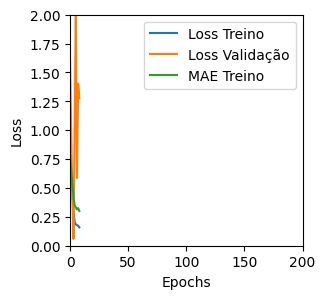

Tempo de treino: 0.045397440592447914 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37311747670173645 , MAE = 0.47400790452957153'

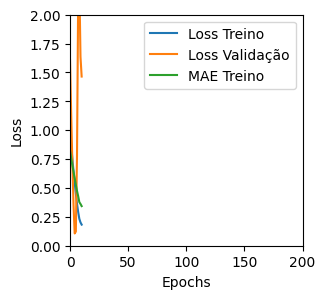

Tempo de treino: 0.05101532936096191 minutos
Treinando com LSTM_v2 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24244827032089233 , MAE = 0.3803079128265381'

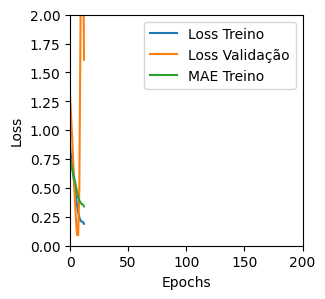

Tempo de treino: 0.05958795150121053 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3268393576145172 , MAE = 0.40294554829597473'

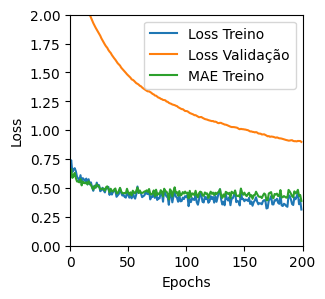

Tempo de treino: 0.7108929276466369 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.771016001701355 , MAE = 0.6760589480400085'

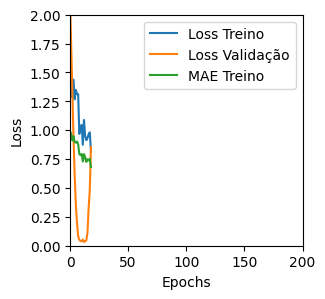

Tempo de treino: 0.07268407344818115 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5717670917510986 , MAE = 0.5877864956855774'

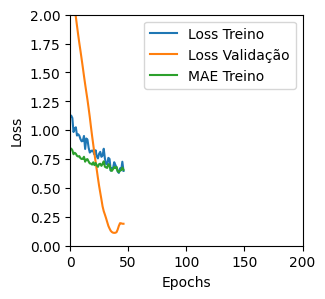

Tempo de treino: 0.06154509782791138 minutos
Treinando com LSTM_v3 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2456331104040146 , MAE = 0.3805074393749237'

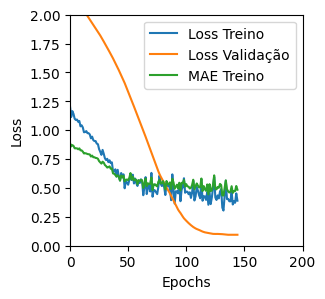

Tempo de treino: 0.15351768334706625 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24672923982143402 , MAE = 0.3326164186000824'

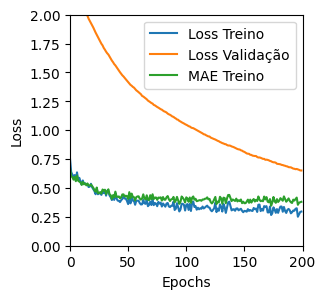

Tempo de treino: 0.3622398654619853 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3229600787162781 , MAE = 0.42959946393966675'

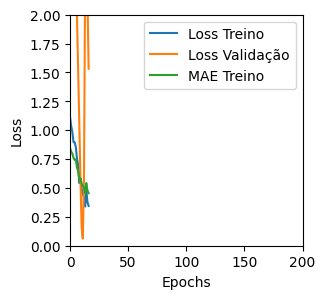

Tempo de treino: 0.04560450315475464 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28692296147346497 , MAE = 0.38988566398620605'

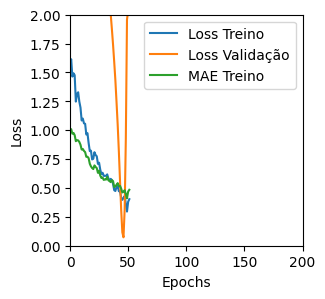

Tempo de treino: 0.11043559312820435 minutos
Treinando com LSTM_v3 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18909315764904022 , MAE = 0.3266228139400482'

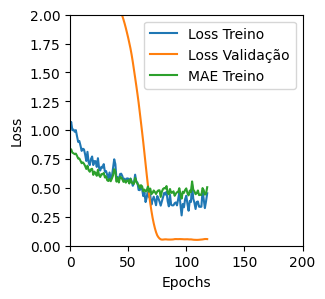

Tempo de treino: 0.1483215848604838 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2588326036930084 , MAE = 0.3674090504646301'

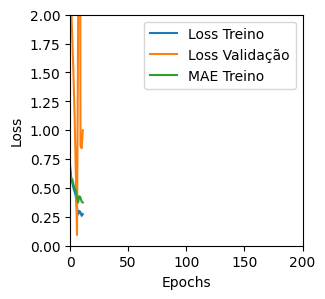

Tempo de treino: 0.0708886464436849 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2526438534259796 , MAE = 0.36682045459747314'

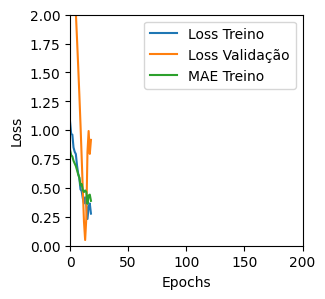

Tempo de treino: 0.06950204372406006 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23970524966716766 , MAE = 0.372570276260376'

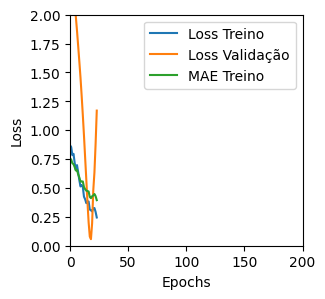

Tempo de treino: 0.06801035006841023 minutos
Treinando com LSTM_v3 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6261491775512695 , MAE = 0.5979405641555786'

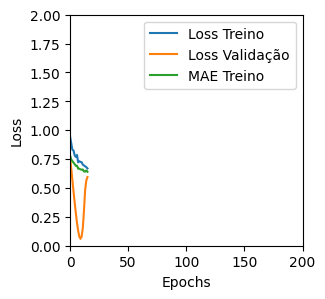

Tempo de treino: 0.04983181556065877 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2244878113269806 , MAE = 0.35641834139823914'

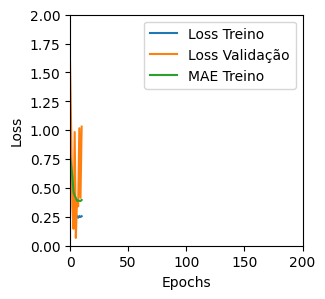

Tempo de treino: 0.04517181714375814 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.30057230591773987 , MAE = 0.39422619342803955'

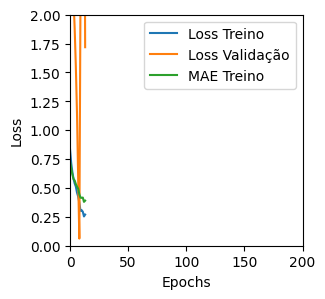

Tempo de treino: 0.04406032562255859 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2375776171684265 , MAE = 0.357425332069397'

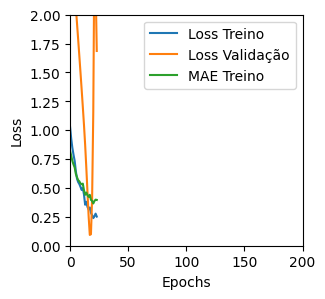

Tempo de treino: 0.06291179656982422 minutos
Treinando com LSTM_v3 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16956423223018646 , MAE = 0.30009326338768005'

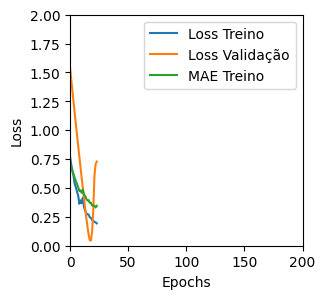

Tempo de treino: 0.09233450492223104 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16010378301143646 , MAE = 0.289030522108078'

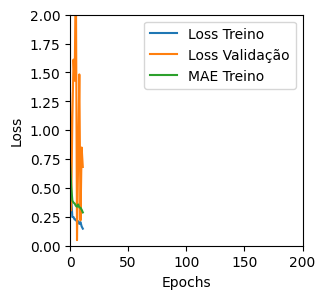

Tempo de treino: 0.07218910853068033 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23793238401412964 , MAE = 0.3633292317390442'

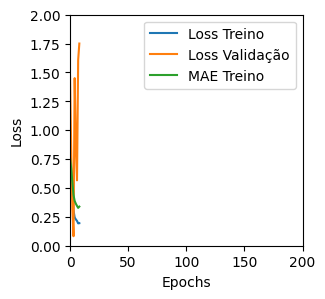

Tempo de treino: 0.049001057942708336 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2670808732509613 , MAE = 0.38074761629104614'

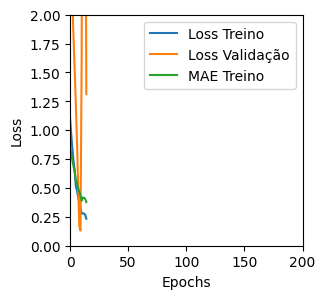

Tempo de treino: 0.05245210329691569 minutos
Treinando com LSTM_v3 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27342256903648376 , MAE = 0.38105079531669617'

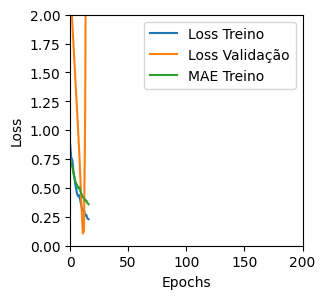

Tempo de treino: 0.04503265619277954 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (125, 12, 1) (12, 12, 1) (125, 1) (12, 1)
Treinando com GRU_v1 , timesteps=12, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05359339341521263 , MAE = 0.18012826144695282'

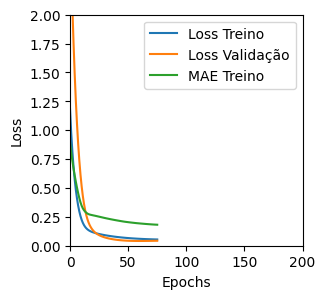

Tempo de treino: 0.2016726533571879 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04959607496857643 , MAE = 0.17336994409561157'

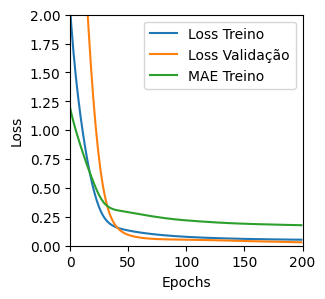

Tempo de treino: 0.3867591738700867 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04915577545762062 , MAE = 0.17538544535636902'

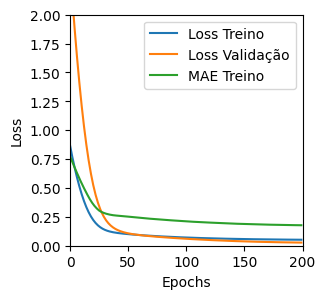

Tempo de treino: 0.21412852605183919 minutos
Treinando com GRU_v1 , timesteps=12, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.06532950699329376 , MAE = 0.2042464017868042'

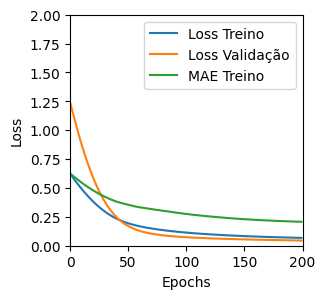

Tempo de treino: 0.19477893511454264 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04060739651322365 , MAE = 0.15340934693813324'

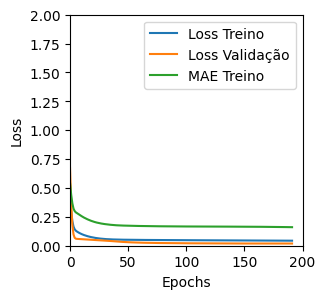

Tempo de treino: 0.7143236796061198 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05836421996355057 , MAE = 0.18902719020843506'

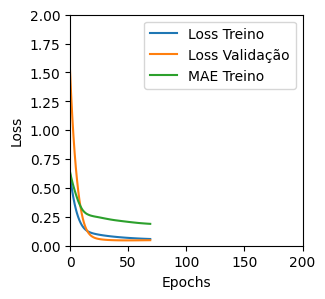

Tempo de treino: 0.20052037636439005 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04568120092153549 , MAE = 0.16603818535804749'

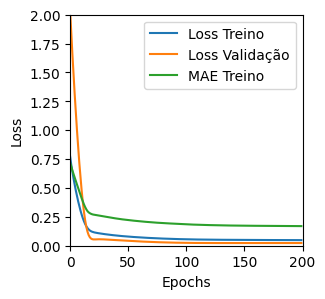

Tempo de treino: 0.1851398507754008 minutos
Treinando com GRU_v1 , timesteps=12, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048325177282094955 , MAE = 0.17276880145072937'

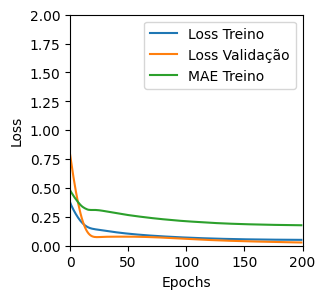

Tempo de treino: 0.40381970405578616 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0422615148127079 , MAE = 0.15781478583812714'

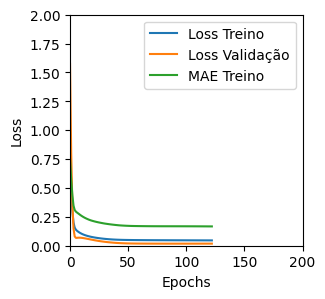

Tempo de treino: 0.26934563318888344 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04239125922322273 , MAE = 0.15902462601661682'

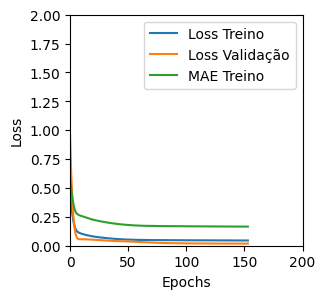

Tempo de treino: 0.3781459172566732 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04525616019964218 , MAE = 0.16232773661613464'

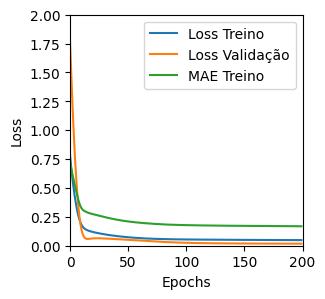

Tempo de treino: 0.18230433066685994 minutos
Treinando com GRU_v1 , timesteps=12, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12663425505161285 , MAE = 0.2865171730518341'

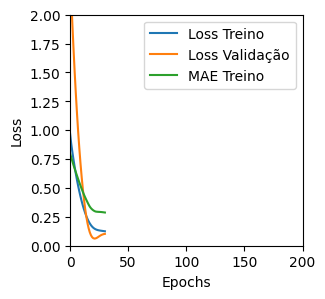

Tempo de treino: 0.07208120425542196 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.041998058557510376 , MAE = 0.15605372190475464'

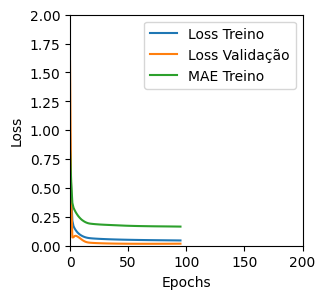

Tempo de treino: 0.2129206895828247 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com GRU_v1 , timesteps=12, units=32, batch=8


'TRAINING set. Loss = 0.04254095256328583 , MAE = 0.15697452425956726'

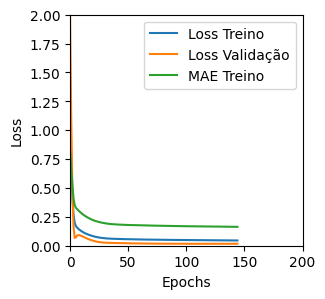

Tempo de treino: 0.3807233214378357 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1346942037343979 , MAE = 0.2893412709236145'

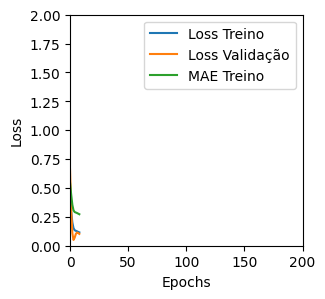

Tempo de treino: 0.05541438261667887 minutos
Treinando com GRU_v1 , timesteps=12, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1776026040315628 , MAE = 0.3307208716869354'

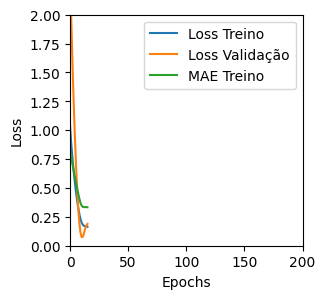

Tempo de treino: 0.0792809009552002 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0441933311522007 , MAE = 0.1583932638168335'

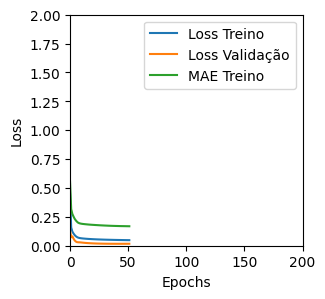

Tempo de treino: 0.2068740685780843 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04311319813132286 , MAE = 0.1572684943675995'

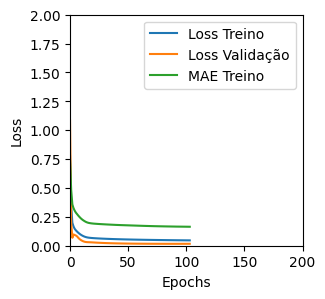

Tempo de treino: 0.16889909903208414 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16152545809745789 , MAE = 0.3142871558666229'

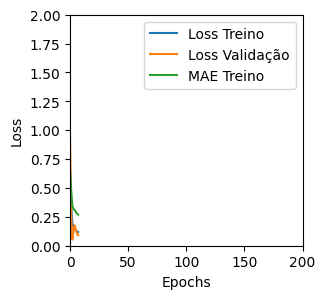

Tempo de treino: 0.07210160493850708 minutos
Treinando com GRU_v1 , timesteps=12, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15828454494476318 , MAE = 0.3134150505065918'

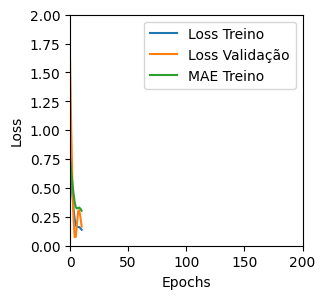

Tempo de treino: 0.05985522270202637 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5700989961624146 , MAE = 0.5721766948699951'

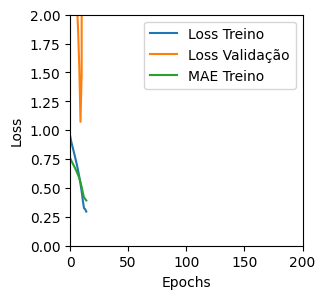

Tempo de treino: 0.12357228994369507 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5955597758293152 , MAE = 0.5856480002403259'

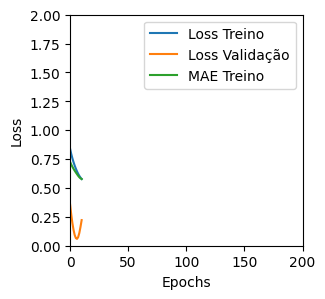

Tempo de treino: 0.07178297837575277 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19037678837776184 , MAE = 0.3514571487903595'

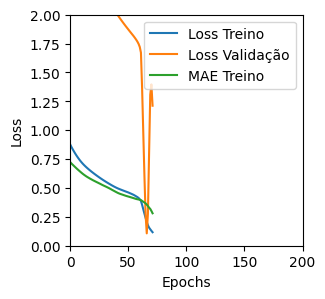

Tempo de treino: 0.11731710831324259 minutos
Treinando com LSTM_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7530054450035095 , MAE = 0.6750635504722595'

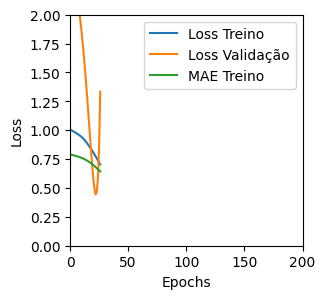

Tempo de treino: 0.05275095303853353 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3259945213794708 , MAE = 0.4475306272506714'

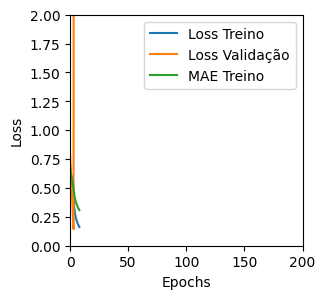

Tempo de treino: 0.09257997671763102 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3434012830257416 , MAE = 0.456439733505249'

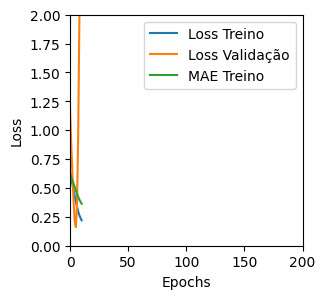

Tempo de treino: 0.06576179265975952 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.23596471548080444 , MAE = 0.36697062849998474'

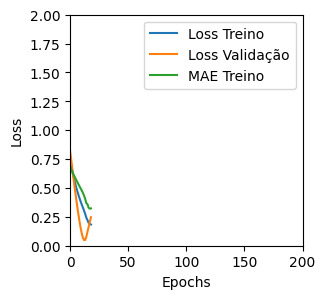

Tempo de treino: 0.07665625015894571 minutos
Treinando com LSTM_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2406805455684662 , MAE = 0.36779019236564636'

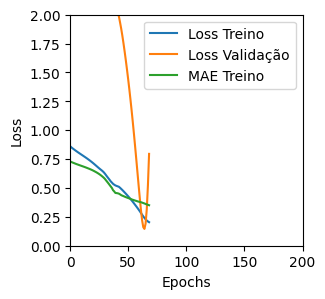

Tempo de treino: 0.12133753299713135 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6260994672775269 , MAE = 0.6052231788635254'

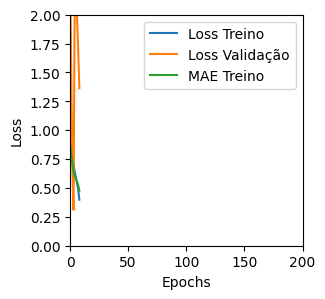

Tempo de treino: 0.06353154182434081 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.179738849401474 , MAE = 0.3254656493663788'

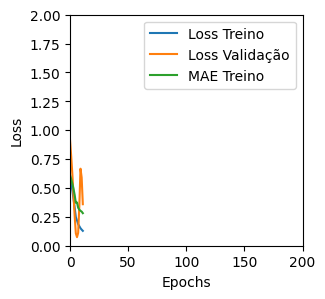

Tempo de treino: 0.07446227868398031 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.49543705582618713 , MAE = 0.4879135489463806'

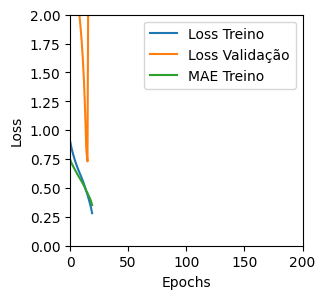

Tempo de treino: 0.07100467284520467 minutos
Treinando com LSTM_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26689571142196655 , MAE = 0.373753160238266'

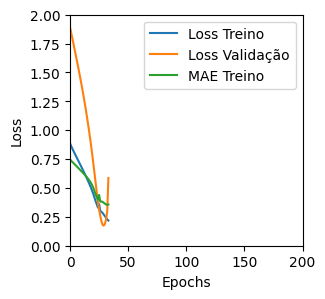

Tempo de treino: 0.061329452196757 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5130835175514221 , MAE = 0.5554736256599426'

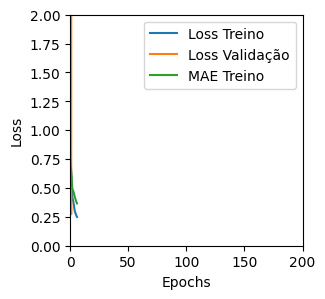

Tempo de treino: 0.09767202138900757 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1314796358346939 , MAE = 0.2647243142127991'

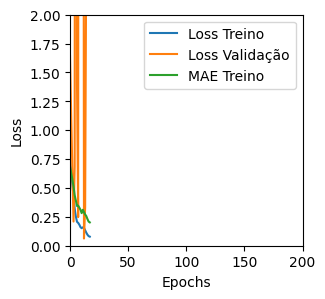

Tempo de treino: 0.08077982664108277 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3935686945915222 , MAE = 0.44974827766418457'

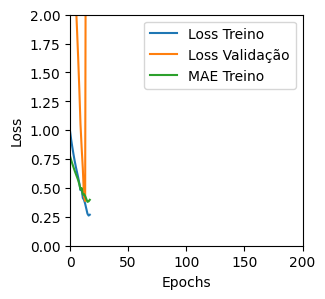

Tempo de treino: 0.07898031870524089 minutos
Treinando com LSTM_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5639542937278748 , MAE = 0.5722509026527405'

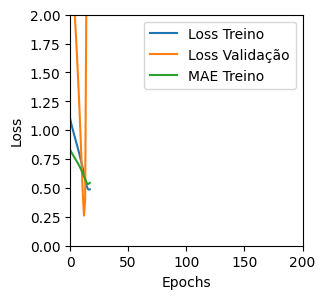

Tempo de treino: 0.05194860299428304 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24619945883750916 , MAE = 0.38661259412765503'

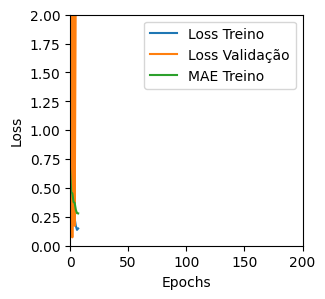

Tempo de treino: 0.06479774713516236 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4198122024536133 , MAE = 0.49452823400497437'

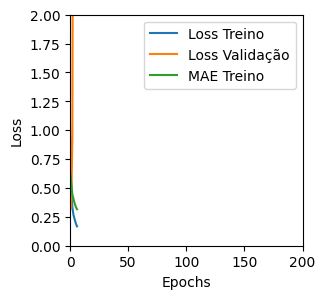

Tempo de treino: 0.07588977018992106 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4311161935329437 , MAE = 0.5015299320220947'

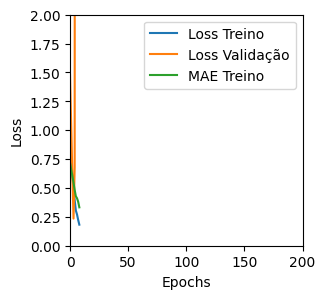

Tempo de treino: 0.04265304803848267 minutos
Treinando com LSTM_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4340888559818268 , MAE = 0.4847198724746704'

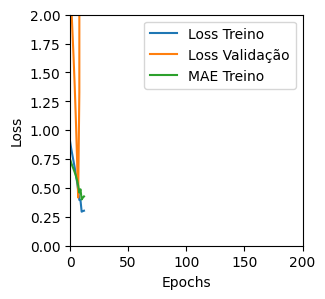

Tempo de treino: 0.048092385133107506 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38316112756729126 , MAE = 0.46011048555374146'

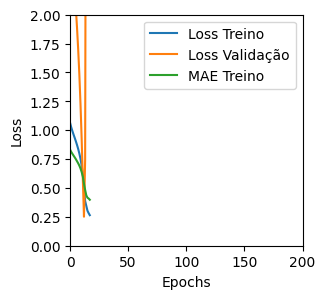

Tempo de treino: 0.128469185034434 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5337470173835754 , MAE = 0.5574283599853516'

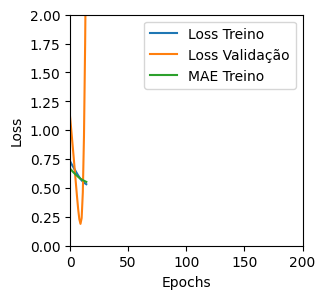

Tempo de treino: 0.07886380751927693 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.38609760999679565 , MAE = 0.42054158449172974'

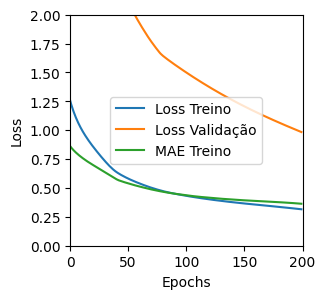

Tempo de treino: 0.28086721102396645 minutos
Treinando com LSTM_v2 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.7676846385002136 , MAE = 0.7025691270828247'

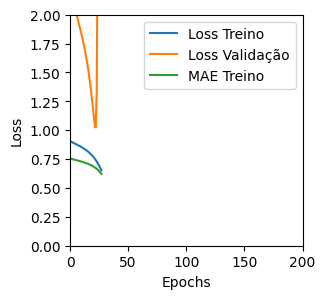

Tempo de treino: 0.07311335404713949 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4204029440879822 , MAE = 0.4842153787612915'

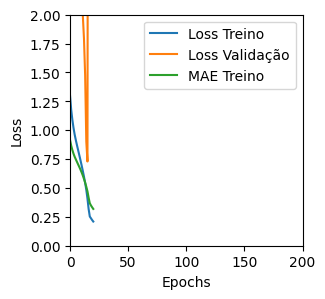

Tempo de treino: 0.10335944890975952 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5618881583213806 , MAE = 0.561674177646637'

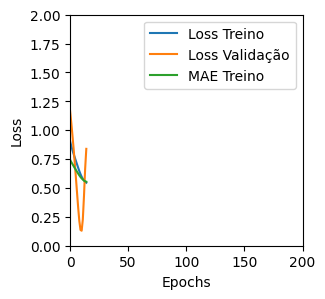

Tempo de treino: 0.07083059946695963 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.587177038192749 , MAE = 0.5827880501747131'

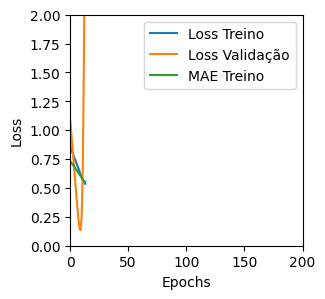

Tempo de treino: 0.048473453521728514 minutos
Treinando com LSTM_v2 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8714624047279358 , MAE = 0.7381954789161682'

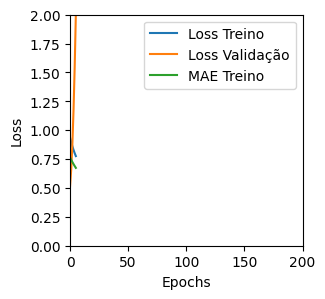

Tempo de treino: 0.051335243384043376 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.41164466738700867 , MAE = 0.4850485026836395'

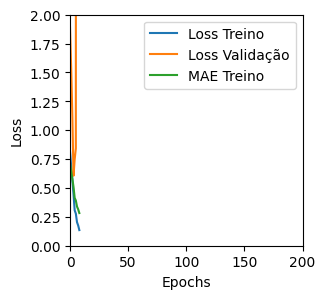

Tempo de treino: 0.10306798617045085 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4007736146450043 , MAE = 0.47432246804237366'

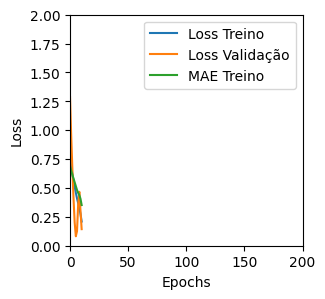

Tempo de treino: 0.0795856237411499 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5167296528816223 , MAE = 0.5428348183631897'

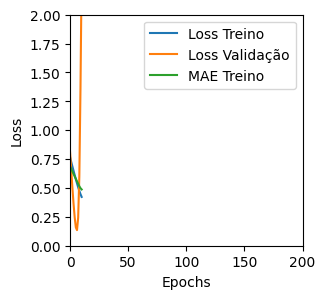

Tempo de treino: 0.05181608200073242 minutos
Treinando com LSTM_v2 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.46143433451652527 , MAE = 0.5241278409957886'

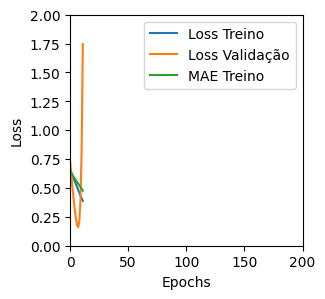

Tempo de treino: 0.05090020895004273 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2711954116821289 , MAE = 0.38347315788269043'

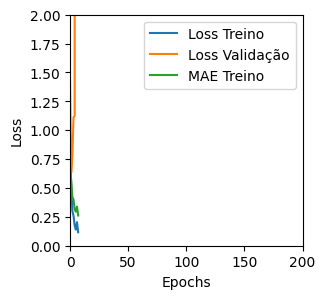

Tempo de treino: 0.0752387801806132 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3716944754123688 , MAE = 0.4311523139476776'

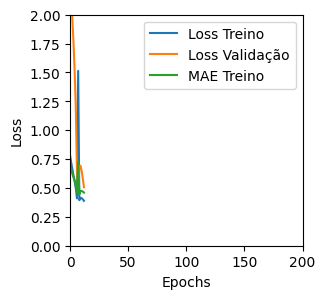

Tempo de treino: 0.053516968091328936 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3976680338382721 , MAE = 0.48033004999160767'

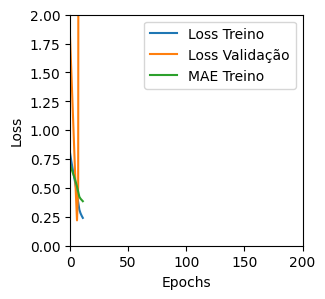

Tempo de treino: 0.04524961312611898 minutos
Treinando com LSTM_v2 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3378647565841675 , MAE = 0.43883100152015686'

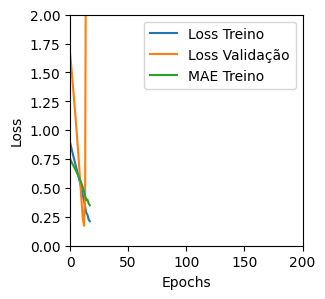

Tempo de treino: 0.07105146646499634 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.25337913632392883 , MAE = 0.3880978524684906'

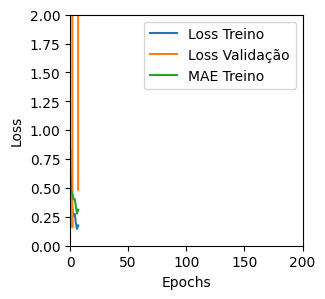

Tempo de treino: 0.08634521961212158 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28550592064857483 , MAE = 0.39157000184059143'

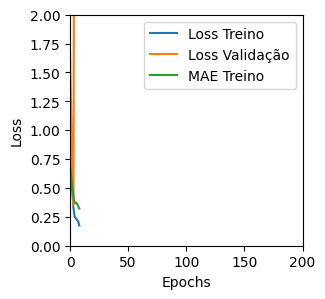

Tempo de treino: 0.05820275545120239 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.27330636978149414 , MAE = 0.37953436374664307'

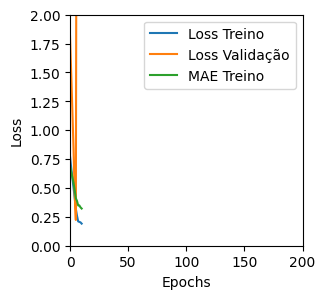

Tempo de treino: 0.050817044576009114 minutos
Treinando com LSTM_v2 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4089048504829407 , MAE = 0.4733678996562958'

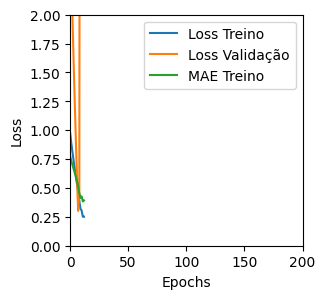

Tempo de treino: 0.05417689085006714 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.28378021717071533 , MAE = 0.38518670201301575'

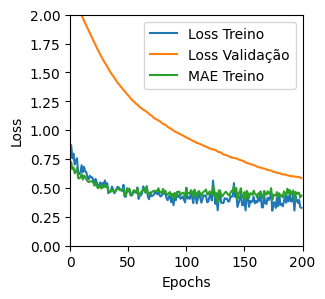

Tempo de treino: 0.6464101274808248 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18796758353710175 , MAE = 0.32696792483329773'

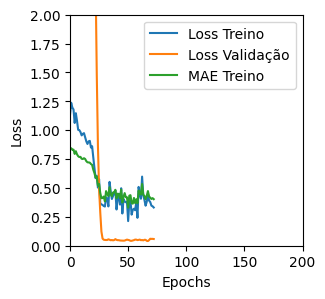

Tempo de treino: 0.1996715267499288 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5272825360298157 , MAE = 0.5423083305358887'

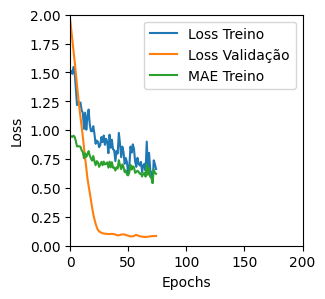

Tempo de treino: 0.22749889294306438 minutos
Treinando com LSTM_v3 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8693437576293945 , MAE = 0.7017685174942017'

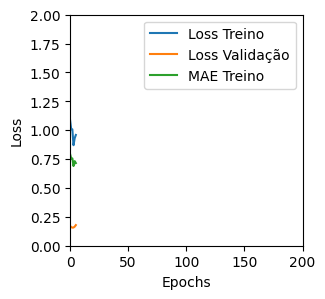

Tempo de treino: 0.06136453946431478 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43229836225509644 , MAE = 0.475660502910614'

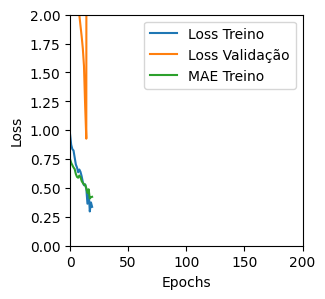

Tempo de treino: 0.1020793875058492 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8887333273887634 , MAE = 0.71478271484375'

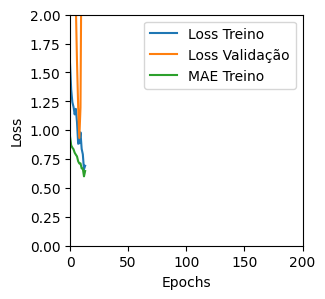

Tempo de treino: 0.05901639858881633 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4700959324836731 , MAE = 0.530738890171051'

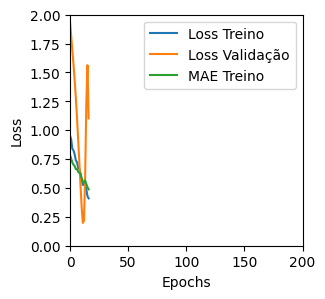

Tempo de treino: 0.07881362040837606 minutos
Treinando com LSTM_v3 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26783859729766846 , MAE = 0.38088110089302063'

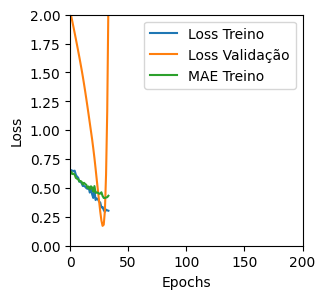

Tempo de treino: 0.07187469005584717 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13945476710796356 , MAE = 0.2670648396015167'

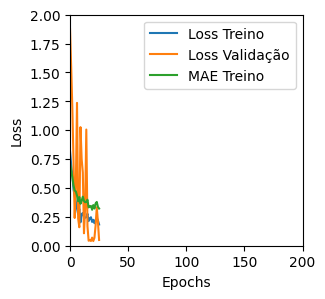

Tempo de treino: 0.12026710112889608 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5240404605865479 , MAE = 0.5563123226165771'

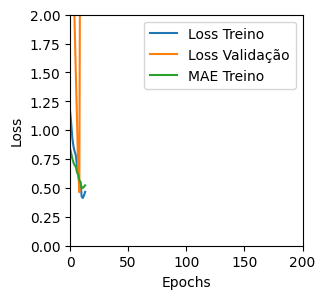

Tempo de treino: 0.11355049212773641 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39301827549934387 , MAE = 0.4536643624305725'

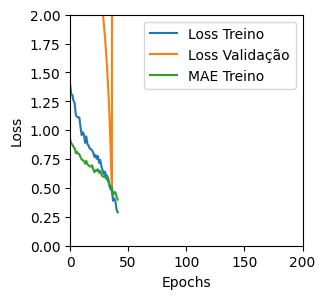

Tempo de treino: 0.11119519074757894 minutos
Treinando com LSTM_v3 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3063461184501648 , MAE = 0.3952788710594177'

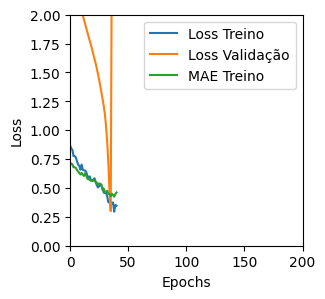

Tempo de treino: 0.07752695083618164 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3211038112640381 , MAE = 0.44041940569877625'

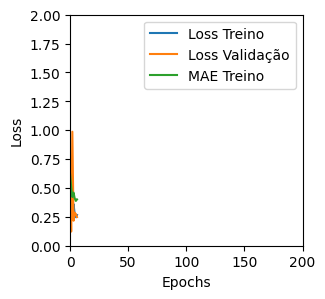

Tempo de treino: 0.08294326066970825 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3566109538078308 , MAE = 0.4352419376373291'

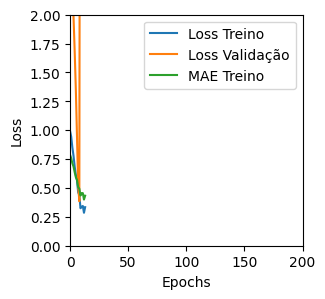

Tempo de treino: 0.061118503411610924 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3197048604488373 , MAE = 0.41050711274147034'

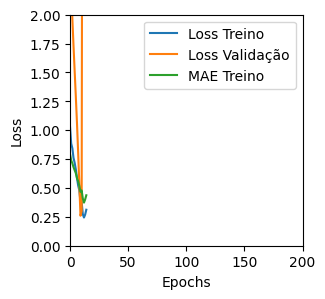

Tempo de treino: 0.07396605809529623 minutos
Treinando com LSTM_v3 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6342009902000427 , MAE = 0.6090748310089111'

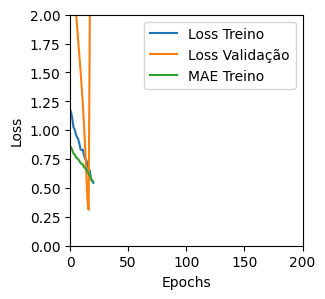

Tempo de treino: 0.07683263619740804 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1754780113697052 , MAE = 0.2964516580104828'

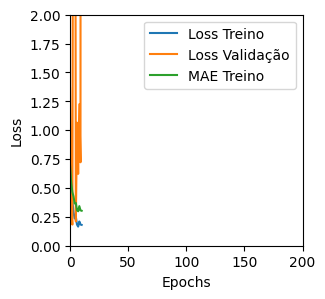

Tempo de treino: 0.07648460467656454 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


Treinando com LSTM_v3 , timesteps=24, units=64, batch=8


'TRAINING set. Loss = 0.41685518622398376 , MAE = 0.49580907821655273'

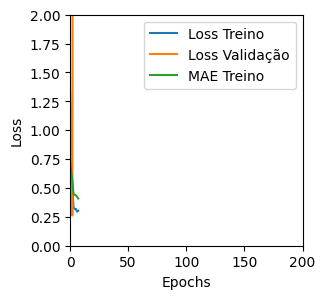

Tempo de treino: 0.09013365109761556 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3592858910560608 , MAE = 0.4445211589336395'

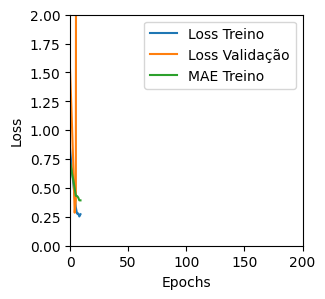

Tempo de treino: 0.05676024357477824 minutos
Treinando com LSTM_v3 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37728771567344666 , MAE = 0.4610404372215271'

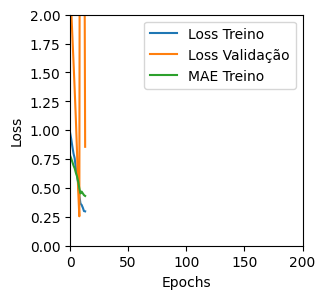

Tempo de treino: 0.04985330502192179 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (113, 24, 1) (12, 24, 1) (113, 1) (12, 1)
Treinando com GRU_v1 , timesteps=24, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.048896096646785736 , MAE = 0.17241103947162628'

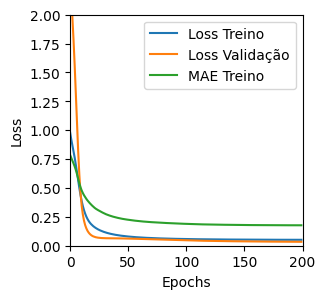

Tempo de treino: 0.7125061949094137 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10352553427219391 , MAE = 0.2519504129886627'

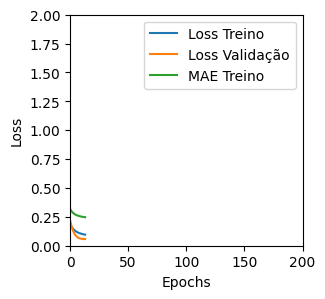

Tempo de treino: 0.07842841148376464 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.11580558866262436 , MAE = 0.27304649353027344'

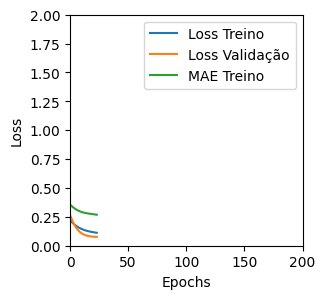

Tempo de treino: 0.11122407515843709 minutos
Treinando com GRU_v1 , timesteps=24, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.26076453924179077 , MAE = 0.4015713036060333'

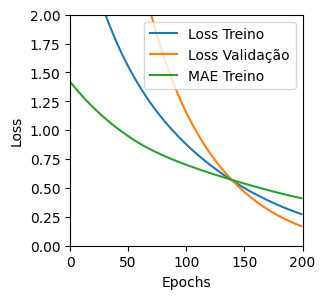

Tempo de treino: 0.23947368065516153 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04308227449655533 , MAE = 0.1607397198677063'

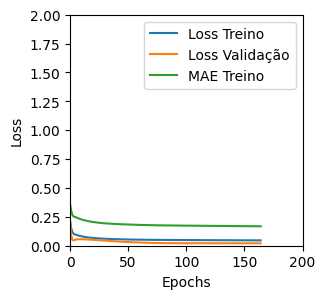

Tempo de treino: 0.6092449824015299 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.10756159573793411 , MAE = 0.2532450556755066'

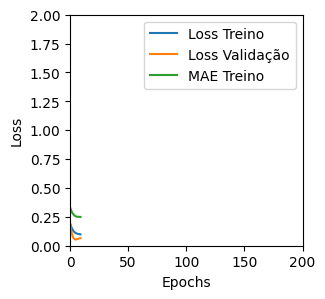

Tempo de treino: 0.07435736258824667 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18642522394657135 , MAE = 0.3486948609352112'

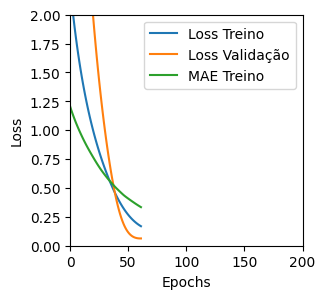

Tempo de treino: 0.11035821835199992 minutos
Treinando com GRU_v1 , timesteps=24, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13471351563930511 , MAE = 0.2930556833744049'

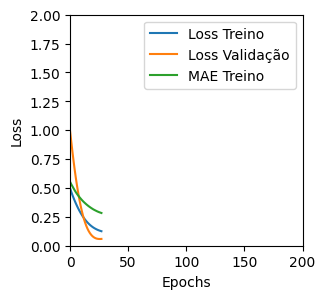

Tempo de treino: 0.1092821478843689 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.046394750475883484 , MAE = 0.16623441874980927'

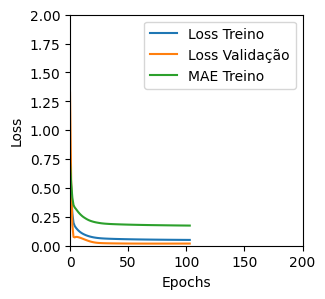

Tempo de treino: 0.40575140714645386 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0463569276034832 , MAE = 0.16681496798992157'

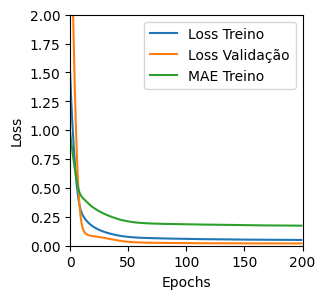

Tempo de treino: 0.7188245971997579 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22932472825050354 , MAE = 0.3926510810852051'

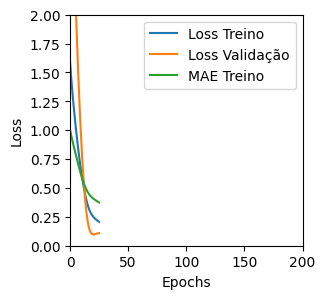

Tempo de treino: 0.07800808350245157 minutos
Treinando com GRU_v1 , timesteps=24, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1949434131383896 , MAE = 0.3536738455295563'

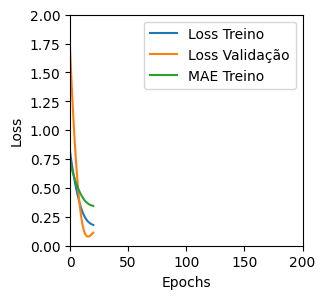

Tempo de treino: 0.09519410530726115 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04394230246543884 , MAE = 0.161163330078125'

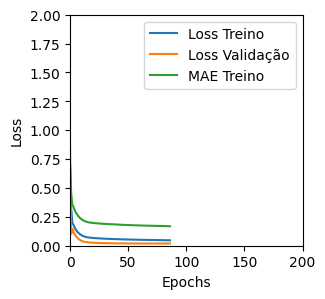

Tempo de treino: 0.7329952160517375 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.03956788405776024 , MAE = 0.15073369443416595'

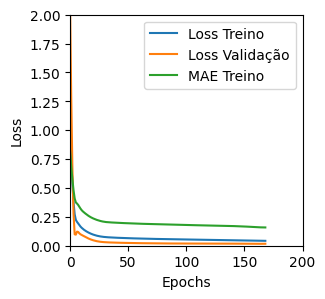

Tempo de treino: 0.7202247301737468 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1402810662984848 , MAE = 0.28963062167167664'

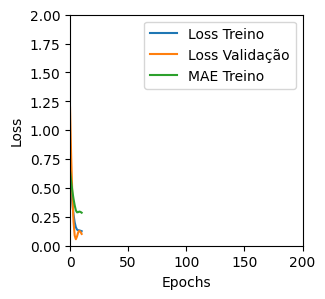

Tempo de treino: 0.06720085938771565 minutos
Treinando com GRU_v1 , timesteps=24, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29437705874443054 , MAE = 0.4293750524520874'

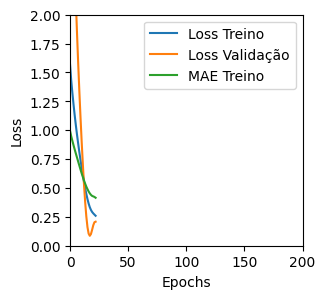

Tempo de treino: 0.07763954003651936 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04743623733520508 , MAE = 0.16878095269203186'

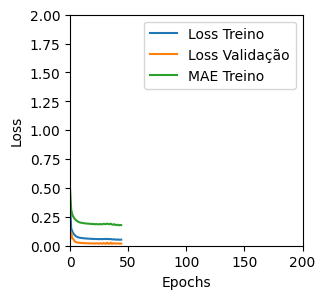

Tempo de treino: 0.41284273862838744 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04705745726823807 , MAE = 0.16609767079353333'

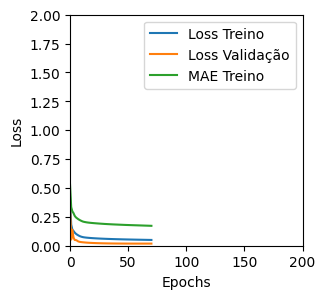

Tempo de treino: 0.21958654324213664 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.04875092953443527 , MAE = 0.169286847114563'

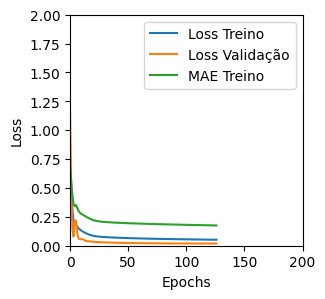

Tempo de treino: 0.24184273481369017 minutos
Treinando com GRU_v1 , timesteps=24, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18970678746700287 , MAE = 0.33982425928115845'

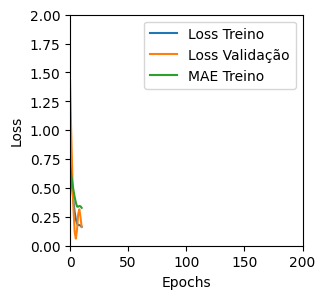

Tempo de treino: 0.05702712138493856 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.619784951210022 , MAE = 0.5945762991905212'

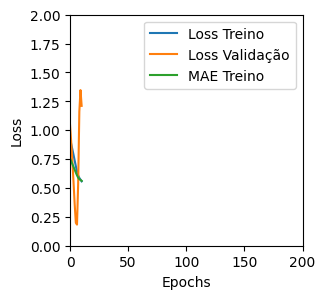

Tempo de treino: 0.0662657101949056 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2314433604478836 , MAE = 0.323164165019989'

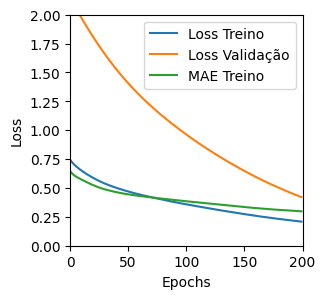

Tempo de treino: 0.7115480264027914 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4444026052951813 , MAE = 0.4925524890422821'

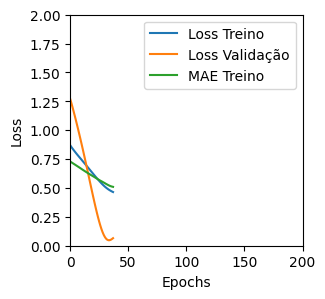

Tempo de treino: 0.12497868537902831 minutos
Treinando com LSTM_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.48202016949653625 , MAE = 0.5470043420791626'

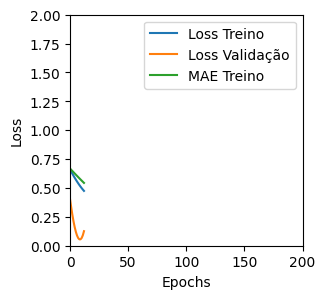

Tempo de treino: 0.05483173529307048 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5498960018157959 , MAE = 0.5574426651000977'

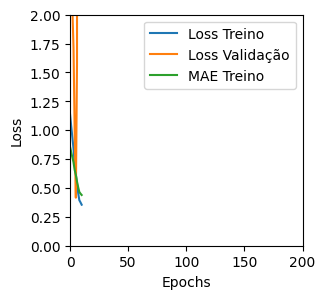

Tempo de treino: 0.07301741441090902 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.509544312953949 , MAE = 0.5501567125320435'

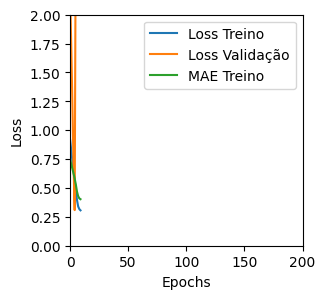

Tempo de treino: 0.0728379487991333 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4725857675075531 , MAE = 0.5403662323951721'

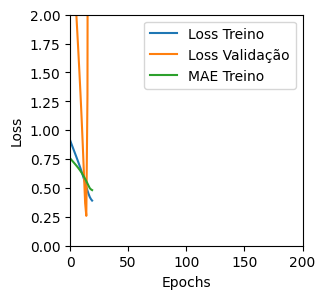

Tempo de treino: 0.06952790419260661 minutos
Treinando com LSTM_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31798118352890015 , MAE = 0.40640079975128174'

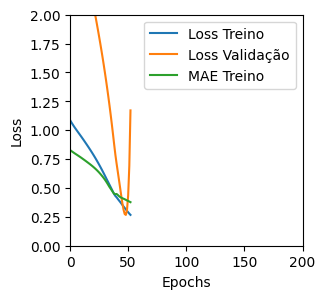

Tempo de treino: 0.11345638036727905 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3269944190979004 , MAE = 0.4187411963939667'

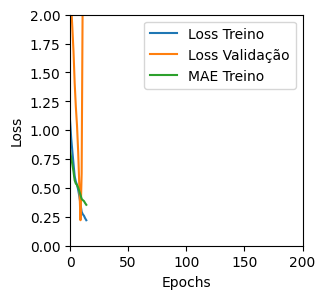

Tempo de treino: 0.08311203718185425 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5097640156745911 , MAE = 0.5455025434494019'

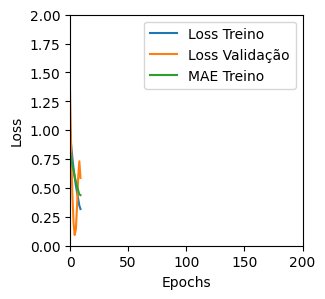

Tempo de treino: 0.10092473030090332 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3064793050289154 , MAE = 0.43040263652801514'

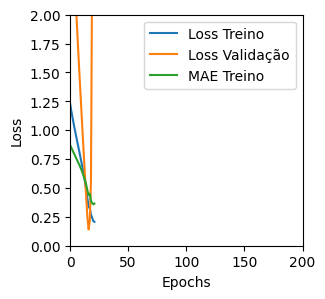

Tempo de treino: 0.07804375886917114 minutos
Treinando com LSTM_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29714927077293396 , MAE = 0.39013567566871643'

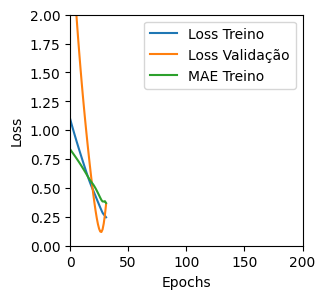

Tempo de treino: 0.06392805178960165 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8202183246612549 , MAE = 0.7113564610481262'

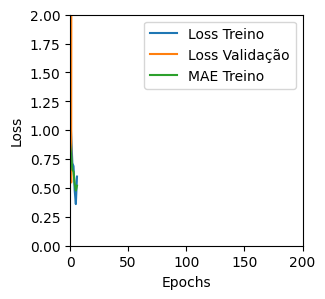

Tempo de treino: 0.06779952843983968 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40313202142715454 , MAE = 0.4886336028575897'

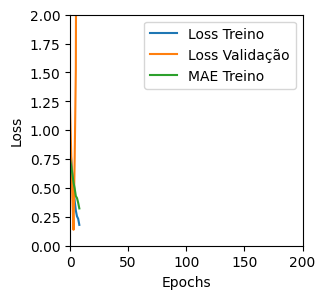

Tempo de treino: 0.05242443084716797 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42763909697532654 , MAE = 0.5006030201911926'

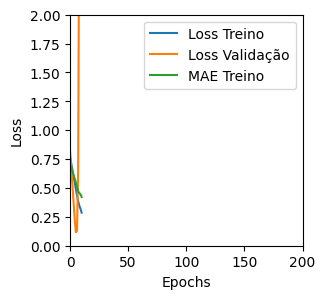

Tempo de treino: 0.0488739808400472 minutos
Treinando com LSTM_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.33966290950775146 , MAE = 0.4110022783279419'

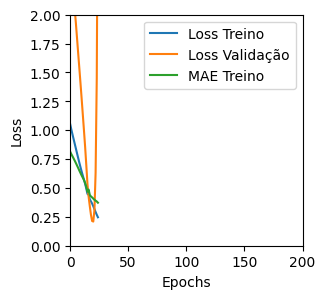

Tempo de treino: 0.06014823118845622 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3034329116344452 , MAE = 0.42119595408439636'

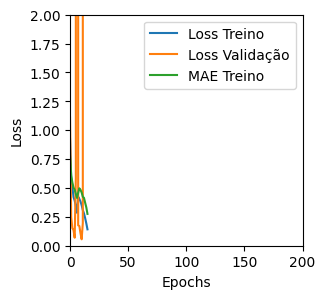

Tempo de treino: 0.12198432683944702 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5322805643081665 , MAE = 0.5655390620231628'

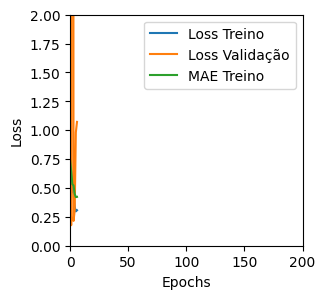

Tempo de treino: 0.08301698764165243 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3784123361110687 , MAE = 0.4757043421268463'

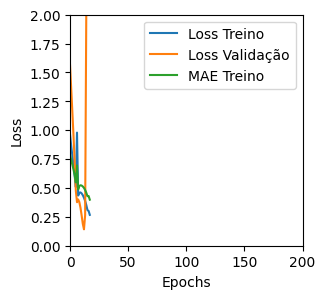

Tempo de treino: 0.07588414748509725 minutos
Treinando com LSTM_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4431647062301636 , MAE = 0.500002384185791'

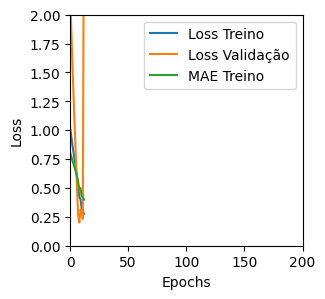

Tempo de treino: 0.048256508509318036 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v2 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1006835401058197 , MAE = 0.25286656618118286'

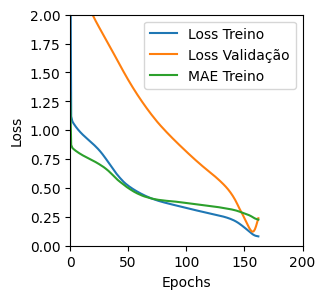

Tempo de treino: 0.6198441425959269 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29503726959228516 , MAE = 0.3746775984764099'

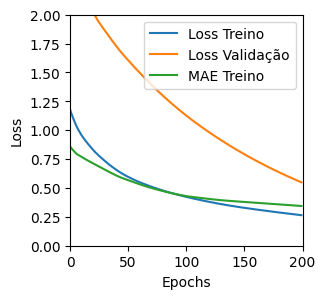

Tempo de treino: 0.46053376197814944 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5683785676956177 , MAE = 0.5793474316596985'

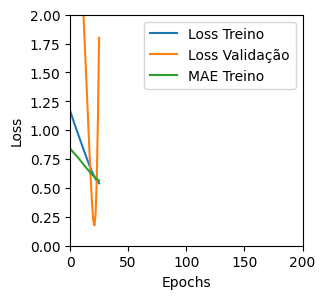

Tempo de treino: 0.06454563935597737 minutos
Treinando com LSTM_v2 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5820003151893616 , MAE = 0.5282657742500305'

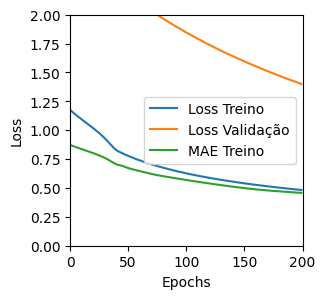

Tempo de treino: 0.2010397990544637 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5928865671157837 , MAE = 0.5939935445785522'

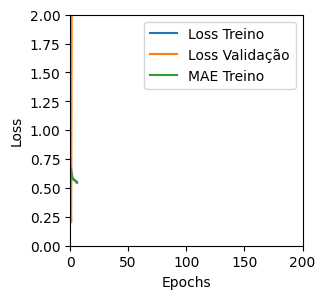

Tempo de treino: 0.10771102507909139 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5304215550422668 , MAE = 0.5571587681770325'

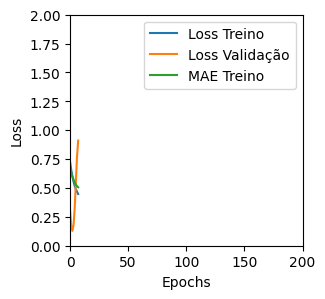

Tempo de treino: 0.08694827556610107 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.6280369758605957 , MAE = 0.5979741215705872'

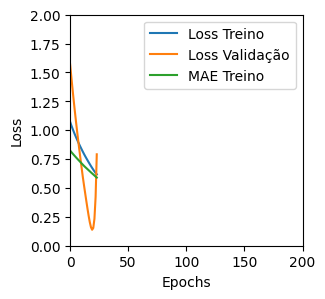

Tempo de treino: 0.07791894276936849 minutos
Treinando com LSTM_v2 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15129289031028748 , MAE = 0.29849138855934143'

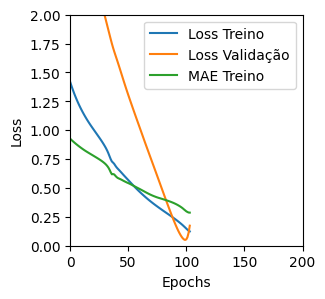

Tempo de treino: 0.2021895964940389 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3340955376625061 , MAE = 0.4279223382472992'

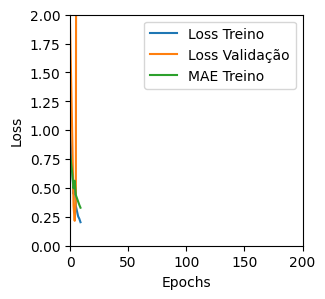

Tempo de treino: 0.07321804364522298 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29358041286468506 , MAE = 0.3686639666557312'

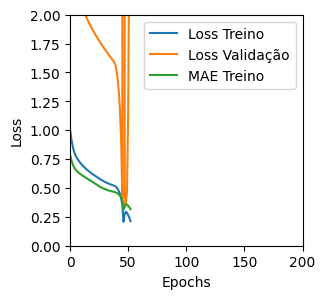

Tempo de treino: 0.14917283058166503 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.40017685294151306 , MAE = 0.48408079147338867'

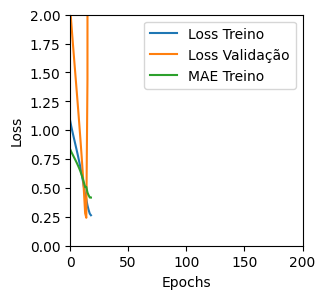

Tempo de treino: 0.05411265691121419 minutos
Treinando com LSTM_v2 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.39734509587287903 , MAE = 0.45903024077415466'

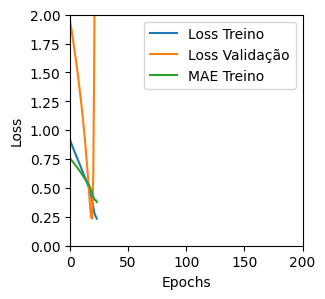

Tempo de treino: 0.05840661923090617 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29482147097587585 , MAE = 0.40609753131866455'

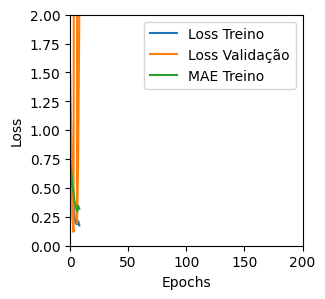

Tempo de treino: 0.10326639413833619 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4834352731704712 , MAE = 0.5402116179466248'

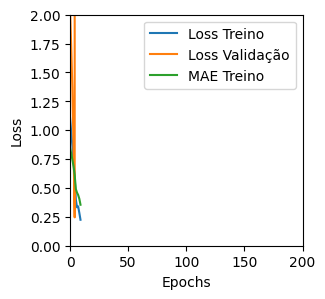

Tempo de treino: 0.0793355385462443 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.42157432436943054 , MAE = 0.4967864155769348'

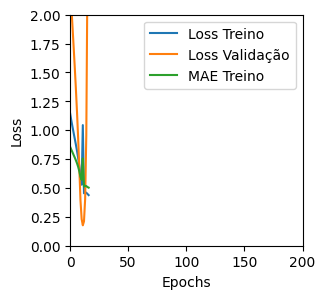

Tempo de treino: 0.06658026774724325 minutos
Treinando com LSTM_v2 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.44977426528930664 , MAE = 0.5213679075241089'

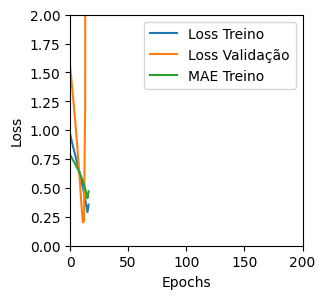

Tempo de treino: 0.05164644718170166 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.16977182030677795 , MAE = 0.3084508180618286'

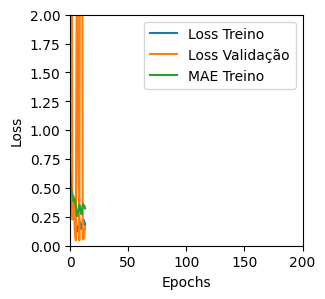

Tempo de treino: 0.09865441719690958 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3096061646938324 , MAE = 0.4236096441745758'

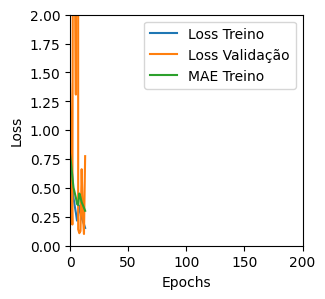

Tempo de treino: 0.07464588483174642 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.5021325349807739 , MAE = 0.5377597808837891'

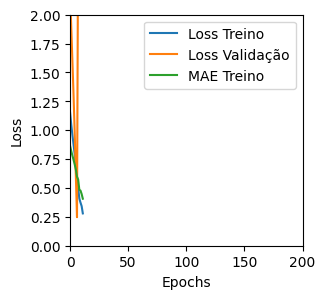

Tempo de treino: 0.05121368567148844 minutos
Treinando com LSTM_v2 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4972227215766907 , MAE = 0.5295074582099915'

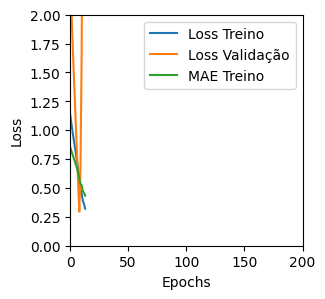

Tempo de treino: 0.08749310572942098 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com LSTM_v3 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4605869948863983 , MAE = 0.5229331254959106'

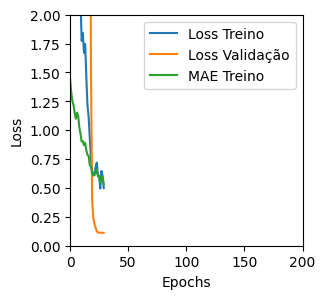

Tempo de treino: 0.20952251354853313 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.9467353224754333 , MAE = 0.7399715185165405'

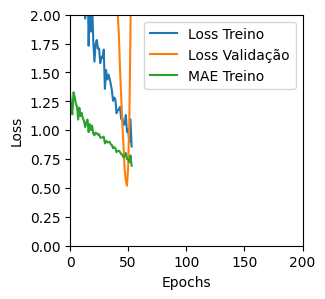

Tempo de treino: 0.15539437135060627 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.521824300289154 , MAE = 0.5100104212760925'

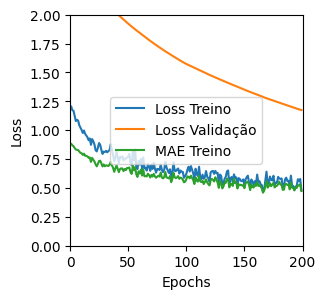

Tempo de treino: 0.378823451201121 minutos
Treinando com LSTM_v3 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.22718799114227295 , MAE = 0.3602983057498932'

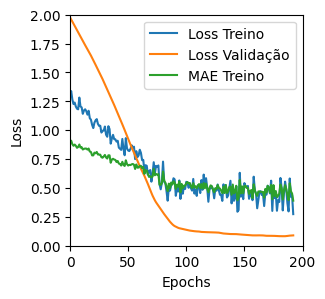

Tempo de treino: 0.20504947106043497 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21594148874282837 , MAE = 0.34423741698265076'

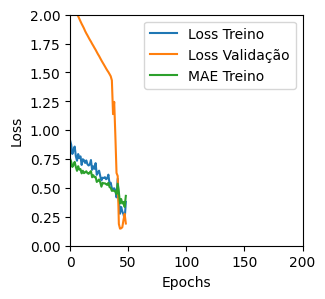

Tempo de treino: 0.37702553272247313 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.24348798394203186 , MAE = 0.37558713555336'

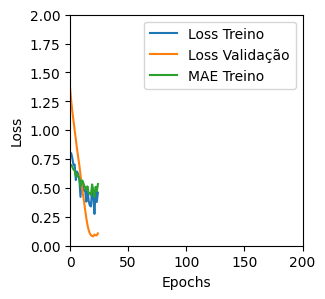

Tempo de treino: 0.09355888366699219 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3645167946815491 , MAE = 0.4276472330093384'

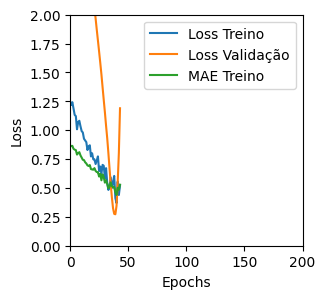

Tempo de treino: 0.14616745313008625 minutos
Treinando com LSTM_v3 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.8878368735313416 , MAE = 0.7514074444770813'

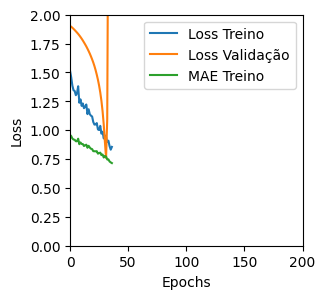

Tempo de treino: 0.08077176809310913 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.447941392660141 , MAE = 0.5117877125740051'

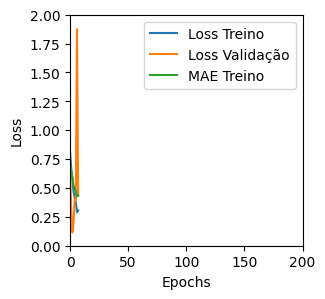

Tempo de treino: 0.06926749149958293 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37024468183517456 , MAE = 0.4600767493247986'

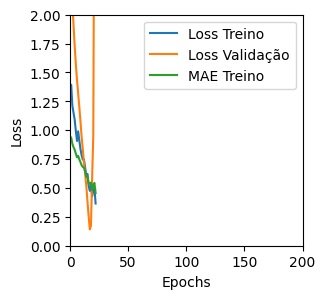

Tempo de treino: 0.09167426029841105 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.20932891964912415 , MAE = 0.3338775336742401'

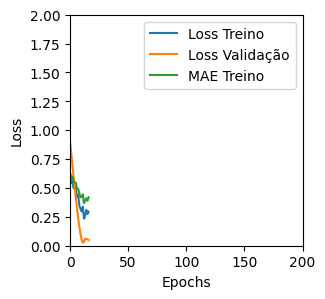

Tempo de treino: 0.07379167874654134 minutos
Treinando com LSTM_v3 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3828580379486084 , MAE = 0.4507148563861847'

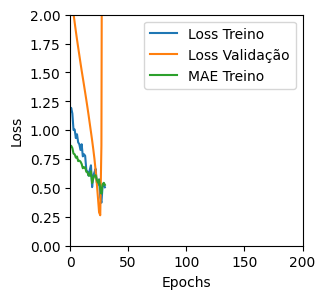

Tempo de treino: 0.0718369166056315 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.36699178814888 , MAE = 0.46590039134025574'

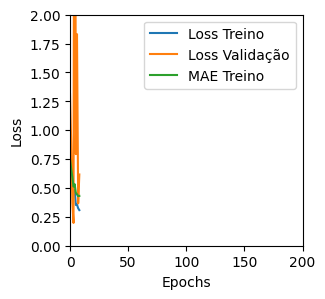

Tempo de treino: 0.07244592507680257 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.3976243734359741 , MAE = 0.4860598146915436'

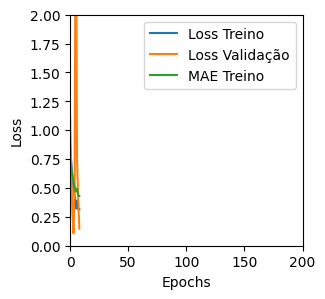

Tempo de treino: 0.051486722628275555 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.37874165177345276 , MAE = 0.4458586573600769'

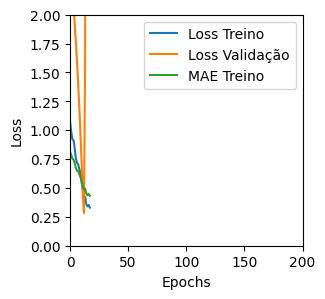

Tempo de treino: 0.0970530907313029 minutos
Treinando com LSTM_v3 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.29678797721862793 , MAE = 0.40253642201423645'

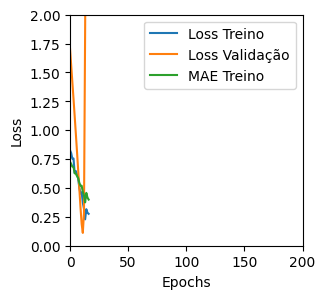

Tempo de treino: 0.08291404247283936 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.15031854808330536 , MAE = 0.27575087547302246'

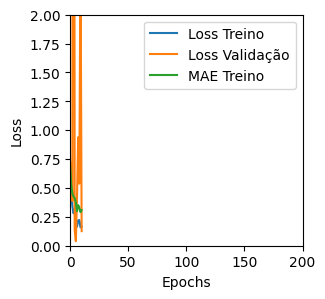

Tempo de treino: 0.09521811803181966 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.4033406674861908 , MAE = 0.4838102459907532'

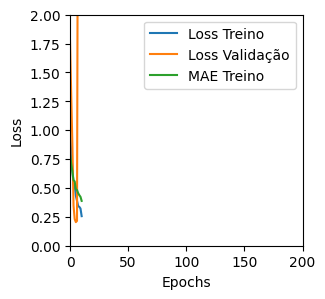

Tempo de treino: 0.06515878438949585 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.43979406356811523 , MAE = 0.5081630945205688'

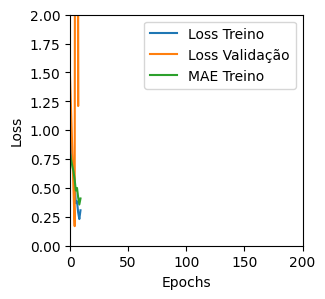

Tempo de treino: 0.04921854337056478 minutos
Treinando com LSTM_v3 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.31317973136901855 , MAE = 0.4130645990371704'

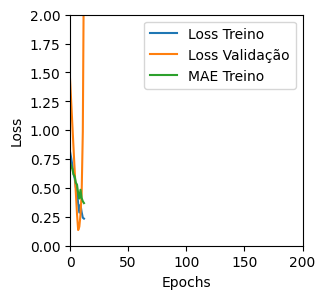

Tempo de treino: 0.05513517061869303 minutos
X_train.shape, X_test.shape, y_train.shape, y_test.shape =  (101, 36, 1) (12, 36, 1) (101, 1) (12, 1)
Treinando com GRU_v1 , timesteps=36, units=4, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.12880094349384308 , MAE = 0.27319252490997314'

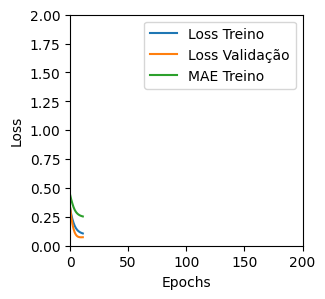

Tempo de treino: 0.12029602130254109 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.053017761558294296 , MAE = 0.17859268188476562'

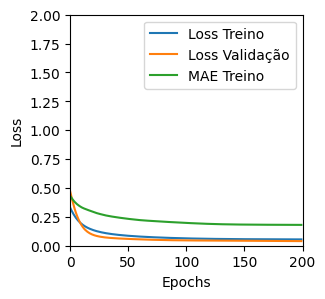

Tempo de treino: 0.5704148888587952 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19267748296260834 , MAE = 0.3582082688808441'

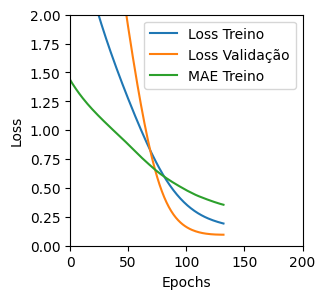

Tempo de treino: 0.2349764625231425 minutos
Treinando com GRU_v1 , timesteps=36, units=4, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.13493336737155914 , MAE = 0.28722503781318665'

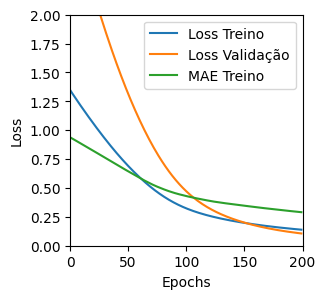

Tempo de treino: 0.38550246159235635 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1420409381389618 , MAE = 0.29625868797302246'

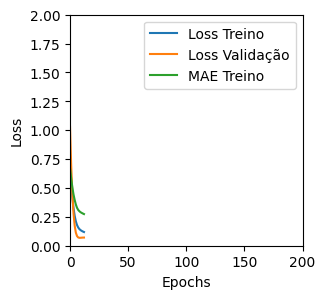

Tempo de treino: 0.10497864484786987 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1803673654794693 , MAE = 0.34158945083618164'

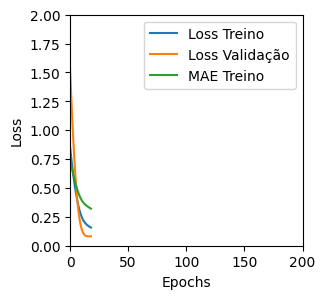

Tempo de treino: 0.08673411210378011 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.14522583782672882 , MAE = 0.29713866114616394'

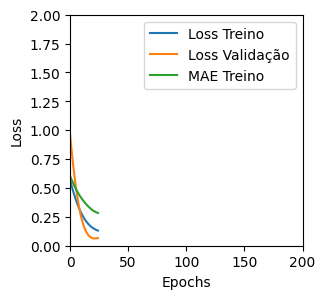

Tempo de treino: 0.15257364908854168 minutos
Treinando com GRU_v1 , timesteps=36, units=8, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1329950988292694 , MAE = 0.3005651831626892'

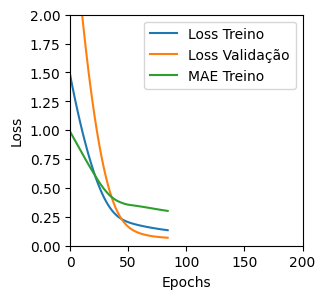

Tempo de treino: 0.21257862250010173 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.21020938456058502 , MAE = 0.36195433139801025'

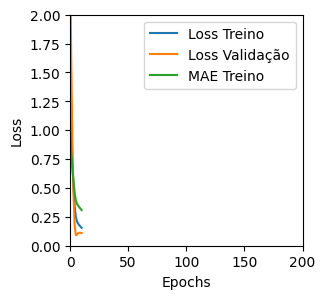

Tempo de treino: 0.10721231698989868 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.18693457543849945 , MAE = 0.3383253216743469'

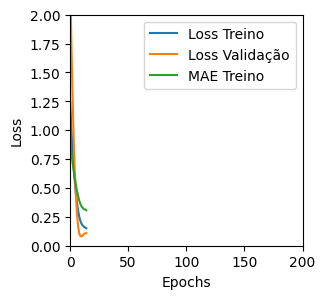

Tempo de treino: 0.07998231649398804 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19168217480182648 , MAE = 0.3496668338775635'

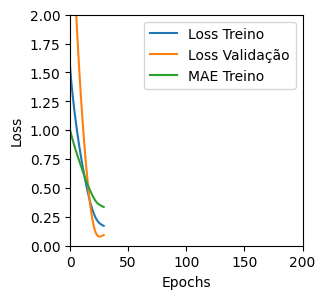

Tempo de treino: 0.11448427041371663 minutos
Treinando com GRU_v1 , timesteps=36, units=16, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2115827351808548 , MAE = 0.37313416600227356'

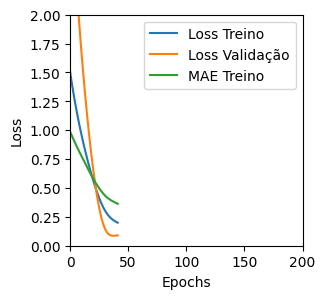

Tempo de treino: 0.09508755604426065 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0476626418530941 , MAE = 0.16947121918201447'

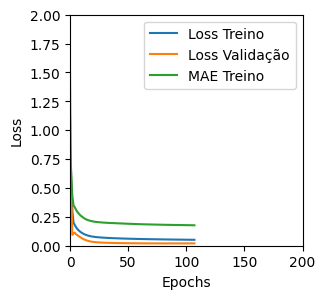

Tempo de treino: 0.540154755115509 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1771858185529709 , MAE = 0.3226254880428314'

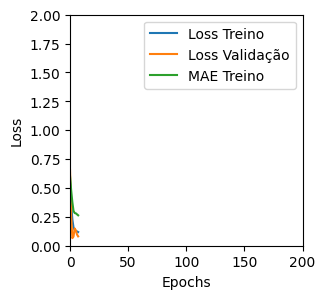

Tempo de treino: 0.0682868758837382 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.2080833464860916 , MAE = 0.35118311643600464'

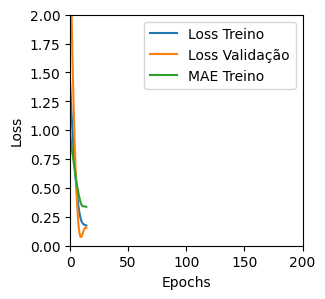

Tempo de treino: 0.07571738560994466 minutos
Treinando com GRU_v1 , timesteps=36, units=32, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1449238508939743 , MAE = 0.28703534603118896'

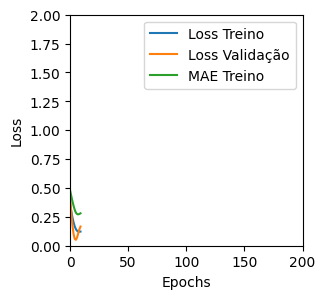

Tempo de treino: 0.07596563895543416 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=4


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.0521685816347599 , MAE = 0.1752834916114807'

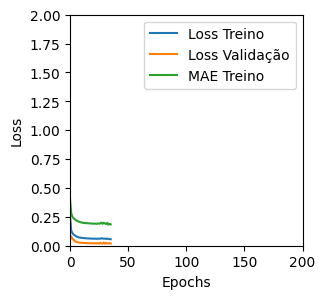

Tempo de treino: 0.38683114846547445 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=8


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.05031673610210419 , MAE = 0.17252856492996216'

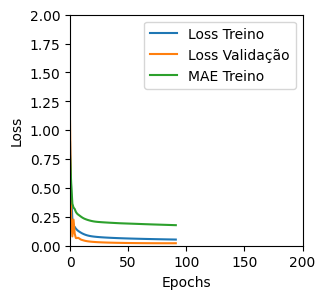

Tempo de treino: 0.34364039500554405 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=16


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.19642803072929382 , MAE = 0.3401707112789154'

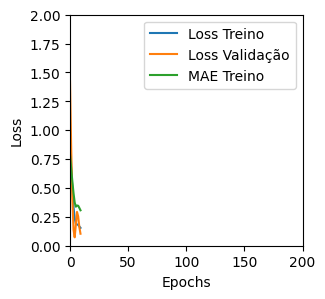

Tempo de treino: 0.08113370736440023 minutos
Treinando com GRU_v1 , timesteps=36, units=64, batch=32


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


'TRAINING set. Loss = 0.1984163224697113 , MAE = 0.3371905982494354'

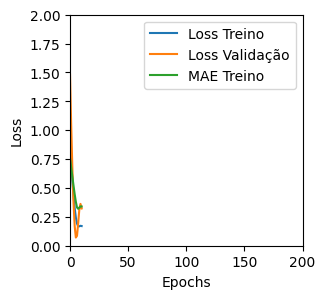

Tempo de treino: 0.08461459477742513 minutos


<ipython-input-7-086e32b9e36b>:28: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,


In [7]:
all_results = pd.DataFrame(columns=['model_type','model',feature,'unit','optimizer', 'batch_size', 'timesteps', 'loss','mae'])

# hyper parâmetros testados
model_hyperparams = ['LSTM_v1', 'LSTM_v2', 'LSTM_v3', 'GRU_v1']
timesteps_hyperparams = [6, 12, 24, 36]
units_hyperparams = [4, 8, 16, 32, 64]
batch_hyperparams = [4, 8, 16, 32]

epochs = 200
times_exec = 3

for times in range(times_exec):
  for timesteps in timesteps_hyperparams:
    for model_type_str in model_hyperparams:
      if model_type_str[:3] in ['LST', 'GRU']:
        scaler, X_train, X_test, y_train, y_test = preprocess(df, feature, timesteps, len(data_teste))
        print('X_train.shape, X_test.shape, y_train.shape, y_test.shape = ', X_train.shape, X_test.shape, y_train.shape, y_test.shape)
      for optimizer in ['Adam']:
        for unit in units_hyperparams:
          for batch_size in batch_hyperparams:

            inittime = time()
            print(f'Treinando com {model_type_str} , timesteps={timesteps}, units={unit}, batch={batch_size}')
            m, h = model_type(model_type_str, unit=unit, optimizer=optimizer, timesteps=timesteps, X=X_train, y=y_train, epochs=epochs, batch_size=batch_size)
            endtime = time()
            print(f'Tempo de treino: {(endtime-inittime)/60} minutos' )
            score = m.evaluate(X_test, y_test, batch_size=batch_size, verbose=0)
            all_results = all_results.append({'model_type': model_type_str, feature:feature,'unit':unit,
                                              'optimizer':optimizer, 'batch_size':batch_size, 'timesteps':timesteps,
                                              'loss':score[0], 'mae':score[1]}, ignore_index=True)
            del m, h

### Desempenho ordenado por menor MAE na base de validação
É considerada a melhor média, em termos de MAE, das três execuções

In [8]:
print(len(all_results))
mean_mae = all_results.groupby(['model_type', 'unit', 'batch_size', 'optimizer', 'timesteps'])['mae'].mean().reset_index()
mean_mae.sort_values(by=['mae'])
print(len(mean_mae))
mean_mae

960
320


,model_type,unit,batch_size,optimizer,timesteps,mae
0,GRU_v1,4,4,Adam,6,0.142187
1,GRU_v1,4,4,Adam,12,0.195978
2,GRU_v1,4,4,Adam,24,0.156823
3,GRU_v1,4,4,Adam,36,0.280141
4,GRU_v1,4,8,Adam,6,0.156522
...,...,...,...,...,...,...
315,LSTM_v3,64,16,Adam,36,0.702683
316,LSTM_v3,64,32,Adam,6,0.465046
317,LSTM_v3,64,32,Adam,12,0.606573
318,LSTM_v3,64,32,Adam,24,0.927169


## 5) Avaliação na base de testes


Seleção dos melhores modelos de cada arquitetura


In [9]:
best_models_arr = []

for model_str in model_hyperparams:
  best_model = mean_mae[mean_mae['model_type'] == model_str].sort_values('mae', ascending=True).head(1)
  best_models_arr.append(best_model)

best_models_df = pd.concat(best_models_arr)
del best_models_arr
print("Melhores modelos")
dsp.display(best_models_df.sort_values('mae', ascending=True))



Melhores modelos


,model_type,unit,batch_size,optimizer,timesteps,mae
18,GRU_v1,8,4,Adam,24,0.131548
306,LSTM_v3,64,4,Adam,24,0.279162
147,LSTM_v1,64,4,Adam,36,0.305850
176,LSTM_v2,8,4,Adam,6,0.397723


### Avaliação últimos 12 meses - usando dados reais
Construção dos dados de predição, também usados no Boxplot e Swarmplot

Aqui treinamos novamente o modelo para aferição dos resultados anteriores e comparação com os 12 últimos meses da série

'TRAINING set. Loss = 0.21576926112174988 , MAE = 0.3407222330570221'

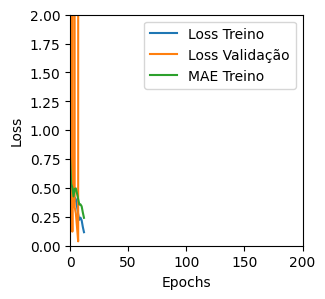

1/1 [==============================] - 0s 155ms/step


'TRAINING set. Loss = 0.13979358971118927 , MAE = 0.2789496183395386'

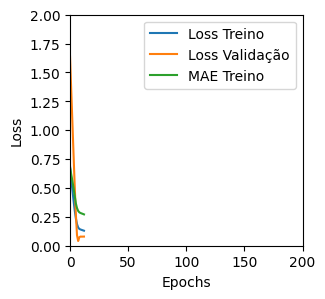

1/1 [==============================] - 0s 211ms/step


'TRAINING set. Loss = 0.10286711156368256 , MAE = 0.23188720643520355'

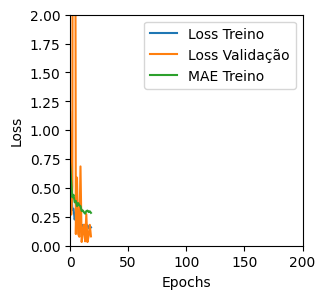

1/1 [==============================] - 0s 170ms/step


'TRAINING set. Loss = 0.042387038469314575 , MAE = 0.15793609619140625'

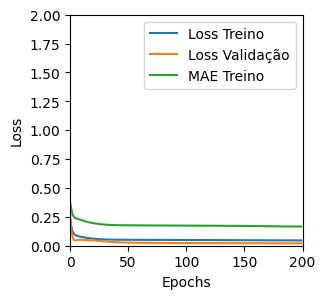

1/1 [==============================] - 0s 297ms/step
     LSTM_v1  LSTM_v1_Real   LSTM_v2  LSTM_v2_Real   LSTM_v3  LSTM_v3_Real  \
0   2.926770          2.83  2.759438          2.83  2.769799          2.83   
1   2.998868          2.85  2.803803          2.85  2.696606          2.85   
2   3.056309          2.97  2.837032          2.97  2.646667          2.97   
3   3.133682          3.01  2.879708          3.01  2.701357          3.01   
4   3.197377          3.01  2.917662          3.01  2.808119          3.01   
5   3.237437          3.18  2.954823          3.18  2.880641          3.18   
6   3.313434          3.31  3.022503          3.31  3.020078          3.31   
7   3.400757          3.29  3.112336          3.29  3.183186          3.29   
8   3.450527          3.48  3.177874          3.48  3.270463          3.48   
9   3.535671          3.58  3.271689          3.58  3.400766          3.58   
10  3.617625          3.56  3.364656          3.56  3.520437          3.56   
11  3.65652

In [10]:
aval = pd.DataFrame()

for index, setup in best_models_df.iterrows():
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], len(data_teste))
  mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                      epochs=epochs, batch_size=setup['batch_size'], train=True)
  best_models_df['model'] = mod
  y_pred = mod.predict(X_test)
  y_pred = scaler.inverse_transform(y_pred)
  y_real = scaler.inverse_transform(y_test)

  aval[f'{setup["model_type"]}'] = y_pred[:,0]
  aval[f'{setup["model_type"]}_Real'] = y_real[:,0]

print(aval)

#### Boxplot e Swarmplot

In [11]:
def box_swarm_plots(aval):
  fig, ax = plt.subplots(figsize=(12, 8), nrows=1, ncols=1)
  sns.boxplot(data=aval, dodge=False, palette='Blues', ax=ax)
  sns.swarmplot(data=aval, color='.25', alpha=0.8, ax=ax)

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


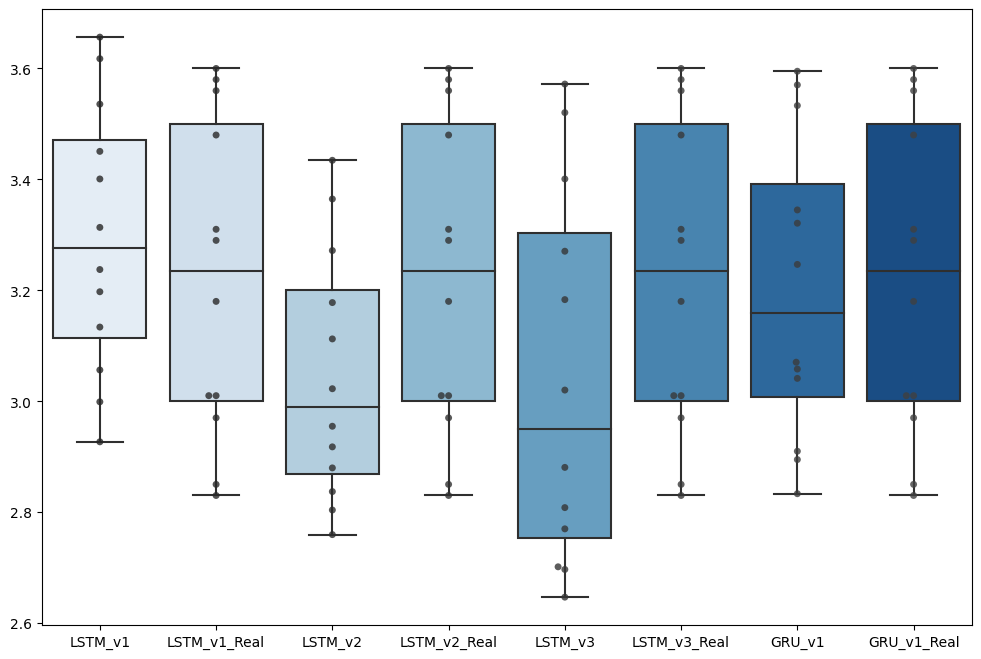

In [12]:
box_swarm_plots(aval)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto dos últimos 12 meses da série

In [13]:
def plot_aval(aval):
  min_val, max_val = aval.min().min(), aval.max().max()
  fig, ax = plt.subplots(figsize=(30, 12), nrows=1, ncols=len(best_models_df))
  i = 0
  for model_str in best_models_df['model_type']:
    filt = aval.filter(regex=model_str)
    sns.lineplot(data=filt, palette='inferno', ax=ax[i], hue_order=filt.columns)
    ax[i].set_xlabel('Meses')
    ax[i].set_title(model_str)
    ax[i].set_ylim(min_val, max_val)
    i += 1


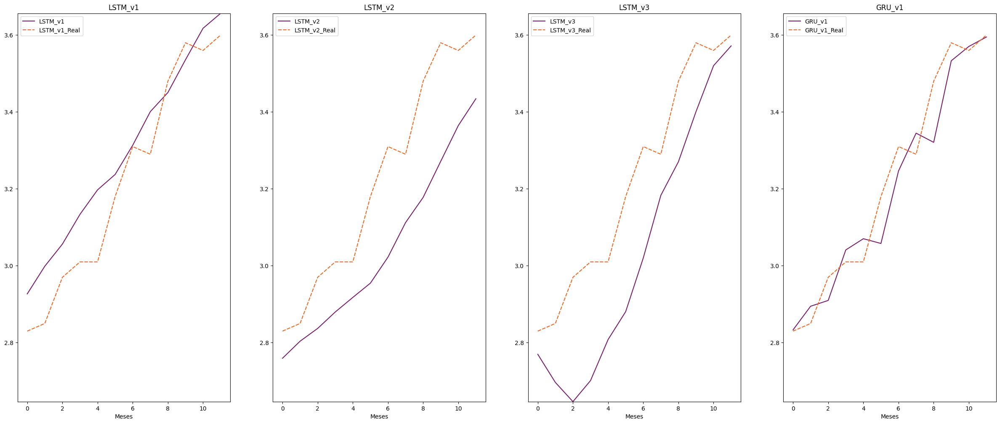

In [14]:
plot_aval(aval)

### Avaliação últimos 12 meses - usando dados previstos iterativamente
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Mas desta vez usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes. Este passo é necessário para identificar se o processo de prever o fututo está consistente. Ainda estamos comparando com a base de testes

Usou-se ruído nas saídas para simular curvas mais realísticas. A análise empírica deste método revelou predições superiores.

---



In [15]:
aval_pre_fut = pd.DataFrame()

future_size = 12
sharpness = 0.2
for index, setup in best_models_df.iterrows():

  mod = setup['model']
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', timesteps, future_size)

  initial_sequence = X_test[0]

  # Predict future values iteratively
  predicted_values = []
  for _ in range(future_size):
    # Predict the next step
    next_step = mod.predict(np.array([initial_sequence]), verbose=False)
    # add randomization to model do not converge as a curve
    if sharpness is not None:
      next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
    # Append the predicted value
    predicted_values.append(next_step[0, 0])
    # Update the initial sequence by removing the oldest value and appending the predicted value
    initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
    initial_sequence[-1] = next_step[0, 0]


  y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
  y_real = scaler.inverse_transform(y_test)
  aval_pre_fut[f'{setup["model_type"]}'] = y_pred[:,0]
  aval_pre_fut[f'{setup["model_type"]}_Real'] = y_real[:,0]


#### Boxplot e Swarmplot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


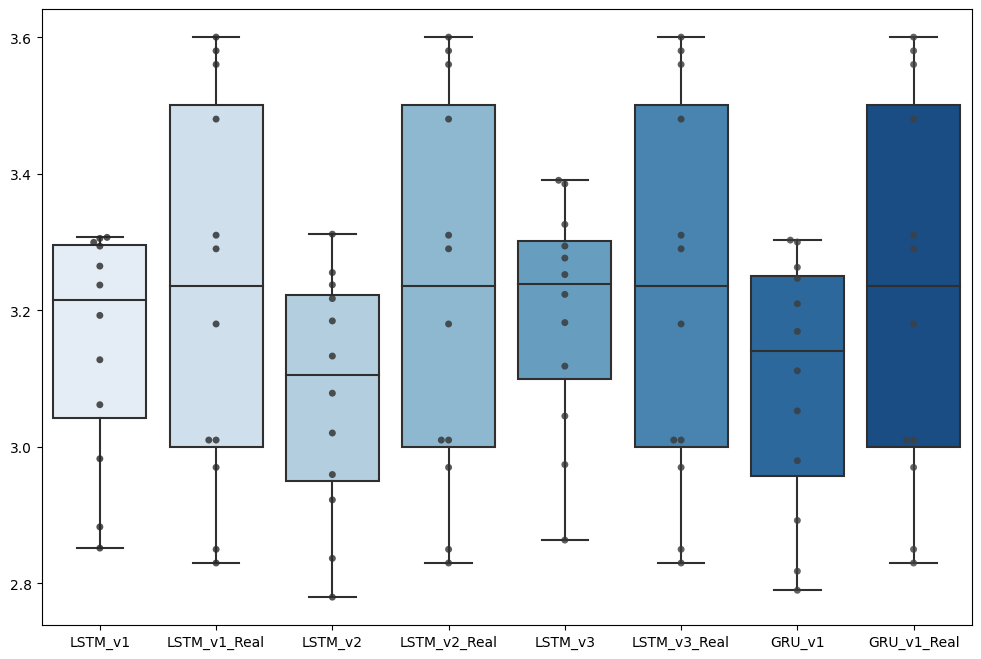

In [16]:
box_swarm_plots(aval_pre_fut)

#### Gráfico Linhas Real x Previsto
Figura com valor real x previsto (iterativo) dos últimos 12 meses da série

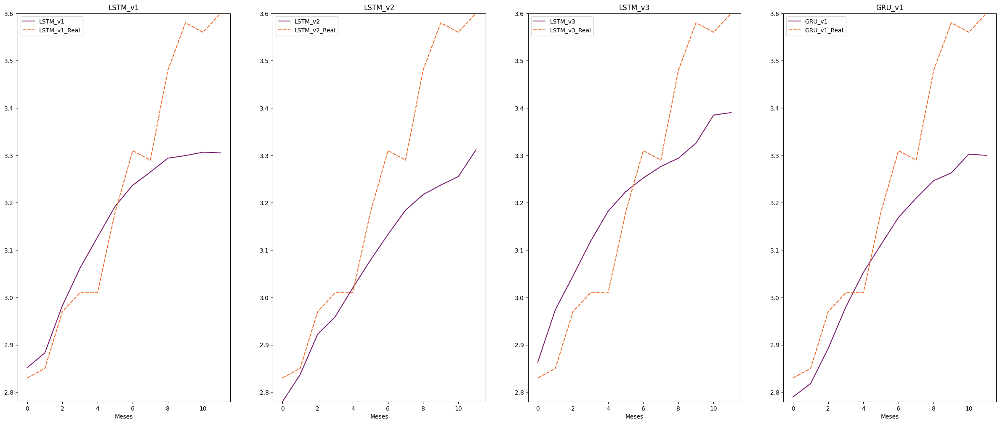

In [17]:
plot_aval(aval_pre_fut)

## 6) Avaliação futuros 12 meses
Aqui construímos novamente os dados de predição, também usados no Boxplot e Swarmplot

Desta, o treinamento do modelo é refeito com todos os dados. Mais uma vez usamos a técnica de prever no futuro, adicionando os dados previstos ao final da série e repetimos o processo 12 vezes.


---



Treinando com LSTM_v1, unit=64, opt=Adam,     timesteps=36, batch=4


'TRAINING set. Loss = 0.10502622276544571 , MAE = 0.23224154114723206'

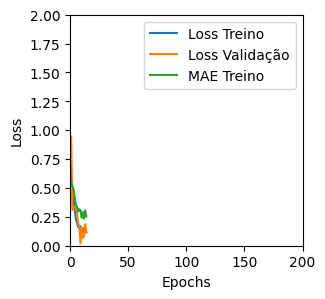

Treinando com LSTM_v2, unit=8, opt=Adam,     timesteps=6, batch=4


'TRAINING set. Loss = 0.23379462957382202 , MAE = 0.3536511957645416'

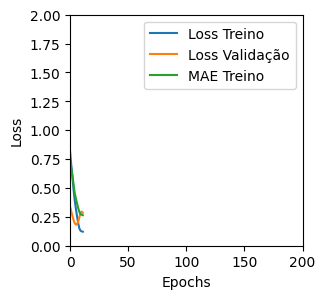

Treinando com LSTM_v3, unit=64, opt=Adam,     timesteps=24, batch=4


'TRAINING set. Loss = 0.342498779296875 , MAE = 0.4372722804546356'

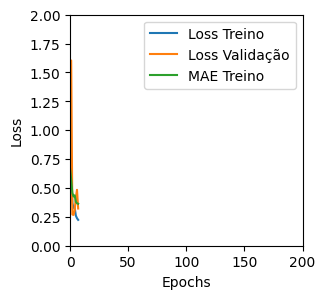

Treinando com GRU_v1, unit=8, opt=Adam,     timesteps=24, batch=4


'TRAINING set. Loss = 0.3010209798812866 , MAE = 0.42600834369659424'

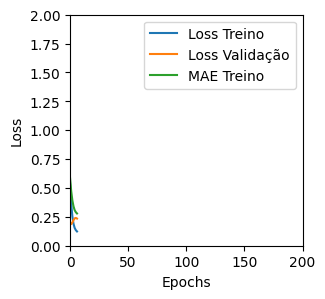

In [18]:
aval_fut = pd.DataFrame()

future_size = 12
sharpness = 0.2
for index, setup in best_models_df.iterrows():

  mod = setup['model']
  print(f'Treinando com {setup["model_type"]}, unit={setup["unit"]}, opt={setup["optimizer"]}, \
    timesteps={setup["timesteps"]}, batch={setup["batch_size"]}')
  scaler, X_train, X_test, y_train, y_test = preprocess(df, 'valor', setup['timesteps'], 0)
  mod, _ = model_type(setup['model_type'], setup['unit'], setup['optimizer'], setup['timesteps'], X_train, y_train,
                      epochs=epochs, batch_size=setup['batch_size'], train=True)

  # using last train element
  initial_sequence = X_train[-1]

  # Predict future values iteratively
  predicted_values = []
  for _ in range(future_size):
    # Predict the next step
    next_step = mod.predict(np.array([initial_sequence]), verbose=False)
    # add randomization to model do not converge as a curve
    if sharpness is not None:
      next_step[0, 0] = next_step[0, 0] + next_step[0, 0]*uniform(-sharpness, sharpness)
    # Append the predicted value
    predicted_values.append(next_step[0, 0])
    # Update the initial sequence by removing the oldest value and appending the predicted value
    initial_sequence = np.roll(initial_sequence, shift=-1, axis=0)
    initial_sequence[-1] = next_step[0, 0]


  y_pred = scaler.inverse_transform(np.array(predicted_values).reshape(-1, 1))
  aval_fut[f'{setup["model_type"]}'] = y_pred[:,0]


### Boxplot e Swarmplot

/usr/local/lib/python3.10/dist-packages/seaborn/categorical.py:166: FutureWarning: Setting a gradient palette using color= is deprecated and will be removed in version 0.13. Set `palette='dark:.25'` for same effect.
  warnings.warn(msg, FutureWarning)


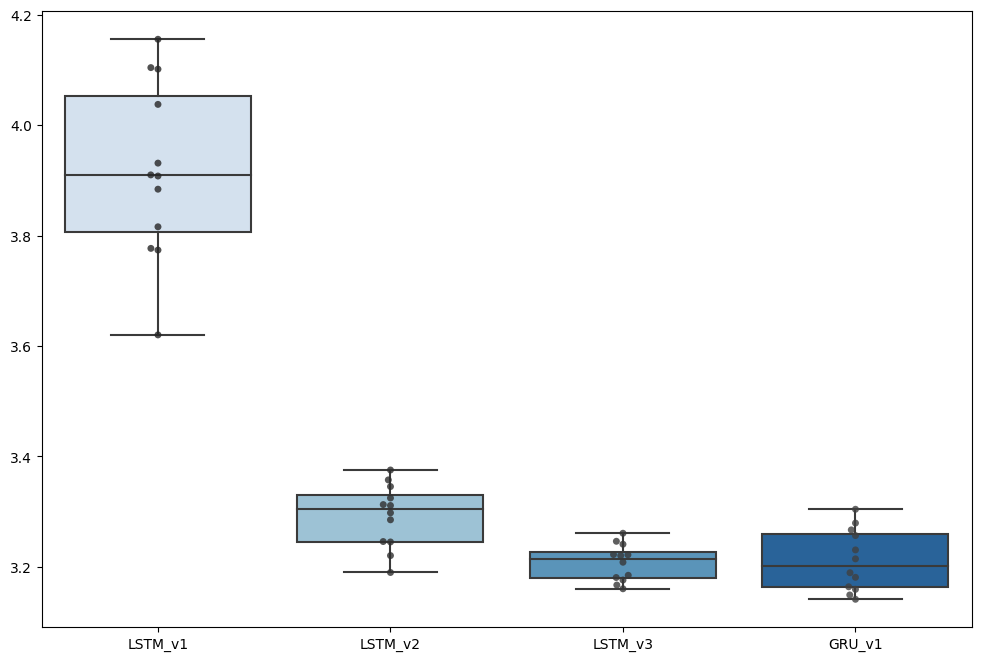

In [19]:
box_swarm_plots(aval_fut)

### Gráfico Linhas Real x Previsto
Figura com valor real x previsto (iterativo) dos últimos 12 meses da série

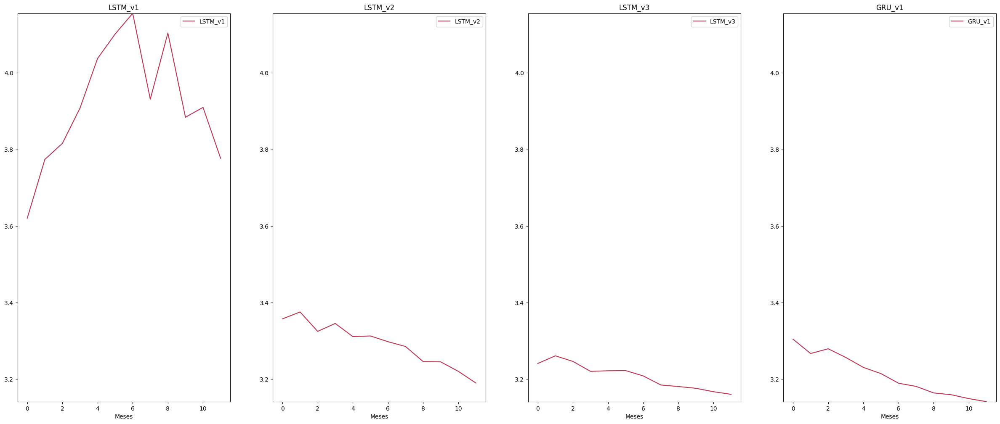

In [20]:
plot_aval(aval_fut)

# REFERÊNCIAS

[1] -  https://repositorio.utfpr.edu.br/jspui/bitstream/1/19605/1/CT_GESFIN_I_2016_07.pdf

[2] - https://repositorio.ufscar.br/bitstream/handle/ufscar/13730/Trabalho_de_Conclusao_de_Curso_Lucas_Vasco.pdf?sequence=2&isAllowed=y

[3] - https://towardsdatascience.com/lstm-framework-for-univariate-time-series-prediction-d9e7252699e

[4] - https://www.datarobot.com/blog/how-much-data-is-needed-to-train-a-good-model/#:~:text=the%20time%20series.-,For%20most%20time%20series%20applications%2C%20this%20means%20that%20the%20submitted,of%20the%20maximum%20expected%20seasonality.&text=For%20example%2C%20if%20you%20have,to%20train%20a%20successful%20model.
